In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from sklearn.linear_model import LinearRegression
from datetime import date, timedelta
from scipy.optimize import leastsq
#from sklearn.linear_model import LinearRegression
from matplotlib.dates import DateFormatter
from scipy.stats import chisquare

#from datetime import date, timedelta
yesterday = date.today() - timedelta(days=1)
d1 = yesterday.strftime("%Y-%m-%d")
countriesEU = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania",\
               "Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands",\
               "Denmark","Poland","Estonia","Portugal","Finland","Romania","France",\
               "Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
#x = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
d0 = date(2020, 3, 29)
d2 = date.today()
deltaT = d2 - d0
print(deltaT.days)
dT = deltaT.days
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
RkoreaCoeffs=[ 0.36242246,  2.56241634,  1.84890887,  0.13324732]
%matplotlib inline
expPopWorld = 2.67152730e+06
def moving_average(a, n=3) :
    ret = np.cumsum(a, dtype=float)
    ret[n:] = ret[n:] - ret[:-n]
    return ret[n - 1:] / n

def linreg(dfLT,population):
    
    dfLT['date'] = pd.to_datetime(dfLT['date'])
    yy = np.log(dfLT['cases'].values*10000./population)
    xx = np.array(range(dfLT['cases'].size)).reshape((-1, 1))
    model1 = LinearRegression().fit(xx, yy)
    r_sq1 = model1.score(xx, yy)
    return model1, r_sq1, dfLT

def plotpred(dfLT1, population, dateStart, dateEnd, filename, model1, country,level):
    
    #fig, ax = plt.subplots(figsize=(12, 12))
    plt.plot(dfLT1['date'].values,dfLT1['cases']*10000./population)
    date_form = DateFormatter("%m-%d")
    ax = plt.axes()
    ax.xaxis.set_major_formatter(date_form)
    ix1 = pd.date_range(dateStart, dateEnd, freq='D')
    ss1 = pd.DataFrame({'date': ix1},index=range(len(ix1)))
    y_pred1 = np.exp(model1.intercept_ + model1.coef_ * range(len(ix1)))
    ax.plot(ss1['date'].values,y_pred1)
    plt.xticks(rotation=90)
    plt.title(country)
    plt.ylabel('Tolat COVID-19 cases per 10000')
    ax.fill_between(ss1['date'].values, 1,level, facecolor='red', alpha=0.3)
    ax.fill_between(ss1['date'].values, yc,1, facecolor='m', alpha=0.3)
    ax.fill_between(ss1['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
    plt.xlabel('Date')
    #plt.yscale('log')
    plt.yscale('log')
    plt.grid()
    plt.savefig(filename)
    plt.show()
    ss1a = pd.DataFrame({'cases': (y_pred1*population/10000).astype(int)},index=range(len(y_pred1)))
    ss1t = pd.concat([ss1,ss1a], axis=1)
    return ss1t

def forecast(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases',pMAPE=True):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))#+coeffs[0]*.25/(1 + np.exp( - coeffs[1] * (t - 3.5*coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    if pMAPE:
        print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: logistic')
    print('coeffs: ',x)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    if cases=='cases':
        print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0)) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print(output)
    return x

def forecast2(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'bi-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: bi-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("bi-logistic approximation splitting point: %d"%(vL))
    print(output0)
    print(output)
    return x

def forecast3(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))+coeffsUS[3]/(1 + np.exp( - coeffsUS[4] * (t - coeffsUS[5])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendS1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: tri-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('forecast rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("tri-logistic approximation splitting points: %d,%d"%(vL[0],vL[1]))
    print(output0)
    print(output1)
    print(output)
    
    return x

def trend3(dfLV,dfLT1,dfES,lLV,lLT,lES,pLV,pLT,pES):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #dfLT1 = pd.read_csv("~/Desktop/coronaLT1.csv",",")
    y = np.log(np.diff(dfLT1["cases"].values)[:]/dfLT1["cases"].values[1:]**2)
    x = np.array(range(len(dfLT1["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLT)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLT) 
    plt.plot(range(len(x)+pLT),y_pred12,label='%s tr'%(lLT))

    y = np.log(np.diff(dfES["cases"].values)[:]/dfES["cases"].values[1:]**2)
    x = np.array(range(len(dfES["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lES)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pES) 
    plt.plot(range(len(x)+pES),y_pred12,label='%s tr'%(lES))
    plt.xlabel('t, days')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s%s%s.png"%(lLV,lLT,lES))
    plt.show()
    
def trend(dfLV,lLV,pLV):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    plt.xlabel('t [days]')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s.png"%(lLV))
    plt.show()

def trendS(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendS0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend0 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x[:vL])+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL])+pLV,y_pred12, output

def trendS1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output
    
def forecastR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t, output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: Richards')
    print('coeffs: ',x)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1])) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print (output)
    return x

def forecast2R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] *coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])-coeffs2[0]/(1 + np.exp( - coeffs2[3] *coeffs2[1] * (tt - coeffs2[2])))**(1./coeffs2[3])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: bi-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print(output)
    return x

def forecast3R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] * coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7] * coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(waveform_1-model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel-6*diffStd0*np.ones(len(tt)),allmodel+6*diffStd0*np.ones(len(tt)), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model']) 
    ax2.set_xlabel('t, days')
    ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(np.diff(waveform_1)-np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)-3*diffStd*np.ones(len(tt)-1), np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t [days]')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s_R.png"%(Cntr))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    rint('model: tri-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    print('\t total death: ', int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0]))
    print(output)
    return x

def get_cases(df,threshold):    
    dfA = df[df[['Country','TotCasesper1Mpop']].TotCasesper1Mpop>=threshold]
    #y = df[df['Country','TotCasesper1Mpop'].TotCasesper1Mpop>=56.]
    dfA = dfA.sort_values(by=['TotCasesper1Mpop'], ascending=False)
    country = dfA['Country']
    #country = country.tolist()
    cases = dfA['TotCasesper1Mpop']/100
    #case = cases.tolist()
    return country, cases

def stat_picture(country, cases, high=35, picname="pictures/coronage0.png"):
# Import the necessary packages and modules


    # Prepare the data
    #x = dfA['Country']
    fig = plt.figure( figsize=(6, high))
    fig.subplots_adjust(bottom=0.2, left=0.1)
    # Plot the data
    y_pos = cases
    #barh(y_pos, performance, xerr=error, align='center')
    plt.barh(country,y_pos)
    #plt.xticks(rotation=90)
    plt.xlabel('COVID-19 cases per 10000')
    # Add a legend
    plt.legend()
    ax = plt.axes() 
    x = range(len(country))
    ax.fill_betweenx(x, 1,1000, facecolor='red', alpha=0.3)
    yc = 0.56
    ax.fill_betweenx(x, yc,1, facecolor='m', alpha=0.3)
    ax.fill_betweenx(x, 1e-4,yc, facecolor='y', alpha=0.3)
    plt.vlines(yc, 0, len(country)-1, colors='g', linestyles='solid')
    #plt.ylim([1e-2,60])
    ax.xaxis.grid() # horizontal lines
    #ax.xaxis.grid() # vertical lines

    ax.set_yticks(range(len(country)))
    ax.set_yticklabels(country)
    #ax.invert_yaxis()
    plt.xscale("log")
    # Show the plot

    plt.savefig(picname, bbox_inches='tight')
    plt.show()
    
def read_df(dfRM,lRM):
    dfRM = pd.read_csv("data/corona%s.csv"%(lRM),",")
    dfRM['date'] = pd.to_datetime(dfRM['date'])
    print("%s\n"%(lRM),dfRM.tail())
    return dfRM

109


In [2]:
from sklearn.linear_model import Ridge
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline

def forecastRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    locStr = 'upper left'
    if Cntr in ['New Zealand']:
        locStr = 'lower right'
    ax2.legend(['COVID-19 %s'%(Cntr), 'Richards','-3days'],loc=locStr) 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecastRRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]) )))#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2RRR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * ((t- coeffsUS[2])*(t- coeffsUS[3]))))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    24.31714688, 0.00530186**2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast3RRR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))+coeffsUS[4]/(1 + np.exp( - coeffsUS[5] * (t - coeffsUS[6])* (t - coeffsUS[7])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.01 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSQ1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: tri-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "tri-logisticQ approximation splitting points: %d,%d"%(vL[0],vL[1])
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output1)
    ff.write(output1.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def trendSQ(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL:], y[vL:]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSQ0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[:vL], y[:vL]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL]),y_pred12, output

def trendSQ1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL[1], np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL[1]]),y_pred12, output

def trendSS(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSS0(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSS1(dfLV,vL=[0,1],pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

In [3]:
def forecastQR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * coeffs[4] * ((t- coeffs[2])**0.5*(t- coeffs[3])**0.5 )))**(1./coeffs[4])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3],xcoef[4]*x[4]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3],xcoef[4]*x_1[4]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'RichardsQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_QR.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_QR.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: RichardsQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x


def forecast2RR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3]*coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL,nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-Richards approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast3RR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases',zoom=1.):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3]*coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7]*coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop/4,  2.61212092e+01, -9.65961409e-01,  5.96529356e-03], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    if zoom != 1.:
        ax3.set_ylim([0,zoom])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL[1],nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL[0],nu=x[3])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSS1(dfSP,vL,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: tri-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "tri-logisticQ approximation splitting points: %d,%d"%(vL[0],vL[1])
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output1)
    ff.write(output1.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2QR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[4]*coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))**(1./coeffs[4])+coeffsUS[0]/(1 + np.exp( - coeffsUS[4]*coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))**(1./coeffsUS[4])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[4]*coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))**(1./coeffs[4])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

In [31]:
dfp = pd.read_csv("data/population.csv",",")
#dfp[dfp['Country (or dependency)']=='China'].Population.tolist()[0]
dfp.head()

,Country (or dependency),Population,Yearly Change,Net Change,Density (P/Km²),Land Area (Km²),Migrants (net),Fert. Rate,Med. Age,Urban Pop %,World Share
0,World,7774108745,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,European Union,445250514,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,China,1439323776,0.39 %,5540090.0,153.0,9388211.0,-348399.0,1.7,38,61 %,18.47 %
3,India,1380004385,0.99 %,13586631.0,464.0,2973190.0,-532687.0,2.2,28,35 %,17.70 %
4,United States,331002651,0.59 %,1937734.0,36.0,9147420.0,954806.0,1.8,38,83 %,4.25 %


In [32]:
popEU = sum(dfp[dfp["Country (or dependency)"].isin(countriesEU) ].Population)

In [33]:
#df = pd.read_csv("~/Desktop/coronaAllT.csv","\t")
df = pd.read_csv("data/coronaAll_%s.csv"%(d1),",")
dfAll = df#pd.read_csv("~/Desktop/coronaAll_2020-03-28.csv",",")

In [34]:
df.head()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,NaN,\n,NaN,NaN,2052994,North America,North America,NaN,7151.0,599.0,"+5,450",NaN,19924.0,NaN,4236876,190705.0,1993177.0,NaN,NaN
1,NaN,\n,NaN,NaN,879413,South America,South America,NaN,1351.0,44.0,"+111,749",NaN,13791.0,NaN,3050797,110315.0,2061069.0,NaN,NaN
2,NaN,\n,NaN,NaN,852358,Asia,Asia,NaN,4613.0,50.0,"+7,139",NaN,19608.0,NaN,3135579,73937.0,2209284.0,NaN,NaN
3,NaN,\n,NaN,NaN,869889,Europe,Europe,NaN,NaN,NaN,1,NaN,5287.0,NaN,2613810,197754.0,1546167.0,NaN,NaN
4,NaN,\n,NaN,NaN,297144,Africa,Africa,NaN,NaN,NaN,NaN,NaN,990.0,NaN,646973,14029.0,335800.0,NaN,NaN


In [35]:
df.tail()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
225,NaN,,NaN,NaN,869889,Europe,Total:,NaN,NaN,NaN,NaN,NaN,5287.0,NaN,2613810,197754.0,1546167.0,NaN,NaN
226,NaN,,NaN,NaN,297144,Africa,Total:,NaN,NaN,NaN,NaN,NaN,990.0,NaN,646973,14029.0,335800.0,NaN,NaN
227,NaN,,NaN,NaN,2703,Australia/Oceania,Total:,NaN,324.0,2.0,108,NaN,30.0,NaN,12479,135.0,9641.0,NaN,NaN
228,NaN,,NaN,NaN,55,NaN,Total:,NaN,NaN,NaN,NaN,NaN,4.0,NaN,721,15.0,651.0,NaN,NaN
229,NaN,NaN,NaN,NaN,167965,Europe,European Union,302.75316,0.0,0.0,NaN,NaN,2040.0,76490.274417,1348030,134801.0,653067.0,34057334.0,3027.576516


In [36]:
dfAll.head()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,NaN,\n,NaN,NaN,2052994,North America,North America,NaN,7151.0,599.0,"+5,450",NaN,19924.0,NaN,4236876,190705.0,1993177.0,NaN,NaN
1,NaN,\n,NaN,NaN,879413,South America,South America,NaN,1351.0,44.0,"+111,749",NaN,13791.0,NaN,3050797,110315.0,2061069.0,NaN,NaN
2,NaN,\n,NaN,NaN,852358,Asia,Asia,NaN,4613.0,50.0,"+7,139",NaN,19608.0,NaN,3135579,73937.0,2209284.0,NaN,NaN
3,NaN,\n,NaN,NaN,869889,Europe,Europe,NaN,NaN,NaN,1,NaN,5287.0,NaN,2613810,197754.0,1546167.0,NaN,NaN
4,NaN,\n,NaN,NaN,297144,Africa,Africa,NaN,NaN,NaN,NaN,NaN,990.0,NaN,646973,14029.0,335800.0,NaN,NaN


In [37]:
dfAll.fillna(0, inplace=True)
dfAll[dfAll["Country"]=="Lithuania"]

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
123,117.0,"1,445","34,435",6,221,Europe,Lithuania,29.0,0.0,0.0,0,"2,720,387",15.0,171077.0,1882,79.0,1582.0,465396.0,692.0


No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


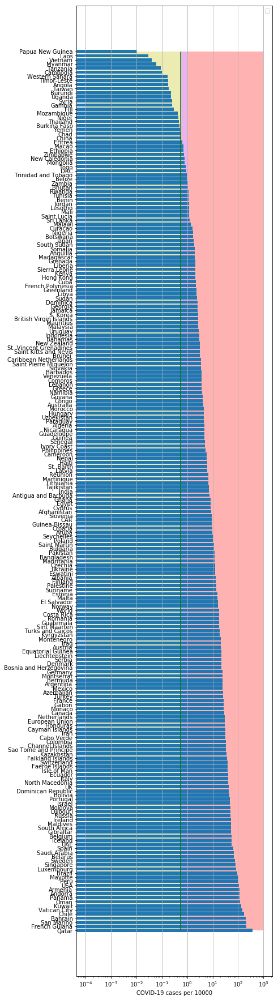

In [38]:
country, cases = get_cases(df,0.01)
country.values, cases.values
stat_picture(country.values, cases.values, high=35, picname="pictures/coronage0.png")

No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


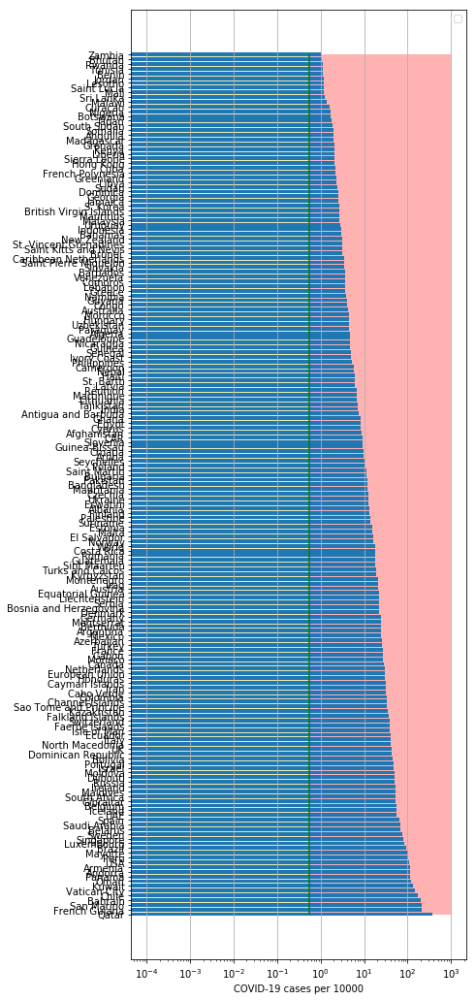

In [39]:
country, cases = get_cases(df,100.0)
stat_picture(country.values, cases.values, high=20, picname="pictures/coronage1.png")

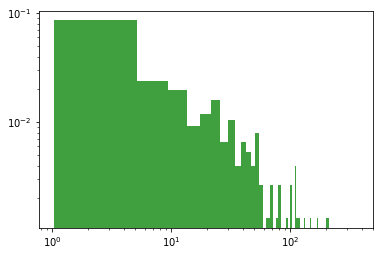

In [40]:
n, bins, patches = plt.hist(cases, 90, density=True,facecolor='g', alpha=0.75)
plt.yscale("log")
plt.xscale("log")

In [41]:
dfSP = read_df(pd.DataFrame(),"SP")
dfGB = read_df(pd.DataFrame(),"GB")
dfIT = read_df(pd.DataFrame(),"IT")
dfLT = read_df(pd.DataFrame(),"LT")
dfUkr = read_df(pd.DataFrame(),"Ukr")
dfUS = read_df(pd.DataFrame(),"US")
dfCN = read_df(pd.DataFrame(),"CN")
dfFR = read_df(pd.DataFrame(),"FR")
dfKR = read_df(pd.DataFrame(),"KR")
dfW = read_df(pd.DataFrame(),"World")
dfDK = read_df(pd.DataFrame(),"DK")
dfNG = read_df(pd.DataFrame(),"NG")
dfGR = read_df(pd.DataFrame(),"GR")
dfES = read_df(pd.DataFrame(),"ES")
dfSW = read_df(pd.DataFrame(),"SW")
dfPL = read_df(pd.DataFrame(),"PL")
dfIS = read_df(pd.DataFrame(),"IS")
dfUR = read_df(pd.DataFrame(),"Ukr")
dfSZ = read_df(pd.DataFrame(),"SZ")
dfIN = read_df(pd.DataFrame(),"IN")
#dfKRA = read_df(pd.DataFrame(),"KRA")
dfRS = read_df(pd.DataFrame(),"RS")
dfJP = read_df(pd.DataFrame(),"JP")
dfNL = read_df(pd.DataFrame(),"NL")
dfAT = read_df(pd.DataFrame(),"AT")
dfBG = read_df(pd.DataFrame(),"BG")
dfSG = read_df(pd.DataFrame(),"SG")
dfLV = read_df(pd.DataFrame(),"LV")
dfCA = read_df(pd.DataFrame(),"CA")
dfPT = read_df(pd.DataFrame(),"PT")
dfTR = read_df(pd.DataFrame(),"TR")
dfBZ = read_df(pd.DataFrame(),"BZ")
dfAS = read_df(pd.DataFrame(),"AS")
dfML = read_df(pd.DataFrame(),"ML")
dfZL = read_df(pd.DataFrame(),"ZL")
dfBR = read_df(pd.DataFrame(),"BR")
dfIR = read_df(pd.DataFrame(),"IR")
dfCL = read_df(pd.DataFrame(),"CL")
dfCH = read_df(pd.DataFrame(),"CH")
dfRM = read_df(pd.DataFrame(),"RM")
dfFI = read_df(pd.DataFrame(),"FI")
dfID = read_df(pd.DataFrame(),"ID")
dfED = read_df(pd.DataFrame(),"ED")
dfPH = read_df(pd.DataFrame(),"PH")
#dfPK = read_df(pd.DataFrame(),"PK")
dfLX = read_df(pd.DataFrame(),"LX")
dfTH = read_df(pd.DataFrame(),"TH")
dfIE = read_df(pd.DataFrame(),"IE")
dfMX = read_df(pd.DataFrame(),"MX")
dfPM = read_df(pd.DataFrame(),"PM")
dfPU = read_df(pd.DataFrame(),"PU")
dfSB = read_df(pd.DataFrame(),"SB")
dfAG = read_df(pd.DataFrame(),"AG")
dfCT = read_df(pd.DataFrame(),"CT")
dfEG = read_df(pd.DataFrame(),"EG")
dfSV = read_df(pd.DataFrame(),"SV")
dfMR = read_df(pd.DataFrame(),"MR")
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIC = read_df(pd.DataFrame(),"IC")
dfQR = read_df(pd.DataFrame(),"QR")
dfCB = read_df(pd.DataFrame(),"CB")
dfBL = read_df(pd.DataFrame(),"BL")
dfAG = read_df(pd.DataFrame(),"AR")
dfEU = read_df(pd.DataFrame(),"EU")
dfMT = read_df(pd.DataFrame(),"MT")
dfCP = read_df(pd.DataFrame(),"CP")

SP
           date   cases  active    death
137 2020-07-11  301668       0  28403.0
138 2020-07-12  302349       0  28403.0
139 2020-07-13  303033       0  28406.0
140 2020-07-14  303699       0  28409.0
141 2020-07-15  304574       0  28413.0
GB
           date   cases  active    death
136 2020-07-11  288953       0  44798.0
137 2020-07-12  289603       0  44819.0
138 2020-07-13  290133       0  44830.0
139 2020-07-14  291373       0  44968.0
140 2020-07-15  291911       0  45053.0
IT
           date   cases  active    death
139 2020-07-11  242827   13303  34945.0
140 2020-07-12  243061   13179  34954.0
141 2020-07-13  243230   13157  34967.0
142 2020-07-14  243344   12919  34984.0
143 2020-07-15  243506   12493  34997.0
LT
           date   cases  active  death     tests
124 2020-07-11  1869.0     207   79.0  461110.0
125 2020-07-12  1874.0     224   79.0  461666.0
126 2020-07-13  1875.0     213   79.0  465396.0
127 2020-07-14  1896.0     209   79.0  469126.0
128 2020-07-15  1882.0  

PM
           date  cases   active  death
123 2020-07-11  44332  21269.0  893.0
124 2020-07-12  45633  21685.0  909.0
125 2020-07-13  47173  22322.0  932.0
126 2020-07-14  48096  22469.0  960.0
127 2020-07-15  49243  22844.0  982.0
PU
           date   cases   active    death
126 2020-07-11  322710  96876.0  11682.0
127 2020-07-12  326326  97345.0  11870.0
128 2020-07-13  330123  97061.0  12054.0
129 2020-07-14  333867  98377.0  12229.0
130 2020-07-15  337724  98907.0  12417.0
SB
           date  cases  active  death
123 2020-07-11  18073  3911.0  382.0
124 2020-07-12  18360  4091.0  393.0
125 2020-07-13  18639  4294.0  405.0
126 2020-07-14  18983  4574.0  418.0
127 2020-07-15  19334  4858.0  429.0
AG
           date     cases   active   death
129 2020-07-11   97509.0  54291.0  1810.0
130 2020-07-12  100166.0  55627.0  1845.0
131 2020-07-13  103265.0  57189.0  1903.0
132 2020-07-14  106910.0  59475.0  1968.0
133 2020-07-15  111146.0  61798.0  2050.0
CT
           date   cases  active  

In [42]:
dfBL = dfBL.fillna(0)
dfRM = dfRM.fillna(0)
dfSV = dfSV.fillna(0)
dfCT = dfCT.fillna(0)
#dfAR = dfAR.fillna(0)
dfSB = dfSB.fillna(0)
dfCP = dfCP.fillna(0)
dfID = dfID.fillna(0)
dfAG = dfAG.fillna(0)
dfMX = dfMX.fillna(0)
dfPU = dfPU.fillna(0)
dfIQ = dfIQ.fillna(0)
dfIE = dfIE.fillna(0)
dfPH = dfPH.fillna(0)
dfTH = dfTH.fillna(0)
dfMR = dfMR.fillna(0)
dfCP = dfCP.fillna(0)

In [43]:
from sklearn.linear_model import LinearRegression
populationSp = dfp[dfp['Country (or dependency)']=='Spain'].Population.tolist()[0]
y = np.log(dfSP['cases'].values*10000./populationSp)
x = np.array(range(dfSP['cases'].size)).reshape((-1, 1))
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)


coefficient of determination: 0.5344616758071297
intercept: -0.254472863972075
slope: [0.04358259]


/usr/local/lib/python3.5/dist-packages/pandas/plotting/_converter.py:129: FutureWarning: Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


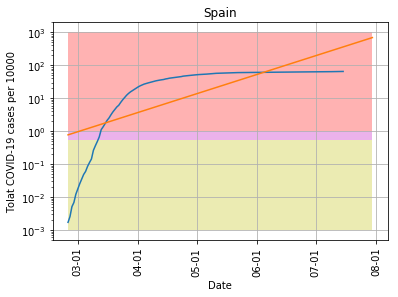

In [44]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
yc = 0.56
plt.plot(dfSP['date'].values,dfSP['cases']*10000./populationSp)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix = pd.date_range('2020-02-25', '2020-07-30', freq='D')
ss = pd.DataFrame({'date': ix})
y_pred = np.exp(model.intercept_ + model.coef_ * range(len(ix)))
ax.plot(ss['date'].values,y_pred)
plt.xticks(rotation=90)
plt.title('Spain')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaSP.png")
plt.show()

In [45]:
populationUK = dfp[dfp['Country (or dependency)']=='United Kingdom'].Population.tolist()[0]
model1, r_sql, dfGB1 = linreg(dfGB,populationUK)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.6717957134871683
intercept: -1.8999782730799826
slope: [0.05433088]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


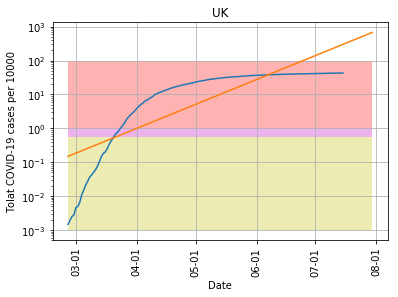

In [46]:
ss1t = plotpred(dfGB1,populationUK,'2020-02-26', '2020-07-30', "pictures/coronaGB.png", model1, 'UK',100)

In [47]:
populationIT = dfp[dfp['Country (or dependency)']=='Italy'].Population.tolist()[0]
coefIT = 4.0378751-0.3
yy1 = np.log(coefIT-np.log(dfIT['cases'].values*10000./populationIT))
xx1 = np.array(range(dfIT['cases'].size)).reshape((-1, 1))
model11 = LinearRegression().fit(xx1, yy1)
r_sq1 = model11.score(xx1, yy1)
print('coefficient of determination:', r_sq1)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.9438844772791825
intercept: 1.3374777527426263
slope: [-0.03611472]


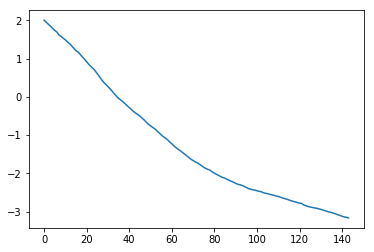

In [48]:
plt.plot(xx1,yy1)

/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


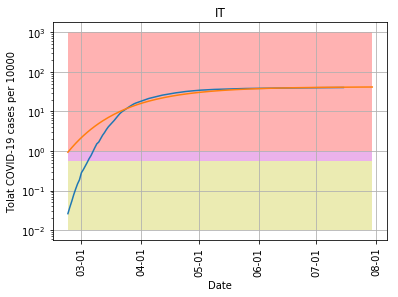

In [50]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
plt.plot(dfIT['date'].values,dfIT['cases']*10000./populationIT)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix11 = pd.date_range('2020-02-23', '2020-07-30', freq='D')
ss11 = pd.DataFrame({'date': ix11})
y_pred11 = np.exp(coefIT-np.exp(model11.intercept_ + model11.coef_ * range(len(ix11))))
ax.plot(ss11['date'].values,y_pred11)
plt.xticks(rotation=90)
plt.title('IT')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss11['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss11['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss11['date'].values, 1e-2,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
#plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaIT.png")
plt.show()

In [51]:
cs=y_pred11[-1]/10000.*populationIT

In [52]:
cs

250794.4923713072

In [53]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
model1, r_sql, dfLT1 = linreg(dfLT[1:],populationLT)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.47181821682339525
intercept: -0.6739987087088226
slope: [0.02813203]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


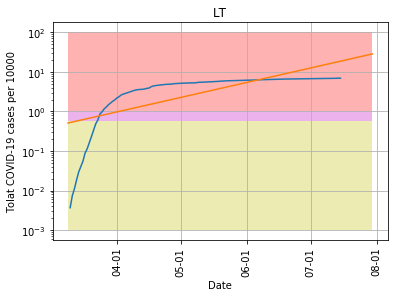

In [54]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
ss1t = plotpred(dfLT[1:],populationLT,'2020-03-09', '2020-07-30', "pictures/coronaLT.png", model1, 'LT',100)

In [55]:
populationUKr = dfp[dfp['Country (or dependency)']=='Ukraine'].Population.tolist()[0]
model11, r_sql, dfUkr1 = linreg(dfUkr, populationUKr)
print('coefficient of determination:', r_sql)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.7355001399088125
intercept: -3.6864289023649084
slope: [0.06122223]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


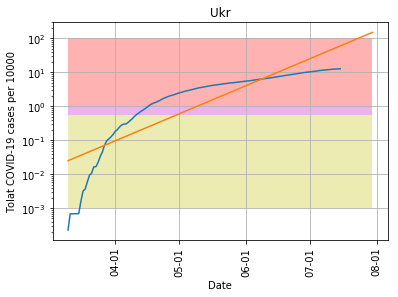

In [56]:
ss1t1 = plotpred(dfUkr1,populationUKr,'2020-03-10', '2020-07-30', "pictures/coronaUkr.png", model11, 'Ukr',100)

No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


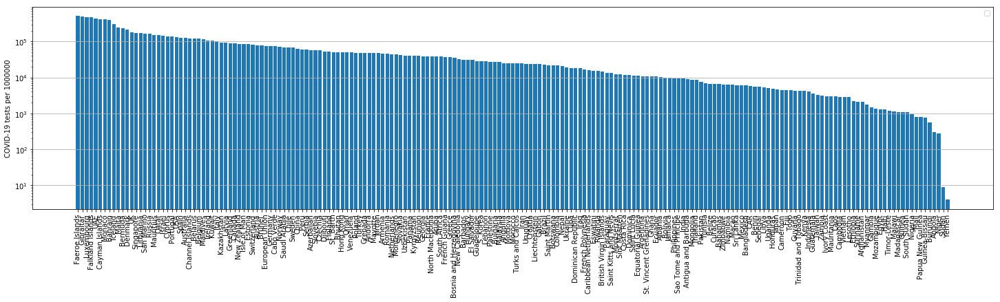

In [57]:
# Prepare the data
dfTs = dfAll
dfTs = dfTs.sort_values(by=['Testsper1Mpop'], ascending=False)
dfTs = dfTs[dfTs['Testsper1Mpop']>0]
x = dfTs['Country']
y = dfTs['Testsper1Mpop']
fig = plt.figure( figsize=(25, 6))
fig.subplots_adjust(bottom=0.2)
# Plot the data
plt.bar(x, y)

plt.xticks(rotation=90)
plt.ylabel('COVID-19 tests per 1000000')
# Add a legend
plt.legend()
ax = plt.axes() 
#ax.fill_between(x, 1,10, facecolor='red', alpha=0.3)
yc = 0.56
#ax.fill_between(x, yc,1, facecolor='m', alpha=0.3)
#ax.fill_between(x, 1e-4,yc, facecolor='y', alpha=0.3)
#plt.hlines(yc, 0, len(df)-1, colors='g', linestyles='solid')
#plt.ylim([1e-4,10])
ax.yaxis.grid() # horizontal lines
#ax.xaxis.grid() # vertical lines
plt.yscale("log")
# Show the plot
plt.savefig("pictures/coronaTests.png")
plt.show()

In [58]:
populationUS= dfp[dfp['Country (or dependency)']=='United States'].Population.tolist()[0]
model11, r_sql, dfUS1 = linreg(dfUS, populationUS)
print('coefficient of determination:', r_sql)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.6684607055394272
intercept: -1.3125560564668302
slope: [0.0559519]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


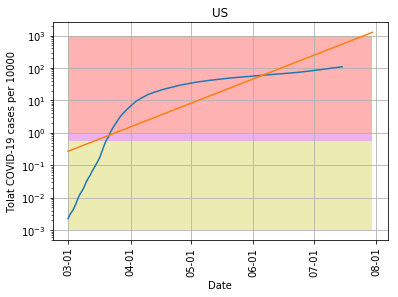

In [59]:
ss1t = plotpred(dfUS1,populationUS,'2020-03-01', '2020-07-30', "pictures/coronaUS.png", model11, 'US',1000)

In [60]:
dfAll[dfAll["Country"]=="Latvia"]
dfAll.fillna(0, inplace=True)

North America
            Country         0
229  European Union  0.099999


(0, 0.15)

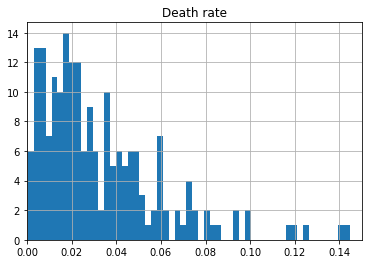

In [61]:
dfT1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
print(dfTT.Country[0])
print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
hist = dfTTh[dfTTh[0]>0].hist(bins=9*12)
plt.title("Death rate")
plt.xlim([0,0.15])

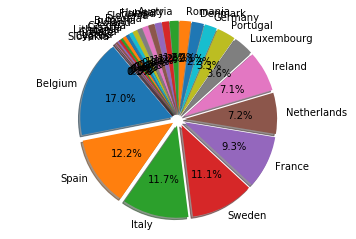

In [62]:
cLst = countriesEU
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
#dfD1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["Deathsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfTTh = dfTT.sort_values(by=["Deathsper1Mpop"], ascending=False)
dfTTh.rename(columns={0: "DeathRate"})
#hist = dfTTh.hist(bins=9*16)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])
#plt.show()
#import matplotlib.pyplot as plt

labels = dfTTh.Country.tolist()#'apple', 'banana', 'cherry', 'durian', 'elderberries', 'figs', 'grapes'
sizes = dfTTh.Deathsper1Mpop.values#[32, 20, 15, 10, 10, 8, 5]

p = plt.pie(sizes, labels=labels, explode=(.07,)*len(sizes), autopct='%1.1f%%', startangle=130, shadow=True)
plt.axis('equal')

            
plt.show()

In [63]:
dfTTh.head()

,Country,Deathsper1Mpop
36,Belgium,844.0
15,Spain,608.0
19,Italy,579.0
32,Sweden,552.0
24,France,461.0


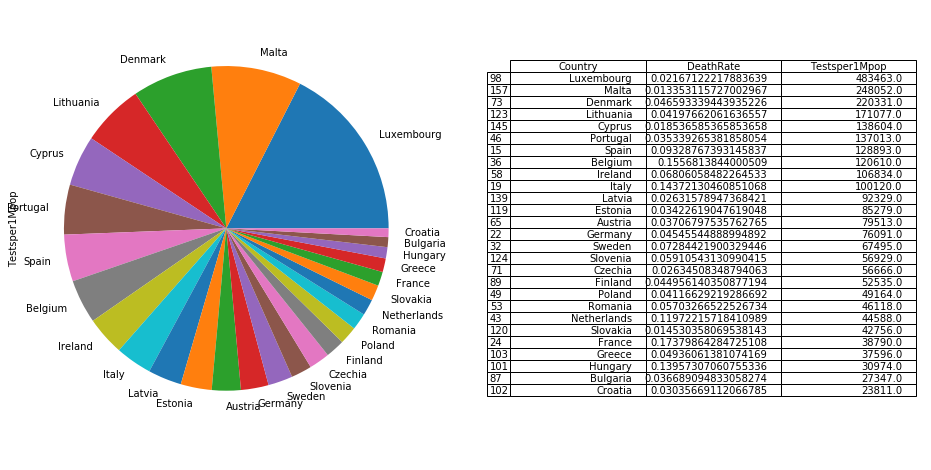

In [64]:
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=["Testsper1Mpop"], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
#import matplotlib.pyplot as plt
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfTTh.plot.pie(y=["Testsper1Mpop"],ax=ax1,labels=dfTTh['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfTTh, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate2.png")
plt.show()

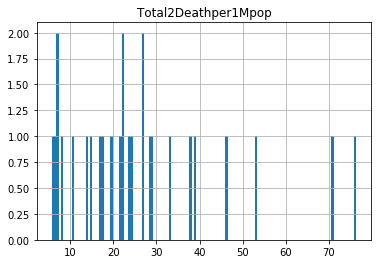

In [65]:
dfD1 = dfAll[dfAll['Country'].isin(cLst)]#[dfAll["Total Cases"]>0]
dfDD = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"],dfD1["Deathsper1Mpop"]], axis=1)
dfDD2 = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"]/dfD1["Testsper1Mpop"]], axis=1)
dfDD = dfDD[dfDD["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfDD1 = pd.concat([dfDD["Country"],dfDD["TotCasesper1Mpop"]/dfDD["Deathsper1Mpop"]], axis=1)
dfDDh = dfDD1.sort_values(by=[0], ascending=False)
dfDDh=dfDDh.rename(columns={0:"Total2Deathper1Mpop"})
dfDDh2=dfDD2.rename(columns={0:"Cases2Testsper1Mpop"})
hist = dfDDh.hist(bins=9*15)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])

In [66]:
dfDD.head()

,Country,TotCasesper1Mpop,Deathsper1Mpop
15,Spain,6514.0,608.0
19,Italy,4028.0,579.0
22,Germany,2402.0,109.0
24,France,2655.0,461.0
32,Sweden,7572.0,552.0


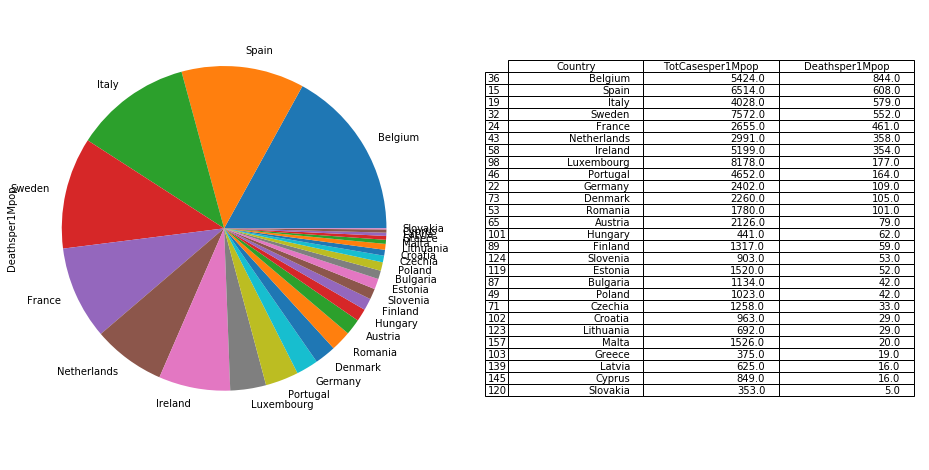

In [67]:
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDD = dfDD.sort_values(by=['Deathsper1Mpop'], ascending=False)
dfDD.plot.pie(y='Deathsper1Mpop',ax=ax1,labels=dfDD['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDD, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate1.png")
plt.show()

In [68]:
dfAll.head()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,0.0,\n,0,0,2052994,North America,North America,0.0,7151.0,599.0,"+5,450",0,19924.0,0.0,4236876,190705.0,1993177.0,0.0,0.0
1,0.0,\n,0,0,879413,South America,South America,0.0,1351.0,44.0,"+111,749",0,13791.0,0.0,3050797,110315.0,2061069.0,0.0,0.0
2,0.0,\n,0,0,852358,Asia,Asia,0.0,4613.0,50.0,"+7,139",0,19608.0,0.0,3135579,73937.0,2209284.0,0.0,0.0
3,0.0,\n,0,0,869889,Europe,Europe,0.0,0.0,0.0,1,0,5287.0,0.0,2613810,197754.0,1546167.0,0.0,0.0
4,0.0,\n,0,0,297144,Africa,Africa,0.0,0.0,0.0,0,0,990.0,0.0,646973,14029.0,335800.0,0.0,0.0


In [69]:
dfDDh2.head()

,Country,Cases2Testsper1Mpop
15,Spain,0.050538
19,Italy,0.040232
22,Germany,0.031567
24,France,0.068445
32,Sweden,0.112186


In [70]:
dfDDh2 = dfDDh2.sort_values(by=["Cases2Testsper1Mpop"], ascending=False)

     Country  Cases2Testsper1Mpop
      Sweden             0.112186
      France             0.068445
 Netherlands             0.067081
       Spain             0.050538
     Ireland             0.048664
     Belgium             0.044971
    Bulgaria             0.041467
     Croatia             0.040443
       Italy             0.040232
     Romania             0.038597
    Portugal             0.033953
     Germany             0.031567
     Austria             0.026738
     Finland             0.025069
     Czechia             0.022200
      Poland             0.020808
     Estonia             0.017824
  Luxembourg             0.016915
    Slovenia             0.015862
     Hungary             0.014238
     Denmark             0.010257
      Greece             0.009974
    Slovakia             0.008256
      Latvia             0.006769
       Malta             0.006152
      Cyprus             0.006125
   Lithuania             0.004045


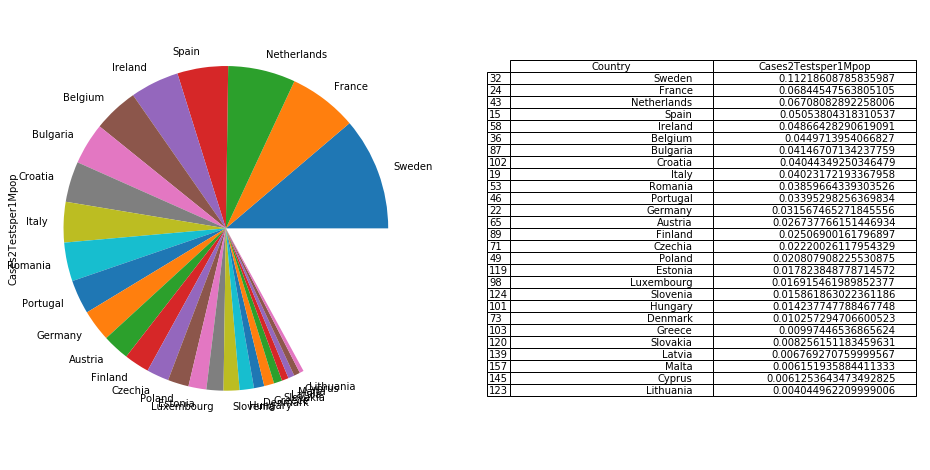

In [71]:
print (dfDDh2[dfDDh2["Cases2Testsper1Mpop"]<1000].to_string(index=False))
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDDh2.plot.pie(y='Cases2Testsper1Mpop',ax=ax1,labels=dfDDh2['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDDh2, loc='center')
#tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.show()

In [72]:
dfT1 = dfAll
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
dfTT[dfTT[0]>=0.000001].sort_values(by=[0], ascending=True)
#dfTT[dfTT.Country=="France"]

,Country,0,Testsper1Mpop
47,Singapore,0.000576,172506.000000
28,Qatar,0.001438,151313.000000
148,Namibia,0.002083,6413.000000
66,Nepal,0.002270,20965.000000
164,Botswana,0.002506,21834.000000
133,Rwanda,0.002787,15028.000000
51,Bahrain,0.003385,407223.000000
171,Burundi,0.003717,563.000000
112,Sri Lanka,0.004118,5973.000000
81,Costa Rica,0.004451,12013.000000


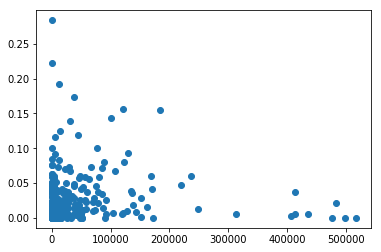

In [73]:
plt.plot(dfTTh["Testsper1Mpop"],dfTTh['DeathRate'],'o')

/usr/local/lib/python3.5/dist-packages/matplotlib/patches.py:694: RuntimeWarning: invalid value encountered in double_scalars
  self._x1 = self._x0 + self._width
/usr/local/lib/python3.5/dist-packages/matplotlib/projections/polar.py:67: RuntimeWarning: invalid value encountered in less
  mask = r < 0


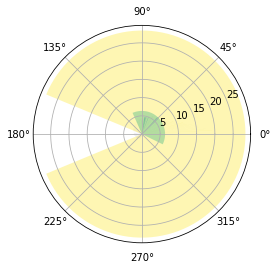

In [74]:
import numpy as np
import matplotlib.pyplot as plt


# Fixing random state for reproducibility
np.random.seed(19680801)

# Compute pie slices
N = len(dfTTh)
theta = np.linspace(0.0, 2*np.pi, N, endpoint=False)
radii = 100 * dfTTh['DeathRate']
width = 2*np.pi* 3.5/ dfTTh["Testsper1Mpop"]
colors = plt.cm.viridis(radii / 10.)

ax = plt.subplot(111, projection='polar')
ax.bar(theta, radii, width=width, bottom=0.0, color=colors, alpha=0.35)

plt.show()

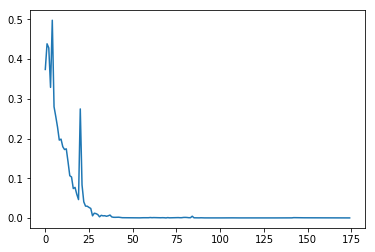

In [75]:
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)))

In [76]:
#np.diff(np.log(dfCN["cases"].values))

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: RuntimeWarning: invalid value encountered in log
  """Entry point for launching an IPython kernel.


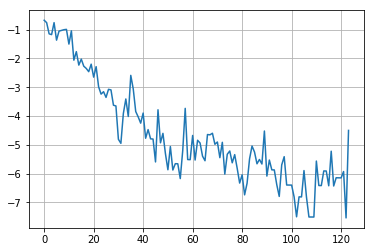

In [77]:
plt.plot(range(len(dfLT["cases"].values[3:])-1),np.log(np.diff(np.log(dfLT["cases"].values[3:]))))
plt.grid()

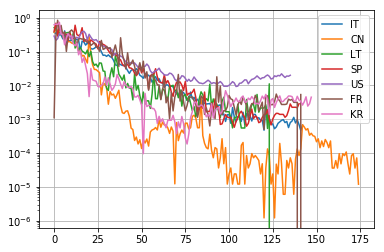

In [78]:
plt.plot(range(len(dfIT["cases"].values)-1),np.diff(np.log(dfIT["cases"].values))[:],label='IT')
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)),label='CN')
plt.plot(range(len(dfLT["cases"].values)-4),np.diff(np.log(dfLT["cases"].values))[3:],label='LT')
plt.plot(range(len(dfSP["cases"].values)-1),np.diff(np.log(dfSP["cases"].values)),label='SP')
plt.plot(range(len(dfUS["cases"].values)-1),np.diff(np.log(dfUS["cases"].values)),label='US')
plt.plot(range(len(dfFR["cases"].values)-10),np.diff(np.log(dfFR["cases"].values))[9:],label='FR')
plt.plot(range(len(dfKR["cases"].values)-4),np.diff(np.log(dfKR["cases"].values))[3:],label='KR')
plt.yscale('log')
plt.grid()
plt.legend()
plt.show()

136 136
coefficient of determination: 0.7350175292746906
intercept: -10.93443251889741
slope: [-0.07956707]


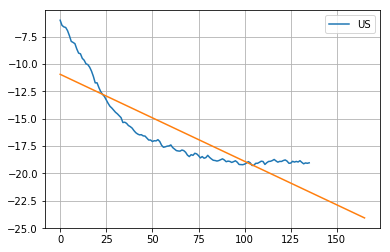

In [79]:
y = np.log(np.diff(dfUS["cases"].values)[:]/dfUS["cases"].values[1:]**2)
x = np.array(range(len(dfUS["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='US')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+30) 
plt.plot(range(len(x)+30),y_pred11)
plt.grid()
plt.legend()
plt.savefig("pictures/logdiffUS.png")
plt.show()

In [80]:
#np.diff(dfIT["cases"])

143 143
coefficient of determination: 0.8586151080431993
intercept: -10.869488856775838
slope: [-0.07588244]


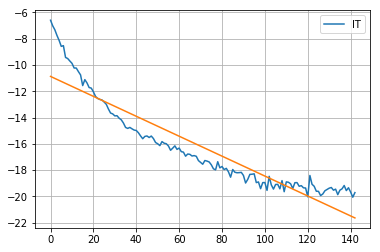

In [81]:
y = np.log(np.diff(dfIT["cases"].values)[:]/dfIT["cases"].values[1:]**2)
x = np.array(range(len(dfIT["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='IT')
y_pred12 = model.intercept_ + model.coef_ * range(len(x)) 
plt.plot(x,y_pred12)
plt.grid()
plt.legend()
plt.show()

In [82]:
#model11.coef_

In [83]:
#np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)

125 125
coefficient of determination: 0.8668126245694038
intercept: -15.727277491545323
slope: [-0.04589807]


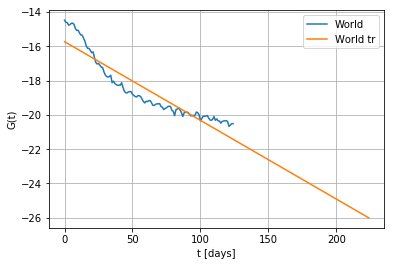

In [84]:
y = np.log(np.diff(dfW["cases"].values)[50:]/dfW["cases"].values[51:]**2)
x = np.array(range(len(dfW["cases"].values[50:])-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='World')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+100)
plt.plot(range(len(x)+100),y_pred11,label='World tr')
plt.legend()
plt.xlabel('t [days]')
plt.ylabel('G(t)')
plt.grid()
plt.savefig("pictures/logdifflogcoronaW.png")

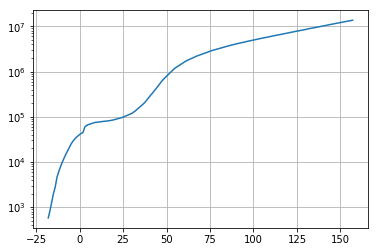

In [85]:
waveform_1 = dfW['cases'].values
waveform_A = dfW['active'].values
t = np.arange(-18,len(waveform_1)-18)
plt.plot(t, waveform_1) 
plt.yscale("log")
plt.grid()
plt.show()

In [86]:
dfW['cases'].values

array([     580,      845,     1317,     2015,     2800,     4581,
           6058,     7813,     9823,    11950,    14553,    17391,
          20630,    24545,    28266,    31439,    34876,    37552,
          40553,    43099,    45134,    59287,    64438,    67100,
          69197,    71329,    73332,    75184,    75700,    76677,
          77673,    78651,    79205,    80087,    80828,    81820,
          83112,    84615,    86604,    88585,    90443,    93016,
          95314,    98425,   102050,   106099,   109991,   114381,
         118948,   126214,   134576,   145483,   156653,   169593,
         182490,   198238,   218822,   244933,   275597,   305036,
         337489,   378860,   422629,   471035,   531864,   596366,
         663079,   723279,   784738,   858355,   936237,  1016330,
        1117928,  1203058,  1274578,  1347566,  1432869,  1519195,
        1605277,  1700004,  1780713,  1853505,  1925330,  2000065,
        2084633,  2183942,  2252370,  2332650,  2407467,  2482

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in exp
  after removing the cwd from sys.path.
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in true_divide
  after removing the cwd from sys.path.
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


[ 3.91270479e+07  8.49400530e-01 -2.07141697e+02  1.35800693e-02]


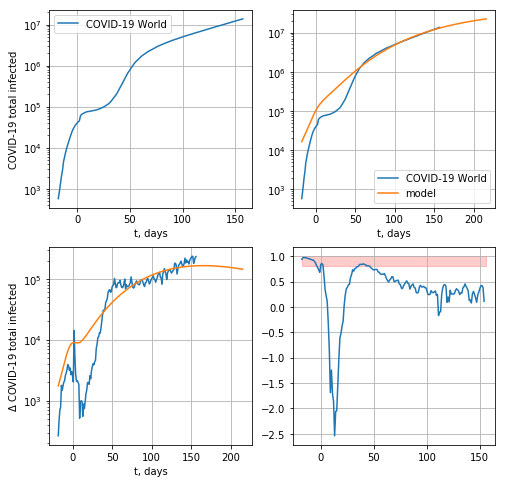

236946.94855650788


In [87]:
def model(t, coeffs):
    coeffsCN = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
    #coeffsCN = [2.06174475e+06, 1.67277852e-01, 5.36255447e+01]
    return coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3]) + coeffsCN[0]/(1 + np.exp( - coeffsCN[1] * (t - coeffsCN[2])))

x0 = np.array([2.06174475e+06, 1.67277852e-01, 5.36255447e+01, 0.9 ], dtype=float)
#x0 = np.array([8.08757112e+04,  2.24114193e-01, -6.94900467e-01 ], dtype=float)
def residuals(coeffs, y, t):
    return y - model(t, coeffs)
from scipy.optimize import leastsq
x, flag = leastsq(residuals, x0, args=(waveform_1, t))
print(x)
tt = np.arange(-18,len(waveform_1)-18+59)
fig, ((ax3,ax1),(ax2,ax4)) = plt.subplots(2,2,figsize=(8,8), sharex=False, sharey=False)
ax3.plot(t, waveform_1) 
ax3.legend(['COVID-19 World']) 
ax3.set_xlabel('t, days')
ax3.set_yscale("log")
ax3.set_ylabel(r'COVID-19 total infected')
ax3.grid()
ax1.plot(t, waveform_1, tt, model(tt, x)) 
ax1.legend(['COVID-19 World', 'model']) 
ax1.set_xlabel('t, days')
ax1.set_yscale("log")
ax1.grid()
ax2.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(model(tt, x)))
ax2.set_ylabel(r'$\Delta$ COVID-19 total infected')
ax2.set_yscale("log")
ax2.grid()
ax2.set_xlabel('t, days')
z = np.diff(moving_average(waveform_A, n=3) )/np.diff(moving_average(waveform_1, n=3))
ax4.plot(t[:-3],z)
#ax4.axhline(y=2.2587741081036339/2, color='r')
ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
#ax4.set_yscale("log")
ax4.grid()
plt.savefig("pictures/covidworld.png")

plt.show()
print(np.std(residuals(x, waveform_1, t)))
#expPopWorld = x[0]
expPopWorld = 2.67152730e+06

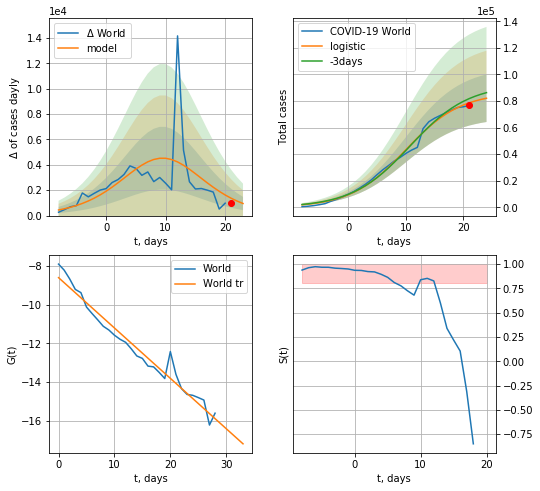

World data at: 2020-07-15
+3 day model MAPE: 0.04256770161128604
model: logistic
coeffs:  [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.2178111789766563
forecast at the end of period: +3 days
	 deltaDaycases:  952
	 total cases:  82121 ± 17886
	 total death:  3518 ± 2298
trend coefficient of determination: 0.960820
 intercept: -8.598458
 slope: -0.260482


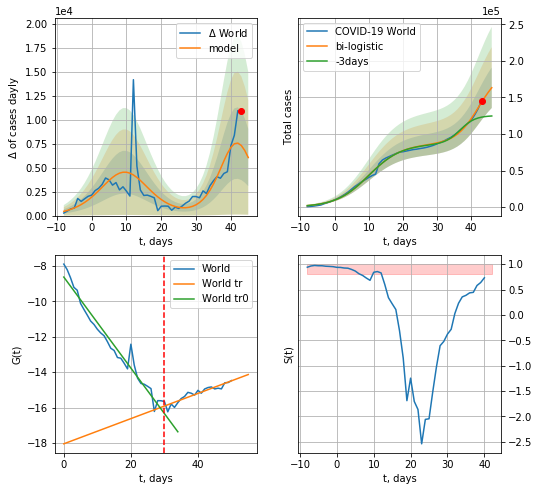

World data at: 2020-07-15
+3 day model MAPE: 0.2157297639626565
model: bi-logistic
coeffs:  [1.02227608e+05 2.95650820e-01 4.22366999e+01] [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.16992860985061978
forecast at the end of period: +3 days
	 deltaDaycases:  6044
	 total cases:  163366 ± 27760
	 total death:  6999 ± 3567
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend coefficient of determination: 0.868835
 intercept: -18.049568
 slope: 0.071157


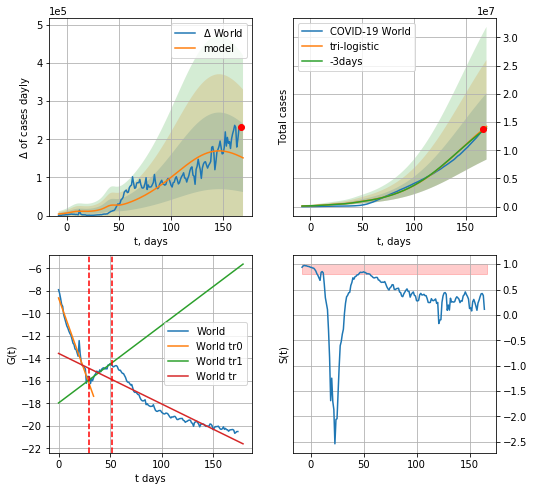

World data at: 2020-07-15
+3 day model MAPE: 0.01906242804489052
model: tri-logistic
coeffs:  [1.83567659e+07 3.42805147e-02 1.42590270e+02] [8.64735804e+04 2.09600360e-01 9.98515269e+00 1.02227608e+05
 2.95650820e-01 4.22366999e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.41363715020730113
forecast at the end of period: +3 days
	 deltaDaycases:  151225
	 total cases:  14221803 ± 5882666
	 total death:  609366 ± 756169
tri-logistic approximation splitting points: 30,52
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend1 coefficient of determination: 0.872494
 intercept: -17.970431
 slope: 0.068998
trend coefficient of determination: 0.863287
 intercept: -13.562267
 slope: -0.044923


In [88]:
vL = 30
x = forecast("World",dfW[:vL],d1,7*16-dT,1.0,False)
xx = forecast2("World",dfW[:52],d1,7*16-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("World",dfW,d1,7*16-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,52])

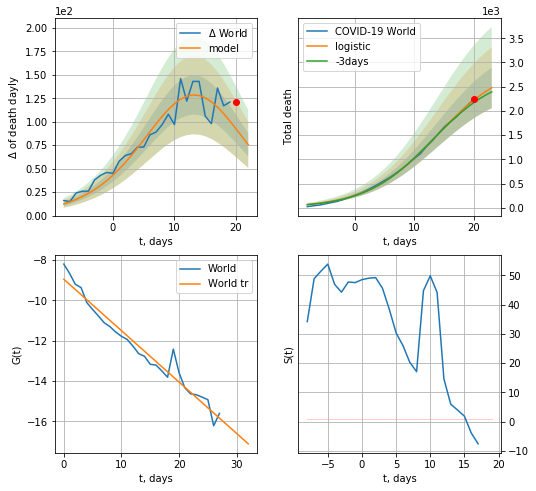

World data at: 2020-07-15
+3 day model MAPE: 0.027312192470115494
model: logistic
coeffs:  [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.16928081921473714
forecast at the end of period: +3 days
	 total death:  2476 ± 419
trend coefficient of determination: 0.959176
 intercept: -8.958870
 slope: -0.254930


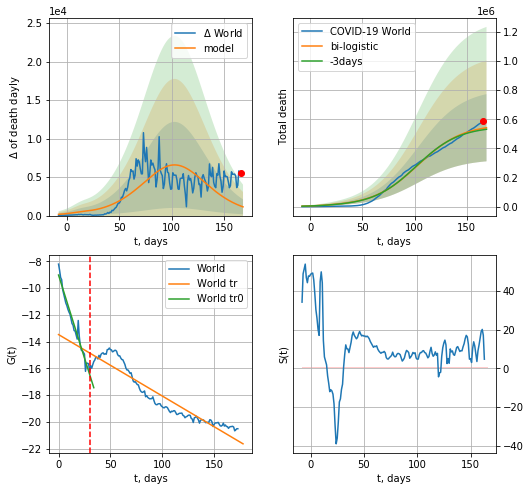

World data at: 2020-07-15
+3 day model MAPE: 0.019582969126302228
model: bi-logistic
coeffs:  [5.63841321e+05 4.66749654e-02 1.03123260e+02] [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.4258668316596137
forecast at the end of period: +3 days
	 deltaDaydeath:  1134
	 total death:  541912 ± 230782
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.960969
 intercept: -9.026339
 slope: -0.247583
trend coefficient of determination: 0.894669
 intercept: -13.475110
 slope: -0.045863


In [89]:
vL = 30
vL1=52
x = forecast("World",dfW[1:vL],d1,7*16-dT,1.0,False,cases='death')
xx = forecast2("World",dfW[1:],d1,7*16-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("World",dfW,d1,7*20-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

In [90]:
#vL = 30
#x = forecast("World",dfW[:vL],d1,7*9-dT,1.0,False)
#xx = forecast2("World",dfW,d1,7*15-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.7],vL=vL)
#trend(dfW,"W",10)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


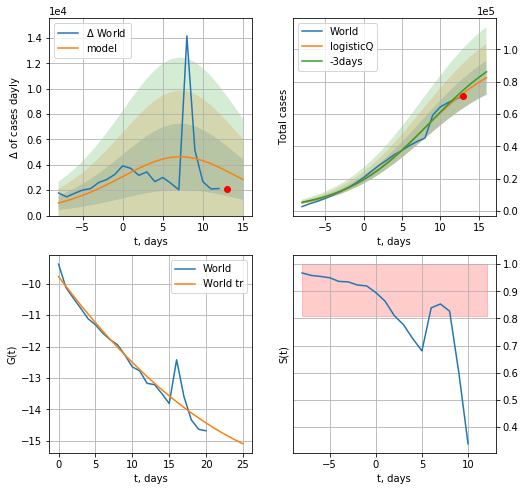

World data at: 2020-07-15
+3 day model MAPE: 0.031802
model: logisticQ
coeffs: [ 9.98643255e+04  1.79652646e-05  7.63889680e+00 -1.03375904e+04]
rational stdev: 0.126959
forecast at the end of period: +3 days
	 deltaDaycases: 2839
	 total cases: 82454 ± 10468
	 total death: 3532 ± 1345
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


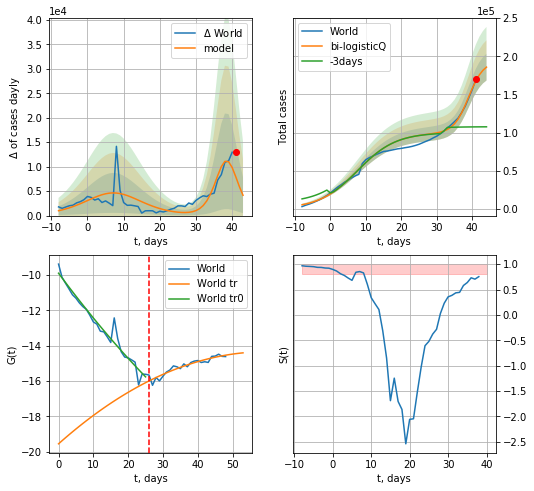

World data at: 2020-07-15
+3 day model MAPE: 0.635593
model: bi-logisticQ
coeffs: [ 9.37578627e+04  2.55228565e-05  3.89552969e+01 -1.87082152e+04]
rational stdev: 0.094698
forecast at the end of period: +3 days
	 deltaDaycases: 4152
	 total cases: 185813 ± 17596
	 total death: 7961 ± 2261
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.893677
 intercept_: -19.558019139425994
 coeffs_: [ 0.          0.17538587 -0.00147405]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:435: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


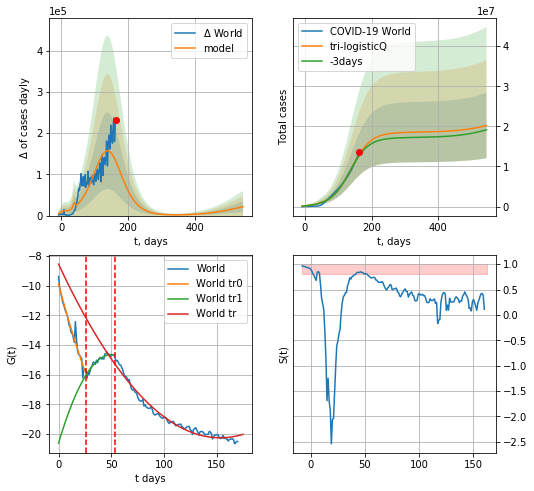

World data at: 2020-07-15
+3 day model MAPE: 0.024654
model: tri-logisticQ
coeffs: [ 1.83284898e+07  2.10587753e-07  1.38529836e+02 -1.62885493e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.404747
forecast at the end of period: +381 days
	 deltaDaycases: 21612
	 total cases: 20227193 ± 8186899
	 total death: 866681 ± 1052360
tri-logisticQ approximation splitting points: 26,54
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.900515
 intercept_: -20.622215746086294
 coeffs_: [ 0.          0.23801537 -0.00236922]
trend coefficient of determination: 0.975528
 intercept_: -8.536085020943858
 coeffs_: [ 0.         -0.15289176  0.00049829]


In [91]:
vL=30 - 4
vL1=59 - 5
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
x = forecastRRR("World",dfW[4:vL],d1,7*16-dT,1.0,False)
xx = forecast2RRR("World",dfW[4:vL1],d1,7*16-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*70-dT, xx, shift=1.,addpred=True,xcoef=koreaCoeffs,vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


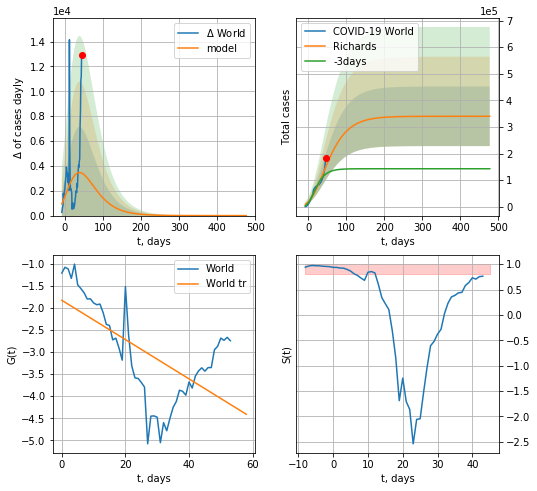

World data at: 2020-07-15
+3 day model MAPE: 0.241624
model: Richards
coeffs: [ 3.40077948e+05  3.51040118e+00 -1.35212982e+02  7.92067107e-03]
rational stdev: 0.329278
forecast at the end of period: +431 days
	 deltaDaycases: 0
	 total cases: 340076 ± 111979
	 total death: 14571 ± 14393
trend coefficient of determination: 0.389866
 intercept: -1.829818
 slope: -0.044449


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


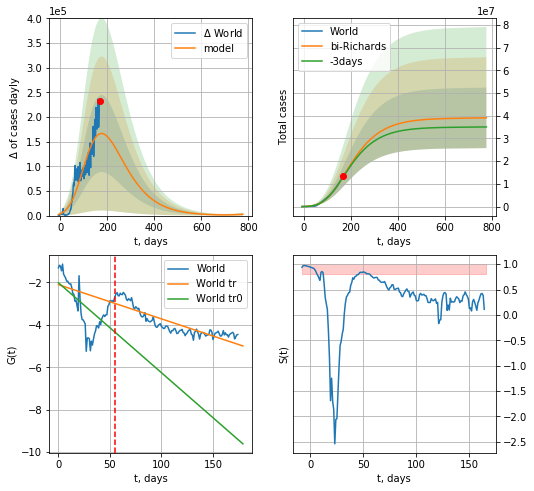

World data at: 2020-07-15
+3 day model MAPE: 0.015235
model: bi-Richards
coeffs: [ 3.86858828e+07  5.11822619e-01 -1.42243637e+02  2.31088295e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.341115
forecast at the end of period: +611 days
	 deltaDaycases: 2550
	 total cases: 39108246 ± 13340406
	 total death: 1675684 ± 1714802
bi-Richards approximation splitting point: 55
trend coefficient of determination: 0.364614
 intercept: -2.018627
 slope: -0.042396
trend coefficient of determination: 0.757272
 intercept: -2.105865
 slope: -0.016145


In [92]:
vL = 55
x = forecastRR("World",dfW[:vL],d1,60*9-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("World",dfW[:],d1,80*9-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

176


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


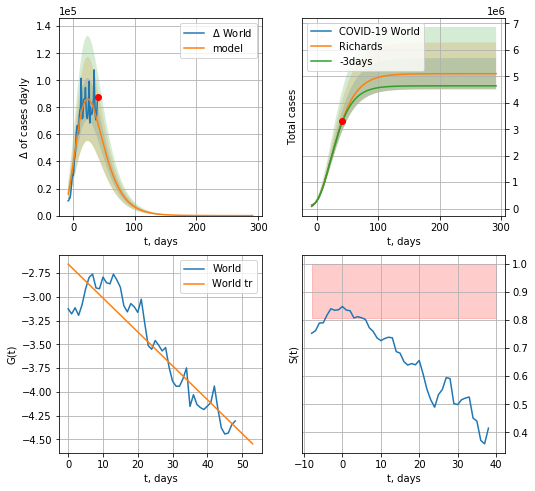

World data at: 2020-07-15
+3 day model MAPE: 0.014871
model: Richards
coeffs: [ 5.10254335e+06  1.04395582e+00 -4.20545297e+01  4.49970923e-02]
rational stdev: 0.115529
forecast at the end of period: +251 days
	 deltaDaycases: 0
	 total cases: 5102525 ± 589488
	 total death: 218629 ± 75773
trend coefficient of determination: 0.854892
 intercept: -2.655636
 slope: -0.035656


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


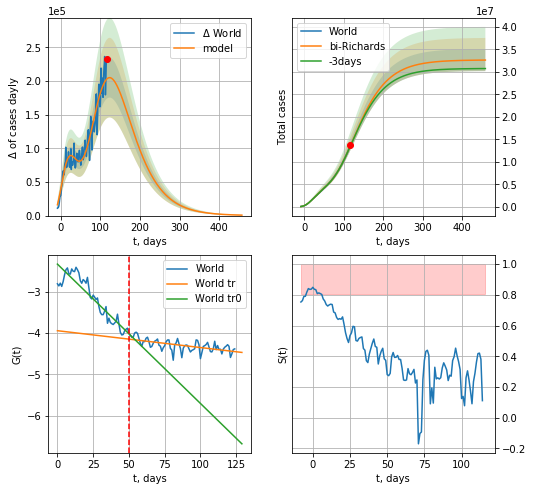

World data at: 2020-07-15
+3 day model MAPE: 0.005268
model: bi-Richards
coeffs: [ 2.75457791e+07  1.09120879e+00 -7.21357125e+01  1.85188936e-02]
rational stdev: 0.075251
forecast at the end of period: +341 days
	 deltaDaycases: 674
	 total cases: 32615240 ± 2454313
	 total death: 1397476 ± 315482
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.843163
 intercept: -2.335963
 slope: -0.033634
trend coefficient of determination: 0.374731
 intercept: -3.943765
 slope: -0.004064


In [93]:
print (len(dfW))
vL = 100
x = forecastRR("World",dfW[50:vL],d1,40*9-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("World",dfW[50:],d1,50*9-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-50)
#x = forecastQR("World",dfW[50:],d1,30*9-dT,1.0,addpred=False)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


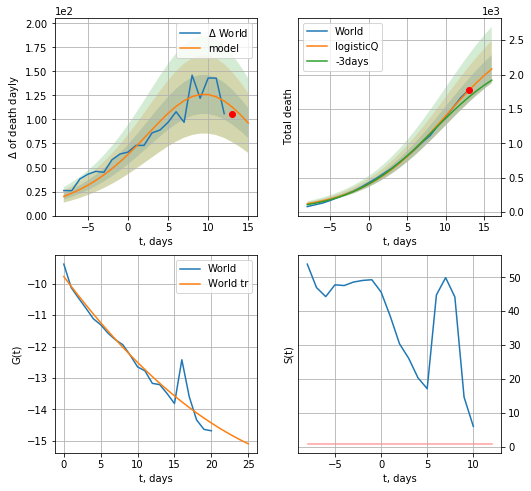

World data at: 2020-07-15
+3 day model MAPE: 0.067194
model: logisticQ
coeffs: [ 2.67019299e+03  8.28077677e-04  9.49653382e+00 -2.18469917e+02]
rational stdev: 0.098000
forecast at the end of period: +3 days
	 total death: 2081 ± 203
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


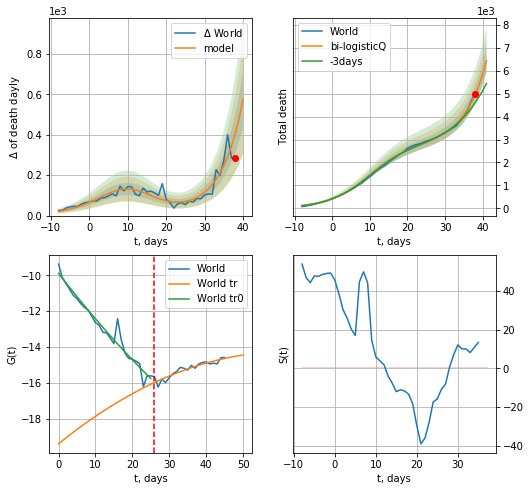

World data at: 2020-07-15
+3 day model MAPE: 0.105655
model: bi-logisticQ
coeffs: [ 6.42204134e+06  6.90051546e-04  7.95652837e+01 -2.38689793e+02]
rational stdev: 0.076590
forecast at the end of period: +3 days
	 total death: 6424 ± 492
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.866834
 intercept_: -19.41123113056416
 coeffs_: [ 0.          0.16686573 -0.0013545 ]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:435: RuntimeWarning: overflow encountered in exp


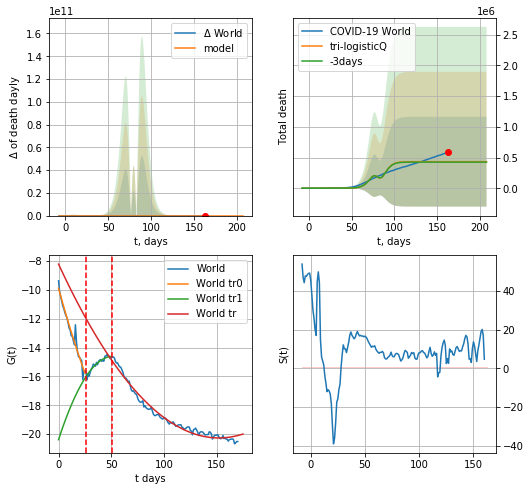

World data at: 2020-07-15
+3 day model MAPE: 0.016084
model: tri-logisticQ
coeffs: [-5.99198108e+06  1.39959335e-03 -9.27150884e+01  7.94907329e+01]
rational stdev: 1.689883
forecast at the end of period: +45 days
	 total death: 432730 ± 731263
tri-logisticQ approximation splitting points: 26,51
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.890965
 intercept_: -20.382525077358043
 coeffs_: [ 0.          0.22422642 -0.00217733]
trend coefficient of determination: 0.977818
 intercept_: -8.218206471545633
 coeffs_: [ 0.         -0.15835541  0.00052047]


In [94]:
vL=30 - 4
vL1=51
x = forecastRRR("World",dfW[4:vL],d1,7*16-dT,1.0,False,cases='death')
xx = forecast2RRR("World",dfW[4:vL1],d1,7*16-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*22-dT, xx, shift=1.,addpred=False,xcoef=[.35,.5,4.,1.],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


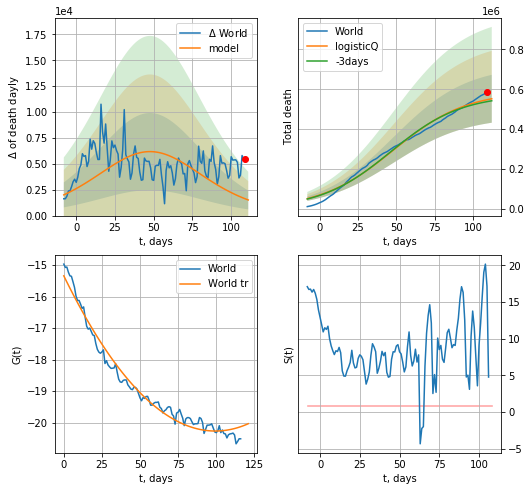

World data at: 2020-07-15
+3 day model MAPE: 0.018158
model: logisticQ
coeffs: [ 5.89897113e+05  3.81091691e-07  4.80425090e+01 -1.09952949e+05]
rational stdev: 0.217533
forecast at the end of period: +3 days
	 total death: 552142 ± 120109
trend coefficient of determination: 0.975528
 intercept_: -15.338787959059868
 coeffs_: [ 0.         -0.09909853  0.00049848]


In [95]:
x = forecastRRR("World",dfW[58:],d1,7*16-dT,1.0,False,cases='death')

In [96]:
#trend(dfSP,'SP',10)

In [97]:
#vL = len(dfSP[:])-16-dT
#x = forecast('Spain',dfSP[:vL],d1,30-dT,1.0)
#xx = forecast2('Spain',dfSP,d1,7*6-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.8],vL=vL)

SP
           date   cases  active    death
137 2020-07-11  301668       0  28403.0
138 2020-07-12  302349       0  28403.0
139 2020-07-13  303033       0  28406.0
140 2020-07-14  303699       0  28409.0
141 2020-07-15  304574       0  28413.0


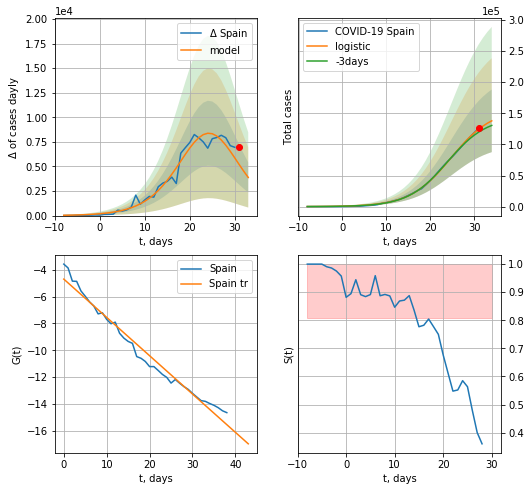

Spain data at: 2020-07-15
+3 day model MAPE: 0.04562669977631666
model: logistic
coeffs:  [1.56957534e+05 2.13812412e-01 2.47399190e+01]
rational stdev:  0.3648922799171356
forecast at the end of period: +3 days
	 deltaDaycases:  3876
	 total cases:  137914 ± 50323
	 total death:  12865 ± 14083
trend coefficient of determination: 0.974785
 intercept: -4.699916
 slope: -0.285083


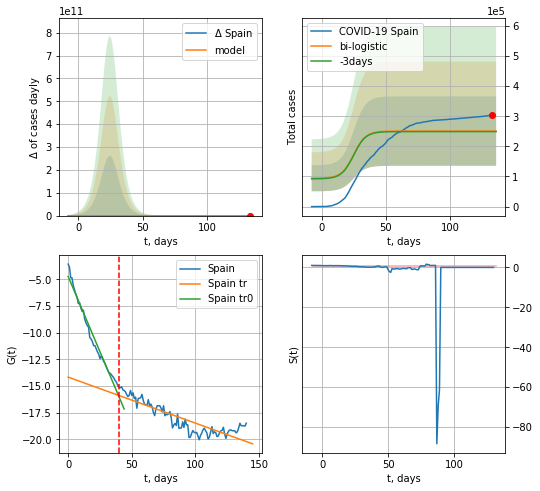

Spain data at: 2020-07-15
+3 day model MAPE: 0.007761777621132011
model: bi-logistic
coeffs:  [ 7.51748934e+04 -6.47534696e+00  1.67279469e+02] [1.56957534e+05 2.13812412e-01 2.47399190e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.45948595169415174
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  250926 ± 115297
	 total death:  23408 ± 32266
bi-logistic approximation splitting point: 40
trend0 coefficient of determination: 0.974598
 intercept: -4.739484
 slope: -0.281959
trend coefficient of determination: 0.760054
 intercept: -14.164793
 slope: -0.043052


In [98]:
dfSP = read_df(pd.DataFrame(),"SP")
vL = 40#len(dfSP[:])-7-dT
x = forecast('Spain',dfSP[:vL],d1,7*16-dT,1.0,cases='cases')
xx = forecast2('Spain',dfSP[:],d1,7*16-dT,x,1.0,addpred=True,xcoef=[.25,1.,1.6],vL=vL,cases='cases')

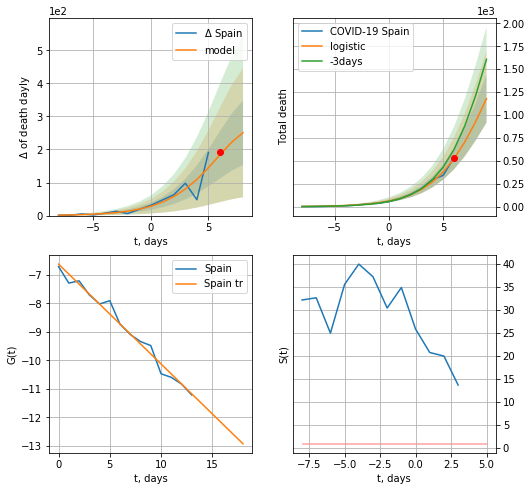

Spain data at: 2020-07-15
+3 day model MAPE: 0.1992580202993838
model: logistic
coeffs:  [2.74529349e+03 3.87912491e-01 9.73356455e+00]
rational stdev:  0.22139705331908888
forecast at the end of period: +3 days
	 total death:  1178 ± 260
trend coefficient of determination: 0.980020
 intercept: -6.621221
 slope: -0.350134


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:245: RuntimeWarning: invalid value encountered in true_divide


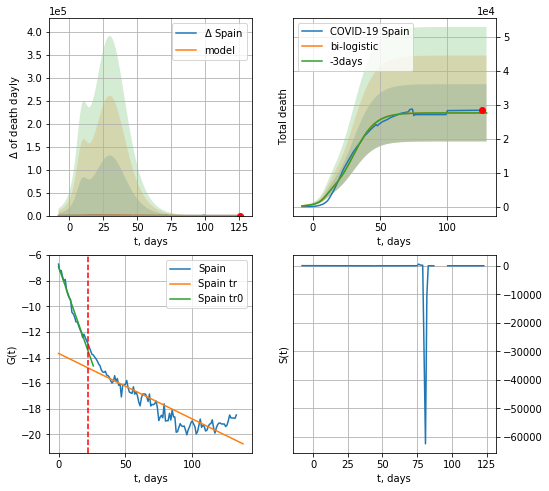

Spain data at: 2020-07-15
+3 day model MAPE: 0.0013444677127208103
model: bi-logistic
coeffs:  [2.49084553e+04 1.23179928e-01 3.02286383e+01] [2.74529349e+03 3.87912491e-01 9.73356455e+00]
rational stdev:  0.3053852860403537
forecast at the end of period: +3 days
	 deltaDaydeath:  0
	 total death:  27653 ± 8445
bi-logistic approximation splitting point: 22
trend0 coefficient of determination: 0.976968
 intercept: -6.910878
 slope: -0.297821
trend coefficient of determination: 0.808148
 intercept: -13.677840
 slope: -0.051109


In [99]:
vL = 22#len(dfSP[:])-7-dT
#dfSP = read_df(pd.DataFrame(),"SP")
x = forecast('Spain',dfSP[7:vL],d1,7*16-dT,1.0,cases='death')
xx = forecast2('Spain',dfSP[7:],d1,7*16-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.8],vL=vL,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


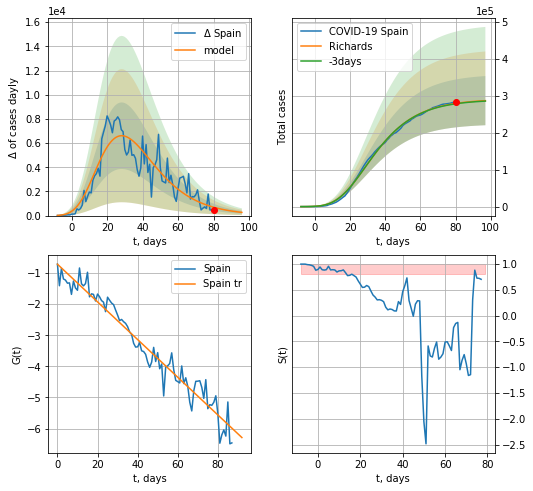

Spain data at: 2020-07-15
+3 day model MAPE: 0.003583
model: Richards
coeffs: [ 2.90610625e+05  9.41852610e+00 -5.22377391e+01  6.58781579e-03]
rational stdev: 0.231944
forecast at the end of period: +17 days
	 deltaDaycases: 264
	 total cases: 286442 ± 66438
	 total death: 26721 ± 18593
trend coefficient of determination: 0.950823
 intercept: -0.716096
 slope: -0.060553


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


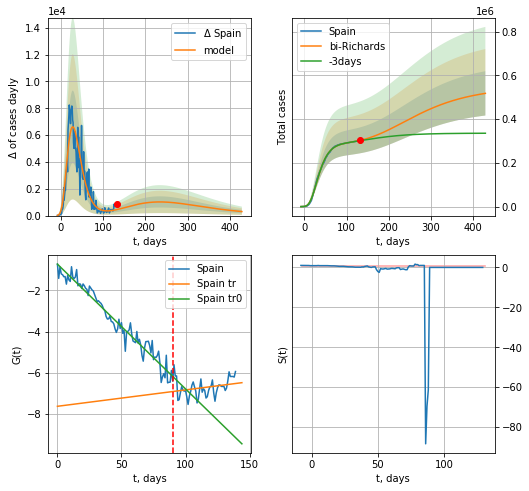

Spain data at: 2020-07-15
+3 day model MAPE: 0.005277
model: bi-Richards
coeffs: [ 2.56650569e+05  1.48981449e+00 -2.20605991e+02  7.26614418e-03]
rational stdev: 0.195616
forecast at the end of period: +297 days
	 deltaDaycases: 300
	 total cases: 517903 ± 101310
	 total death: 48313 ± 28352
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.953315
 intercept: -0.717201
 slope: -0.060739
trend coefficient of determination: 0.074662
 intercept: -7.637305
 slope: 0.007980


In [100]:
vL = 90+1
x = forecastRR('Spain',dfSP[1:vL-1],d1,7*18-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Spain',dfSP[1:],d1,7*58-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-1)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:75: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:75: RuntimeWarning: invalid value encountered in true_divide


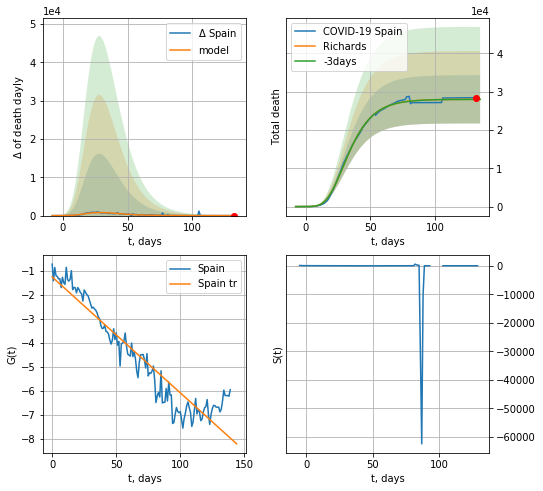

Spain data at: 2020-07-15
+3 day model MAPE: 0.000861
model: Richards
coeffs: [ 2.79906932e+04  8.81527099e+00 -3.16308048e+01  8.88495194e-03]
rational stdev: 0.224931
forecast at the end of period: +3 days
	 total death: 27983 ± 6294
trend coefficient of determination: 0.896169
 intercept: -1.258454
 slope: -0.048344


In [101]:
x = forecastRR('Spain',dfSP[1:],d1,7*16-dT,1.0,addpred=False,xcoef=[.25,1.,3.,1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


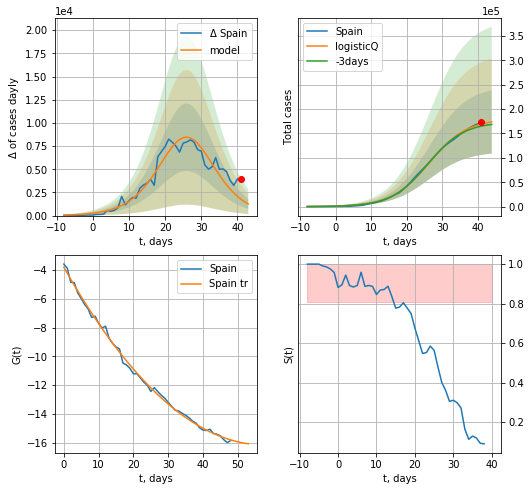

Spain data at: 2020-07-15
+3 day model MAPE: 0.028163
model: logisticQ
coeffs: [ 1.79944314e+05  4.82942779e-06  2.63952863e+01 -3.89581546e+04]
rational stdev: 0.373922
forecast at the end of period: +3 days
	 deltaDaycases: 1252
	 total cases: 173641 ± 64928
	 total death: 16198 ± 18170
trend coefficient of determination: 0.997334
 intercept_: -3.7990007659330134
 coeffs_: [ 0.         -0.42831531  0.00370949]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


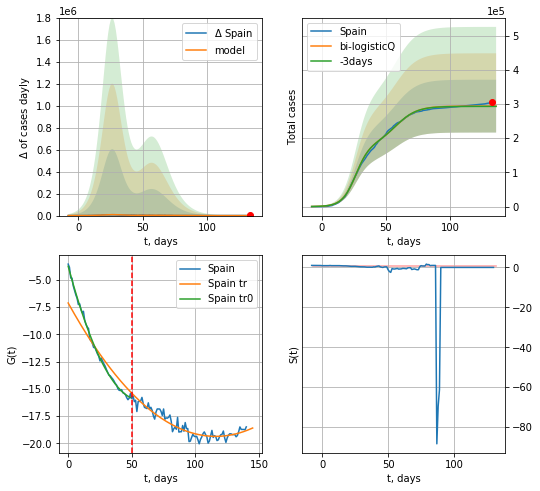

Spain data at: 2020-07-15
+3 day model MAPE: 0.002626
model: bi-logisticQ
coeffs: [ 1.13728718e+05  2.93094853e-07  5.79305385e+01 -4.09591114e+05]
rational stdev: 0.262789
forecast at the end of period: +3 days
	 deltaDaycases: 1
	 total cases: 293663 ± 77171
	 total death: 27395 ± 21597
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.997131
 intercept_: -3.7751216617675887
 coeffs_: [ 0.         -0.43240435  0.00381547]
trend coefficient of determination: 0.885620
 intercept_: -7.141030207840009
 coeffs_: [ 0.         -0.21047474  0.00090729]


In [102]:
x = forecastRRR('Spain',dfSP[:50],d1,7*16-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[:],d1,7*16-dT,x,1.0,addpred=False,xcoef=koreaCoeffs,vL=50)#[.35,.5,3.,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


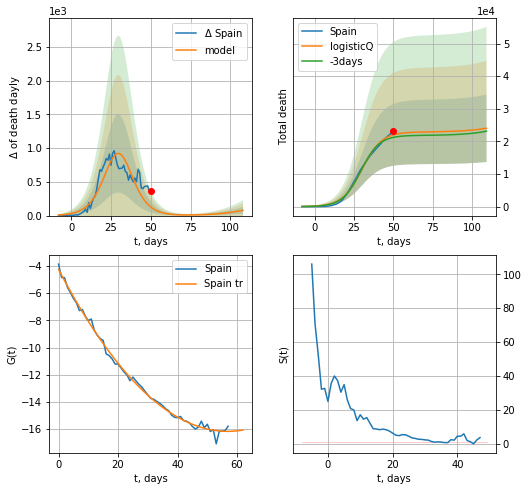

Spain data at: 2020-07-15
+3 day model MAPE: 0.037624
model: logisticQ
coeffs: [ 2.28798062e+04  1.92571131e-06  3.00460867e+01 -8.38155043e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.430820
forecast at the end of period: +59 days
	 total death: 24045 ± 10359
trend coefficient of determination: 0.995937
 intercept_: -4.2575122176431694
 coeffs_: [ 0.         -0.41856419  0.00368029]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:294: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:347: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:347: RuntimeWarning: invalid value encountered in true_divide


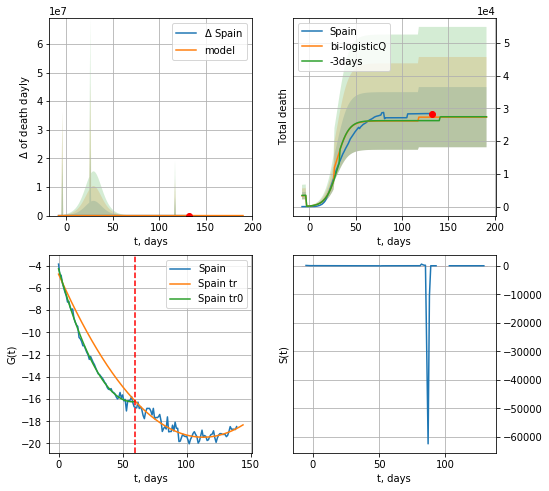

Spain data at: 2020-07-15
+3 day model MAPE: 0.040525
model: bi-logisticQ
coeffs: [3270.16272209    9.99716714   26.90939366   -3.58390747]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.336333
forecast at the end of period: +59 days
	 total death: 27308 ± 9184
bi-logisticQ approximation splitting point: 60
trend coefficient of determination: 0.995783
 intercept_: -4.28878212009627
 coeffs_: [ 0.         -0.41413346  0.00358475]
trend coefficient of determination: 0.849312
 intercept_: -4.773318924803615
 coeffs_: [ 0.         -0.25969022  0.00114983]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


In [103]:
x = forecastRRR('Spain',dfSP[1:60],d1,7*24-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[1:],d1,7*24-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,cases='death',vL=60)

In [104]:
#x = forecastQR('Spain',dfSP[5:],d1,7*16-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])

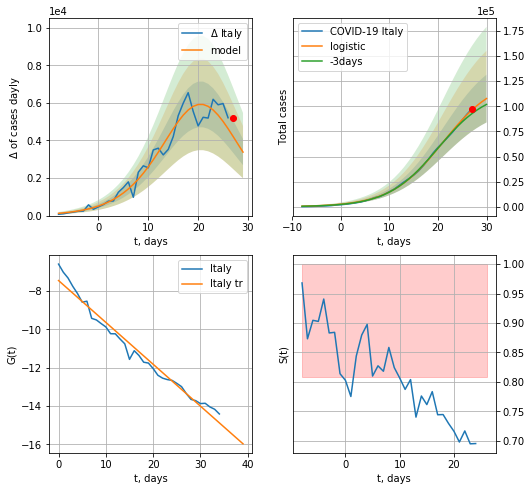

Italy data at: 2020-07-15
+3 day model MAPE: 0.045578378390248614
model: logistic
coeffs:  [1.28139025e+05 1.85112183e-01 2.10100292e+01]
rational stdev:  0.22065596678975638
forecast at the end of period: +3 days
	 deltaDaycases:  3378
	 total cases:  107738 ± 23773
	 total death:  15484 ± 10249
trend coefficient of determination: 0.974872
 intercept: -7.448746
 slope: -0.218671


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:189: RuntimeWarning: overflow encountered in exp


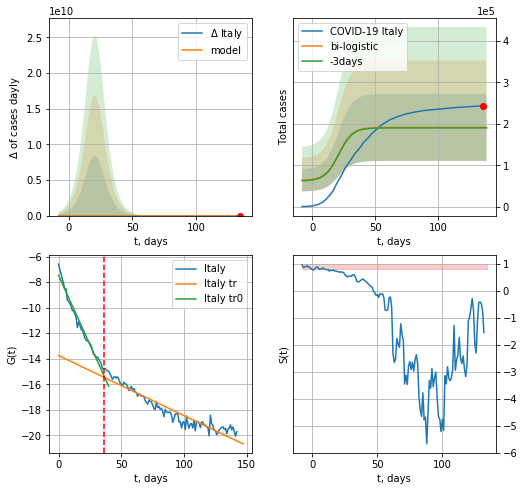

Italy data at: 2020-07-15
+3 day model MAPE: 0.005811876763073008
model: bi-logistic
coeffs:  [ 6.32449512e+04 -2.30834907e+00  1.59417679e+02] [1.28139025e+05 1.85112183e-01 2.10100292e+01]
rational stdev:  0.42248509385659133
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  191383 ± 80856
	 total death:  27505 ± 34861
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975965
 intercept: -7.466589
 slope: -0.217097
trend coefficient of determination: 0.910280
 intercept: -13.752096
 slope: -0.047016


In [105]:
vL = 36#len(dfIT)-6-dT
x = forecast('Italy',dfIT[:vL],d1,16*7-dT,1.0)
xx = forecast2('Italy',dfIT,d1,16*7-dT,x,1.0,vL=vL)

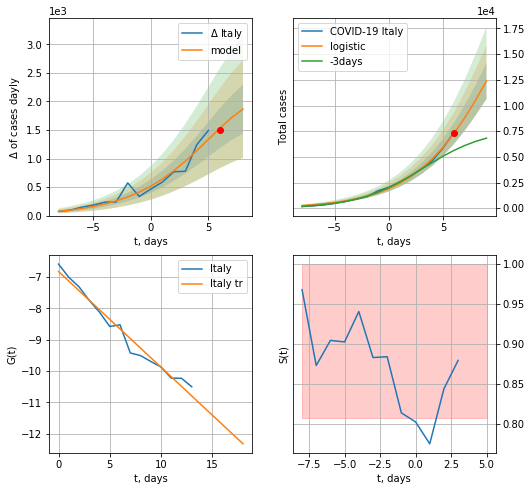

Italy data at: 2020-07-15
+3 day model MAPE: 0.44264442257961345
model: logistic
coeffs:  [3.14978181e+04 2.56455869e-01 1.06869163e+01]
rational stdev:  0.14147817336323687
forecast at the end of period: +3 days
	 deltaDaycases:  1866
	 total cases:  12394 ± 1753
	 total death:  1781 ± 755
trend coefficient of determination: 0.972594
 intercept: -6.827533
 slope: -0.305163


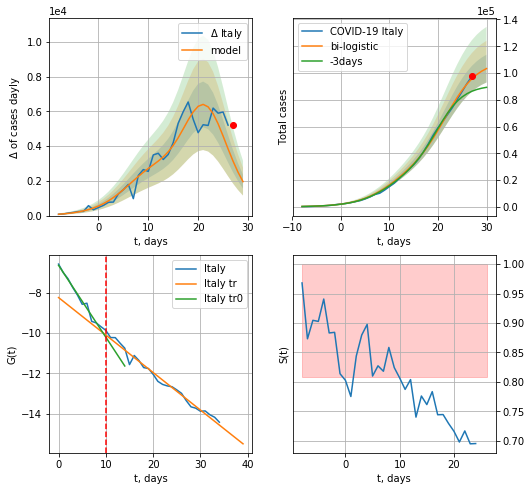

Italy data at: 2020-07-15
+3 day model MAPE: 0.1273932560599292
model: bi-logistic
coeffs:  [7.78644605e+04 3.07215535e-01 2.18188307e+01] [3.14978181e+04 2.56455869e-01 1.06869163e+01]
rational stdev:  0.10049358500066935
forecast at the end of period: +3 days
	 deltaDaycases:  1953
	 total cases:  103307 ± 10381
	 total death:  14847 ± 4476
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980937
 intercept: -6.650494
 slope: -0.355987
trend coefficient of determination: 0.983083
 intercept: -8.246651
 slope: -0.185682


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:305: RuntimeWarning: overflow encountered in exp


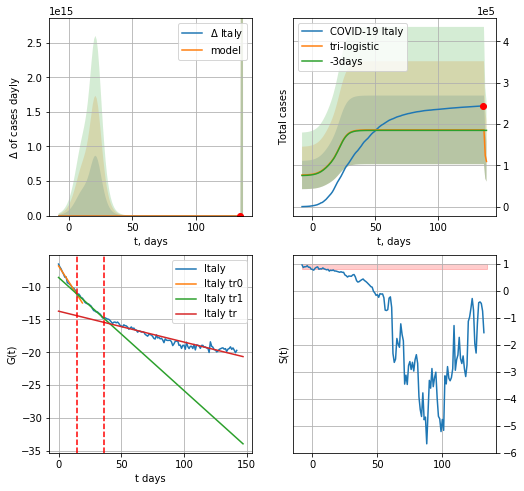

Italy data at: 2020-07-15
+3 day model MAPE: 0.006650124215478226
model: tri-logistic
coeffs:  [ 7.63390993e+04 -2.28497891e+01  1.36934795e+02] [3.14978181e+04 2.56455869e-01 1.06869163e+01 7.78644605e+04
 3.07215535e-01 2.18188307e+01]
forecast rational stdev:  0.4469329306700493
forecast at the end of period: +3 days
	 deltaDaycases:  -14041
	 total cases:  109362 ± 48877
	 total death:  15717 ± 21073
tri-logistic approximation splitting points: 15,36
trend0 coefficient of determination: 0.972806
 intercept: -6.865084
 slope: -0.296498
trend1 coefficient of determination: 0.980669
 intercept: -8.621660
 slope: -0.172200
trend coefficient of determination: 0.910280
 intercept: -13.752096
 slope: -0.047016


In [106]:
vL = 15#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*16-dT,1.0)
xx = forecast2('Italy',dfIT[:vL1],d1,7*16-dT,x,1.0)#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*16-dT, xx, shift=1.,addpred=False,xcoef=[.35,1.,1.5],vL=[vL,vL1])

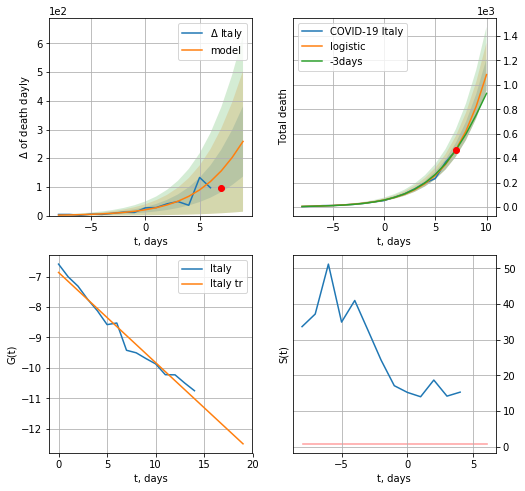

Italy data at: 2020-07-15
+3 day model MAPE: 0.04050471838994123
model: logistic
coeffs:  [8.02160580e+03 3.09188022e-01 1.60041165e+01]
rational stdev:  0.12009380059110428
forecast at the end of period: +3 days
	 total death:  1083 ± 130
trend coefficient of determination: 0.972806
 intercept: -6.865084
 slope: -0.296498


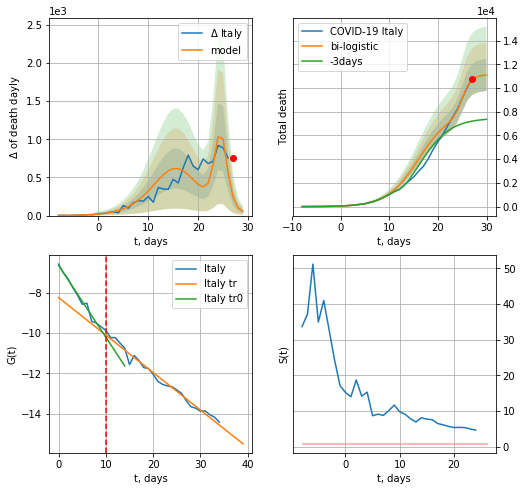

Italy data at: 2020-07-15
+3 day model MAPE: 0.5045455507817326
model: bi-logistic
coeffs:  [3.18991891e+03 1.24679374e+00 2.50159525e+01] [8.02160580e+03 3.09188022e-01 1.60041165e+01]
rational stdev:  0.12176249997037505
forecast at the end of period: +3 days
	 deltaDaydeath:  52
	 total death:  11100 ± 1351
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980937
 intercept: -6.650494
 slope: -0.355987
trend coefficient of determination: 0.983083
 intercept: -8.246651
 slope: -0.185682


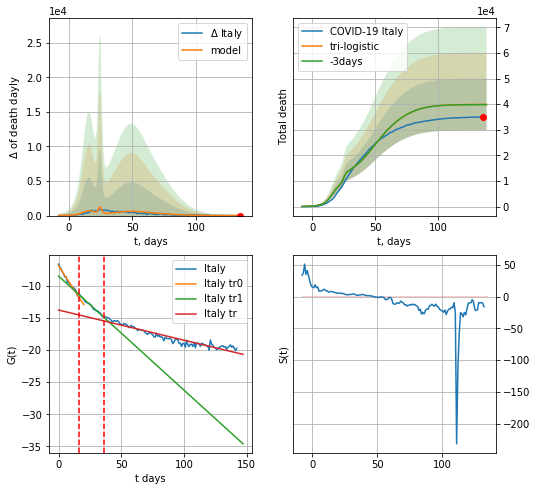

Italy data at: 2020-07-15
+3 day model MAPE: 0.001737150052840213
model: tri-logistic
coeffs:  [2.29474153e+04 1.00608401e-01 4.81408270e+01] [8.02160580e+03 3.09188022e-01 1.60041165e+01 3.18991891e+03
 1.24679374e+00 2.50159525e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.25297296038642114
forecast at the end of period: +3 days
	 deltaDaydeath:  1
	 total death:  39885 ± 10089
tri-logistic approximation splitting points: 16,36
trend0 coefficient of determination: 0.976775
 intercept: -6.838969
 slope: -0.302094
trend1 coefficient of determination: 0.986358
 intercept: -8.457993
 slope: -0.177909
trend coefficient of determination: 0.910280
 intercept: -13.752096
 slope: -0.047016


In [107]:
vL = 16#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*16-dT,1.0,cases='death')
xx = forecast2('Italy',dfIT[:vL1],d1,7*16-dT,x,1.0,cases='death')#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*16-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


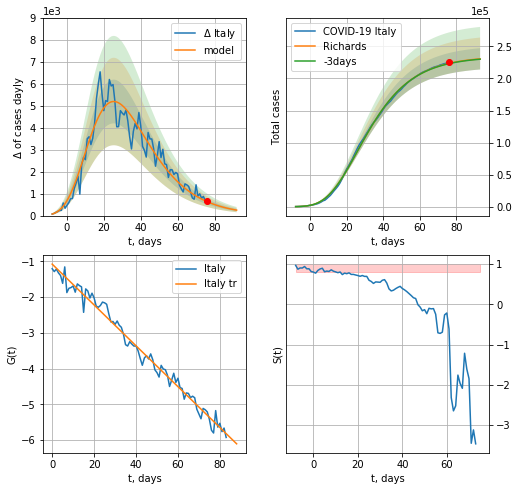

Italy data at: 2020-07-15
+3 day model MAPE: 0.002012
model: Richards
coeffs: [ 2.34596587e+05  6.64180367e+00 -5.19122393e+01  9.09835512e-03]
rational stdev: 0.071989
forecast at the end of period: +17 days
	 deltaDaycases: 248
	 total cases: 230574 ± 16598
	 total death: 33138 ± 7156
trend coefficient of determination: 0.983172
 intercept: -1.077922
 slope: -0.057075


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


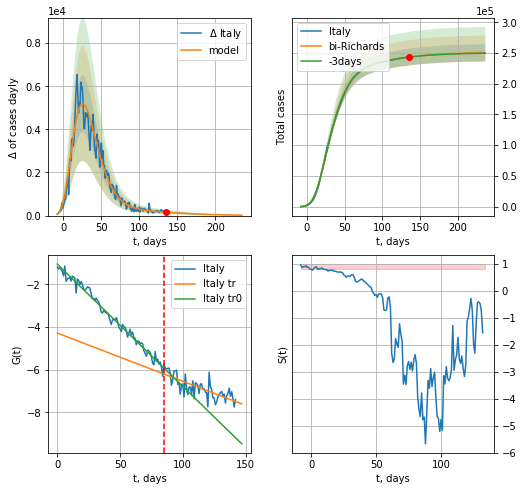

Italy data at: 2020-07-15
+3 day model MAPE: 0.000464
model: bi-Richards
coeffs: [ 1.63840937e+04  3.97613499e+00 -7.87391195e+01  6.53383247e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.056119
forecast at the end of period: +101 days
	 deltaDaycases: 17
	 total cases: 250290 ± 14046
	 total death: 35972 ± 6056
bi-Richards approximation splitting point: 85
trend coefficient of determination: 0.982615
 intercept: -1.046423
 slope: -0.057287
trend coefficient of determination: 0.564271
 intercept: -4.278227
 slope: -0.022590


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


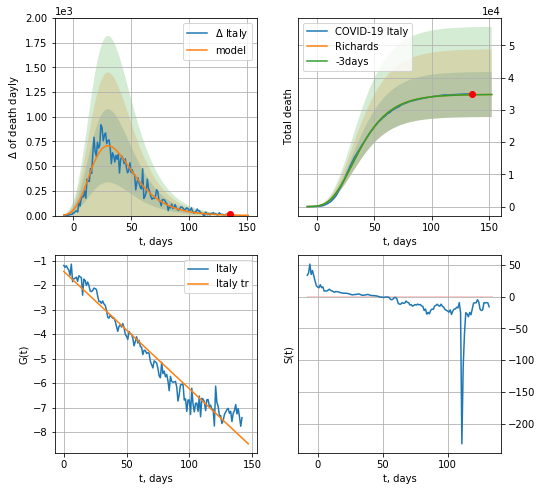

Italy data at: 2020-07-15
+3 day model MAPE: 0.000597
model: Richards
coeffs: [ 3.48270004e+04  7.33340260e+00 -5.75859173e+01  7.55083568e-03]
rational stdev: 0.200888
forecast at the end of period: +17 days
	 total death: 34784 ± 6987
trend coefficient of determination: 0.958124
 intercept: -1.441245
 slope: -0.047856


In [108]:
vL=85
x = forecastRR('Italy',dfIT[:vL],d1,18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Italy',dfIT[:],d1,30*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRR('Italy',dfIT[:],d1,18*7-dT,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


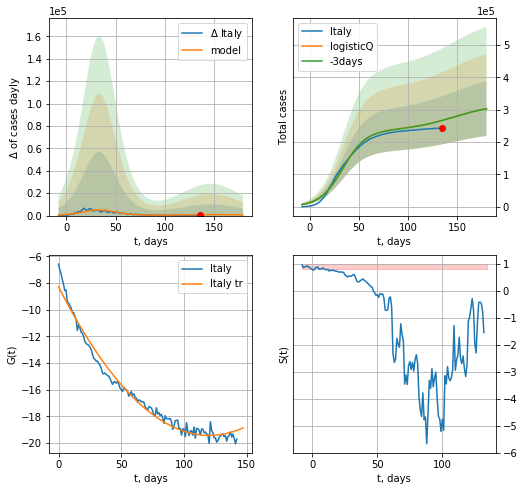

Italy data at: 2020-07-15
+3 day model MAPE: 0.001015
model: logisticQ
coeffs: [ 2.35653192e+05  2.37808785e-07  3.36012024e+01 -3.60376666e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.278034
forecast at the end of period: +45 days
	 deltaDaycases: 562
	 total cases: 303210 ± 84302
	 total death: 43577 ± 36347
trend coefficient of determination: 0.980059
 intercept_: -8.290287461890598
 coeffs_: [ 0.         -0.18563723  0.00077293]


In [109]:
x = forecastRRR('Italy',dfIT[:],d1,7*22-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


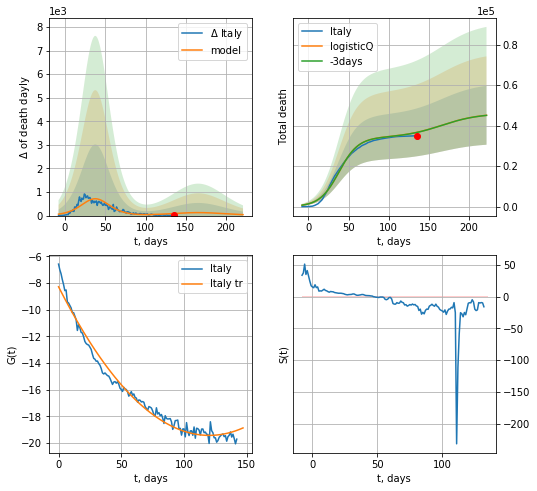

Italy data at: 2020-07-15
+3 day model MAPE: 0.001246
model: logisticQ
coeffs: [ 3.40951551e+04  2.12701587e-07  3.80440752e+01 -3.93041538e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.322489
forecast at the end of period: +87 days
	 total death: 45131 ± 14554
trend coefficient of determination: 0.980059
 intercept_: -8.290287461890598
 coeffs_: [ 0.         -0.18563723  0.00077293]


In [110]:
x = forecastRRR('Italy',dfIT[:],d1,7*28-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

In [111]:
dT

109

FR
           date     cases  active    death
147 2020-07-11  171292.0   62360  30004.0
148 2020-07-12  171833.0   62360  30004.0
149 2020-07-13  172377.0   63751  30029.0
150 2020-07-14  172840.0   63751  30029.0
151 2020-07-15  173304.0   64364  30120.0


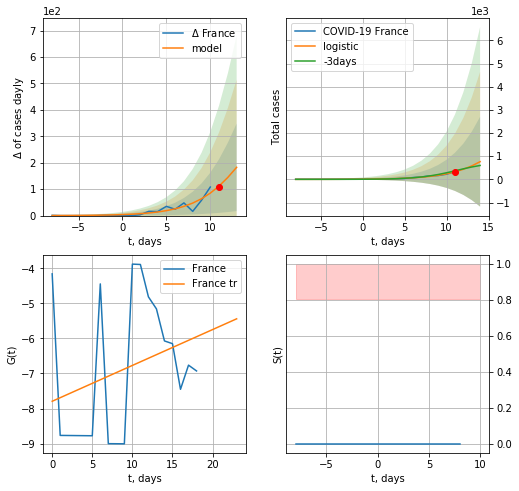

France data at: 2020-07-15
+3 day model MAPE: 0.04053337370546569
model: logistic
coeffs:  [4.17383165e+03 3.25568771e-01 1.85949028e+01]
rational stdev:  2.5390562100826064
forecast at the end of period: +3 days
	 deltaDaycases:  182
	 total cases:  763 ± 1939
	 total death:  132 ± 1005
trend coefficient of determination: 0.083417
 intercept: -7.793073
 slope: 0.102246


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


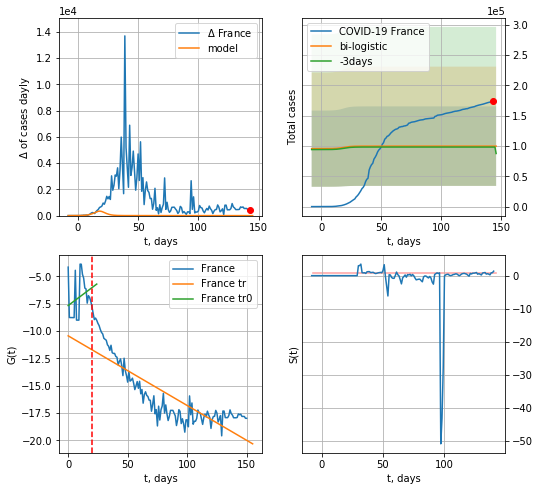

France data at: 2020-07-15
+3 day model MAPE: 0.015016780892919357
model: bi-logistic
coeffs:  [ 9.54621726e+04 -5.66526522e+00  1.47848282e+02] [4.17383165e+03 3.25568771e-01 1.85949028e+01]
rational stdev:  0.6572719332387884
forecast at the end of period: +3 days
	 deltaDaycases:  -2
	 total cases:  99633 ± 65486
	 total death:  17316 ± 34143
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.062178
 intercept: -7.670498
 slope: 0.081817
trend coefficient of determination: 0.713705
 intercept: -10.439911
 slope: -0.063724


In [113]:
# prideta 1990 2020-04-17
# prideta 3824 2020-04-18
dfFR = read_df(pd.DataFrame(),"FR")
vL=20
try:
    x = forecast('France',dfFR[:vL],d1,16*7-dT,1.0)
    xx = forecast2('France',dfFR,d1,16*7-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.5],vL=vL)
except:
    print ("Exception occurs")

In [114]:
#vL=len(dfFR)-9-5-dT
#x = forecast('France',dfFR[10:-9-dT],d1,7*5-dT-4,1.0)
#xx = forecast2('France',dfFR[10:],d1,7*7-dT-4,x,1.0,addpred=True,xcoef=[.25,1.,1.4],vL=vL)

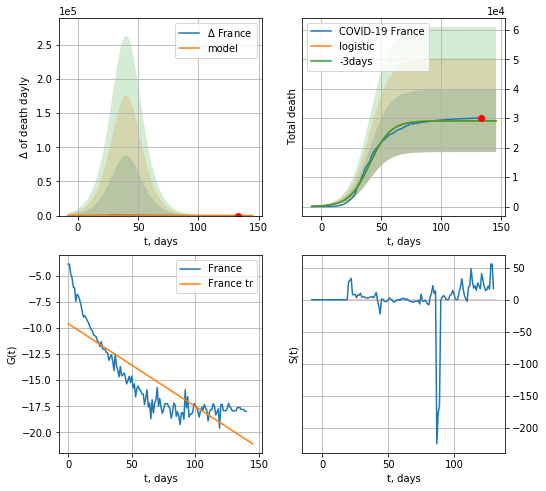

France data at: 2020-07-15
+3 day model MAPE: 0.0017514604090972039
model: logistic
coeffs:  [2.91288564e+04 1.16225142e-01 4.05723514e+01]
rational stdev:  0.36442806768021657
forecast at the end of period: +13 days
	 total death:  29128 ± 10615
trend coefficient of determination: 0.730038
 intercept: -9.592171
 slope: -0.079340


In [116]:
#dfFR = read_df(pd.DataFrame(),"FR")
x = forecast('France',dfFR[10:],d1,7*18-dT-4,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


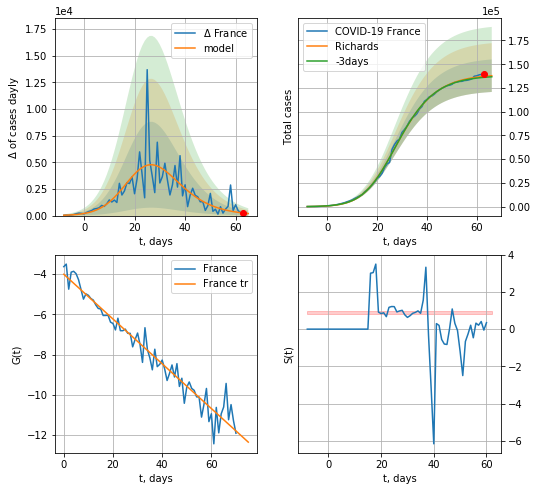

France data at: 2020-07-15
+3 day model MAPE: 0.007986
model: Richards
coeffs: [1.39530079e+05 2.42709630e-01 2.04374273e+01 4.70589839e-01]
rational stdev: 0.124192
forecast at the end of period: +3 days
	 deltaDaycases: 193
	 total cases: 137914 ± 17127
	 total death: 23969 ± 8930
trend coefficient of determination: 0.951177
 intercept: -4.003023
 slope: -0.111381


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


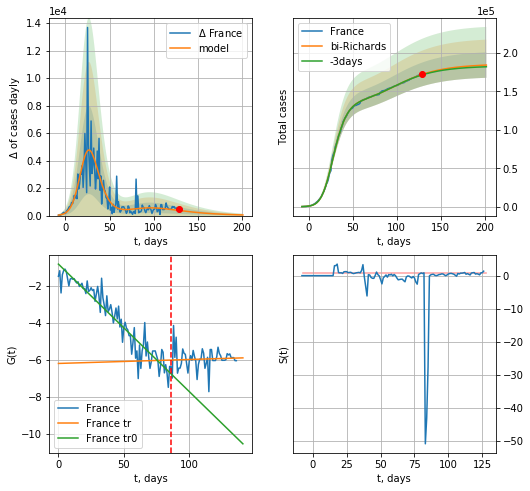

France data at: 2020-07-15
+3 day model MAPE: 0.003558
model: bi-Richards
coeffs: [ 4.62501402e+04  3.20502145e+00 -4.14141682e+01  1.03057704e-02]
rational stdev: 0.089827
forecast at the end of period: +73 days
	 deltaDaycases: 47
	 total cases: 184356 ± 16560
	 total death: 32040 ± 8634
bi-Richards approximation splitting point: 86
trend coefficient of determination: 0.903989
 intercept: -0.835334
 slope: -0.068795
trend coefficient of determination: 0.003365
 intercept: -6.196960
 slope: 0.002131


In [117]:
vL = 86+14
x = forecastRR('France',dfFR[14:vL-14],d1,16*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('France',dfFR[14:],d1,26*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-14)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


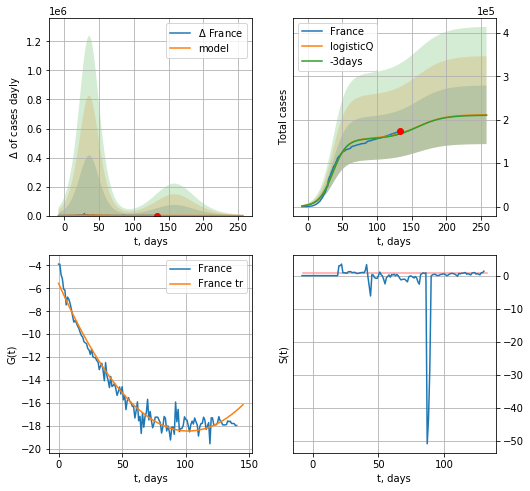

France data at: 2020-07-15
+3 day model MAPE: 0.004850
model: logisticQ
coeffs: [ 1.56315556e+05  1.70568818e-07  3.64434288e+01 -5.93826685e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.318933
forecast at the end of period: +125 days
	 deltaDaycases: 18
	 total cases: 211326 ± 67398
	 total death: 36728 ± 35141
trend coefficient of determination: 0.967228
 intercept_: -5.563315263046313
 coeffs_: [ 0.         -0.25324966  0.00124222]


In [118]:
x = forecastRRR('France',dfFR[10:],d1,34*7-dT-4,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


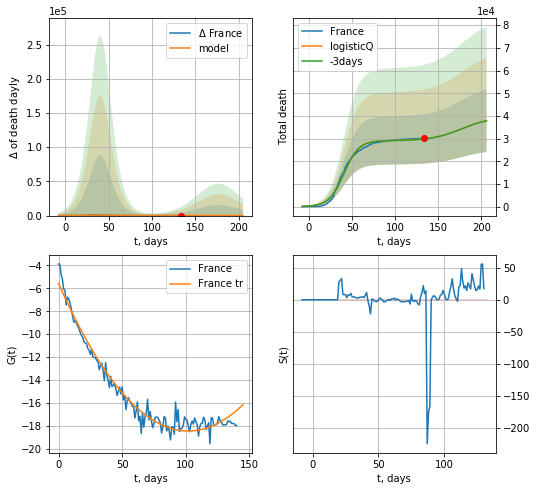

France data at: 2020-07-15
+3 day model MAPE: 0.001727
model: logisticQ
coeffs: [ 2.91287715e+04  3.22454580e-07  4.05726528e+01 -3.60276043e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.364486
forecast at the end of period: +73 days
	 total death: 37857 ± 13798
trend coefficient of determination: 0.967228
 intercept_: -5.563315263046313
 coeffs_: [ 0.         -0.25324966  0.00124222]


In [119]:
x = forecastRRR('France',dfFR[10:],d1,26*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1.])

In [112]:
#x = forecastR('France',dfFR[:],d1,8*7-dT-4,1.0,addpred=True,xcoef=[0.25,1.,20.,1])

In [113]:
#trend3(dfGR,dfUS,dfGB[:],'GR','US','GB',40,40,40)

GR
           date   cases  active   death
138 2020-07-11  199812    6178  9134.0
139 2020-07-12  199950    6216  9134.0
140 2020-07-13  200436    6197  9139.0
141 2020-07-14  200766    6122  9144.0
142 2020-07-15  201252    6104  9148.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


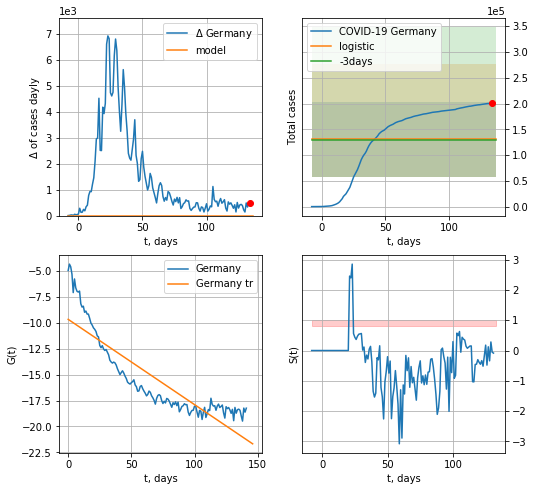

Germany data at: 2020-07-15
+3 day model MAPE: 0.01175906240543413
model: logistic
coeffs:  [ 1.30200217e+05 -4.98937623e+00  1.47869913e+02]
rational stdev:  0.5590665523376761
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  130200 ± 72790
	 total death:  5918 ± 9925
trend coefficient of determination: 0.766802
 intercept: -9.680828
 slope: -0.082142


In [120]:
dfGR = read_df(pd.DataFrame(),"GR")
x = forecast('Germany',dfGR[:],d1,7*16-dT,1.0)
#xx = forecast2('Germany',dfGR,d1,7*7-dT,x,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


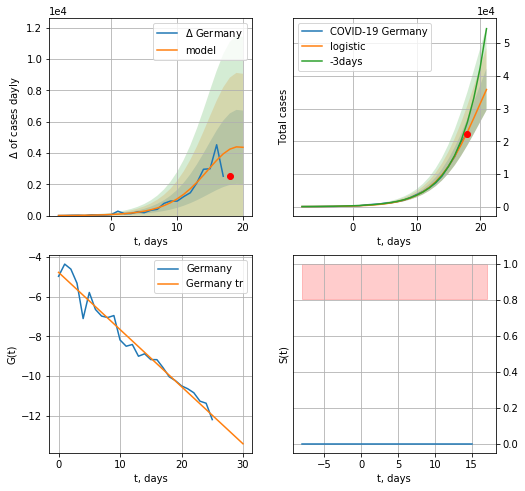

Germany data at: 2020-07-15
+3 day model MAPE: 0.18326880785963318
model: logistic
coeffs:  [6.15503822e+04 2.86340376e-01 1.98405527e+01]
rational stdev:  0.17812668621755098
forecast at the end of period: +3 days
	 deltaDaycases:  4359
	 total cases:  35837 ± 6383
	 total death:  1629 ± 870
trend coefficient of determination: 0.966755
 intercept: -4.774386
 slope: -0.288157


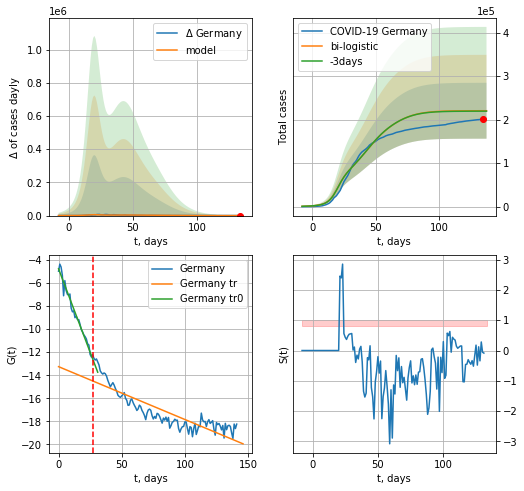

Germany data at: 2020-07-15
+3 day model MAPE: 0.004432066570539896
model: bi-logistic
coeffs:  [1.27110558e+05 1.03076013e-01 4.23523112e+01] [6.15503822e+04 2.86340376e-01 1.98405527e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.291421973235522
forecast at the end of period: +3 days
	 deltaDaycases:  3
	 total cases:  220405 ± 64231
	 total death:  10018 ± 8758
bi-logistic approximation splitting point: 27
trend0 coefficient of determination: 0.970316
 intercept: -4.764587
 slope: -0.289333
trend coefficient of determination: 0.761594
 intercept: -13.251961
 slope: -0.045841


In [121]:
vL = 27
x = forecast('Germany',dfGR[:vL],d1,16*7-dT,1.0)#,addpred=True,xcoef=[0.25,1.,2.0,1])
xx = forecast2('Germany',dfGR,d1,7*16-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.6],vL=vL)

GR
           date   cases  active   death
138 2020-07-11  199812    6178  9134.0
139 2020-07-12  199950    6216  9134.0
140 2020-07-13  200436    6197  9139.0
141 2020-07-14  200766    6122  9144.0
142 2020-07-15  201252    6104  9148.0


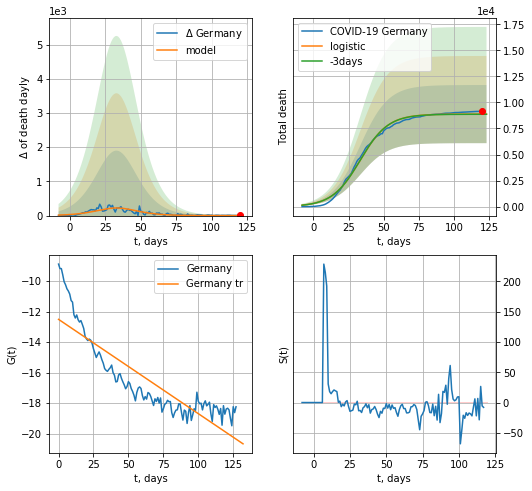

Germany data at: 2020-07-15
+3 day model MAPE: 0.0019737250847424817
model: logistic
coeffs:  [8.87999676e+03 1.00466579e-01 3.32482137e+01]
rational stdev:  0.314014100040719
forecast at the end of period: +3 days
	 total death:  8878 ± 2788
trend coefficient of determination: 0.762735
 intercept: -12.503497
 slope: -0.061845


In [122]:
dfGR = read_df(pd.DataFrame(),"GR")
x = forecast('Germany',dfGR[14:],d1,16*7-dT,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


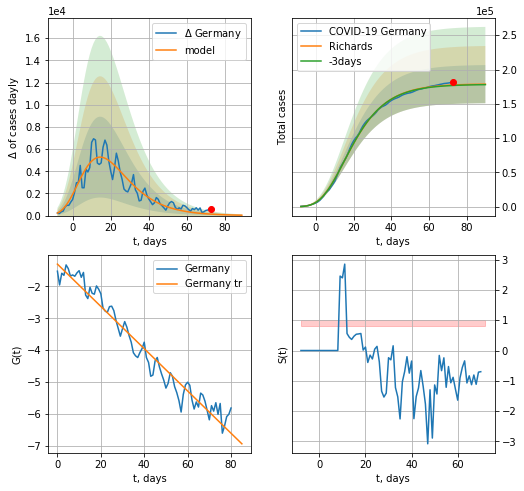

Germany data at: 2020-07-15
+3 day model MAPE: 0.003916
model: Richards
coeffs: [ 1.79110364e+05  9.11571266e+00 -4.38812227e+01  8.82260552e-03]
rational stdev: 0.155516
forecast at the end of period: +17 days
	 deltaDaycases: 35
	 total cases: 178682 ± 27788
	 total death: 8122 ± 3789
trend coefficient of determination: 0.956452
 intercept: -1.304650
 slope: -0.066180


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


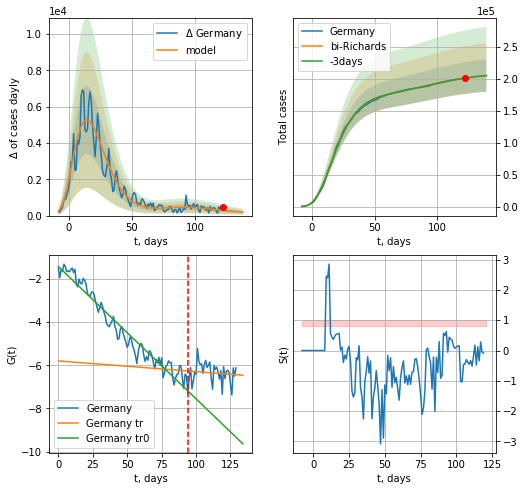

Germany data at: 2020-07-15
+3 day model MAPE: 0.000562
model: bi-Richards
coeffs: [ 3.10778712e+04  4.90563946e+00 -3.42520795e+01  7.70924583e-03]
rational stdev: 0.123283
forecast at the end of period: +17 days
	 deltaDaycases: 184
	 total cases: 204931 ± 25264
	 total death: 9315 ± 3445
bi-Richards approximation splitting point: 94
trend coefficient of determination: 0.950727
 intercept: -1.436234
 slope: -0.061176
trend coefficient of determination: 0.011693
 intercept: -5.800435
 slope: -0.004924


In [123]:
vL = 94+12
x = forecastRR('Germany',dfGR[12:vL-12],d1,18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Germany',dfGR[12:],d1,18*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


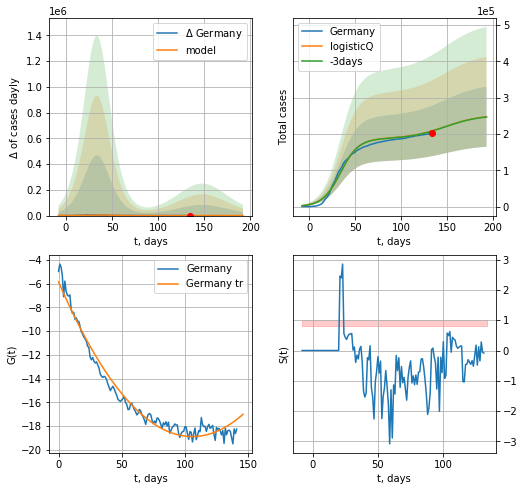

Germany data at: 2020-07-15
+3 day model MAPE: 0.002330
model: logisticQ
coeffs: [ 1.87006843e+05  1.90683286e-07  3.39741832e+01 -5.35547235e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.333357
forecast at the end of period: +59 days
	 deltaDaycases: 285
	 total cases: 247247 ± 82421
	 total death: 11238 ± 11238
trend coefficient of determination: 0.973366
 intercept_: -5.8552385366065405
 coeffs_: [ 0.         -0.24609778  0.00116282]


In [124]:
x = forecastRRR('Germany',dfGR[:],d1,24*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.0,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


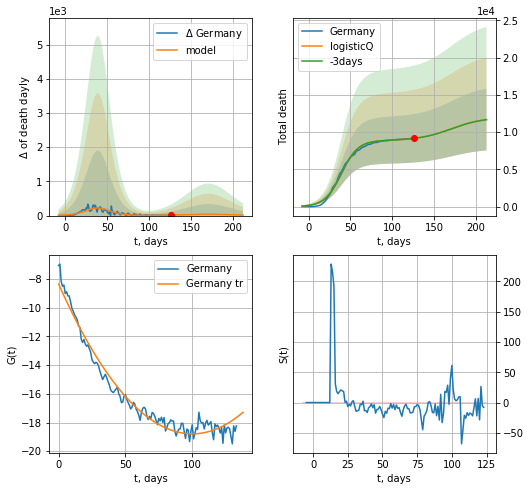

Germany data at: 2020-07-15
+3 day model MAPE: 0.001878
model: logisticQ
coeffs: [ 8.87866957e+03  3.71522805e-07  3.92469192e+01 -2.70806010e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.354683
forecast at the end of period: +87 days
	 total death: 11687 ± 4145
trend coefficient of determination: 0.969082
 intercept_: -8.339478329505955
 coeffs_: [ 0.         -0.20895768  0.0010444 ]


In [125]:
x = forecastRRR('Germany',dfGR[8:],d1,28*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.0,1])

US
           date    cases   active     death
132 2020-07-11  3355781  1727836  137403.0
133 2020-07-12  3413995  1759129  137782.0
134 2020-07-13  3479483  1791767  138247.0
135 2020-07-14  3545257  1805791  139145.0
136 2020-07-15  3616747  1830645  140140.0


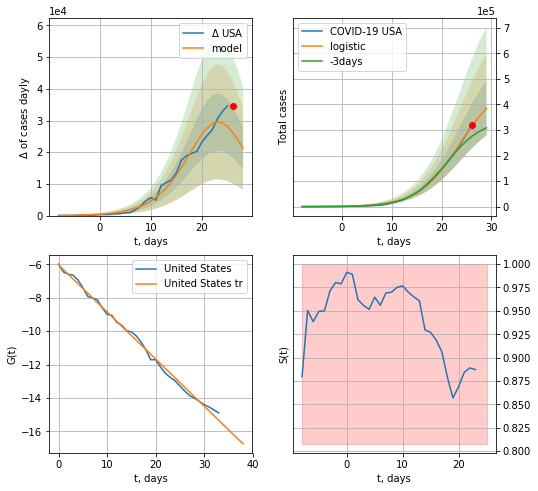

USA data at: 2020-07-15
+3 day model MAPE: 0.17962965715206392
model: logistic
coeffs:  [4.89025783e+05 2.41973857e-01 2.36121759e+01]
rational stdev:  0.2760702577358041
forecast at the end of period: +3 days
	 deltaDaycases:  21241
	 total cases:  384598 ± 106176
	 total death:  14902 ± 12341
trend coefficient of determination: 0.995387
 intercept: -6.036925
 slope: -0.281840


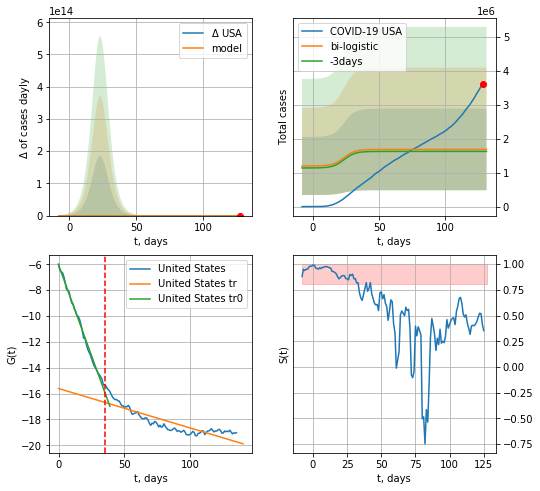

USA data at: 2020-07-15
+3 day model MAPE: 0.03608521768948649
model: bi-logistic
coeffs:  [ 9.58467544e+05 -1.20123398e+01  2.96803125e+02] [4.89025783e+05 2.41973857e-01 2.36121759e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
rational stdev:  0.7140937381173943
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  1687110 ± 1204754
	 total death:  65371 ± 140043
bi-logistic approximation splitting point: 35
trend0 coefficient of determination: 0.995488
 intercept: -6.051468
 slope: -0.280518
trend coefficient of determination: 0.760109
 intercept: -15.609424
 slope: -0.030547


In [126]:
vL=35
dfUS = read_df(pd.DataFrame(),"US")
x = forecast('USA',dfUS[:vL],d1,16*7-dT,1.0,addpred=False,xcoef=[0.25,1.,2.])
xx = forecast2('USA',dfUS[:],d1,16*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.5],vL=vL)

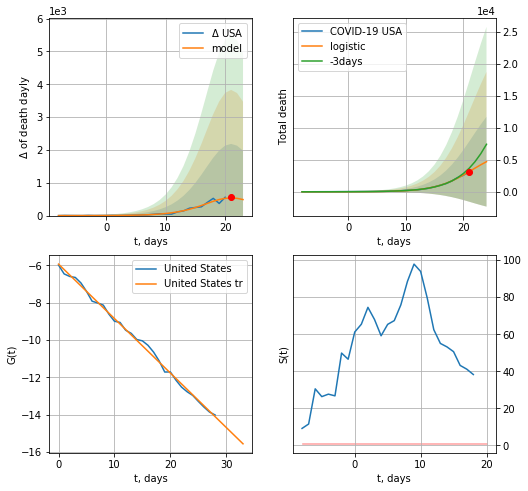

USA data at: 2020-07-15
+3 day model MAPE: 0.214213224760407
model: logistic
coeffs:  [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  1.4929056707100332
forecast at the end of period: +3 days
	 total death:  4706 ± 7026
trend coefficient of determination: 0.996549
 intercept: -5.938291
 slope: -0.291586


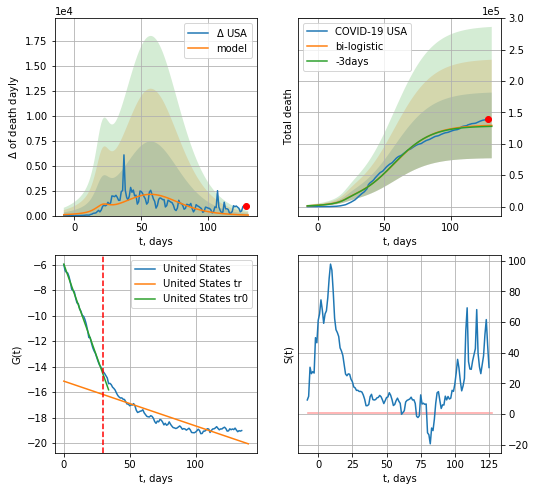

USA data at: 2020-07-15
+3 day model MAPE: 0.011410220571866185
model: bi-logistic
coeffs:  [1.23188212e+05 6.92533621e-02 5.75271146e+01] [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  0.4045864530938687
forecast at the end of period: +3 days
	 deltaDaydeath:  53
	 total death:  129266 ± 52299
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.996707
 intercept: -5.949158
 slope: -0.290421
trend coefficient of determination: 0.758264
 intercept: -15.143411
 slope: -0.035163


In [127]:
vL=30
x = forecast('USA',dfUS[:vL],d1,7*16-dT,1.0,cases='death')
xx = forecast2('USA',dfUS,d1,7*16-dT,x,1.0,cases='death',vL=vL)
#x = forecast('USA',dfUS[:],d1,28*3-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


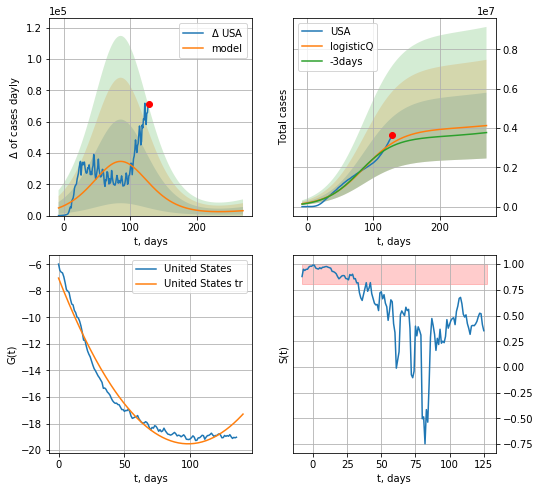

USA data at: 2020-07-15
+3 day model MAPE: 0.049626
model: logisticQ
coeffs: [ 3.93387386e+06  1.24772555e-07  8.59213287e+01 -2.81048099e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.405938
forecast at the end of period: +143 days
	 deltaDaycases: 3129
	 total cases: 4121197 ± 1672950
	 total death: 159686 ± 194467
trend coefficient of determination: 0.973173
 intercept_: -7.0457572762916385
 coeffs_: [ 0.         -0.25368931  0.0012898 ]


In [128]:
x = forecastRRR('USA',dfUS[:],d1,7*36-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


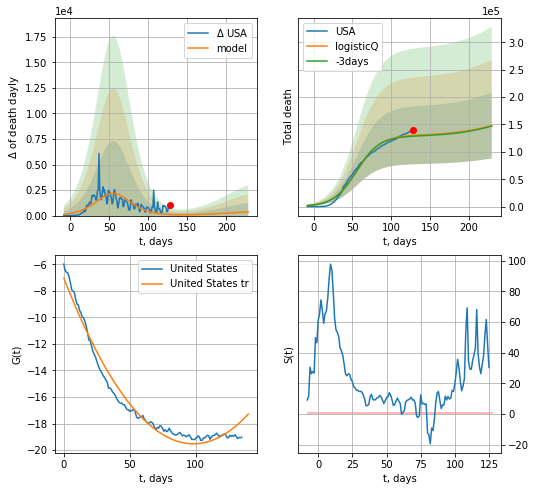

USA data at: 2020-07-15
+3 day model MAPE: 0.011233
model: logisticQ
coeffs: [ 1.30046245e+05  1.68621896e-07  5.56291233e+01 -3.96489161e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.405854
forecast at the end of period: +101 days
	 total death: 147946 ± 60044
trend coefficient of determination: 0.973173
 intercept_: -7.0457572762916385
 coeffs_: [ 0.         -0.25368931  0.0012898 ]


In [129]:
x = forecastRRR('USA',dfUS[:],d1,7*30-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


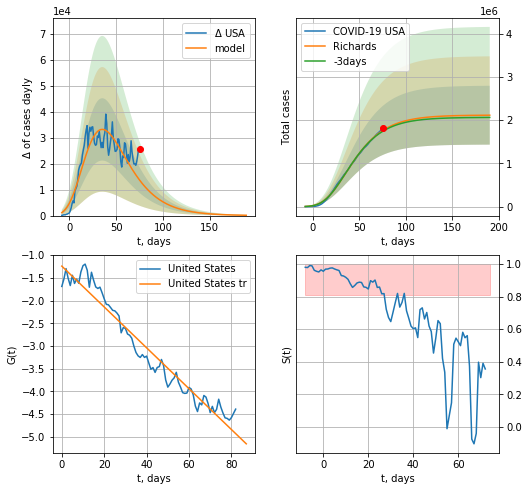

USA data at: 2020-07-15
+3 day model MAPE: 0.011173
model: Richards
coeffs: [ 2.11547108e+06  4.55700208e+00 -7.32276786e+01  9.40292240e-03]
rational stdev: 0.321873
forecast at the end of period: +115 days
	 deltaDaycases: 124
	 total cases: 2112630 ± 679997
	 total death: 81859 ± 79044
trend coefficient of determination: 0.952323
 intercept: -1.242025
 slope: -0.044961


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


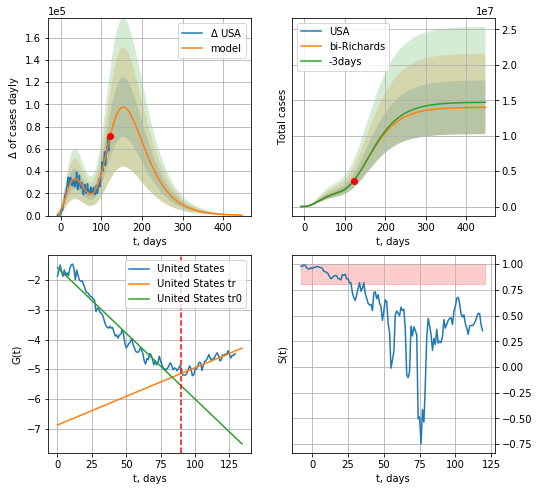

USA data at: 2020-07-15
+3 day model MAPE: 0.001202
model: bi-Richards
coeffs: [1.19031708e+07 6.14635722e-01 8.70764426e+00 3.67101828e-02]
rational stdev: 0.270059
forecast at the end of period: +325 days
	 deltaDaycases: 374
	 total cases: 14002210 ± 3781418
	 total death: 542551 ± 439561
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.944795
 intercept: -1.573660
 slope: -0.044341
trend coefficient of determination: 0.788800
 intercept: -6.881210
 slope: 0.019323


In [130]:
iL = 6
vL = 90+iL
x = forecastRR('USA',dfUS[iL:vL-iL],d1,7*32-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('USA',dfUS[iL:],d1,7*62-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [131]:
#x = forecastQR('USA',dfUS[20:],d1,7*18-dT,1.0,addpred=False,xcoef=[0.35,.5,3.,1.,1.])

GB
           date   cases  active    death
136 2020-07-11  288953       0  44798.0
137 2020-07-12  289603       0  44819.0
138 2020-07-13  290133       0  44830.0
139 2020-07-14  291373       0  44968.0
140 2020-07-15  291911       0  45053.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


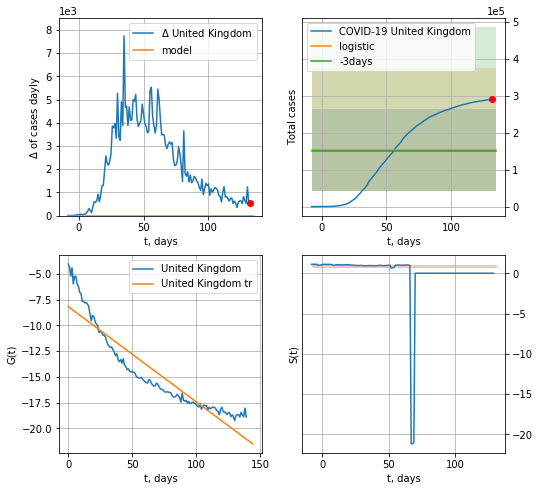

United Kingdom data at: 2020-07-15
+3 day model MAPE: 0.01978826326060767
model: logistic
coeffs:  [ 1.53830411e+05 -8.74232529e+00  2.26260451e+02]
rational stdev:  0.7207389126151913
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  153830 ± 110871
	 total death:  23741 ± 51333
trend coefficient of determination: 0.864945
 intercept: -8.163128
 slope: -0.092685


In [132]:
dfGB = read_df(pd.DataFrame(),"GB")
x = forecast('United Kingdom',dfGB[:],d1,7*16-dT,1.)
#x = forecast('United Kingdom',dfGB[:-8-dT],d1,4*7-dT,1.)
#xx = forecast2('United Kingdom',dfGB[:],d1,4*7-dT,x,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


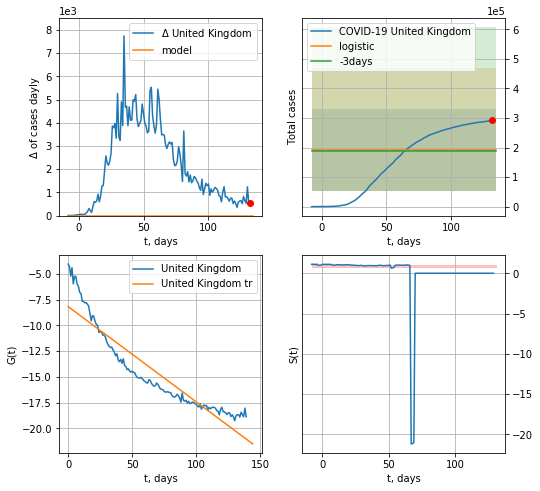

United Kingdom data at: 2020-07-15
+3 day model MAPE: 0.019788263260607633
model: logistic
coeffs:  [ 1.53830411e+05 -8.74232529e+00  2.26260451e+02]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.7207389126151913
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  192288 ± 138589
	 total death:  29677 ± 64168
trend coefficient of determination: 0.864945
 intercept: -8.163128
 slope: -0.092685


In [133]:
x = forecast('United Kingdom',dfGB[:],d1,16*7-dT,1.,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: divide by zero encountered in true_divide


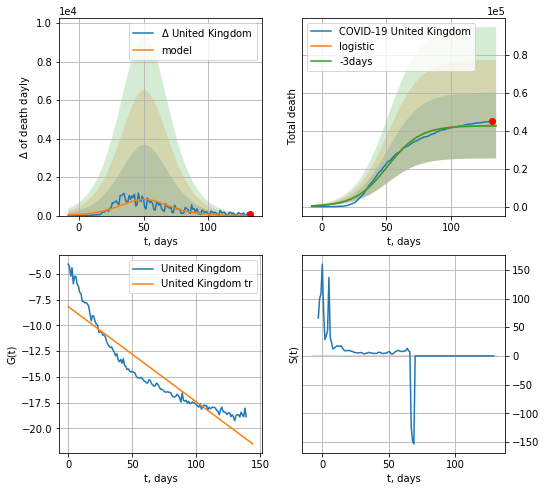

United Kingdom data at: 2020-07-15
+3 day model MAPE: 0.004922247041822477
model: logistic
coeffs:  [4.28250723e+04 7.89040125e-02 5.10952972e+01]
rational stdev:  0.4055119586986843
forecast at the end of period: +3 days
	 total death:  42768 ± 17342
trend coefficient of determination: 0.864945
 intercept: -8.163128
 slope: -0.092685


In [134]:
x = forecast('United Kingdom',dfGB[:],d1,16*7-dT,1.,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


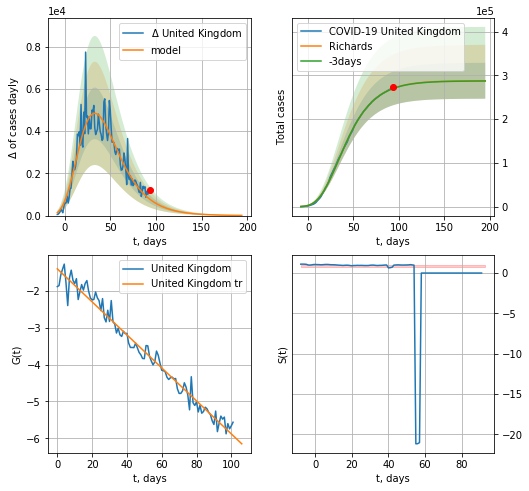

United Kingdom data at: 2020-07-15
+3 day model MAPE: 0.001376
model: Richards
coeffs: [ 2.87795708e+05  3.89465535e+00 -6.28975560e+01  1.18178726e-02]
rational stdev: 0.142484
forecast at the end of period: +101 days
	 deltaDaycases: 8
	 total cases: 287625 ± 40981
	 total death: 44391 ± 18974
trend coefficient of determination: 0.974506
 intercept: -1.412480
 slope: -0.044645


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


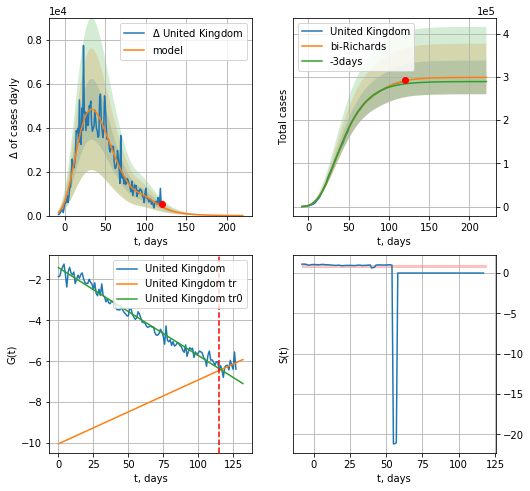

United Kingdom data at: 2020-07-15
+3 day model MAPE: 0.025274
model: bi-Richards
coeffs: [1.10901190e+04 1.04401495e+01 3.52051442e+01 7.07339382e-03]
rational stdev: 0.130110
forecast at the end of period: +101 days
	 deltaDaycases: 2
	 total cases: 298832 ± 38881
	 total death: 46121 ± 18002
bi-Richards approximation splitting point: 115
trend coefficient of determination: 0.976096
 intercept: -1.424908
 slope: -0.042916
trend coefficient of determination: 0.178276
 intercept: -10.034149
 slope: 0.031188


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


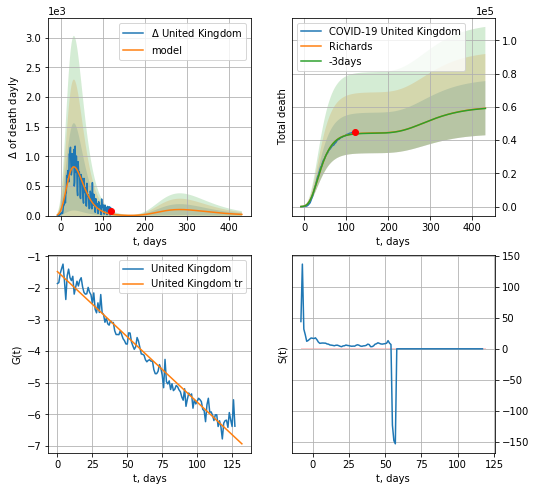

United Kingdom data at: 2020-07-15
+3 day model MAPE: 0.003050
model: Richards
coeffs: [ 4.43567255e+04  7.98676351e+00 -6.85558301e+01  6.32885318e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.275369
forecast at the end of period: +311 days
	 total death: 59222 ± 16308
trend coefficient of determination: 0.972055
 intercept: -1.483828
 slope: -0.041282


In [135]:
vL = 115+12
x = forecastRR('United Kingdom',dfGB[12:vL-12],d1,30*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('United Kingdom',dfGB[12:],d1,30*7-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)
x = forecastRR('United Kingdom',dfGB[12:],d1,60*7-dT,1.,addpred=True,xcoef=RkoreaCoeffs,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


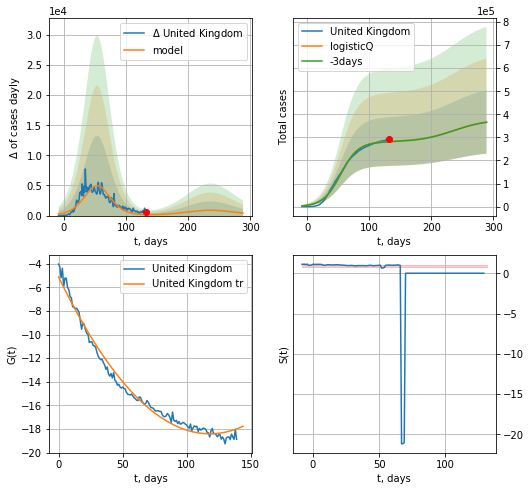

United Kingdom data at: 2020-07-15
+3 day model MAPE: 0.004548
model: logisticQ
coeffs: [ 2.80752396e+05  2.19023420e-07  5.42587970e+01 -3.22931316e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.374516
forecast at the end of period: +157 days
	 deltaDaycases: 415
	 total cases: 366892 ± 137406
	 total death: 56625 ± 63620
trend coefficient of determination: 0.984634
 intercept_: -5.113906712408754
 coeffs_: [ 0.         -0.22526188  0.0009538 ]


In [136]:
x = forecastRRR('United Kingdom',dfGB[:],d1,38*7-dT,1.,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


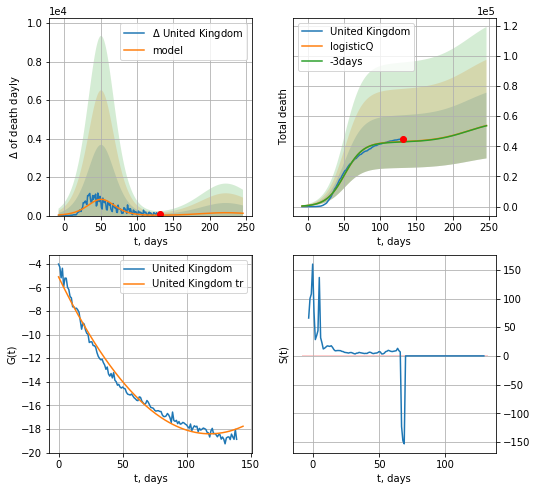

United Kingdom data at: 2020-07-15
+3 day model MAPE: 0.004975
model: logisticQ
coeffs: [ 4.28247599e+04  1.89867908e-07  5.10962057e+01 -4.15413655e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.405535
forecast at the end of period: +115 days
	 total death: 53804 ± 21819
trend coefficient of determination: 0.984634
 intercept_: -5.113906712408754
 coeffs_: [ 0.         -0.22526188  0.0009538 ]


In [137]:
x = forecastRRR('United Kingdom',dfGB[:],d1,32*7-dT,1.,addpred=True,xcoef=koreaCoeffs,cases='death')

In [130]:
#x = forecastQR('United Kingdom',dfGB[:],d1,18*7-dT,1.,addpred=True,xcoef=[0.35,.5,3,1,1])

In [131]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,2.4,1])

In [132]:
#trend3(dfDK,dfNG,dfSW[:],'DK','NG','SW',40,40,40)

In [133]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,4.,1])

In [134]:
#x = forecast('Denmark',dfDK[:15],d1,2*7-dT,1.0)
#xx = forecast2('Denmark',dfDK[:],d1,4*7-dT, x,1.0)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3('Denmark',dfDK[:],d1,14-dT, xx)

In [138]:
dT

109

DK
           date    cases  active  death
135 2020-07-11  12976.0     260  609.0
136 2020-07-12  13006.0     260  609.0
137 2020-07-13  13037.0     297  610.0
138 2020-07-14  13061.0     291  610.0
139 2020-07-15  13092.0     300  610.0


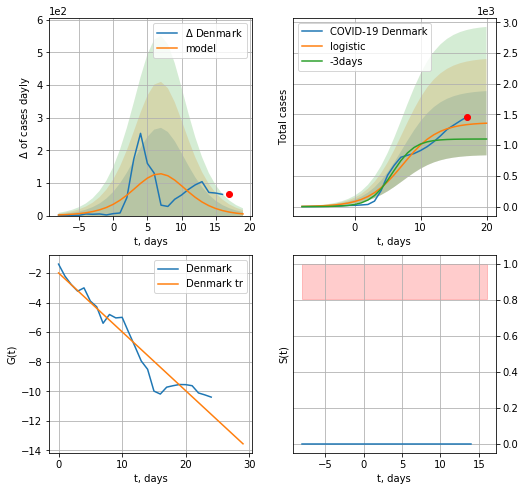

Denmark data at: 2020-07-15
+3 day model MAPE: 0.22309164372685597
model: logistic
coeffs:  [1.36966073e+03 3.75718860e-01 7.30059729e+00]
rational stdev:  0.38476605910227335
forecast at the end of period: +3 days
	 deltaDaycases:  5
	 total cases:  1358 ± 522
	 total death:  63 ± 72
trend coefficient of determination: 0.928037
 intercept: -1.984791
 slope: -0.399221


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:189: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


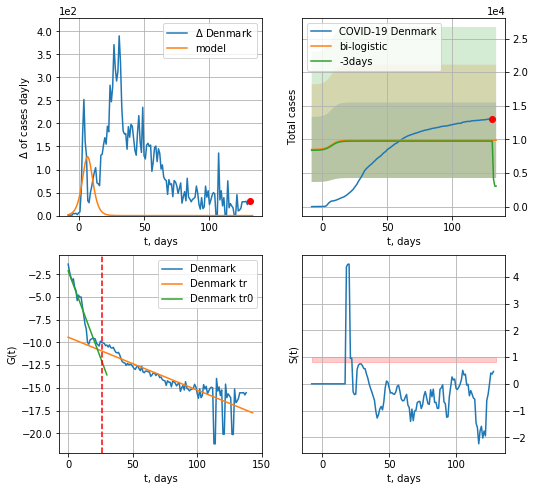

Denmark data at: 2020-07-15
+3 day model MAPE: 1.4290779454904121
model: bi-logistic
coeffs:  [ 6.80312581e+03 -4.04188953e+00  1.39195133e+02] [1.36966073e+03 3.75718860e-01 7.30059729e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.5690465227554615
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  9873 ± 5618
	 total death:  460 ± 785
bi-logistic approximation splitting point: 26
trend0 coefficient of determination: 0.914728
 intercept: -2.128126
 slope: -0.381304
trend coefficient of determination: 0.716427
 intercept: -9.426267
 slope: -0.058159


In [139]:
dfDK = read_df(pd.DataFrame(),"DK")
vL = 26
try:
    x = forecast('Denmark',dfDK[:vL],d1,7*16-dT,1.0)
    xx = forecast2('Denmark',dfDK[:],d1,16*7-dT, x,1.0,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
except:
    print("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


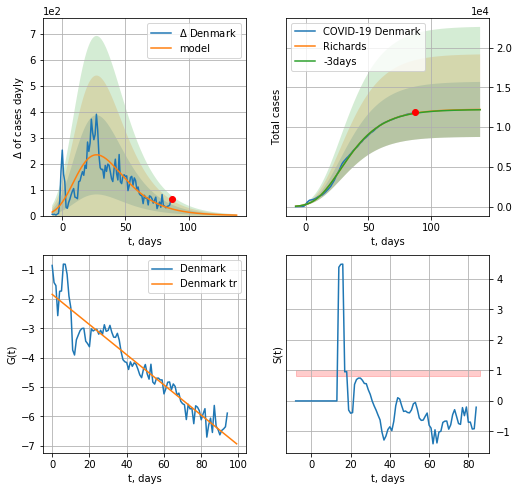

Denmark data at: 2020-07-15
+3 day model MAPE: 0.002072
model: Richards
coeffs: [ 1.22659587e+04  7.57412632e-01 -2.17374814e+01  7.08529608e-02]
rational stdev: 0.283101
forecast at the end of period: +52 days
	 deltaDaycases: 1
	 total cases: 12234 ± 3463
	 total death: 570 ± 484
trend coefficient of determination: 0.907675
 intercept: -1.842227
 slope: -0.051439


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


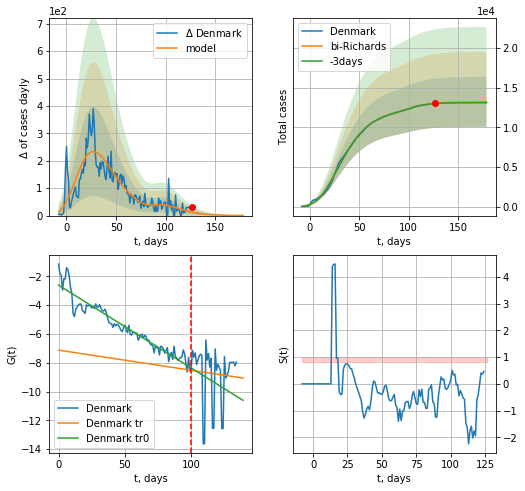

Denmark data at: 2020-07-15
+3 day model MAPE: 0.003800
model: bi-Richards
coeffs: [9.60223981e+02 3.91726370e-01 8.19898283e+01 2.01805536e-01]
rational stdev: 0.238269
forecast at the end of period: +52 days
	 deltaDaycases: 0
	 total cases: 13220 ± 3150
	 total death: 615 ± 439
bi-Richards approximation splitting point: 100
trend coefficient of determination: 0.915734
 intercept: -2.620089
 slope: -0.057496
trend coefficient of determination: 0.005105
 intercept: -7.128497
 slope: -0.013952


In [140]:
vL = 100+4
x = forecastRR('Denmark',dfDK[4:vL-4],d1,23*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Denmark',dfDK[4:],d1,23*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-4)
#x2 = forecast2R('Denmark',dfDK[:],d1,16*7-dT,x,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


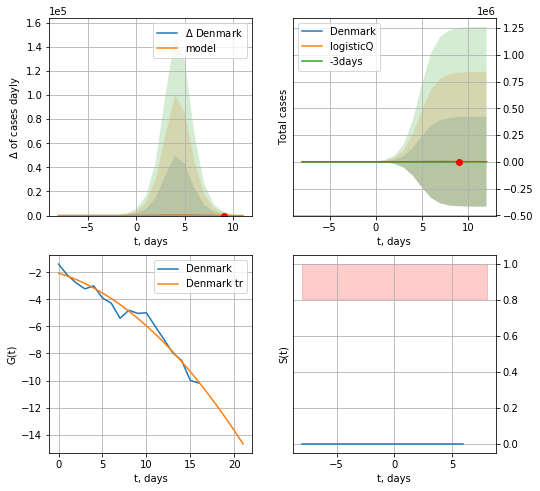

Denmark data at: 2020-07-15
+3 day model MAPE: 2.879608
model: logisticQ
coeffs: [ 8.62480490e+02  2.49401516e-04  4.73670538e+00 -4.50088701e+03]
rational stdev: 487.269302
forecast at the end of period: +3 days
	 deltaDaycases: 0
	 total cases: 862 ± 420141
	 total death: 40 ± 58472
trend coefficient of determination: 0.965266
 intercept_: -2.0557034713075613
 coeffs_: [ 0.         -0.1970759  -0.01925246]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


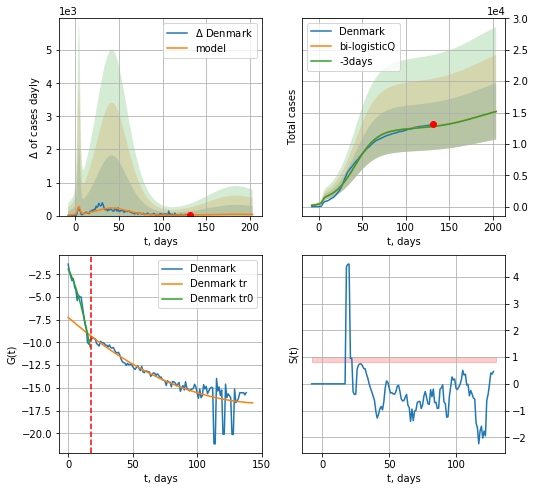

Denmark data at: 2020-07-15
+3 day model MAPE: 0.004099
model: bi-logisticQ
coeffs: [ 1.15234809e+04  1.51450227e-07  4.23656037e+01 -5.24299300e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.295785
forecast at the end of period: +73 days
	 deltaDaycases: 35
	 total cases: 15178 ± 4489
	 total death: 707 ± 627
bi-logisticQ approximation splitting point: 18
trend coefficient of determination: 0.963211
 intercept_: -1.9308894789691964
 coeffs_: [ 0.         -0.26605777 -0.01390014]
trend coefficient of determination: 0.798719
 intercept_: -7.244380727948255
 coeffs_: [ 0.         -0.12271702  0.00039798]


In [141]:
x = forecastRRR('Denmark',dfDK[:18],d1,16*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[0.35,0.5,4.5,1.])
x = forecast2RRR('Denmark',dfDK[:],d1,26*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=18)

NG
           date   cases  active  death
136 2020-07-11  8977.0     587  252.0
137 2020-07-12  8981.0     591  252.0
138 2020-07-13  8984.0     593  253.0
139 2020-07-14  9001.0     610  253.0
140 2020-07-15  9011.0     620  253.0


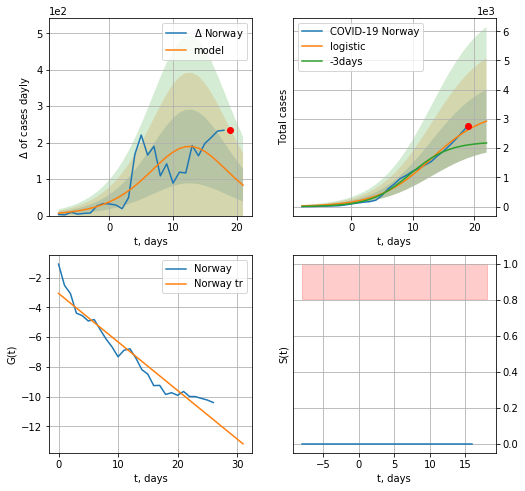

Norway data at: 2020-07-15
+3 day model MAPE: 0.2814819001616187
model: logistic
coeffs:  [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.3674391911615601
forecast at the end of period: +3 days
	 deltaDaycases:  83
	 total cases:  2925 ± 1074
	 total death:  82 ± 90
trend coefficient of determination: 0.927855
 intercept: -3.067798
 slope: -0.326083


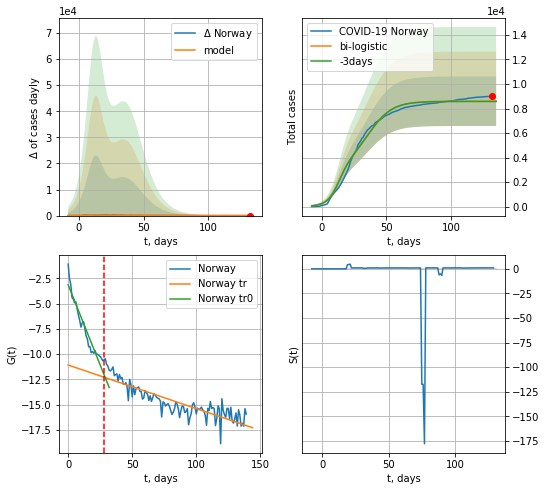

Norway data at: 2020-07-15
+3 day model MAPE: 0.0026478105085093718
model: bi-logistic
coeffs:  [5.29972707e+03 1.08023513e-01 3.61924701e+01] [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.2349271915729265
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  8597 ± 2019
	 total death:  241 ± 169
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.925279
 intercept: -3.146002
 slope: -0.317060
trend coefficient of determination: 0.742186
 intercept: -11.069384
 slope: -0.043046


In [142]:
dfNG = read_df(pd.DataFrame(),"NG")
vL=28
x = forecast('Norway',dfNG[:vL],d1,7*16-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,16*7-dT,x,1.0,vL=vL)
#xx = np.concatenate((x, xx), axis=0)

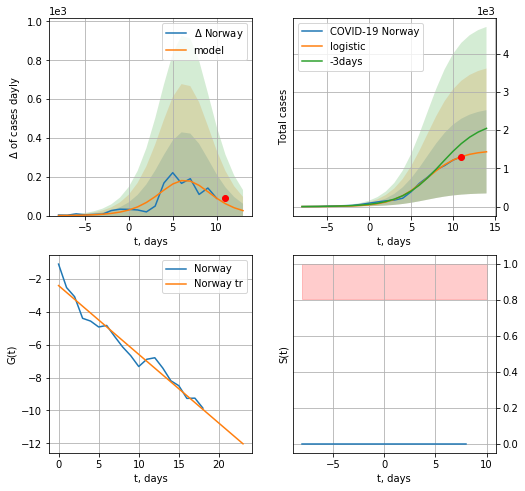

Norway data at: 2020-07-15
+3 day model MAPE: 0.247655347933597
model: logistic
coeffs:  [1.47478891e+03 4.95866797e-01 6.87524749e+00]
rational stdev:  0.7596156049961639
forecast at the end of period: +3 days
	 deltaDaycases:  25
	 total cases:  1432 ± 1088
	 total death:  40 ± 91
trend coefficient of determination: 0.956890
 intercept: -2.403448
 slope: -0.418410


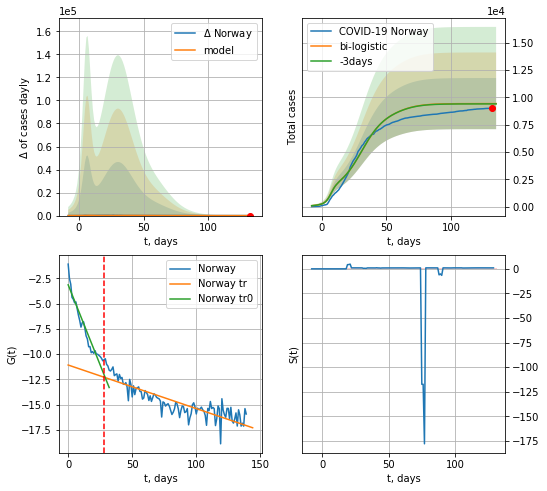

Norway data at: 2020-07-15
+3 day model MAPE: 0.0027481503610850056
model: bi-logistic
coeffs:  [7.06170883e+03 1.13859647e-01 3.05851274e+01] [1.47478891e+03 4.95866797e-01 6.87524749e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.24817165231176214
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  9418 ± 2337
	 total death:  264 ± 196
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.925279
 intercept: -3.146002
 slope: -0.317060
trend coefficient of determination: 0.742186
 intercept: -11.069384
 slope: -0.043046


In [143]:
vL = 28#len(dfNG)-13-dT
x = forecast('Norway',dfNG[:-12-dT],d1,7*16-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,16*7-dT,x,1.0,addpred=True,xcoef=[0.25/2,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


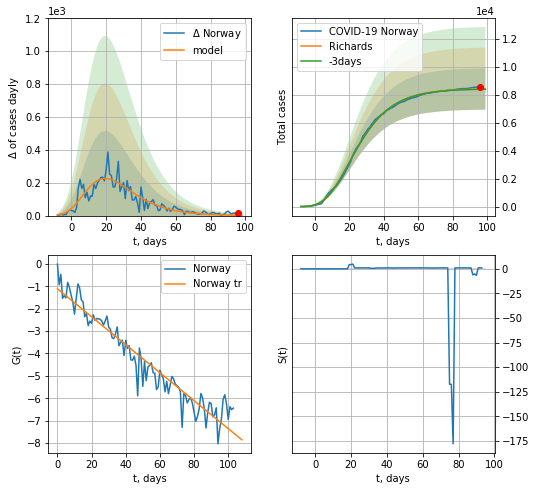

Norway data at: 2020-07-15
+3 day model MAPE: 0.002094
model: Richards
coeffs: [ 8.43838842e+03  7.14084289e+00 -4.28210769e+01  1.02282394e-02]
rational stdev: 0.175948
forecast at the end of period: +3 days
	 deltaDaycases: 1
	 total cases: 8412 ± 1480
	 total death: 236 ± 124
trend coefficient of determination: 0.922155
 intercept: -1.112087
 slope: -0.062445


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


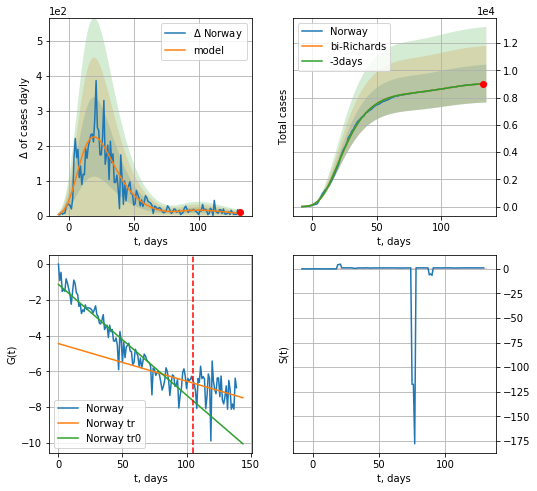

Norway data at: 2020-07-15
+3 day model MAPE: 0.000156
model: bi-Richards
coeffs: [6.95405289e+02 4.67899012e+00 2.37567651e+01 1.19539262e-02]
rational stdev: 0.153376
forecast at the end of period: +3 days
	 deltaDaycases: 5
	 total cases: 9025 ± 1384
	 total death: 253 ± 116
bi-Richards approximation splitting point: 105
trend coefficient of determination: 0.918508
 intercept: -1.146947
 slope: -0.061794
trend coefficient of determination: 0.060277
 intercept: -4.450466
 slope: -0.020988


In [144]:
vL = 105
x = forecastRR('Norway',dfNG[:vL],d1,16*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Norway',dfNG[:],d1,16*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR('Norway',dfNG[:],d1,8*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


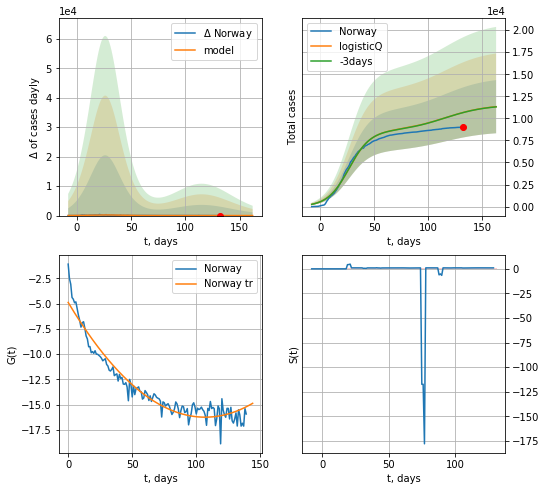

Norway data at: 2020-07-15
+3 day model MAPE: 0.001054
model: logisticQ
coeffs: [ 8.54631185e+03  2.17564394e-07  2.65318768e+01 -4.64698294e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.266097
forecast at the end of period: +31 days
	 deltaDaycases: 11
	 total cases: 11323 ± 3013
	 total death: 317 ± 253
trend coefficient of determination: 0.933588
 intercept_: -4.884719103914982
 coeffs_: [ 0.         -0.21222315  0.00099296]


In [145]:
x = forecastRRR('Norway',dfNG[:],d1,20*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


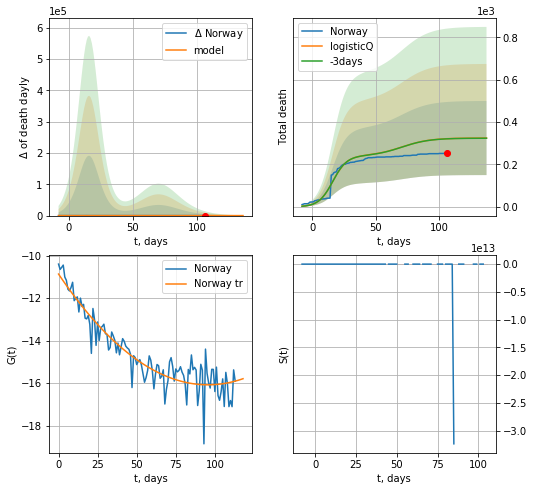

Norway data at: 2020-07-15
+3 day model MAPE: 0.002174
model: logisticQ
coeffs: [ 2.39932095e+02  8.15396981e-07  1.61783755e+01 -2.21929154e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.537898
forecast at the end of period: +31 days
	 total death: 324 ± 174
trend coefficient of determination: 0.859345
 intercept_: -10.86936646394043
 coeffs_: [ 0.         -0.10903805  0.00057048]


In [146]:
x = forecastRRR('Norway',dfNG[26:],d1,20*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

SW
           date  cases  active   death
137 2020-07-11  75681       0  5526.0
138 2020-07-12  75795       0  5526.0
139 2020-07-13  75826       0  5536.0
140 2020-07-14  76001       0  5545.0
141 2020-07-15  76492       0  5572.0


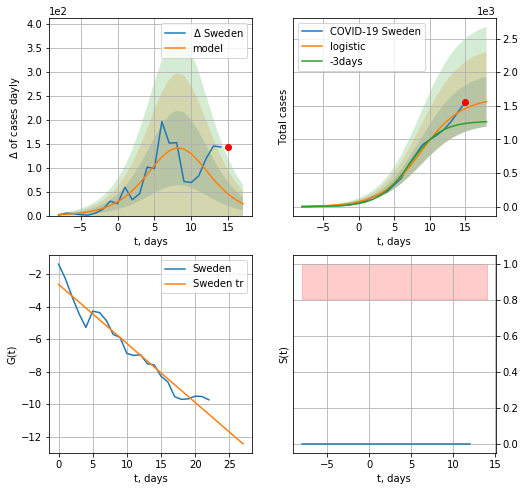

Sweden data at: 2020-07-15
+3 day model MAPE: 0.2037446768613992
model: logistic
coeffs:  [1.62331286e+03 3.49719159e-01 8.72648648e+00]
rational stdev:  0.23715803800431418
forecast at the end of period: +3 days
	 deltaDaycases:  24
	 total cases:  1562 ± 370
	 total death:  113 ± 80
trend coefficient of determination: 0.947996
 intercept: -2.632493
 slope: -0.363132


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


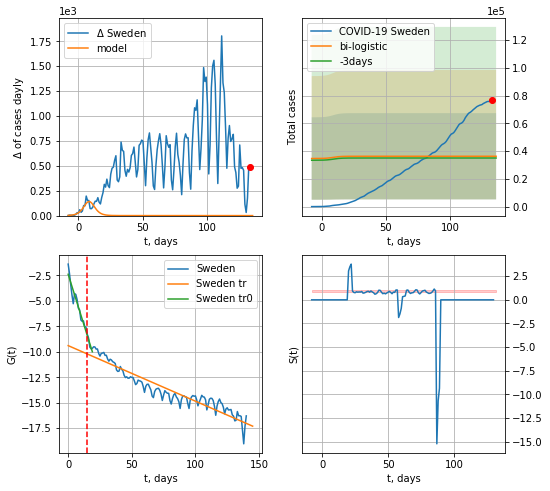

Sweden data at: 2020-07-15
+3 day model MAPE: 0.036024815588191136
model: bi-logistic
coeffs:  [ 2.77241317e+04 -1.09556462e+01  2.76148971e+02] [1.62331286e+03 3.49719159e-01 8.72648648e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.8565070196062482
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  36278 ± 31072
	 total death:  2642 ± 6788
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.908377
 intercept: -2.385275
 slope: -0.400494
trend coefficient of determination: 0.888178
 intercept: -9.392648
 slope: -0.054557


In [147]:
vL = 15#len(dfSW)-12-dT
dfSW = read_df(pd.DataFrame(),"SW")
try:
    x = forecast('Sweden',dfSW[:-9-dT],d1,7*16-dT,1.0)
    xx = forecast2('Sweden',dfSW[:],d1,7*16-dT,x,1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)
except:
    print ("Exception occurs")

SW
           date  cases  active   death
137 2020-07-11  75681       0  5526.0
138 2020-07-12  75795       0  5526.0
139 2020-07-13  75826       0  5536.0
140 2020-07-14  76001       0  5545.0
141 2020-07-15  76492       0  5572.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: invalid value encountered in true_divide


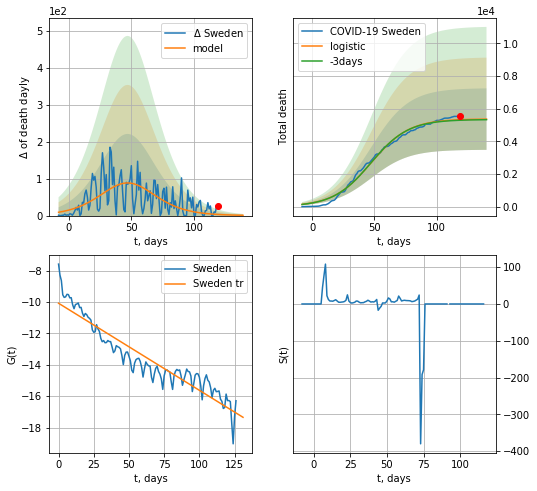

Sweden data at: 2020-07-15
+3 day model MAPE: 0.006159478269933518
model: logistic
coeffs:  [5.37158586e+03 6.57958293e-02 4.74620934e+01]
rational stdev:  0.35127094860494806
forecast at the end of period: +21 days
	 total death:  5359 ± 1882
trend coefficient of determination: 0.884179
 intercept: -10.076287
 slope: -0.055507


In [148]:
dfSW = read_df(pd.DataFrame(),"SW")
x = forecast('Sweden',dfSW[14:],d1,3*7,shift=1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


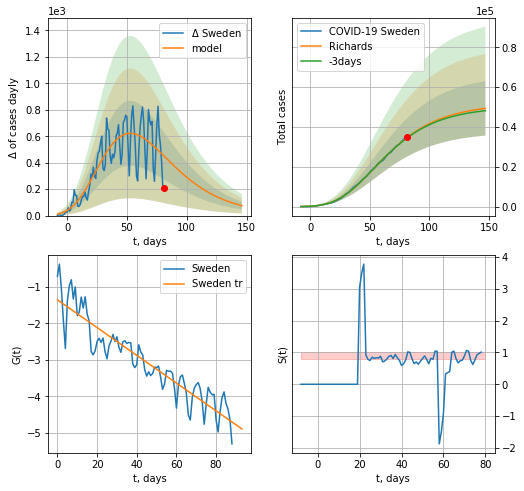

Sweden data at: 2020-07-15
+3 day model MAPE: 0.006978
model: Richards
coeffs: [ 5.16330494e+04  1.82847878e+00 -6.81673202e+01  1.80721480e-02]
rational stdev: 0.276602
forecast at the end of period: +66 days
	 deltaDaycases: 74
	 total cases: 49352 ± 13650
	 total death: 3595 ± 2983
trend coefficient of determination: 0.851662
 intercept: -1.351558
 slope: -0.038050


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


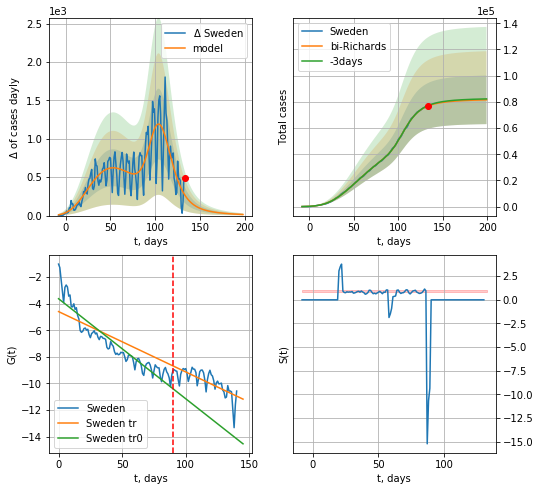

Sweden data at: 2020-07-15
+3 day model MAPE: 0.004558
model: bi-Richards
coeffs: [3.03409728e+04 2.10647055e-01 9.83132813e+01 4.91107238e-01]
rational stdev: 0.227607
forecast at the end of period: +66 days
	 deltaDaycases: 14
	 total cases: 81555 ± 18562
	 total death: 5940 ± 4055
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.875312
 intercept: -3.633480
 slope: -0.075176
trend coefficient of determination: 0.544053
 intercept: -4.599764
 slope: -0.045357


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:75: RuntimeWarning: invalid value encountered in true_divide


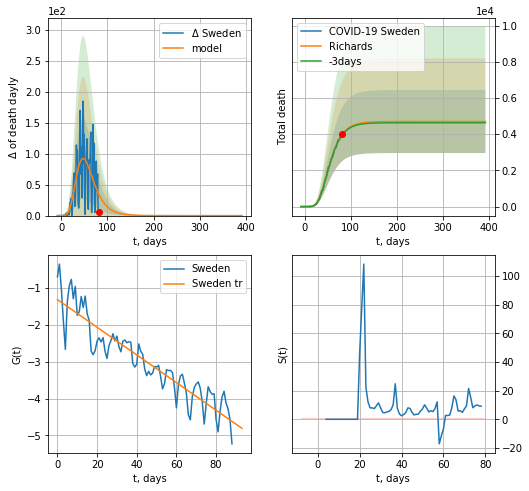

Sweden data at: 2020-07-15
+3 day model MAPE: 0.006769
model: Richards
coeffs: [ 4.70128038e+03  4.77681479e+00 -3.56595016e+01  1.12330349e-02]
rational stdev: 0.370514
forecast at the end of period: +311 days
	 total death: 4701 ± 1741
trend coefficient of determination: 0.849301
 intercept: -1.318875
 slope: -0.037503


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:209: RuntimeWarning: invalid value encountered in true_divide


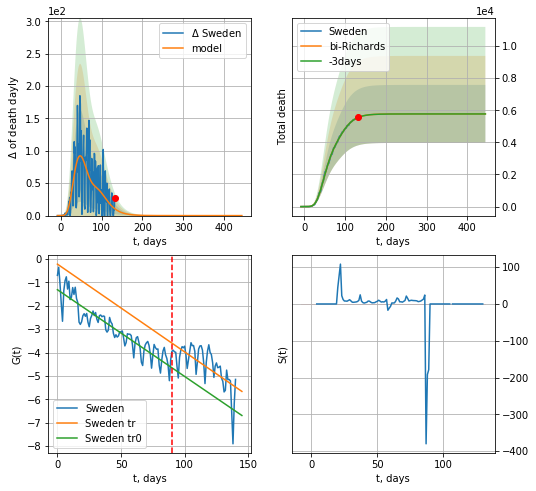

Sweden data at: 2020-07-15
+3 day model MAPE: 0.000083
model: bi-Richards
coeffs: [1.06946787e+03 6.14022230e+00 9.03406290e+00 8.62753257e-03]
rational stdev: 0.313034
forecast at the end of period: +311 days
	 total death: 5770 ± 1806
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.850352
 intercept: -1.312942
 slope: -0.037072
trend coefficient of determination: 0.439525
 intercept: -0.218818
 slope: -0.037526


In [149]:
vL = 90
x = forecastRR('Sweden',dfSW[:vL],d1,25*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Sweden',dfSW[:],d1,25*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRR('Sweden',dfSW[:vL],d1,60*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs,cases='death')
xx = forecast2RR('Sweden',dfSW[:],d1,60*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,cases='death',vL=vL)
#x = forecastQR('Sweden',dfSW[:],d1,16*7-dT,1.0)
#xx = forecast2R('Sweden',dfSW[:],d1,12*7-dT,x,1.0)#,addpred=True,xcoef=[0.25,1.,2.3,1]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


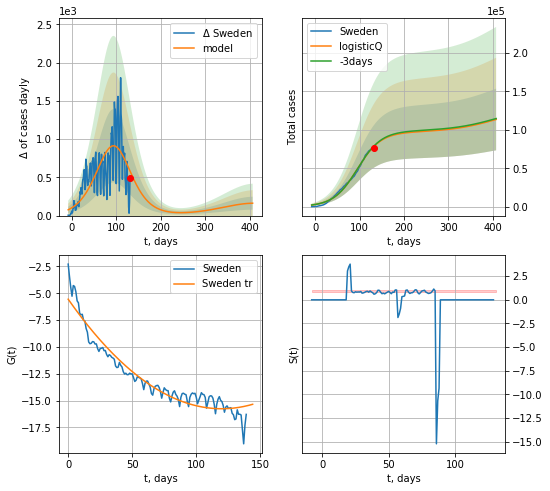

Sweden data at: 2020-07-15
+3 day model MAPE: 0.006697
model: logisticQ
coeffs: [ 9.69367966e+04  2.87925112e-07  9.43898563e+01 -1.30542876e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.354017
forecast at the end of period: +276 days
	 deltaDaycases: 162
	 total cases: 113549 ± 40198
	 total death: 8271 ± 8784
trend coefficient of determination: 0.924714
 intercept_: -5.553733330932304
 coeffs_: [ 0.         -0.17047675  0.00071124]


In [150]:
x = forecastRRR('Sweden',dfSW[1:],d1,55*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


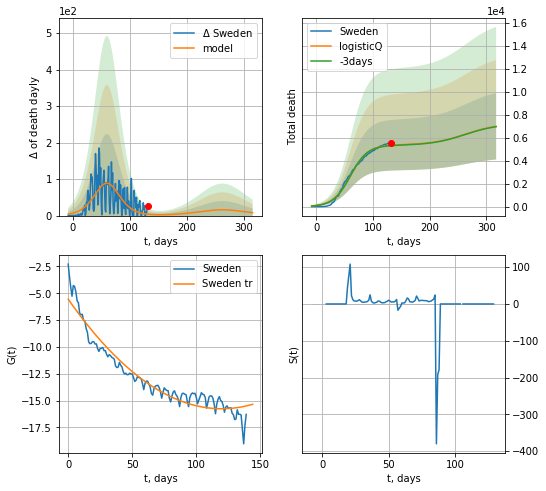

Sweden data at: 2020-07-15
+3 day model MAPE: 0.006251
model: logisticQ
coeffs: [ 5.36468001e+03  2.03523042e-07  6.04167608e+01 -3.25315418e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.412846
forecast at the end of period: +185 days
	 total death: 6992 ± 2886
trend coefficient of determination: 0.924714
 intercept_: -5.553733330932304
 coeffs_: [ 0.         -0.17047675  0.00071124]


In [151]:
x = forecastRRR('Sweden',dfSW[1:],d1,42*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')

CN
           date    cases  active   death
171 2020-07-11  83594.0     326  4634.0
172 2020-07-12  83602.0     320  4634.0
173 2020-07-13  83605.0     297  4634.0
174 2020-07-14  83611.0     284  4634.0
175 2020-07-15  83612.0     259  4634.0


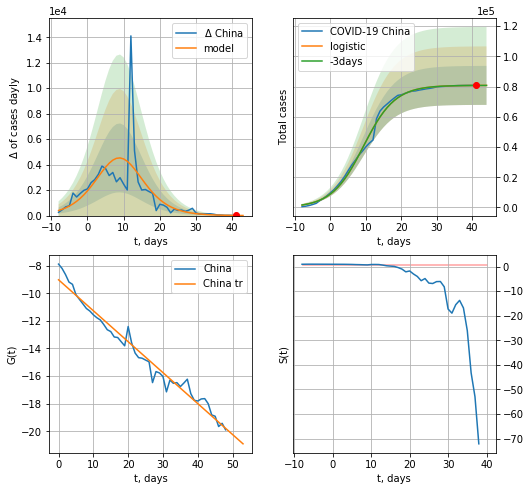

China data at: 2020-07-15
+3 day model MAPE: 0.00012785692335583266
model: logistic
coeffs:  [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.15971316009002232
forecast at the end of period: +3 days
	 deltaDaycases:  8
	 total cases:  80776 ± 12901
	 total death:  4476 ± 2144
trend coefficient of determination: 0.972183
 intercept: -9.021396
 slope: -0.224243


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


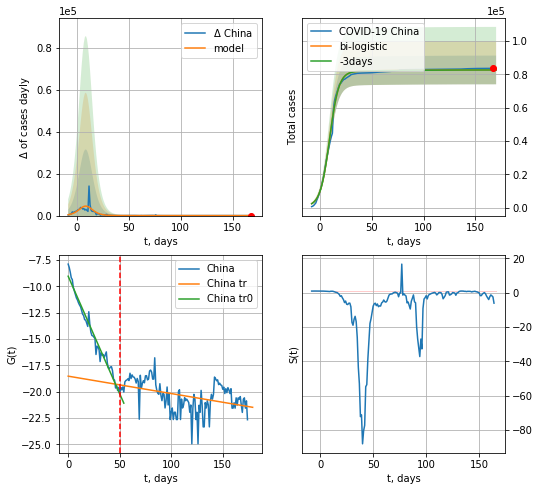

China data at: 2020-07-15
+3 day model MAPE: 0.00015972984831973103
model: bi-logistic
coeffs:  [1.89716492e+03 2.40893722e-02 1.16093320e+01] [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.1042265248675186
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  82666 ± 8616
	 total death:  4581 ± 1432
bi-logistic approximation splitting point: 50
trend0 coefficient of determination: 0.973282
 intercept: -9.036652
 slope: -0.223289
trend coefficient of determination: 0.167891
 intercept: -18.529019
 slope: -0.016524


In [152]:
dfCN = read_df(pd.DataFrame(),"CN")
try:
    x = forecast('China',dfCN[:50],d1,7*16-dT,1.0)
    #xx = forecast('China',dfCN[21:-32],d1,17)
    #xx = np.concatenate((x, xx), axis=0)
    xx = forecast2('China',dfCN[:],d1,16*7-dT,x,1.0,vL=50)
except:
    print ("Exception occurs")

In [153]:
#dfTT[dfTT.Country=='%s'%('China')][0].values[0]

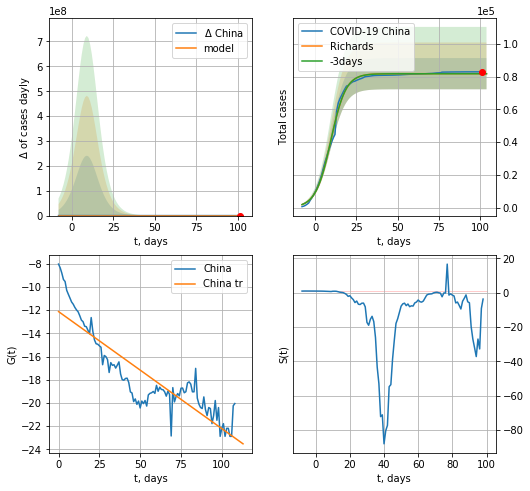

China data at: 2020-07-15
+3 day model MAPE: 0.000627
model: Richards
coeffs: [8.17736185e+04 2.15574478e-01 9.59539597e+00 1.02116157e+00]
rational stdev: 0.116457
forecast at the end of period: +3 days
	 deltaDaycases: 0
	 total cases: 81773 ± 9523
	 total death: 4532 ± 1583
trend coefficient of determination: 0.785239
 intercept: -12.125053
 slope: -0.100960


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


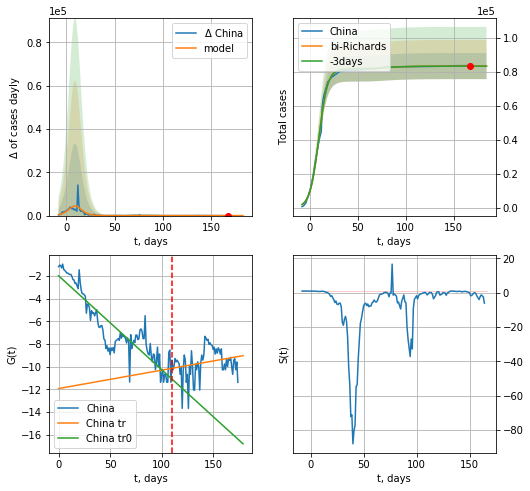

China data at: 2020-07-15
+3 day model MAPE: 0.000455
model: bi-Richards
coeffs: [ 1.55010926e+03  2.27664210e+01 -8.63940988e+00  2.95019333e-03]
rational stdev: 0.092232
forecast at the end of period: +17 days
	 deltaDaycases: 0
	 total cases: 83322 ± 7685
	 total death: 4617 ± 1277
bi-Richards approximation splitting point: 110
trend coefficient of determination: 0.821000
 intercept: -1.982944
 slope: -0.082684
trend coefficient of determination: 0.056161
 intercept: -11.918573
 slope: 0.016191


In [154]:
vL = 110
x = forecastRR('China',dfCN[:vL],d1,16*7-dT,1.0)
xx = forecast2RR('China',dfCN[:],d1,18*7-dT,x,1.0,vL=vL)
#x = forecastQR('China',dfCN[:],d1,6*7-dT,1.0)
#xx = forecast('China',dfCN[21:-32],d1,17)
#xx = np.concatenate((x, xx), axis=0)
#xx = forecast2R('China',dfCN[:],d1,6*7-dT,x,1.0)

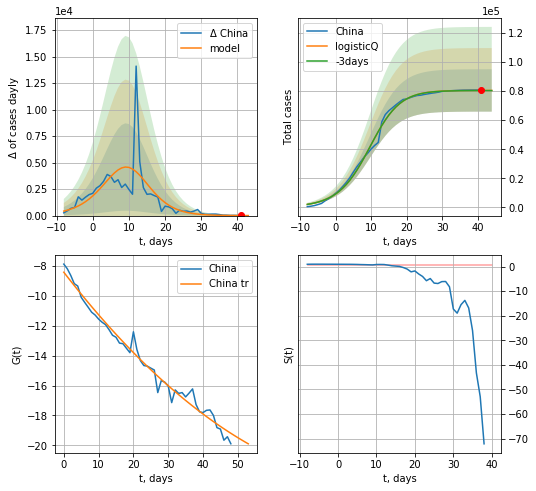

China data at: 2020-07-15
+3 day model MAPE: 0.001323
model: logisticQ
coeffs: [ 8.04175259e+04  1.07650457e-03  9.35257488e+00 -2.02425652e+02]
rational stdev: 0.181019
forecast at the end of period: +3 days
	 deltaDaycases: 2
	 total cases: 80409 ± 14555
	 total death: 4456 ± 2419
trend coefficient of determination: 0.979964
 intercept_: -8.428864441790822
 coeffs_: [ 0.         -0.29994819  0.00157784]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


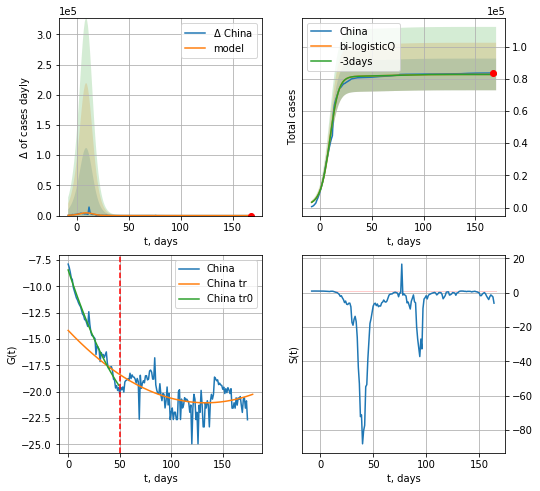

China data at: 2020-07-15
+3 day model MAPE: 0.000369
model: bi-logisticQ
coeffs: [ 2.30303962e+03  3.65713149e-04  2.47890548e+01 -4.67851715e-02]
rational stdev: 0.119035
forecast at the end of period: +3 days
	 deltaDaycases: 0
	 total cases: 82720 ± 9846
	 total death: 4584 ± 1636
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.980847
 intercept_: -8.442415731989867
 coeffs_: [ 0.         -0.29762768  0.00151769]
trend coefficient of determination: 0.263657
 intercept_: -14.18317832314077
 coeffs_: [ 0.         -0.1031165   0.00038658]


In [155]:
x = forecastRRR('China',dfCN[:50],d1,7*16-dT,1.0)
xx=forecast2RRR('China',dfCN[:],d1,16*7-dT,x,1.0,vL=50)

In [156]:
#x = forecastQR('China',dfCN[50:],d1,6*7-dT,1.0)

KR
           date  cases  active  death
147 2020-07-11  13417   950.0  289.0
148 2020-07-12  13479   986.0  289.0
149 2020-07-13  13512   941.0  289.0
150 2020-07-14  13551   914.0  289.0
151 2020-07-15  13612   925.0  291.0


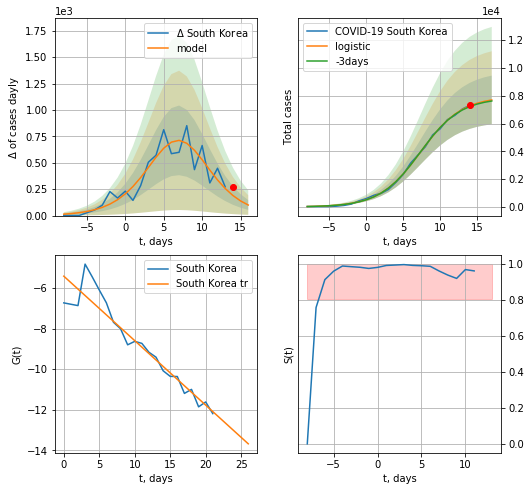

South Korea data at: 2020-07-15
model: logistic
coeffs:  [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.2275932520547523
forecast at the end of period: +3 days
	 deltaDaycases:  99
	 total cases:  7699 ± 1752
	 total death:  164 ± 111
trend coefficient of determination: 0.904554
 intercept: -5.419235
 slope: -0.317547


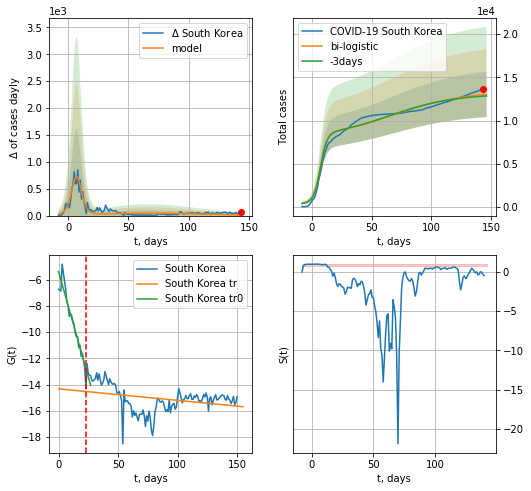

South Korea data at: 2020-07-15
+3 day model MAPE: 0.012243582418270102
model: bi-logistic
coeffs:  [5.42371171e+03 3.41775733e-02 6.82778165e+01] [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.20063786095092376
forecast at the end of period: +3 days
	 deltaDaycases:  11
	 total cases:  13009 ± 2610
	 total death:  278 ± 167
bi-logistic approximation splitting point: 23
trend0 coefficient of determination: 0.916463
 intercept: -5.394262
 slope: -0.321115
trend coefficient of determination: 0.100830
 intercept: -14.322532
 slope: -0.008773


In [157]:
dfKR = read_df(pd.DataFrame(),"KR")
x = forecast('South Korea',dfKR[:23],d1,7*16-dT,1.0,pMAPE=False)
xx=forecast2('South Korea',dfKR[:],d1,16*7-dT,x,1.0,vL=23)

In [158]:
#vL = 30
#x = forecastRRR('South Korea',dfKR[:vL],d1,8*7-dT,1.0)
#x1 = forecastRRR('South Korea',dfKR[39:],d1,12*7-dT,1.0)
#xx = np.concatenate((x, x1), axis=0)
#xx=forecast2RRR('South Korea',dfKR[:],d1,8*7-dT,x,1.0,vL=vL)

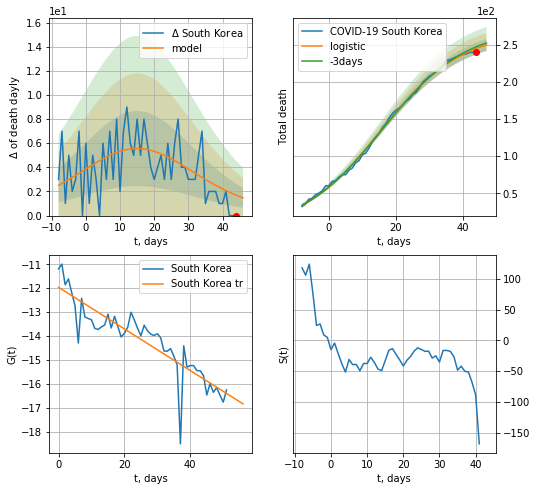

South Korea data at: 2020-07-15
model: logistic
coeffs:  [2.68513907e+02 8.28168908e-02 1.55065021e+01]
rational stdev:  0.03241893689547546
forecast at the end of period: +3 days
	 total death:  250 ± 8
trend coefficient of determination: 0.782213
 intercept: -11.965009
 slope: -0.087016


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:245: RuntimeWarning: divide by zero encountered in true_divide


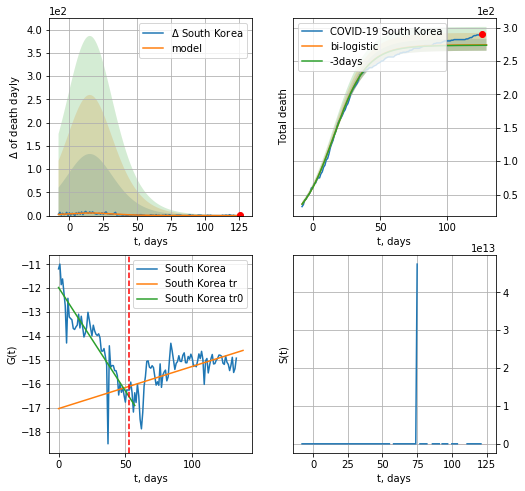

South Korea data at: 2020-07-15
+3 day model MAPE: 0.0025811740673673303
model: bi-logistic
coeffs:  [ 6.11299767  0.02350187 13.58568123] [2.68513907e+02 8.28168908e-02 1.55065021e+01]
rational stdev:  0.032530214740636214
forecast at the end of period: +3 days
	 deltaDaydeath:  0
	 total death:  274 ± 8
bi-logistic approximation splitting point: 53
trend0 coefficient of determination: 0.789613
 intercept: -11.973248
 slope: -0.086531
trend coefficient of determination: 0.374089
 intercept: -17.036931
 slope: 0.017631


In [159]:
x = forecast('South Korea',dfKR[17:70],d1,16*7-dT,1.0,cases='death',pMAPE=False)
xx=forecast2('South Korea',dfKR[17:],d1,16*7-dT,x,1.0,vL=70-17,cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


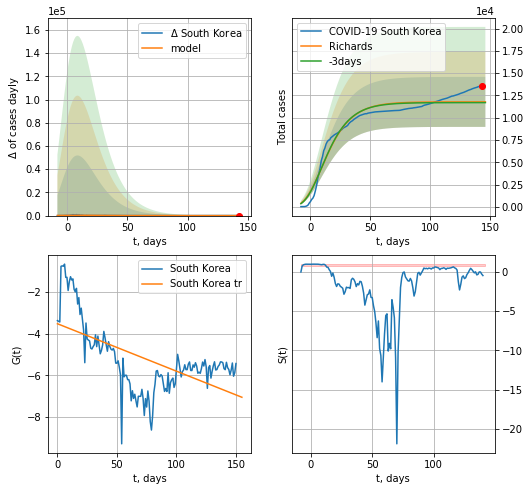

South Korea data at: 2020-07-15
+3 day model MAPE: 0.007015
model: Richards
coeffs: [ 1.17772158e+04  2.65379891e+01 -7.36339481e+01  2.69479466e-03]
rational stdev: 0.238077
forecast at the end of period: +3 days
	 deltaDaycases: 0
	 total cases: 11776 ± 2803
	 total death: 251 ± 179
trend coefficient of determination: 0.354094
 intercept: -3.525712
 slope: -0.022728


In [160]:
x = forecastRR('South Korea',dfKR[:],d1,16*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


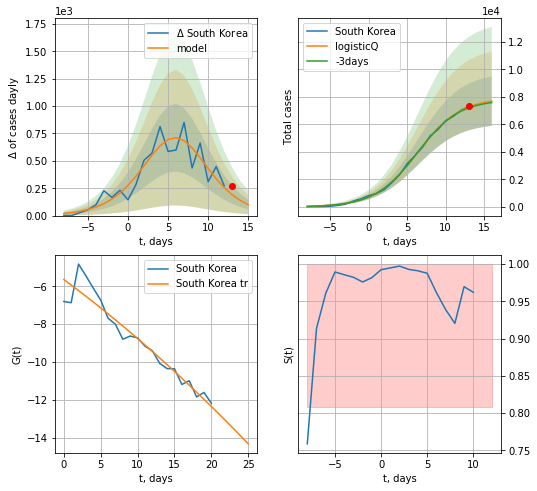

South Korea data at: 2020-07-15
+3 day model MAPE: 0.011158
model: logisticQ
coeffs: [ 7.93644801e+03  5.70813767e-05  6.37140978e+00 -6.30171017e+03]
rational stdev: 0.233522
forecast at the end of period: +3 days
	 deltaDaycases: 99
	 total cases: 7697 ± 1797
	 total death: 164 ± 114
trend coefficient of determination: 0.923340
 intercept_: -5.639271391154587
 coeffs_: [ 0.         -0.28882126 -0.00235709]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:333: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


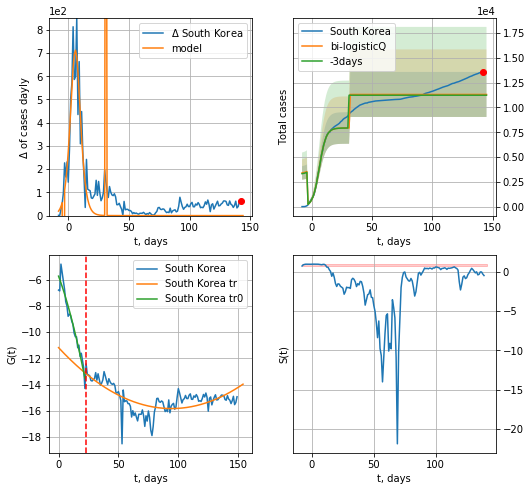

South Korea data at: 2020-07-15
+3 day model MAPE: 0.006811
model: bi-logisticQ
coeffs: [3373.29131572   11.89973398   31.24094241   -3.64983845]
rational stdev: 0.200234
forecast at the end of period: +3 days
	 deltaDaycases: 0
	 total cases: 11309 ± 2264
	 total death: 241 ± 144
bi-logisticQ approximation splitting point: 23
trend coefficient of determination: 0.939645
 intercept_: -5.742054822567119
 coeffs_: [ 0.         -0.24685696 -0.00483449]
trend coefficient of determination: 0.473319
 intercept_: -11.183165787333998
 coeffs_: [ 0.         -0.09842181  0.00052172]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


In [161]:
vL=23
x = forecastRRR('South Korea',dfKR[1:vL],d1,16*7-dT,1.0)
xx=forecast2RRR('South Korea',dfKR[1:],d1,16*7-dT,x,1.0,vL=vL)

In [162]:
#x = forecastRR('South Korea',dfKR[68:],d1,10*7-dT,1.0)

In [163]:
#vL=25
#x = forecastQR('South Korea',dfKR[1:vL],d1,16*7-dT,1.0)
#xx=forecast2QR('South Korea',dfKR[1:],d1,16*7-dT,x,1.0,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


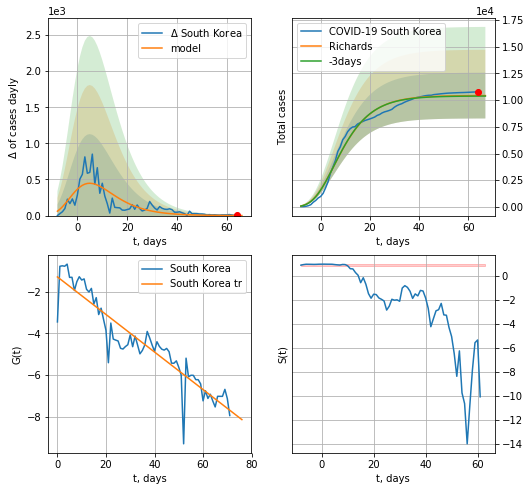

South Korea data at: 2020-07-15
+3 day model MAPE: 0.004451
model: Richards
coeffs: [ 1.04318163e+04  3.06447185e+01 -4.21690973e+01  3.81700530e-03]
rational stdev: 0.205493
forecast at the end of period: +3 days
	 deltaDaycases: 0
	 total cases: 10424 ± 2142
	 total death: 222 ± 136
trend coefficient of determination: 0.863609
 intercept: -1.289365
 slope: -0.090003


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


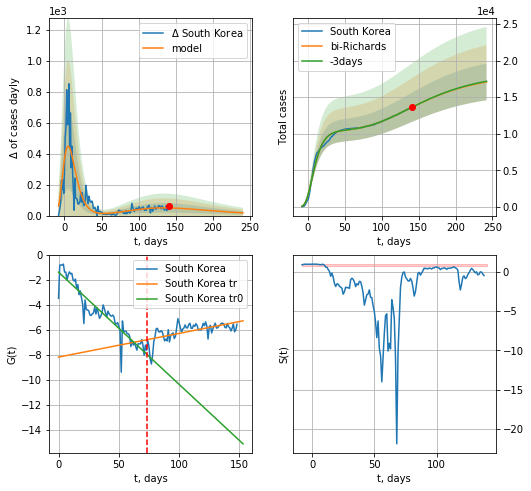

South Korea data at: 2020-07-15
+3 day model MAPE: 0.000465
model: bi-Richards
coeffs: [ 7.71756898e+03  1.05660725e+00 -9.62394253e+01  1.67664344e-02]
rational stdev: 0.146850
forecast at the end of period: +101 days
	 deltaDaycases: 17
	 total cases: 17082 ± 2508
	 total death: 365 ± 160
bi-Richards approximation splitting point: 73
trend coefficient of determination: 0.866297
 intercept: -1.398812
 slope: -0.089819
trend coefficient of determination: 0.385681
 intercept: -8.198019
 slope: 0.018971


In [164]:
vL = 2
vL1 = 75
x = forecastRR('South Korea',dfKR[vL:vL1],d1,16*7-dT,1.0)
xx=forecast2RR('South Korea',dfKR[vL:],d1,30*7-dT,x,1.0,vL=vL1-vL)
#xx = np.concatenate((x, xx), axis=0)
#print (xx)
#xxx=forecast3RR('South Korea',dfKR[1:],d1,12*7-dT,xx,1.0,vL=[vL,vL1],zoom=1e3)

In [165]:
a = np.array([ 7.90607495e+03,  3.14377481e-03, -1.32150046e+02,  5.22462480e+00, 7.59593205e-01])
b = np.array([ 2.91876181e+03,  1.43325056e-01, -3.99886263e+01, -3.39427361e+02, 1.77367535e-03])
QRkoreaCoeffs=b/a
QRkoreaCoeffs,RkoreaCoeffs,koreaCoeffs

(array([ 3.69179628e-01,  4.55901153e+01,  3.02600169e-01, -6.49668395e+01,
         2.33503320e-03]),
 [0.36242246, 2.56241634, 1.84890887, 0.13324732],
 [0.35416971, 0.02606324, 4.35859408, 19.30413219])

In [166]:
#x = forecastQR('South Korea',dfKR[:],d1,16*7-dT,1.0)

SG
           date    cases  active  death
170 2020-07-11  45961.0    3909   26.0
171 2020-07-12  46283.0    3972   26.0
172 2020-07-13  46630.0    4063   26.0
173 2020-07-14  46878.0    4114   27.0
174 2020-07-15  46878.0    3863   27.0


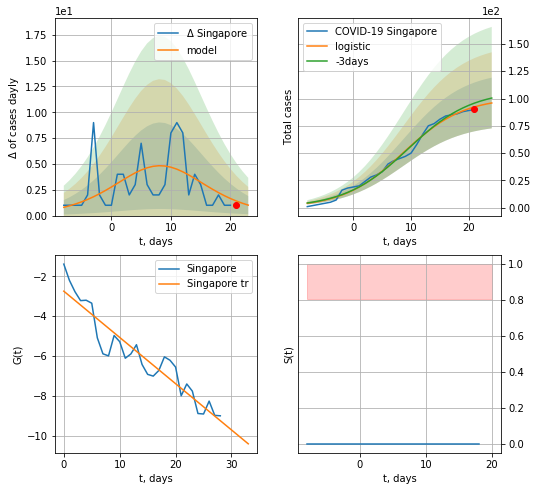

Singapore data at: 2020-07-15
+3 day model MAPE: 0.03963437966370839
model: logistic
coeffs:  [101.02990869   0.19128696   8.67555654]
rational stdev:  0.24212715882466435
forecast at the end of period: +3 days
	 deltaDaycases:  1
	 total cases:  95 ± 23
	 total death:  0 ± 0
trend coefficient of determination: 0.887345
 intercept: -2.744831
 slope: -0.232145


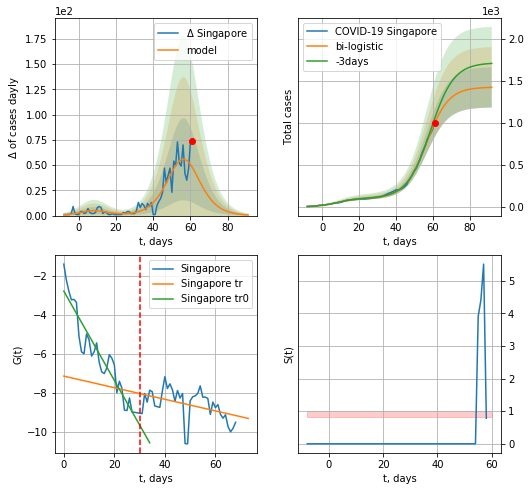

Singapore data at: 2020-07-15
+3 day model MAPE: 0.06119828055586902
model: bi-logistic
coeffs:  [1.32695355e+03 1.68329223e-01 5.66911530e+01] [101.02990869   0.19128696   8.67555654]
rational stdev:  0.16894112354758975
forecast at the end of period: +31 days
	 deltaDaycases:  0
	 total cases:  1424 ± 240
	 total death:  0 ± 0
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend coefficient of determination: 0.177815
 intercept: -7.138791
 slope: -0.029776
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


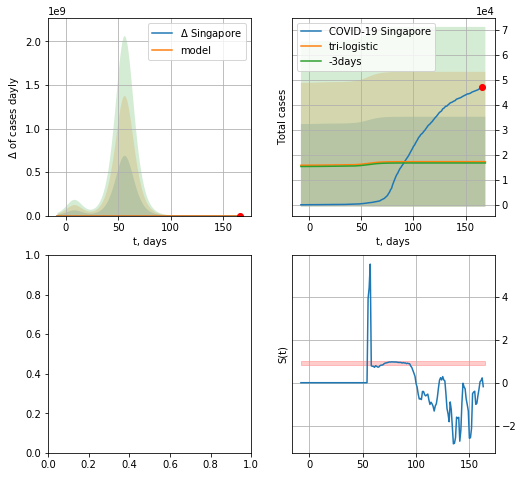

In [167]:
vL = 30
vL1 = 70
try:
    dfSG = read_df(pd.DataFrame(),"SG")
    x = forecast('Singapore',dfSG[:vL],d1,7*16-dT,1.0)
    xx = forecast2('Singapore',dfSG[:vL1],d1,20*7-dT,x,1.0,vL=vL)
    xx = np.concatenate((x, xx), axis=0)
    xxx = forecast3("Singapore",dfSG,d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


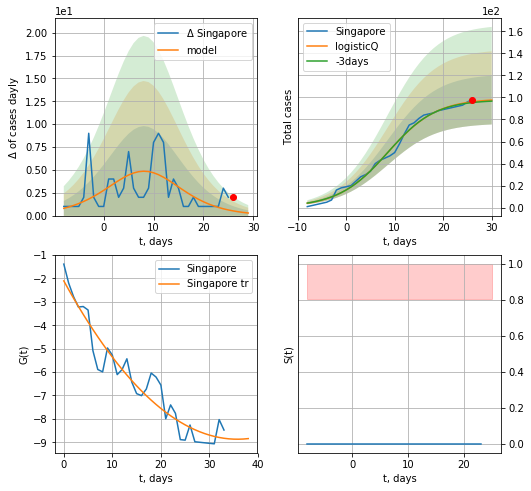

Singapore data at: 2020-07-14
+3 day model MAPE: 0.008158
model: logisticQ
coeffs: [ 9.88556757e+01  2.70682558e-04  8.43151542e+00 -7.17677228e+02]
rational stdev: 0.226599
forecast at the end of period: +4 days
	 deltaDaycases: 0
	 total cases: 97 ± 22
	 total death: 0 ± 0
trend coefficient of determination: 0.918167
 intercept_: -2.103369555726971
 coeffs_: [ 0.         -0.37832792  0.00528917]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


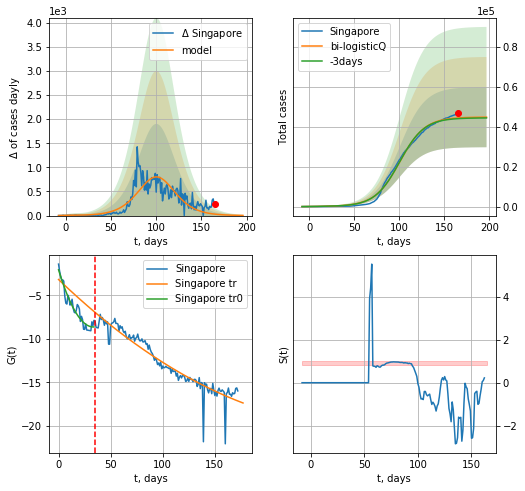

Singapore data at: 2020-07-14
+3 day model MAPE: 0.008082
model: bi-logisticQ
coeffs: [ 4.46970267e+04  2.38809441e-07  1.00674696e+02 -3.00937235e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.336304
forecast at the end of period: +32 days
	 deltaDaycases: 3
	 total cases: 44754 ± 15051
	 total death: 25 ± 25
bi-logisticQ approximation splitting point: 35
trend coefficient of determination: 0.914568
 intercept_: -2.036640634366525
 coeffs_: [ 0.         -0.39517788  0.00592335]
trend coefficient of determination: 0.902950
 intercept_: -3.1605340405031264
 coeffs_: [ 0.         -0.11500862  0.00019567]


In [397]:
vL = 35
x = forecastRRR('Singapore',dfSG[:vL],d1,7*16-dT,1.0)
xx = forecast2RRR('Singapore',dfSG[:],d1,20*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

In [398]:
#vL = 31
#x = forecast('Singapore',dfSG[:vL],d1,6*7-dT,1.0)
#xx = forecast2('Singapore',dfSG[:],d1,12*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

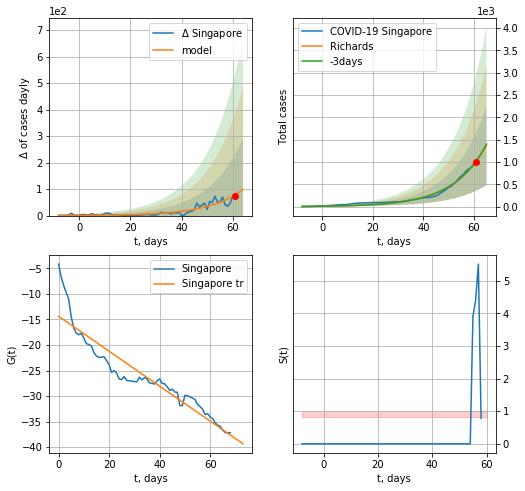

Singapore data at: 2020-07-14
+3 day model MAPE: 0.018051
model: Richards
coeffs: [1.18117390e+04 7.51038869e-02 9.36818943e+01 5.00334733e+00]
rational stdev: 0.645525
forecast at the end of period: +4 days
	 deltaDaycases: 99
	 total cases: 1370 ± 884
	 total death: 0 ± 0
trend coefficient of determination: 0.869761
 intercept: -14.373614
 slope: -0.342000


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


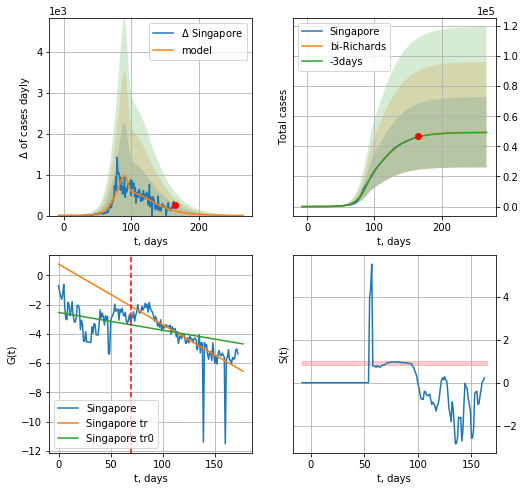

Singapore data at: 2020-07-14
+3 day model MAPE: 0.001966
model: bi-Richards
coeffs: [ 3.76121836e+04  3.23965997e+00 -7.65697234e+00  1.22701248e-02]
rational stdev: 0.472621
forecast at the end of period: +102 days
	 deltaDaycases: 2
	 total cases: 49368 ± 23332
	 total death: 28 ± 39
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.061628
 intercept: -2.530435
 slope: -0.012176
trend coefficient of determination: 0.630732
 intercept: 0.778017
 slope: -0.041466


In [399]:
vL = 70
x = forecastRR('Singapore',dfSG[:vL],d1,16*7-dT,1.0)
x = forecast2RR('Singapore',dfSG[:],d1,30*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#xx = forecast2R('Singapore',dfSG[:],d1,28*7-dT,x,1.0)
#x = forecastQR('Singapore',dfSG[60:],d1,16*7-dT,1.0)

ES
           date   cases  active  death
121 2020-07-11  2014.4      50   69.0
122 2020-07-12  2014.6      50   69.0
123 2020-07-13  2015.0      50   69.0
124 2020-07-14  2016.0      46   69.0
125 2020-07-15  2016.0      46   69.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


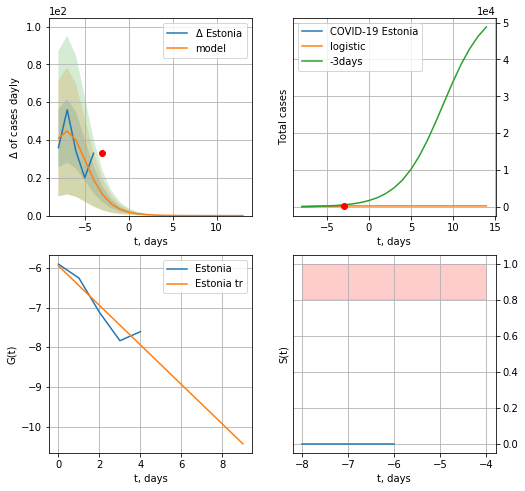

Estonia data at: 2020-07-15
+3 day model MAPE: 0.6707560476295664
model: logistic
coeffs:  [277.64023436   0.65084323  -6.57074778]
rational stdev:  0.028784635346108894
forecast at the end of period: +17 days
	 deltaDaycases:  0
	 total cases:  277 ± 7
	 total death:  9 ± 0
trend coefficient of determination: 0.881874
 intercept: -5.949047
 slope: -0.498463
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


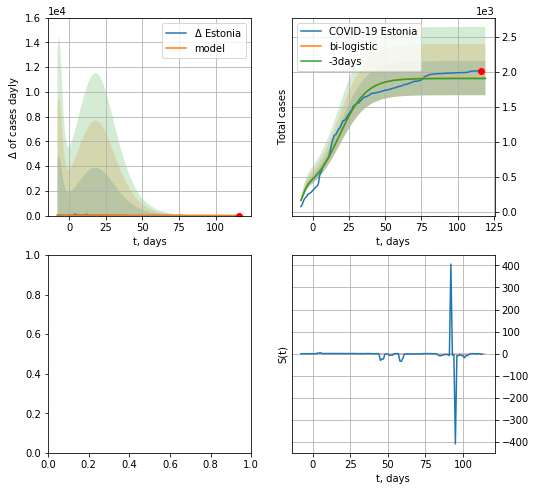

In [168]:
shift = 1.0
try:
    dfES = read_df(pd.DataFrame(),"ES")
    x = forecast('Estonia',dfES[1:7],d1,17,1.)
    xx = forecast2('Estonia',dfES[1:],d1,16*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.5],vL=7)
except:
    print ("Exception occurs")

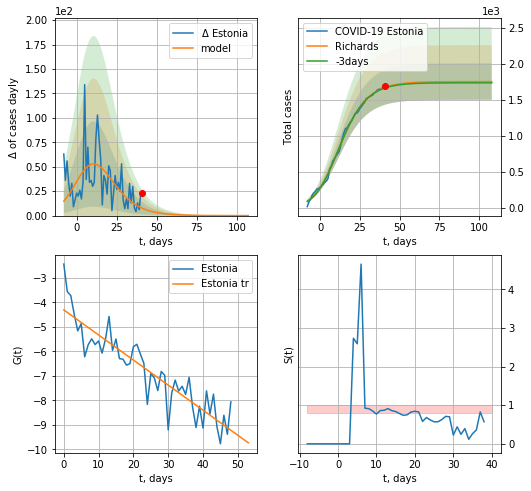

Estonia data at: 2020-07-14
+3 day model MAPE: 0.005500
model: Richards
coeffs: [1.74994618e+03 2.01777902e-01 4.40550518e+00 5.06367091e-01]
rational stdev: 0.144467
forecast at the end of period: +67 days
	 deltaDaycases: 0
	 total cases: 1749 ± 252
	 total death: 59 ± 25
trend coefficient of determination: 0.813896
 intercept: -4.307388
 slope: -0.102288


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


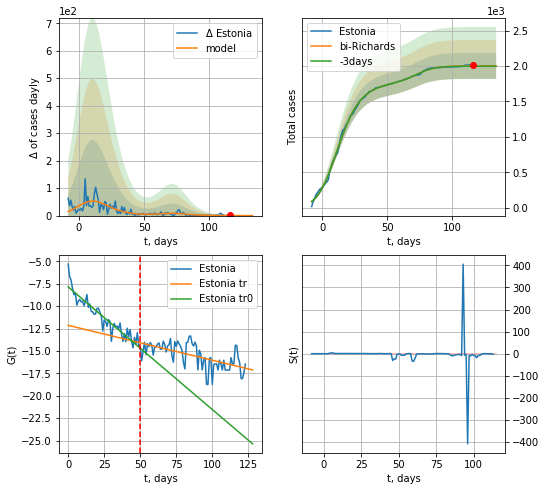

Estonia data at: 2020-07-14
+3 day model MAPE: 0.001978
model: bi-Richards
coeffs: [2.52578441e+02 1.15682681e-01 7.34227439e+01 1.16480277e+00]
rational stdev: 0.091448
forecast at the end of period: +18 days
	 deltaDaycases: 0
	 total cases: 2002 ± 183
	 total death: 68 ± 18
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.868739
 intercept: -7.859775
 slope: -0.136714
trend coefficient of determination: 0.366661
 intercept: -12.145566
 slope: -0.038877


In [389]:
vL=50
x = forecastRR('Estonia',dfES[:vL],d1,7*25-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
#x = forecastQR('Estonia',dfES[10:],d1,7*10-dT,1.)
xx = forecast2RR('Estonia',dfES[:],d1,7*18-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


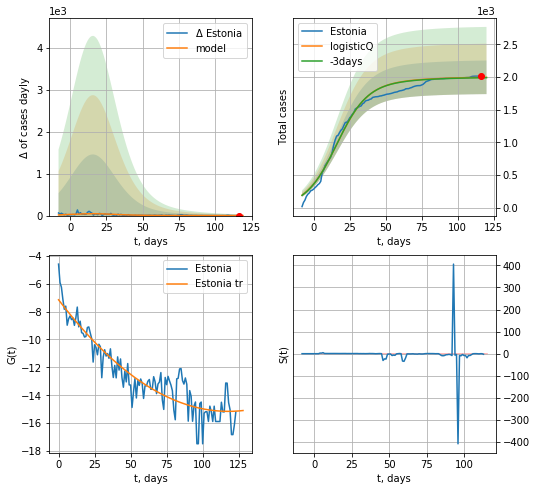

Estonia data at: 2020-07-14
+3 day model MAPE: 0.002829
model: logisticQ
coeffs: [ 1.91934404e+03  1.75915998e-07  1.60252774e+01 -5.24740627e+05]
S.Korea scenario coeffs: [0.04375, 0.5, 4.0, 1]
rational stdev: 0.128885
forecast at the end of period: +4 days
	 deltaDaycases: 0
	 total cases: 1997 ± 257
	 total death: 68 ± 26
trend coefficient of determination: 0.850315
 intercept_: -7.153485092911882
 coeffs_: [ 0.         -0.13584961  0.00057638]


In [390]:
x = forecastRRR('Estonia',dfES[:],d1,7*16-dT,1.,addpred=True,xcoef=[0.35/8,.5,4.,1])

LV
           date   cases  active  death
126 2020-07-11  1173.5     124   30.0
127 2020-07-12  1174.0     124   31.0
128 2020-07-13  1174.5     124   31.0
129 2020-07-14  1178.0     125   31.0
130 2020-07-15  1178.0     125   31.0


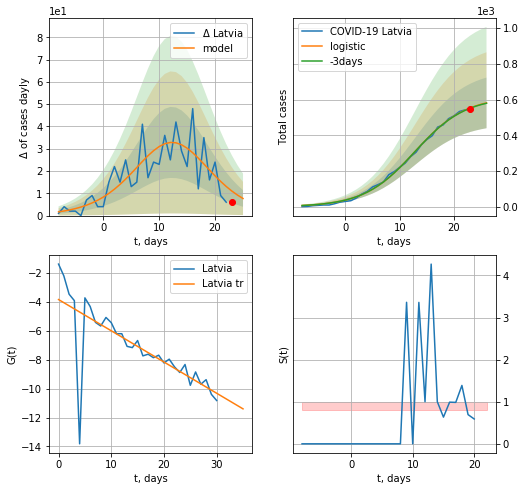

Latvia data at: 2020-07-15
+3 day model MAPE: 0.0032633377916749073
model: logistic
coeffs:  [6.16080291e+02 2.13516215e-01 1.27871959e+01]
rational stdev:  0.24373797630646024
forecast at the end of period: +3 days
	 deltaDaycases:  7
	 total cases:  581 ± 141
	 total death:  15 ± 10
trend coefficient of determination: 0.538666
 intercept: -3.837099
 slope: -0.216023
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


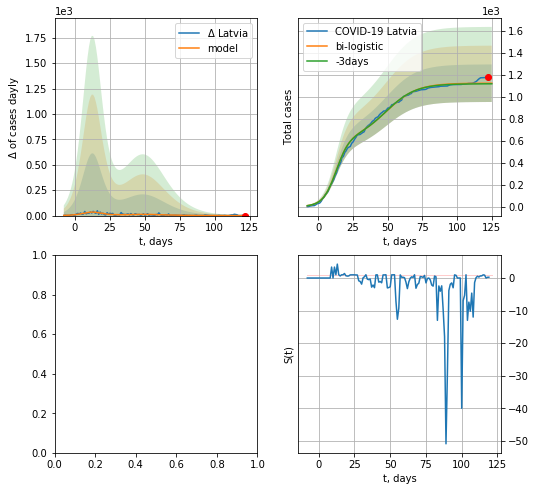

In [169]:
vL=32
dfLV = read_df(pd.DataFrame(),"LV")
try:
    x = forecast('Latvia',dfLV[:vL],d1,16*7-dT,1.)
    xx=forecast2('Latvia',dfLV[:],d1,16*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.],vL=vL)
except:
    print("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


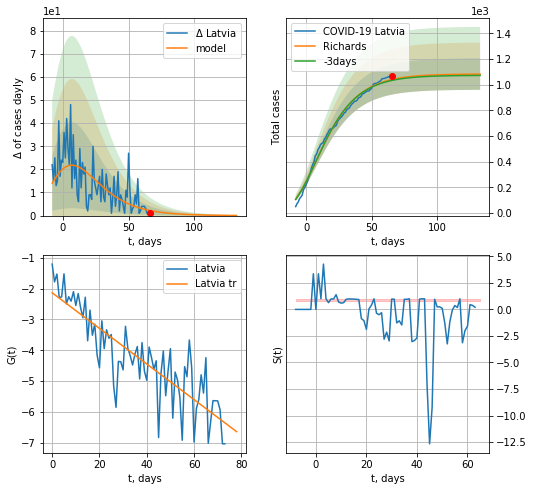

Latvia data at: 2020-07-14
+3 day model MAPE: 0.006926
model: Richards
coeffs: [ 1.08328033e+03  6.56132882e+00 -7.95832854e+01  8.37818967e-03]
rational stdev: 0.113288
forecast at the end of period: +67 days
	 deltaDaycases: 0
	 total cases: 1082 ± 122
	 total death: 28 ± 9
trend coefficient of determination: 0.723415
 intercept: -2.136837
 slope: -0.057686


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


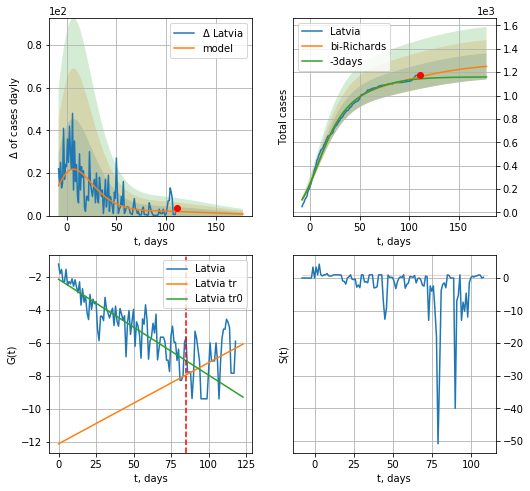

Latvia data at: 2020-07-14
+3 day model MAPE: 0.016943
model: bi-Richards
coeffs: [ 2.00295063e+02  2.45684466e+00 -8.86380165e+01  9.67018107e-03]
rational stdev: 0.090069
forecast at the end of period: +67 days
	 deltaDaycases: 0
	 total cases: 1249 ± 112
	 total death: 32 ± 8
bi-Richards approximation splitting point: 85
trend coefficient of determination: 0.757659
 intercept: -2.130350
 slope: -0.058129
trend coefficient of determination: 0.101365
 intercept: -12.114306
 slope: 0.049194


In [164]:
iL=10
vL = 85+iL
x = forecastRR('Latvia',dfLV[iL:vL-iL],d1,7*25-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Latvia',dfLV[iL:],d1,7*25-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#x = forecastQR('Latvia',dfLV[:],d1,7*16-dT,1.)
#xx=forecast2R('Latvia',dfLV[:],d1,10*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


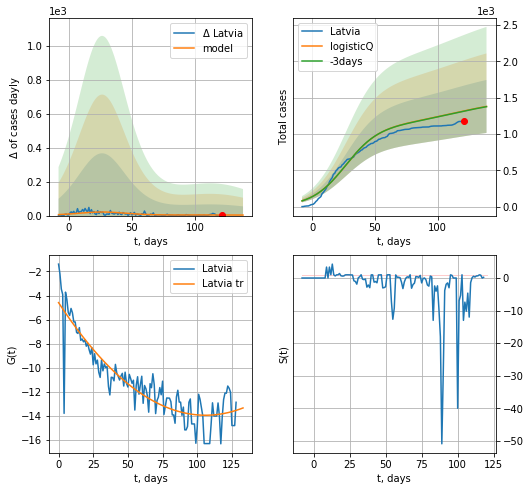

Latvia data at: 2020-07-14
+3 day model MAPE: 0.002029
model: logisticQ
coeffs: [ 1.10568057e+03  1.52656687e-07  2.66490752e+01 -4.88393973e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.264538
forecast at the end of period: +18 days
	 deltaDaycases: 3
	 total cases: 1380 ± 365
	 total death: 36 ± 28
trend coefficient of determination: 0.807293
 intercept_: -4.592456900318891
 coeffs_: [ 0.         -0.17691813  0.00083445]


In [165]:
#trend3(dfCA[12:],dfPT,dfTR[4:],'CA','PT','TR',40,40,40)
x = forecastRRR('Latvia',dfLV[:],d1,7*18-dT,1.,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


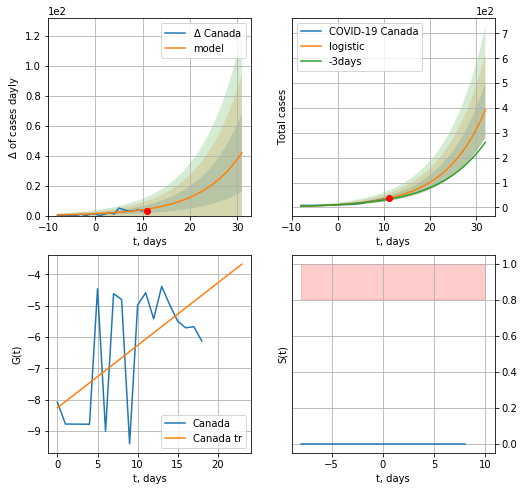

Canada data at: 2020-07-15
+3 day model MAPE: 0.14132705134128837
model: logistic
coeffs:  [1.25340432e+05 1.13222117e-01 8.29016731e+01]
rational stdev:  0.2833741000964234
forecast at the end of period: +21 days
	 deltaDaycases:  41
	 total cases:  392 ± 111
	 total death:  31 ± 26
trend coefficient of determination: 0.348503
 intercept: -8.254919
 slope: 0.199271


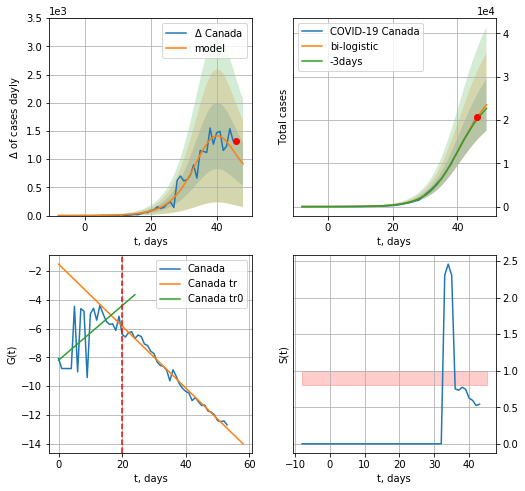

Canada data at: 2020-07-15
+3 day model MAPE: 0.02936701556145869
model: bi-logistic
coeffs:  [2.40154010e+04 2.16961372e-01 4.02658693e+01] [1.25340432e+05 1.13222117e-01 8.29016731e+01]
rational stdev:  0.2549294046309869
forecast at the end of period: +3 days
	 deltaDaycases:  918
	 total cases:  23518 ± 5995
	 total death:  1903 ± 1455
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend coefficient of determination: 0.982767
 intercept: -1.518979
 slope: -0.215271


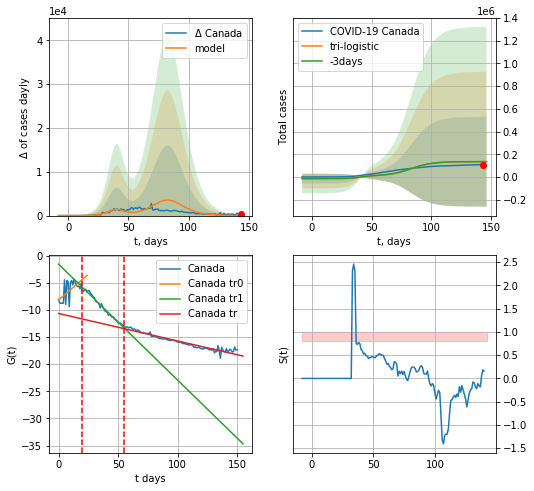

Canada data at: 2020-07-15
+3 day model MAPE: 0.0038936570242186185
model: tri-logistic
coeffs:  [-1.45654718e+04  1.81984980e+00 -3.11239106e+01] [1.25340432e+05 1.13222117e-01 8.29016731e+01 2.40154010e+04
 2.16961372e-01 4.02658693e+01]
forecast rational stdev:  2.9360732222376167
forecast at the end of period: +3 days
	 deltaDaycases:  11
	 total cases:  134691 ± 395464
	 total death:  10903 ± 96036
tri-logistic approximation splitting points: 20,55
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend1 coefficient of determination: 0.983223
 intercept: -1.572806
 slope: -0.213535
trend coefficient of determination: 0.931957
 intercept: -10.668693
 slope: -0.050580


In [170]:
vL=20
vL1=55
x = forecast('Canada',dfCA[:vL],d1,3*7,1.)
xx=forecast2('Canada',dfCA[:vL1],d1,16*7-dT,x,1.,vL=vL)#,addpred=True,xcoef=[0.25,1.,2.]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Canada",dfCA[:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

CA
           date     cases  active   death
147 2020-07-11  107347.0   27308  8773.0
148 2020-07-12  107590.0   27340  8783.0
149 2020-07-13  108155.0   27524  8790.0
150 2020-07-14  108486.0   27518  8798.0
151 2020-07-15  108829.0   27534  8810.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


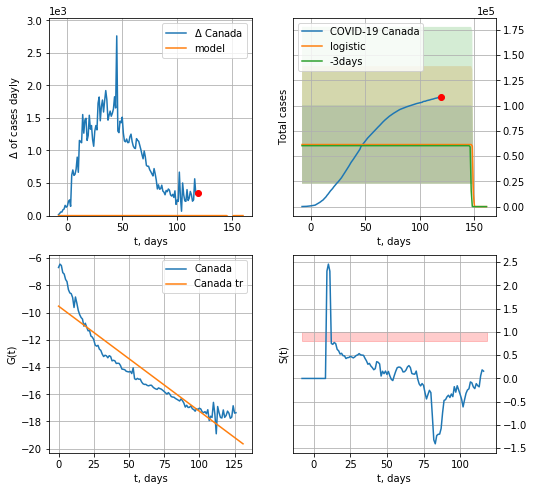

Canada data at: 2020-07-15
+3 day model MAPE: 0.018740303371340035
model: logistic
coeffs:  [ 6.14158594e+04 -5.06416642e+00  1.48722923e+02]
rational stdev:  0.6316869151023394
forecast at the end of period: +42 days
	 deltaDaycases:  0
	 total cases:  0 ± 0
	 total death:  0 ± 0
trend coefficient of determination: 0.874563
 intercept: -9.531922
 slope: -0.077170


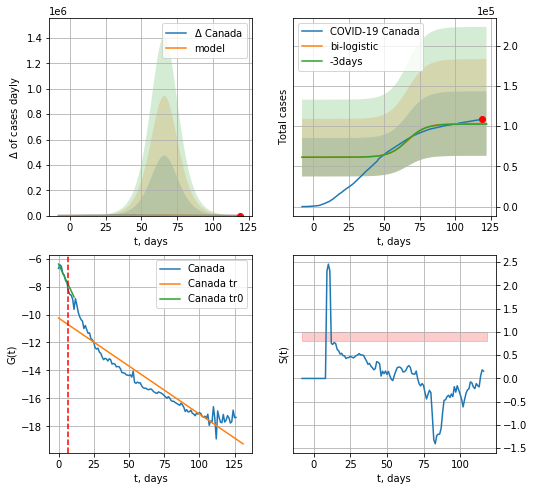

Canada data at: 2020-07-15
+3 day model MAPE: 0.0061506148848599574
model: bi-logistic
coeffs:  [4.17582370e+04 1.54078746e-01 6.64335510e+01] [ 6.14158594e+04 -5.06416642e+00  1.48722923e+02]
rational stdev:  0.3878944303341325
forecast at the end of period: +3 days
	 deltaDaycases:  1
	 total cases:  103166 ± 40017
	 total death:  8351 ± 9717
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.859073
 intercept: -6.392122
 slope: -0.214001
trend coefficient of determination: 0.895217
 intercept: -10.253192
 slope: -0.068718


In [171]:
dfCA = read_df(pd.DataFrame(),"CA")
x = forecast('Canada',dfCA[24:],d1,6*7,1.,cases='cases')
xx=forecast2('Canada',dfCA[24:],d1,16*7-dT,x,1.,vL=31-24,cases='cases')

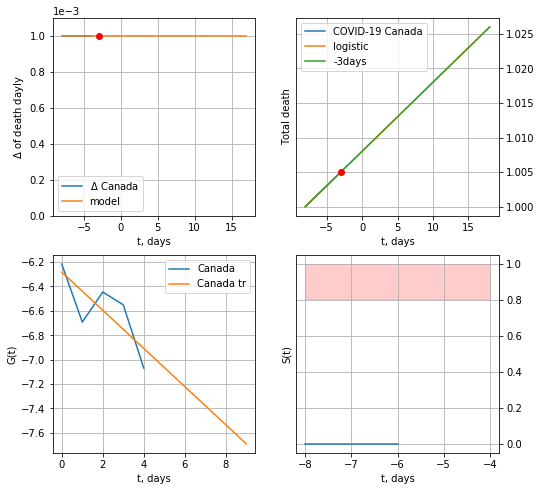

Canada data at: 2020-07-15
+3 day model MAPE: 5.06934136593531e-07
model: logistic
coeffs:  [2.01698683e+00 1.98322956e-03 4.93279263e-01]
rational stdev:  1.4705534785239981e-08
forecast at the end of period: +21 days
	 total death:  1 ± 0
trend coefficient of determination: 0.608158
 intercept: -6.282802
 slope: -0.156326


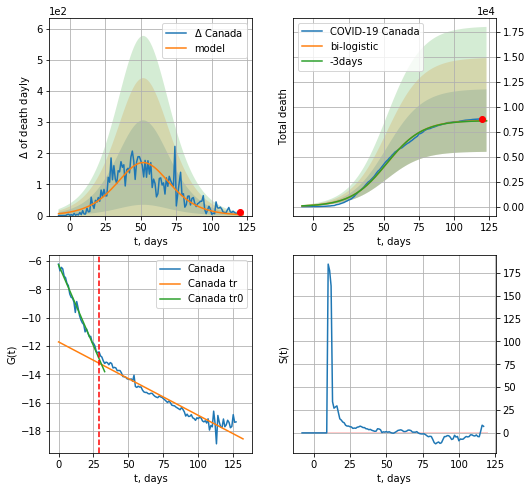

Canada data at: 2020-07-15
+3 day model MAPE: 0.002755685207007688
model: bi-logistic
coeffs:  [8.65723187e+03 7.86102563e-02 5.21634866e+01] [2.01698683e+00 1.98322956e-03 4.93279263e-01]
rational stdev:  0.36313029459587964
forecast at the end of period: +3 days
	 deltaDaydeath:  2
	 total death:  8625 ± 3132
bi-logistic approximation splitting point: 29
trend0 coefficient of determination: 0.986075
 intercept: -6.260314
 slope: -0.228750
trend coefficient of determination: 0.934701
 intercept: -11.709477
 slope: -0.051871


In [172]:
vL=29
vL1=50
x = forecast('Canada',dfCA[23:vL],d1,3*7,1.,cases='death')
xx=forecast2('Canada',dfCA[23:],d1,16*7-dT,x,1.,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,2.]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Canada",dfCA[24:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


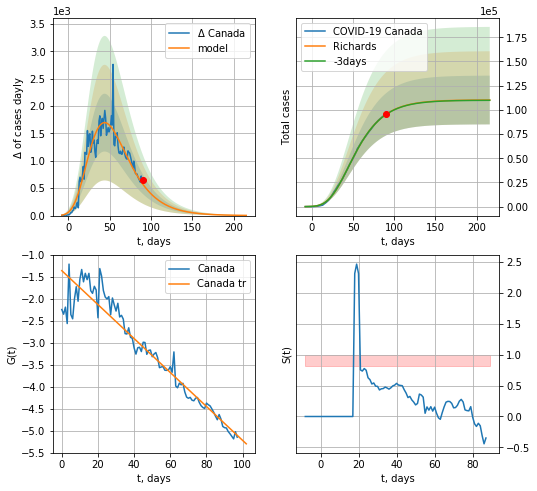

Canada data at: 2020-07-15
+3 day model MAPE: 0.001369
model: Richards
coeffs: [ 1.10207926e+05  3.57033020e+00 -6.12029769e+01  1.17943085e-02]
rational stdev: 0.228612
forecast at the end of period: +126 days
	 deltaDaycases: 3
	 total cases: 110128 ± 25176
	 total death: 8915 ± 6114
trend coefficient of determination: 0.921084
 intercept: -1.352095
 slope: -0.038614


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


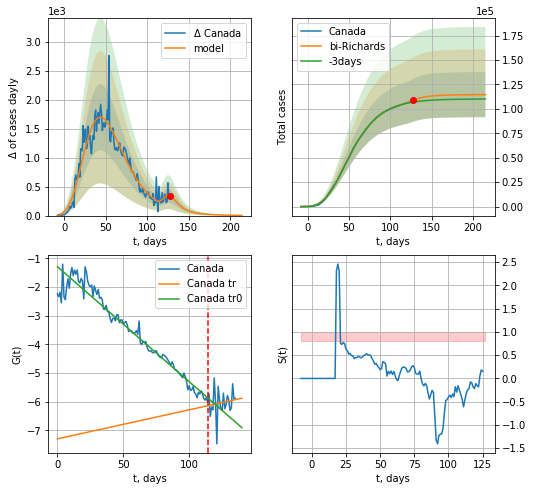

Canada data at: 2020-07-15
+3 day model MAPE: 0.019197
model: bi-Richards
coeffs: [4.44955238e+03 1.25253134e+01 9.12711306e+01 1.01589925e-02]
rational stdev: 0.201451
forecast at the end of period: +87 days
	 deltaDaycases: 3
	 total cases: 114574 ± 23081
	 total death: 9275 ± 5605
bi-Richards approximation splitting point: 114
trend coefficient of determination: 0.948223
 intercept: -1.287180
 slope: -0.040122
trend coefficient of determination: 0.020173
 intercept: -7.294001
 slope: 0.010130


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power


In [173]:
iL = 15
vL = 114 + iL
x = forecastRR('Canada',dfCA[iL:vL-iL],d1,18*7,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Canada',dfCA[iL:],d1,28*7-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#x = forecastQR('Canada',dfCA[28:],d1,16*7,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


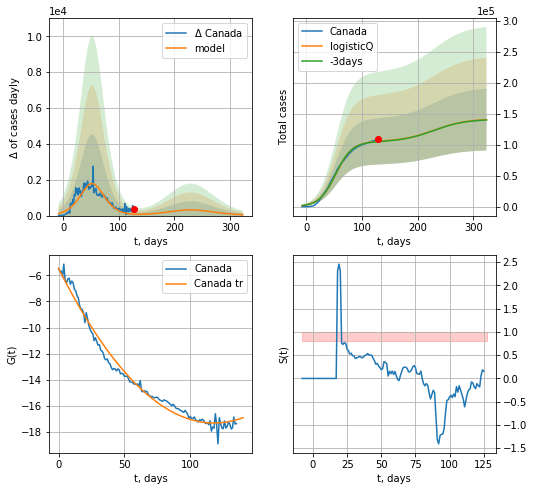

Canada data at: 2020-07-15
+3 day model MAPE: 0.004855
model: logisticQ
coeffs: [ 1.04902289e+05  2.61201061e-07  5.26364969e+01 -2.59775678e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.354953
forecast at the end of period: +196 days
	 deltaDaycases: 47
	 total cases: 140640 ± 49920
	 total death: 11385 ± 12123
trend coefficient of determination: 0.983277
 intercept_: -5.474591822023907
 coeffs_: [ 0.         -0.20069933  0.00085058]


In [174]:
x = forecastRRR('Canada',dfCA[15:],d1,7*28,1.,addpred=True,xcoef=koreaCoeffs)

PT
           date  cases  active   death
131 2020-07-11  46221   13912  1654.0
132 2020-07-12  46512   13945  1660.0
133 2020-07-13  46818   14091  1662.0
134 2020-07-14  47051   13833  1668.0
135 2020-07-15  47426   13640  1676.0


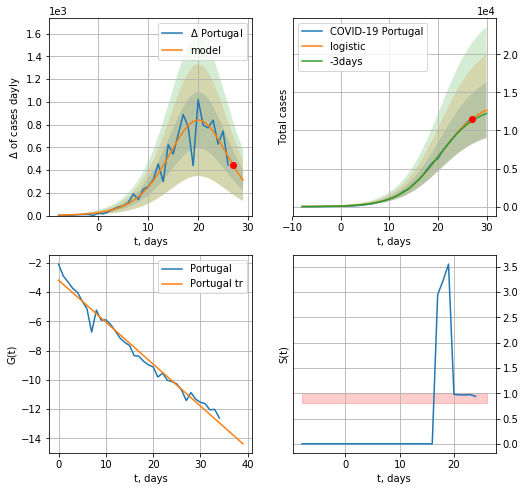

Portugal data at: 2020-07-15
+3 day model MAPE: 0.028768813359110825
model: logistic
coeffs:  [1.39435560e+04 2.41732854e-01 2.05234131e+01]
rational stdev:  0.2880659201380634
forecast at the end of period: +3 days
	 deltaDaycases:  310
	 total cases:  12662 ± 3647
	 total death:  447 ± 386
trend coefficient of determination: 0.976552
 intercept: -3.178197
 slope: -0.287215


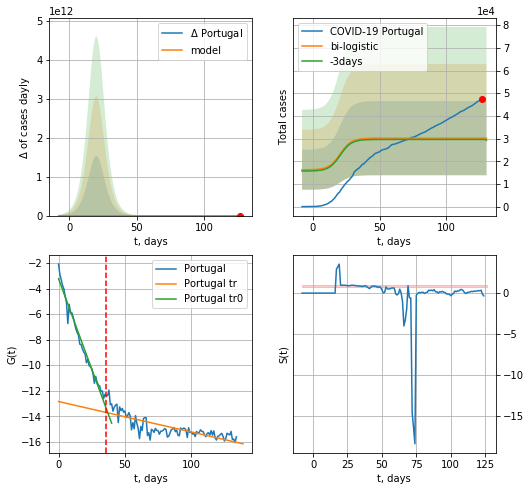

Portugal data at: 2020-07-15
+3 day model MAPE: 0.01920666069545072
model: bi-logistic
coeffs:  [ 1.29865484e+04 -5.11229098e+00  1.34360799e+02] [1.39435560e+04 2.41732854e-01 2.05234131e+01]
scenario coeffs:  [0.25, 1.0, 1.2]
rational stdev:  0.541713859304653
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  30176 ± 16347
	 total death:  1066 ± 1732
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975262
 intercept: -3.226992
 slope: -0.282910
trend coefficient of determination: 0.614644
 intercept: -12.847377
 slope: -0.023835


In [175]:
vL = 36
dfPT = read_df(pd.DataFrame(),"PT")
x = forecast('Portugal',dfPT[:vL],d1,16*7-dT,1.)
xx=forecast2('Portugal',dfPT[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,1.2],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


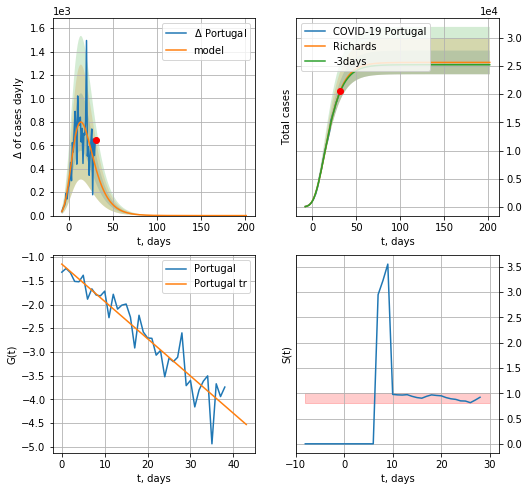

Portugal data at: 2020-07-15
+3 day model MAPE: 0.007427
model: Richards
coeffs: [ 2.56293555e+04  3.00842925e+00 -2.72819807e+01  2.85664516e-02]
rational stdev: 0.081945
forecast at the end of period: +171 days
	 deltaDaycases: 0
	 total cases: 25629 ± 2100
	 total death: 905 ± 222
trend coefficient of determination: 0.893966
 intercept: -1.147824
 slope: -0.078669


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


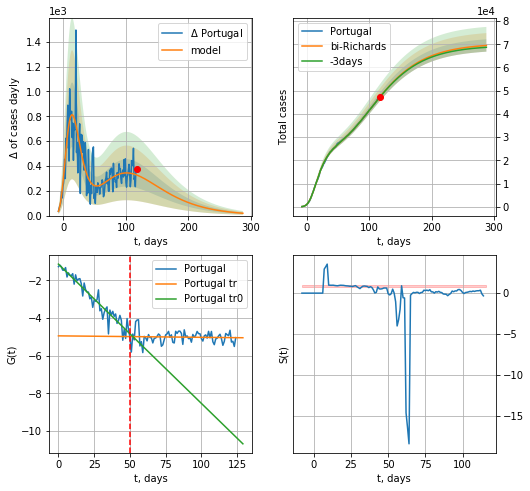

Portugal data at: 2020-07-15
+3 day model MAPE: 0.001702
model: bi-Richards
coeffs: [ 4.47410823e+04  1.13491066e+00 -8.78670300e+01  1.85114624e-02]
rational stdev: 0.038366
forecast at the end of period: +171 days
	 deltaDaycases: 18
	 total cases: 69480 ± 2665
	 total death: 2455 ± 282
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.914366
 intercept: -1.134261
 slope: -0.073961
trend coefficient of determination: 0.002899
 intercept: -4.943786
 slope: -0.000771


In [180]:

vL=60
x = forecastRR('Portugal',dfPT[10:vL-10],d1,40*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Portugal',dfPT[10:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


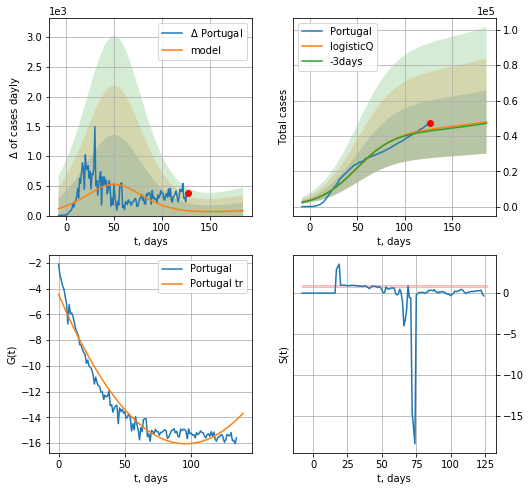

Portugal data at: 2020-07-15
+3 day model MAPE: 0.020353
model: logisticQ
coeffs: [ 4.32733414e+04  7.90692135e-08  5.03168040e+01 -6.06563790e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.373250
forecast at the end of period: +59 days
	 deltaDaycases: 81
	 total cases: 47948 ± 17896
	 total death: 1694 ± 1896
trend coefficient of determination: 0.946554
 intercept_: -4.428744284518668
 coeffs_: [ 0.         -0.2430836   0.00126962]


In [181]:
x = forecastRRR('Portugal',dfPT[:],d1,24*7-dT,1.,addpred=True,xcoef=koreaCoeffs)

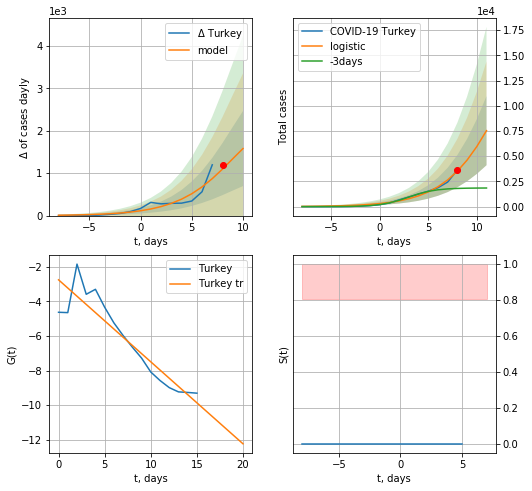

Turkey data at: 2020-07-15
+3 day model MAPE: 1.5246814929812549
model: logistic
coeffs:  [2.42672036e+04 3.25610640e-01 1.34529779e+01]
rational stdev:  0.45520286558776807
forecast at the end of period: +3 days
	 deltaDaycases:  1579
	 total cases:  7530 ± 3427
	 total death:  188 ± 256
trend coefficient of determination: 0.850665
 intercept: -2.746555
 slope: -0.474541


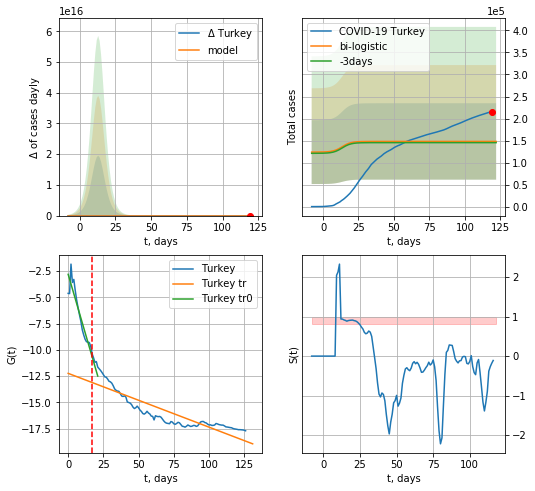

Turkey data at: 2020-07-15
+3 day model MAPE: 0.018952998280919134
model: bi-logistic
coeffs:  [ 9.89649819e+04 -5.37367516e+00  1.04363634e+03] [2.42672036e+04 3.25610640e-01 1.34529779e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.5858121109271415
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  147973 ± 86684
	 total death:  3713 ± 6525
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.862807
 intercept: -2.813054
 slope: -0.461241
trend coefficient of determination: 0.768766
 intercept: -12.242937
 slope: -0.051226


In [182]:
vL=17
x = forecast('Turkey',dfTR[:vL],d1,7*16-dT,1.)
xx=forecast2('Turkey',dfTR[:],d1,16*7-dT,x,1.,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


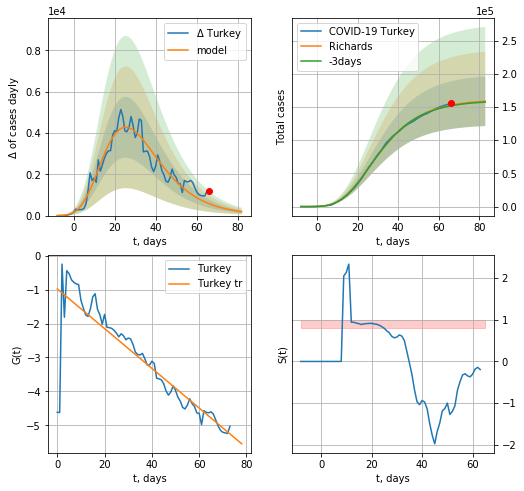

Turkey data at: 2020-07-15
+3 day model MAPE: 0.006544
model: Richards
coeffs: [ 1.61234317e+05  5.77708690e+00 -3.44331101e+01  1.25674474e-02]
rational stdev: 0.235071
forecast at the end of period: +17 days
	 deltaDaycases: 188
	 total cases: 158711 ± 37308
	 total death: 3982 ± 2808
trend coefficient of determination: 0.775257
 intercept: -0.978832
 slope: -0.058549


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


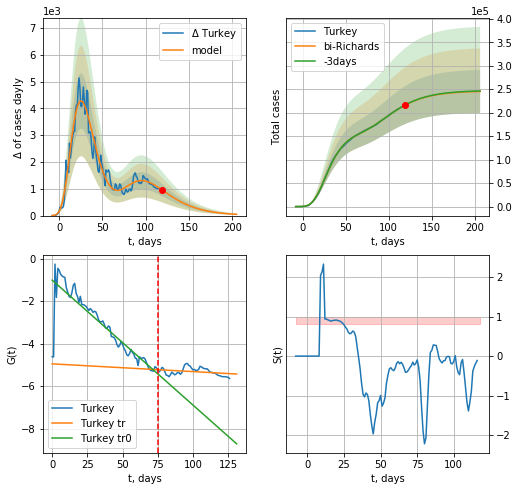

Turkey data at: 2020-07-15
+3 day model MAPE: 0.001024
model: bi-Richards
coeffs: [ 8.51385372e+04  2.31300681e+00 -3.56388550e+00  1.72518083e-02]
rational stdev: 0.186821
forecast at the end of period: +87 days
	 deltaDaycases: 46
	 total cases: 245228 ± 45813
	 total death: 6153 ± 3448
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.785466
 intercept: -1.011346
 slope: -0.058829
trend coefficient of determination: 0.094468
 intercept: -4.952541
 slope: -0.003652


In [183]:
vL = 75
x = forecastRR('Turkey',dfTR[:vL],d1,18*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Turkey',dfTR[:],d1,28*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

In [184]:
#x = forecastQR('Turkey',dfTR[:],d1,16*7,1.,addpred=False,xcoef=[0.35,.5,3,1,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


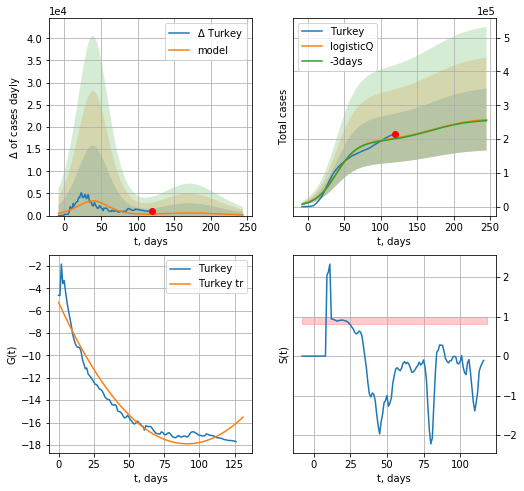

Turkey data at: 2020-07-15
+3 day model MAPE: 0.012484
model: logisticQ
coeffs: [ 1.93931985e+05  1.13010551e-07  3.93212683e+01 -6.04172590e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.355212
forecast at the end of period: +126 days
	 deltaDaycases: 163
	 total cases: 257543 ± 91482
	 total death: 6463 ± 6887
trend coefficient of determination: 0.944081
 intercept_: -5.255051019251448
 coeffs_: [ 0.         -0.27696784  0.00151647]


In [185]:
x = forecastRRR('Turkey',dfTR[:],d1,18*7,1.,addpred=True,xcoef=koreaCoeffs)

#xx=forecast2R('Turkey',dfTR[:],d1,14*7-dT,x,1.)

In [186]:
dfTT[dfTT.Country=='%s'%("Latvia")][0].values[0]

0.02631578947368421

In [187]:
#trend3(dfPL[1:],dfIS[7:],dfSW,'PL','IS','SW',40,40,40)

PL
           date    cases  active   death
129 2020-07-11  37891.0    9172  1571.0
130 2020-07-12  38190.0    9099  1576.0
131 2020-07-13  38457.0    9113  1588.0
132 2020-07-14  38721.0    8635  1594.0
133 2020-07-15  38721.0    8635  1594.0


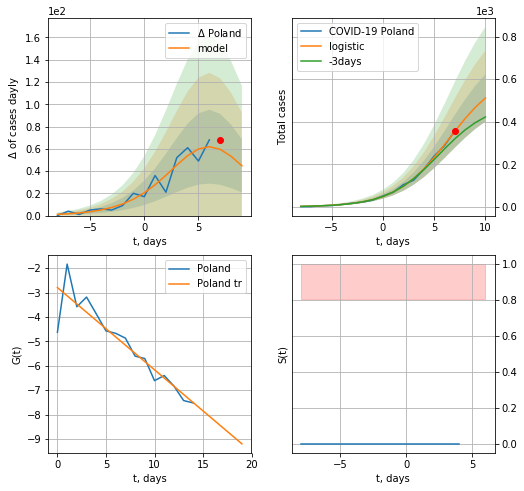

Poland data at: 2020-07-15
+3 day model MAPE: 0.14646234511665837
model: logistic
coeffs:  [6.41107567e+02 3.87606719e-01 6.46563498e+00]
rational stdev:  0.21770687952847212
forecast at the end of period: +3 days
	 deltaDaycases:  44
	 total cases:  511 ± 111
	 total death:  21 ± 13
trend coefficient of determination: 0.843228
 intercept: -2.795749
 slope: -0.337043
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


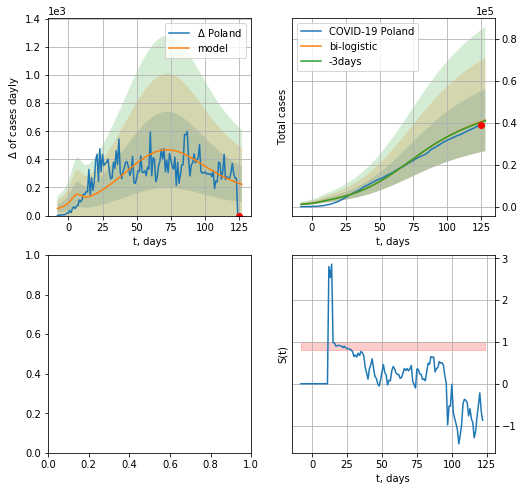

In [188]:
vL=16
vL1=38
try:
    dfPL = read_df(pd.DataFrame(),"PL")
    x =  forecast('Poland',dfPL[:vL],d1,7*16-dT,1.)
    xx = forecast2('Poland',dfPL[:],d1,16*7-dT,x,1.,vL=vL,addpred=True,xcoef=[0.25,1.,2.])
    #xx = np.concatenate((x, xx), axis=0)
    #xxx = forecast3("Poland",dfPL,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.5,1.,1.3],vL=[vL,vL1])
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


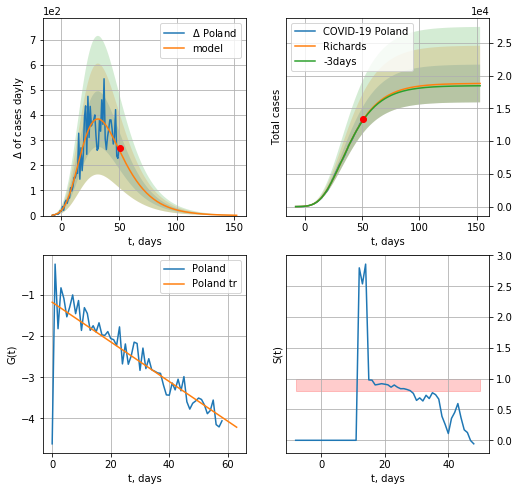

Poland data at: 2020-07-14
+3 day model MAPE: 0.005819
model: Richards
coeffs: [ 1.88418055e+04  3.45583442e+00 -4.15713344e+01  1.61921023e-02]
rational stdev: 0.153201
forecast at the end of period: +102 days
	 deltaDaycases: 1
	 total cases: 18820 ± 2883
	 total death: 777 ± 357
trend coefficient of determination: 0.708781
 intercept: -1.177313
 slope: -0.048172


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


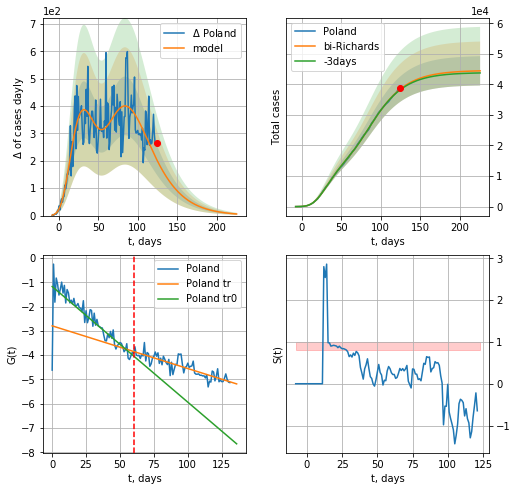

Poland data at: 2020-07-14
+3 day model MAPE: 0.005323
model: bi-Richards
coeffs: [ 2.57417816e+04  2.81172116e+00 -2.48418055e+01  1.33943840e-02]
rational stdev: 0.107871
forecast at the end of period: +102 days
	 deltaDaycases: 5
	 total cases: 44431 ± 4792
	 total death: 1834 ± 593
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.713710
 intercept: -1.170702
 slope: -0.047653
trend coefficient of determination: 0.739353
 intercept: -2.790836
 slope: -0.017590


In [411]:
vL = 60
x =  forecastRR('Poland',dfPL[:vL],d1,30*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx =  forecast2RR('Poland',dfPL[:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#xx = forecast2R('Poland',dfPL[:],d1,8*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


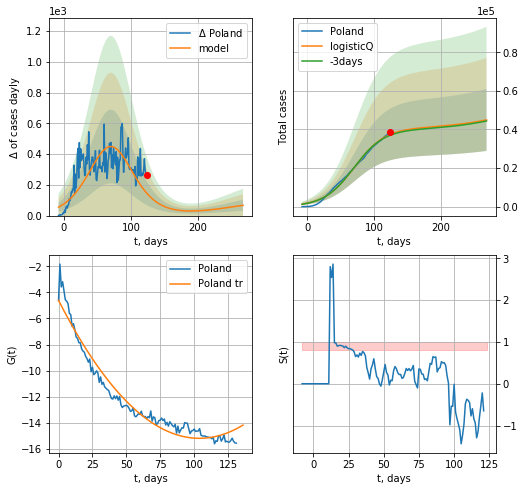

Poland data at: 2020-07-14
+3 day model MAPE: 0.010986
model: logisticQ
coeffs: [ 4.06474483e+04  2.21695286e-07  7.02917708e+01 -1.98618843e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.357749
forecast at the end of period: +144 days
	 deltaDaycases: 66
	 total cases: 44950 ± 16081
	 total death: 1856 ± 1991
trend coefficient of determination: 0.953911
 intercept_: -4.613062993005854
 coeffs_: [ 0.         -0.20352669  0.00098007]


In [412]:
x =  forecastRRR('Poland',dfPL[:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

IS
           date    cases  active  death
140 2020-07-11  38213.0   18940  358.0
141 2020-07-12  38670.0   19300  362.0
142 2020-07-13  40632.0   20872  365.0
143 2020-07-14  42360.0   22324  371.0
144 2020-07-15  44188.0   23823  376.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


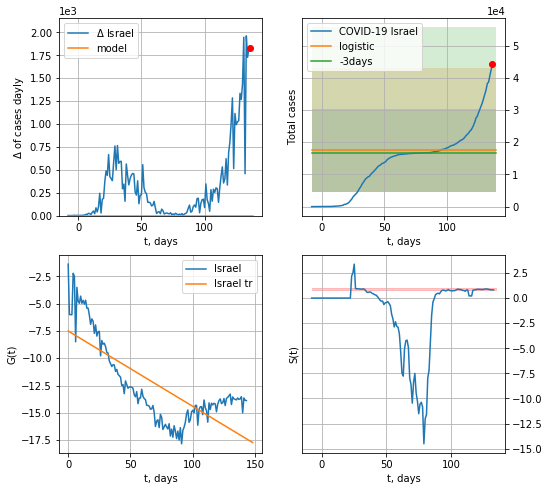

Israel data at: 2020-07-15
+3 day model MAPE: 0.044926970573620405
model: logistic
coeffs:  [ 1.39676350e+04 -5.96352865e+00  1.61090768e+02]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.7318689711634545
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  17459 ± 12778
	 total death:  148 ± 324
trend coefficient of determination: 0.574077
 intercept: -7.511030
 slope: -0.069008


In [189]:
dfIS = read_df(pd.DataFrame(),"IS")
try:
    x = forecast('Israel',dfIS[:],d1,16*7-dT,addpred=True,xcoef=[0.25,1.,1.8])
except:
    print ("Exception occurs")
#xx = forecast2('Israel',dfIS[:],d1,20-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


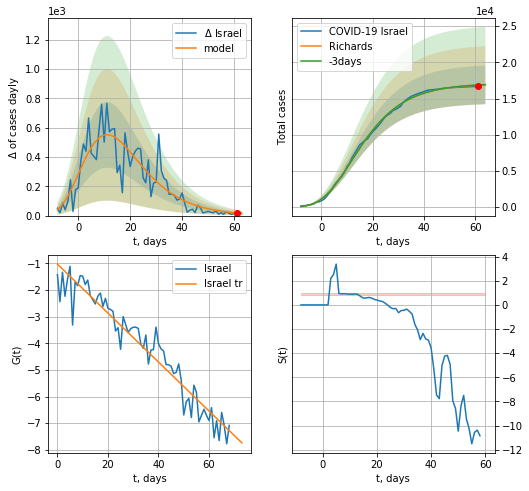

Israel data at: 2020-07-15
+3 day model MAPE: 0.001944
model: Richards
coeffs: [ 1.70515699e+04  6.43111297e+00 -3.67763089e+01  1.37701544e-02]
rational stdev: 0.158199
forecast at the end of period: +3 days
	 deltaDaycases: 15
	 total cases: 16887 ± 2671
	 total death: 143 ± 67
trend coefficient of determination: 0.925544
 intercept: -1.027514
 slope: -0.091953


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


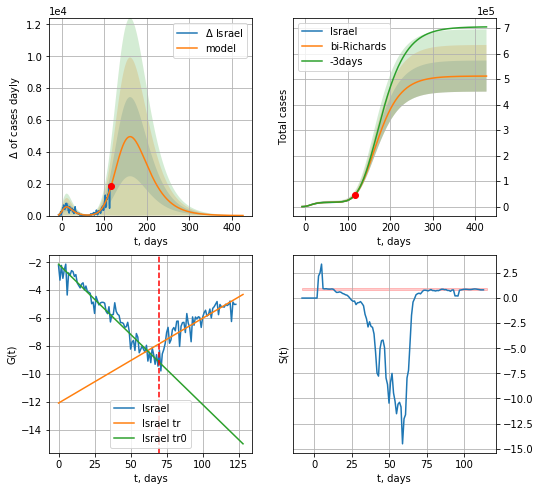

Israel data at: 2020-07-15
+3 day model MAPE: 0.005499
model: bi-Richards
coeffs: [4.94784670e+05 1.72793627e-01 1.00969175e+02 1.70800011e-01]
rational stdev: 0.119164
forecast at the end of period: +311 days
	 deltaDaycases: 5
	 total cases: 511644 ± 60969
	 total death: 4353 ± 1556
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.947550
 intercept: -2.139190
 slope: -0.100400
trend coefficient of determination: 0.730872
 intercept: -12.074062
 slope: 0.060702


In [190]:
x = forecastRR('Israel',dfIS[20:90],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Israel',dfIS[20:],d1,60*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=90-20)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


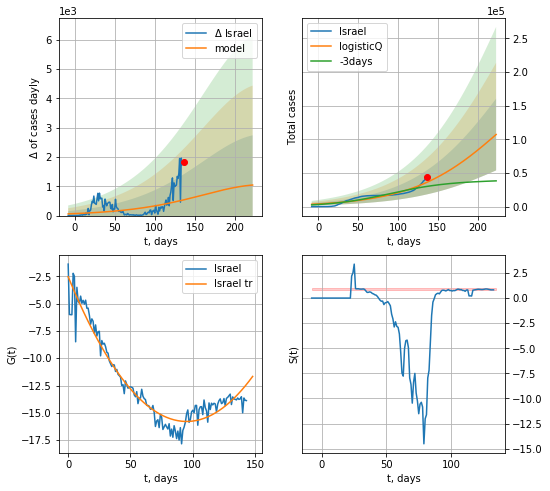

Israel data at: 2020-07-15
+3 day model MAPE: 0.209456
model: logisticQ
coeffs: [ 2.41795024e+05  4.41167668e-07  2.36118626e+02 -3.93999580e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.497465
forecast at the end of period: +87 days
	 deltaDaycases: 1042
	 total cases: 107169 ± 53313
	 total death: 911 ± 1359
trend coefficient of determination: 0.933318
 intercept_: -2.5420777711131723
 coeffs_: [ 0.         -0.27896615  0.00146825]


In [191]:
x = forecastRRR('Israel',dfIS[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


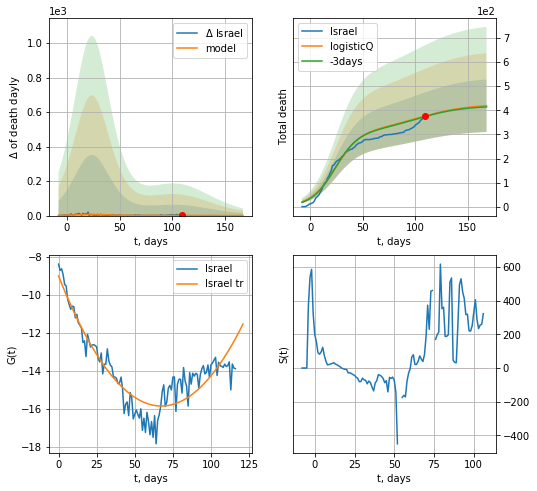

Israel data at: 2020-07-15
+3 day model MAPE: 0.005906
model: logisticQ
coeffs: [ 3.14584318e+02  1.61903210e-07  2.38314411e+01 -5.27728319e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.259525
forecast at the end of period: +59 days
	 total death: 419 ± 108
trend coefficient of determination: 0.839700
 intercept_: -9.006668016996475
 coeffs_: [ 0.         -0.2029352   0.00150429]


In [192]:
x = forecastRRR('Israel',dfIS[27:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


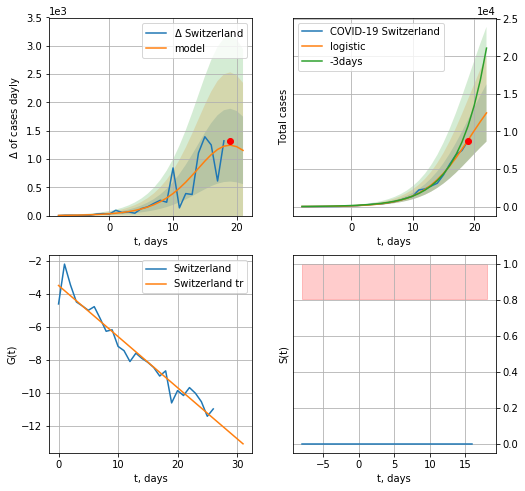

Switzerland data at: 2020-07-15
+3 day model MAPE: 0.24949892382467553
model: logistic
coeffs:  [1.87061213e+04 2.66466230e-01 1.93986309e+01]
rational stdev:  0.30604789910568747
forecast at the end of period: +3 days
	 deltaDaycases:  1152
	 total cases:  12470 ± 3816
	 total death:  740 ± 679
trend coefficient of determination: 0.944448
 intercept: -3.508672
 slope: -0.309041


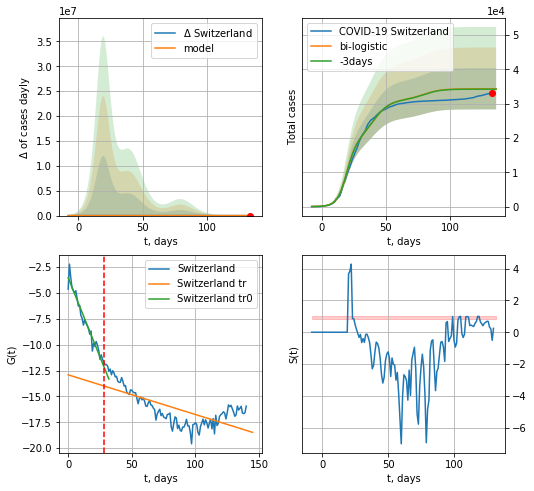

Switzerland data at: 2020-07-15
+3 day model MAPE: 0.003299300810454114
model: bi-logistic
coeffs:  [1.24916889e+04 1.50167321e-01 3.99536541e+01] [1.87061213e+04 2.66466230e-01 1.93986309e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.17495794391061276
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  34320 ± 6004
	 total death:  2037 ± 1069
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.947988
 intercept: -3.537068
 slope: -0.305765
trend coefficient of determination: 0.501484
 intercept: -12.910907
 slope: -0.038335


In [193]:
vL= 28
x = forecast('Switzerland',dfSZ[:vL],d1,7*16-dT)
xx = forecast2('Switzerland',dfSZ[:],d1,7*16-dT,x,vL=vL,addpred=True,xcoef=[0.25,1.,2.])#,addpred=False,xcoef=[0.25,1.,2.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


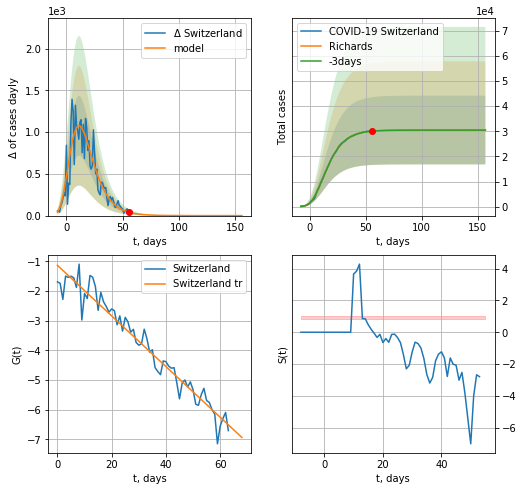

Switzerland data at: 2020-07-15
+3 day model MAPE: 0.001199
model: Richards
coeffs: [ 3.05183583e+04  5.78520635e+00 -3.06704693e+01  1.67154660e-02]
rational stdev: 0.448149
forecast at the end of period: +101 days
	 deltaDaycases: 0
	 total cases: 30518 ± 13676
	 total death: 1811 ± 2434
trend coefficient of determination: 0.947808
 intercept: -1.137067
 slope: -0.085275


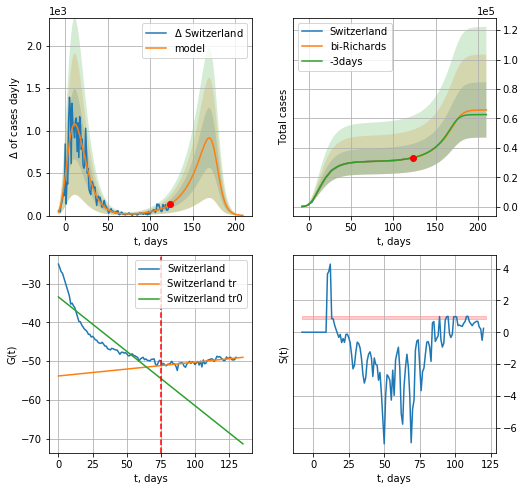

Switzerland data at: 2020-07-15
+3 day model MAPE: 0.001101
model: bi-Richards
coeffs: [3.52254837e+04 4.77046314e-02 1.77003796e+02 4.17619618e+00]
rational stdev: 0.286141
forecast at the end of period: +87 days
	 deltaDaycases: 2
	 total cases: 65732 ± 18808
	 total death: 3902 ± 3349
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.798042
 intercept: -33.429684
 slope: -0.280791
trend coefficient of determination: 0.533889
 intercept: -53.824903
 slope: 0.035660


In [203]:
iL = 10
vL = 75 + iL
x = forecastRR('Switzerland',dfSZ[iL:vL-iL],d1,7*30-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Switzerland',dfSZ[iL:],d1,7*28-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#xx = forecastR('Switzerland',dfSZ[:],d1,7*5-dT,x,vL=15)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


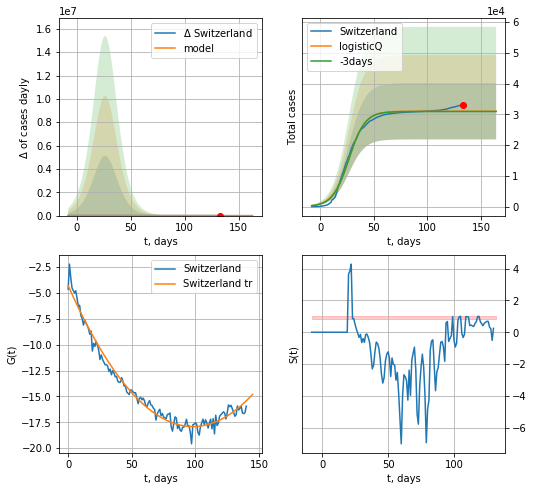

Switzerland data at: 2020-07-15
+3 day model MAPE: 0.002686
model: logisticQ
coeffs: [ 3.10072916e+04  4.69406358e-07  2.67268636e+01 -2.82685571e+05]
rational stdev: 0.294865
forecast at the end of period: +31 days
	 deltaDaycases: 0
	 total cases: 31007 ± 9142
	 total death: 1840 ± 1627
trend coefficient of determination: 0.978443
 intercept_: -4.298384395441621
 coeffs_: [ 0.         -0.2775579   0.00141499]


In [204]:
x = forecastRRR('Switzerland',dfSZ[:],d1,7*20-dT,addpred=False,xcoef=koreaCoeffs)

In [205]:
#trend3(dfUR[5:],dfIN[7:],dfRS[5:],'UR','IN','RS',40,40,40)

Ukr
           date    cases  active   death
123 2020-07-11  53521.0   26020  1383.0
124 2020-07-12  54133.0   26503  1398.0
125 2020-07-13  54771.0   26205  1412.0
126 2020-07-14  55607.0   26049  1427.0
127 2020-07-15  55607.0   26049  1427.0
Exaption occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


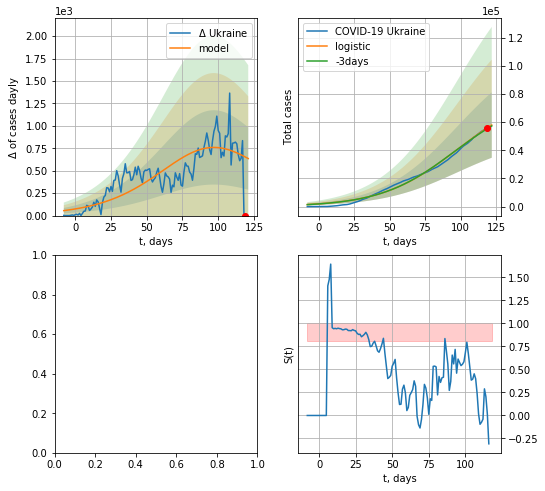

In [206]:
dfUR = read_df(pd.DataFrame(),"Ukr")
try:
    x=forecast('Ukraine',dfUR[:],d1,16*7-dT,addpred=True,xcoef=[0.25,1.,2.])
except:
      print("Exaption occurs") 

#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: invalid value encountered in true_divide


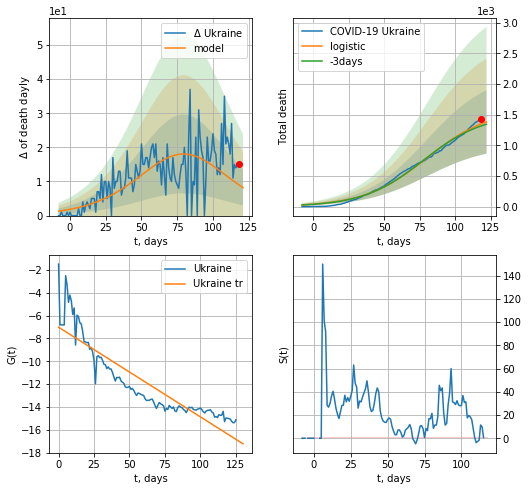

Ukraine data at: 2020-07-14
+3 day model MAPE: 0.02535933195237149
model: logistic
coeffs:  [1.58417234e+03 4.56095054e-02 7.98914196e+01]
rational stdev:  0.37437488471161773
forecast at the end of period: +4 days
	 total death:  1381 ± 517
trend coefficient of determination: 0.803863
 intercept: -7.022397
 slope: -0.078482


In [199]:
x=forecast('Ukraine',dfUR[:],d1,16*7-dT,addpred=False,xcoef=[0.25,1.,2.],cases='death')
#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


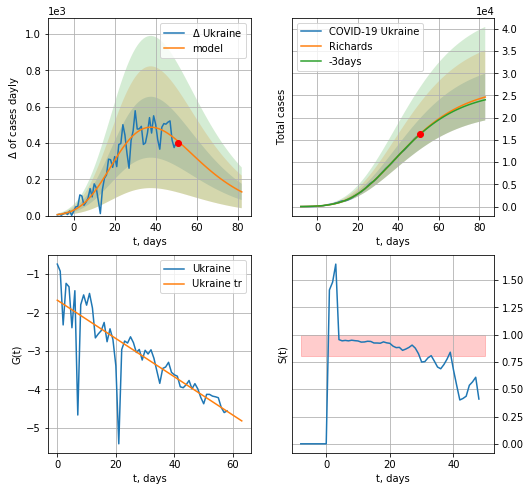

Ukraine data at: 2020-07-14
+3 day model MAPE: 0.005756
model: Richards
coeffs: [ 2.73152280e+04  5.78390520e-01 -1.00505543e+01  8.74755420e-02]
rational stdev: 0.213278
forecast at the end of period: +32 days
	 deltaDaycases: 130
	 total cases: 24649 ± 5257
	 total death: 632 ± 404
trend coefficient of determination: 0.678475
 intercept: -1.678868
 slope: -0.049847


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


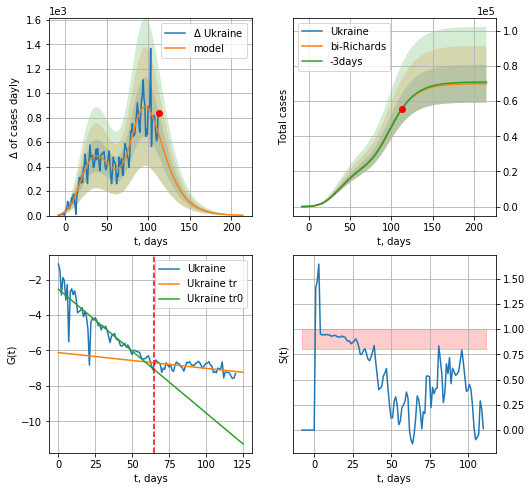

Ukraine data at: 2020-07-14
+3 day model MAPE: 0.001974
model: bi-Richards
coeffs: [4.26184605e+04 2.10882576e-01 7.72431758e+01 2.84364622e-01]
rational stdev: 0.153893
forecast at the end of period: +102 days
	 deltaDaycases: 2
	 total cases: 69891 ± 10755
	 total death: 1793 ± 827
bi-Richards approximation splitting point: 65
trend coefficient of determination: 0.825385
 intercept: -2.546017
 slope: -0.069808
trend coefficient of determination: 0.294712
 intercept: -6.120517
 slope: -0.008894


In [200]:
vL = 65+5
x=forecastRR('Ukraine',dfUR[5:vL-5],d1,7*20-dT,addpred=False,xcoef=RkoreaCoeffs)
xx=forecast2RR('Ukraine',dfUR[5:],d1,7*30-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


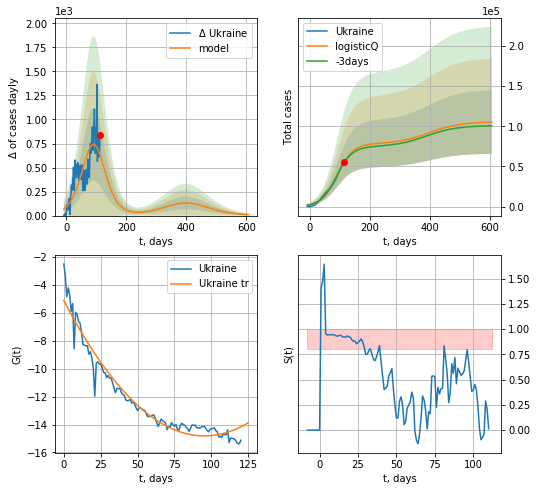

Ukraine data at: 2020-07-14
+3 day model MAPE: 0.014435
model: logisticQ
coeffs: [ 7.80785109e+04  3.07430324e-07  9.13727066e+01 -1.23251841e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.375724
forecast at the end of period: +494 days
	 deltaDaycases: 9
	 total cases: 105224 ± 39535
	 total death: 2700 ± 3043
trend coefficient of determination: 0.949852
 intercept_: -5.11639330581919
 coeffs_: [ 0.         -0.20362344  0.00106872]


In [201]:
x=forecastRRR('Ukraine',dfUR[5:],d1,7*86-dT,addpred=True,xcoef=koreaCoeffs)

In [202]:
#np.log(np.diff(dfIS["cases"].values)[:]/dfIS["cases"].values[1:]**2)

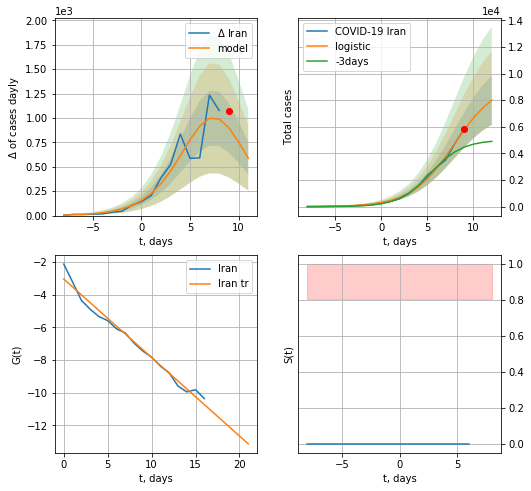

Iran data at: 2020-07-15
+3 day model MAPE: 0.41768987892528675
model: logistic
coeffs:  [9.38566037e+03 4.29600563e-01 7.92981697e+00]
rational stdev:  0.2297342175744371
forecast at the end of period: +3 days
	 deltaDaycases:  589
	 total cases:  7994 ± 1836
	 total death:  405 ± 279
trend coefficient of determination: 0.980602
 intercept: -3.037586
 slope: -0.480406


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:189: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


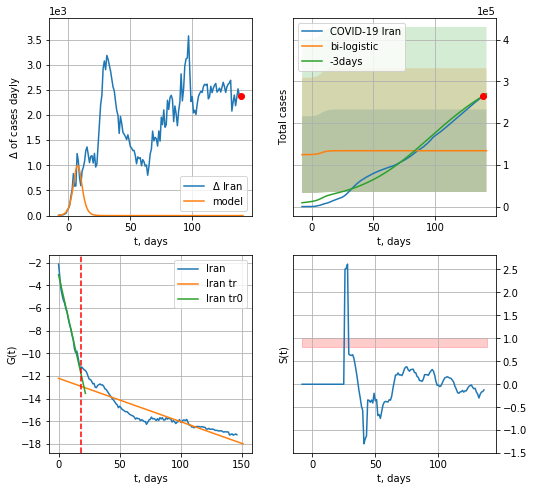

Iran data at: 2020-07-15
+3 day model MAPE: 0.4977191771129125
model: bi-logistic
coeffs:  [ 9.96074500e+04 -2.07308222e+01  1.51064953e+02] [9.38566037e+03 4.29600563e-01 7.92981697e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.7384313555961917
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  133894 ± 98872
	 total death:  6786 ± 15032
bi-logistic approximation splitting point: 18
trend0 coefficient of determination: 0.982944
 intercept: -3.059655
 slope: -0.476268
trend coefficient of determination: 0.819668
 intercept: -12.207571
 slope: -0.038308


In [207]:
x = forecast('Iran',dfIN[:18],d1,7*16-dT)
xx = forecast2('Iran',dfIN[:],d1,16*7-dT,x,vL=18,addpred=True,xcoef=[0.25,1.,2.0])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


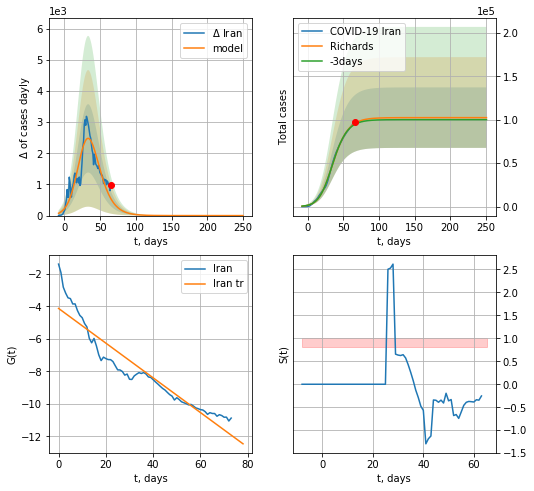

Iran data at: 2020-07-15
+3 day model MAPE: 0.012009
model: Richards
coeffs: [1.02478153e+05 1.52216321e-01 2.65523922e+01 5.45962709e-01]
rational stdev: 0.339941
forecast at the end of period: +185 days
	 deltaDaycases: 0
	 total cases: 102478 ± 34836
	 total death: 5194 ± 5296
trend coefficient of determination: 0.893485
 intercept: -4.118017
 slope: -0.106957


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


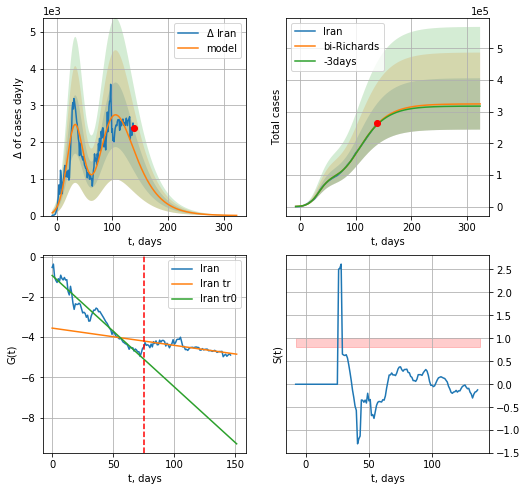

Iran data at: 2020-07-15
+3 day model MAPE: 0.006571
model: bi-Richards
coeffs: [ 2.22061649e+05  2.29191600e+00 -1.89963776e+01  1.46566436e-02]
rational stdev: 0.250075
forecast at the end of period: +185 days
	 deltaDaycases: 5
	 total cases: 324389 ± 81121
	 total death: 16442 ± 12335
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.949242
 intercept: -0.934105
 slope: -0.055440
trend coefficient of determination: 0.623020
 intercept: -3.550682
 slope: -0.008581


In [208]:
vL = 75
x = forecastRR('Iran',dfIN[:vL],d1,42*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Iran',dfIN[:],d1,42*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


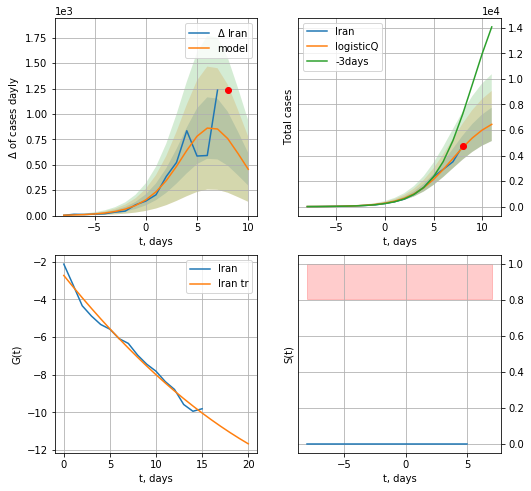

Iran data at: 2020-07-15
+3 day model MAPE: 0.437963
model: logisticQ
coeffs: [ 7.36885538e+03  7.42900276e-05 -6.37012173e+03  6.90117085e+00]
rational stdev: 0.203007
forecast at the end of period: +3 days
	 deltaDaycases: 455
	 total cases: 6445 ± 1308
	 total death: 326 ± 198
trend coefficient of determination: 0.985826
 intercept_: -2.7244557798652984
 coeffs_: [ 0.         -0.60810956  0.00802289]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


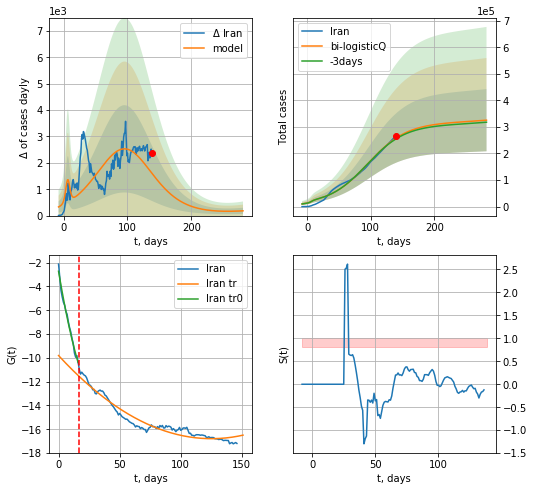

Iran data at: 2020-07-15
+3 day model MAPE: 0.011286
model: bi-logisticQ
coeffs: [ 3.08069443e+05  1.67424691e-07  9.55775060e+01 -1.95531784e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.359664
forecast at the end of period: +143 days
	 deltaDaycases: 180
	 total cases: 325476 ± 117062
	 total death: 16497 ± 17800
bi-logisticQ approximation splitting point: 17
trend coefficient of determination: 0.987745
 intercept_: -2.720144864989817
 coeffs_: [ 0.         -0.61067547  0.00823538]
trend coefficient of determination: 0.940515
 intercept_: -9.804457420119695
 coeffs_: [ 0.         -0.11167127  0.000446  ]


In [209]:
x = forecastRRR('Iran',dfIN[:17],d1,16*7-dT,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Iran',dfIN[:],d1,36*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=17)

RS
           date     cases  active    death
133 2020-07-11  720547.0  211896  11205.0
134 2020-07-12  727162.0  214766  11335.0
135 2020-07-13  733699.0  218239  11439.0
136 2020-07-14  739947.0  215508  11614.0
137 2020-07-15  746369.0  211350  11770.0


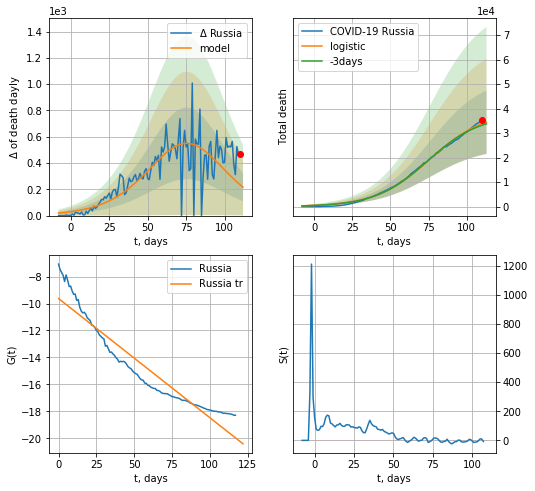

Russia data at: 2020-07-15
+3 day model MAPE: 0.018572137092091334
model: logistic
coeffs:  [3.86504525e+04 5.68431523e-02 7.58020433e+01]
rational stdev:  0.3759485953998462
forecast at the end of period: +3 days
	 total death:  34487 ± 12965
trend coefficient of determination: 0.901925
 intercept: -9.629492
 slope: -0.088298


In [210]:
try:
    dfRS = read_df(pd.DataFrame(),"RS")
    x = forecast('Russia',dfRS[19:],d1,16*7-dT,shift=3.,cases='death')
    #xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14)#,addpred=True,xcoef=[0.5,1.,3.5]
except:
    print ("Exeption occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


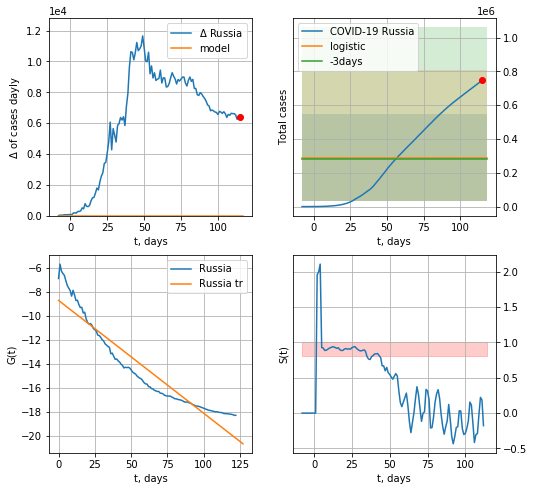

Russia data at: 2020-07-15
+3 day model MAPE: 0.03988163837515363
model: logistic
coeffs:  [ 2.90554927e+05 -8.08495561e+00  2.07630574e+02]
rational stdev:  0.8865580934067999
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  290554 ± 257593
	 total death:  4581 ± 12183
trend coefficient of determination: 0.898785
 intercept: -8.724253
 slope: -0.093928


In [211]:
x = forecast('Russia',dfRS[14:],d1,16*7-dT,shift=1.)
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14,shift=1.)#,addpred=True,xcoef=[0.5,1.,3.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


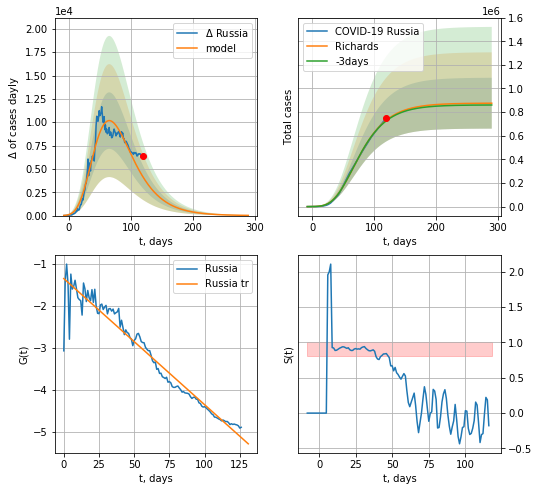

Russia data at: 2020-07-15
+3 day model MAPE: 0.007319
model: Richards
coeffs: [ 8.76116887e+05  3.06033858e+00 -7.83305709e+01  1.03682770e-02]
rational stdev: 0.245961
forecast at the end of period: +171 days
	 deltaDaycases: 22
	 total cases: 875407 ± 215316
	 total death: 13804 ± 10185
trend coefficient of determination: 0.948048
 intercept: -1.357330
 slope: -0.030009


In [213]:
x = forecastRR('Russia',dfRS[10:],d1,40*7-dT,addpred=False,xcoef=RkoreaCoeffs)#,addpred=True,xcoef=[0.25,1.,1.5,1]
#x = forecastQR('Russia',dfRS[20:],d1,30*7-dT)#,addpred=True,xcoef=[0.25,1.,1.5,1]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


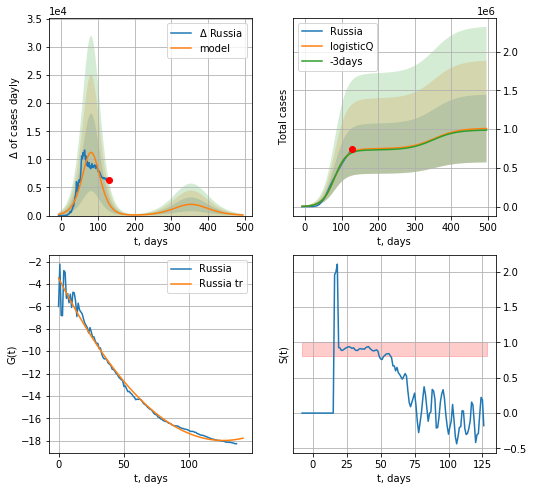

Russia data at: 2020-07-15
+3 day model MAPE: 0.015525
model: logisticQ
coeffs: [ 7.46134362e+05  2.99235807e-07  8.11466960e+01 -2.01492767e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.433750
forecast at the end of period: +367 days
	 deltaDaycases: 105
	 total cases: 1006916 ± 436750
	 total death: 15878 ± 20661
trend coefficient of determination: 0.984388
 intercept_: -3.457857085126859
 coeffs_: [ 0.         -0.23083216  0.00091652]


In [214]:
x = forecastRRR('Russia',dfRS[:],d1,68*7-dT,addpred=True,xcoef=koreaCoeffs)

JP
           date    cases  active  death
171 2020-07-11  21129.0    2298  982.0
172 2020-07-12  21502.0    2517  982.0
173 2020-07-13  21868.0    2783  982.0
174 2020-07-14  22220.0    2956  982.0
175 2020-07-15  22508.0    2979  984.0


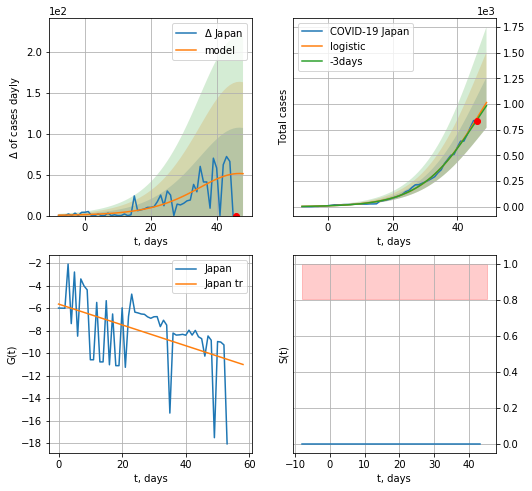

Japan data at: 2020-07-15
+3 day model MAPE: 0.0244139001087548
model: logistic
coeffs:  [1.86668601e+03 1.09971339e-01 4.74124632e+01]
rational stdev:  0.24188431663406776
forecast at the end of period: +3 days
	 deltaDaycases:  51
	 total cases:  1014 ± 245
	 total death:  44 ± 31
trend coefficient of determination: 0.226001
 intercept: -5.646499
 slope: -0.092589


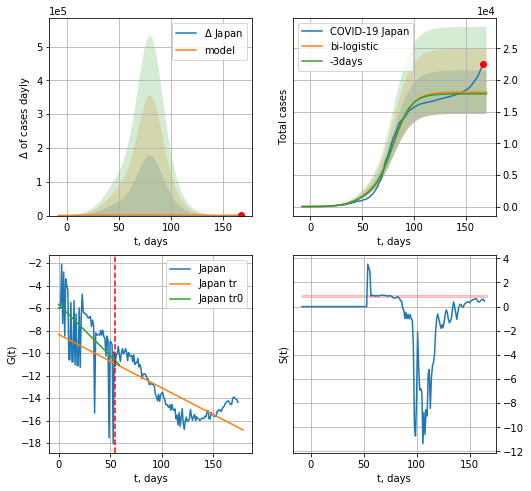

Japan data at: 2020-07-15
+3 day model MAPE: 0.015300620516162653
model: bi-logistic
coeffs:  [1.62114347e+04 1.10497415e-01 8.03615153e+01] [1.86668601e+03 1.09971339e-01 4.74124632e+01]
rational stdev:  0.18988694483805646
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  18077 ± 3432
	 total death:  790 ± 450
bi-logistic approximation splitting point: 55
trend0 coefficient of determination: 0.229818
 intercept: -5.672459
 slope: -0.091119
trend coefficient of determination: 0.622166
 intercept: -8.342911
 slope: -0.047467


In [215]:
dfJP = read_df(pd.DataFrame(),"JP")
try:
    x = forecast('Japan',dfJP[:55],d1,7*16-dT)
    xx = forecast2('Japan',dfJP[:],d1,16*7-dT,x,addpred=False,xcoef=[0.25,1.,1.25],vL=55)
except:
    print ("Exception occurs")

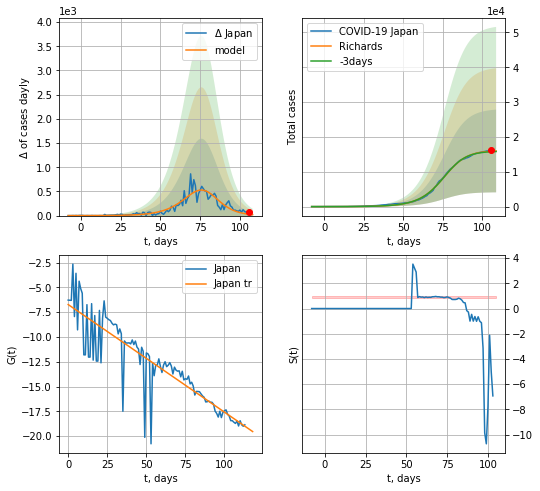

Japan data at: 2020-07-15
+3 day model MAPE: 0.009396
model: Richards
coeffs: [1.61043526e+04 1.05070375e-01 7.85362634e+01 1.40112813e+00]
rational stdev: 0.743333
forecast at the end of period: +3 days
	 deltaDaycases: 20
	 total cases: 15975 ± 11875
	 total death: 698 ± 1556
trend coefficient of determination: 0.778576
 intercept: -6.726919
 slope: -0.108522


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


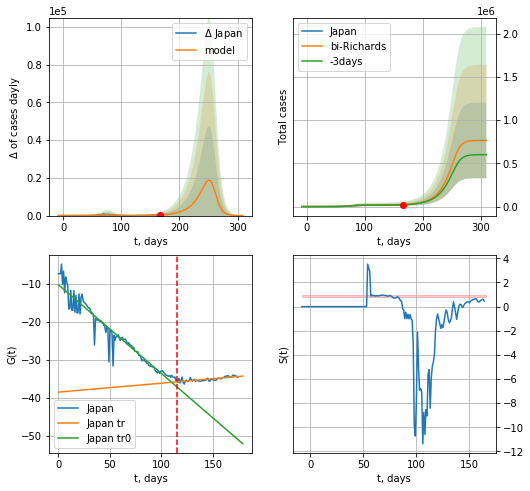

Japan data at: 2020-07-15
+3 day model MAPE: 0.014250
model: bi-Richards
coeffs: [7.48660782e+05 5.27790374e-02 2.58117949e+02 3.02496485e+00]
rational stdev: 0.571742
forecast at the end of period: +143 days
	 deltaDaycases: 10
	 total cases: 764702 ± 437212
	 total death: 33431 ± 57341
bi-Richards approximation splitting point: 115
trend coefficient of determination: 0.932011
 intercept: -10.311078
 slope: -0.233775
trend coefficient of determination: 0.551479
 intercept: -38.568942
 slope: 0.023576


In [216]:
vL = 115
x = forecastRR('Japan',dfJP[:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Japan',dfJP[:],d1,36*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


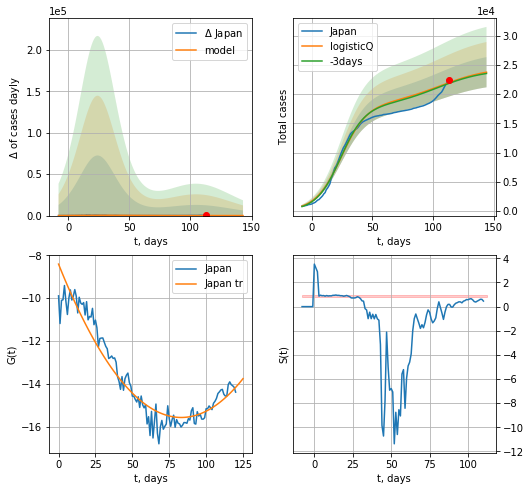

Japan data at: 2020-07-15
+3 day model MAPE: 0.006098
model: logisticQ
coeffs: [ 1.82114374e+04  1.86010495e-07  2.42631649e+01 -5.12041290e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.108831
forecast at the end of period: +31 days
	 deltaDaycases: 37
	 total cases: 23771 ± 2587
	 total death: 1039 ± 339
trend coefficient of determination: 0.917880
 intercept_: -8.412869059425777
 coeffs_: [ 0.         -0.17192345  0.00103371]


In [217]:
x = forecastRRR('Japan',dfJP[54:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

NL
           date    cases  active   death
135 2020-07-11  50921.0       0  6137.0
136 2020-07-12  51022.0       0  6137.0
137 2020-07-13  51093.0       0  6137.0
138 2020-07-14  51146.0       0  6135.0
139 2020-07-15  51252.0       0  6136.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


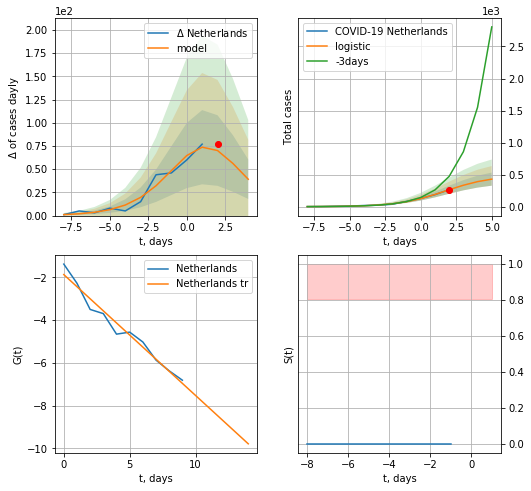

Netherlands data at: 2020-07-15
model: logistic
coeffs:  [487.74708253   0.61204074   1.72557629]
rational stdev:  0.23761280835096962
forecast at the end of period: +3 days
	 deltaDaycases:  39
	 total cases:  429 ± 102
	 total death:  51 ± 36
trend coefficient of determination: 0.966773
 intercept: -1.876651
 slope: -0.565279


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


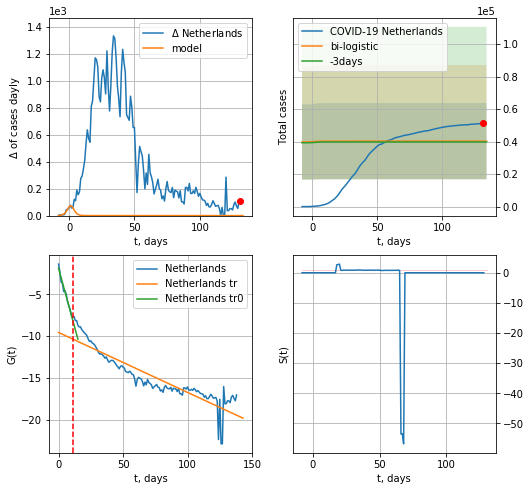

Netherlands data at: 2020-07-15
+3 day model MAPE: 0.012984904194278894
model: bi-logistic
coeffs:  [ 3.18205272e+04 -6.13945778e+00  1.77487838e+02] [487.74708253   0.61204074   1.72557629]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.5820393958718066
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  40263 ± 23434
	 total death:  4820 ± 8416
bi-logistic approximation splitting point: 11
trend0 coefficient of determination: 0.974821
 intercept: -1.878275
 slope: -0.564738
trend coefficient of determination: 0.821451
 intercept: -9.553346
 slope: -0.071604


In [218]:
vL=11
vL1=32
dfNL = read_df(pd.DataFrame(),"NL")
x = forecast('Netherlands',dfNL[:vL],d1,16*7-dT,pMAPE=False)
xx = forecast2('Netherlands',dfNL[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Philippines",dfPH,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: invalid value encountered in true_divide


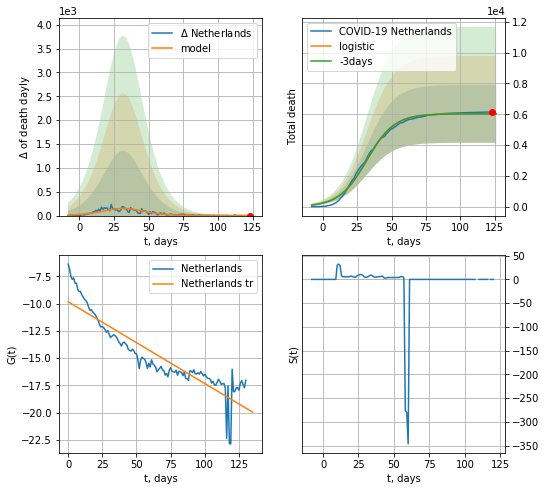

Netherlands data at: 2020-07-15
+3 day model MAPE: 0.001052576353354131
model: logistic
coeffs:  [6.03055871e+03 1.00527976e-01 3.20629566e+01]
rational stdev:  0.3119788954971581
forecast at the end of period: +3 days
	 total death:  6030 ± 1881
trend coefficient of determination: 0.824041
 intercept: -9.830961
 slope: -0.074985


In [219]:
x = forecast('Netherlands',dfNL[8:],d1,16*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


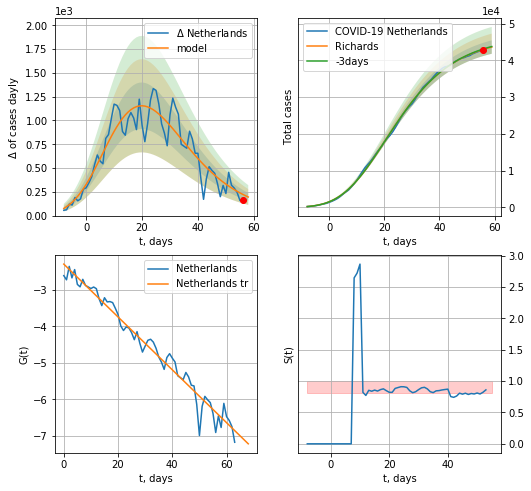

Netherlands data at: 2020-07-15
+3 day model MAPE: 0.002844
model: Richards
coeffs: [ 4.63265250e+04  4.86732663e-01 -5.76573628e+00  1.49500456e-01]
rational stdev: 0.041831
forecast at the end of period: +3 days
	 deltaDaycases: 195
	 total cases: 43637 ± 1825
	 total death: 5224 ± 655
trend coefficient of determination: 0.968459
 intercept: -2.292784
 slope: -0.072448


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


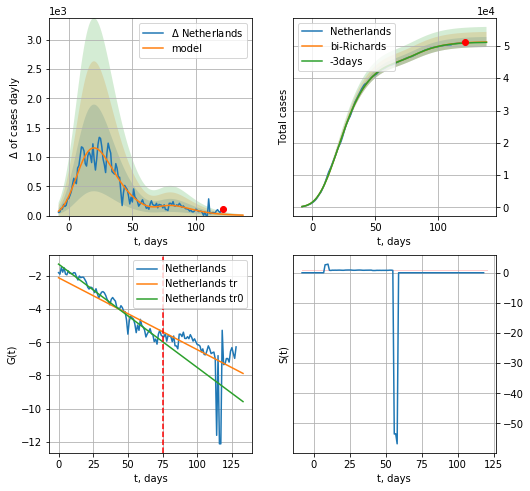

Netherlands data at: 2020-07-15
+3 day model MAPE: 0.001808
model: bi-Richards
coeffs: [4.98358516e+03 8.24391759e+00 2.11823871e+01 9.09214259e-03]
rational stdev: 0.030383
forecast at the end of period: +17 days
	 deltaDaycases: 7
	 total cases: 51215 ± 1556
	 total death: 6131 ± 558
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.960254
 intercept: -1.282334
 slope: -0.062398
trend coefficient of determination: 0.225218
 intercept: -2.104122
 slope: -0.043425


In [221]:
iL = 10
vL = 75 +iL
x = forecastRR('Netherlands',dfNL[iL:vL-iL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Netherlands',dfNL[iL:],d1,18*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [222]:
#x = forecastQR('Netherlands',dfNL[7:],d1,16*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


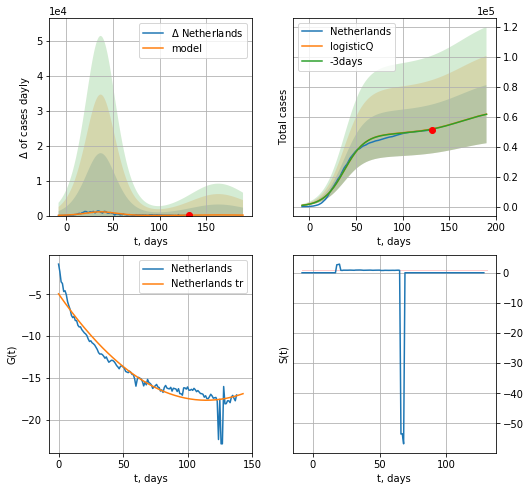

Netherlands data at: 2020-07-15
+3 day model MAPE: 0.002869
model: logisticQ
coeffs: [ 4.85057304e+04  2.12978389e-07  3.74093037e+01 -4.17650916e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.314494
forecast at the end of period: +59 days
	 deltaDaycases: 137
	 total cases: 61726 ± 19412
	 total death: 7390 ± 6972
trend coefficient of determination: 0.924224
 intercept_: -4.9419109628129085
 coeffs_: [ 0.         -0.22188716  0.00096851]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


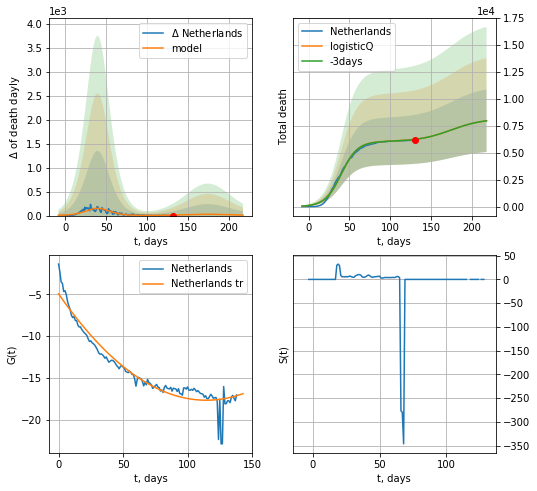

Netherlands data at: 2020-07-15
+3 day model MAPE: 0.000997
model: logisticQ
coeffs: [ 6.02946614e+03  3.42842203e-07  4.00622078e+01 -2.93834850e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.364287
forecast at the end of period: +87 days
	 total death: 7951 ± 2896
trend coefficient of determination: 0.924224
 intercept_: -4.9419109628129085
 coeffs_: [ 0.         -0.22188716  0.00096851]


In [223]:
x = forecastRRR('Netherlands',dfNL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Netherlands',dfNL[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

In [224]:
#trend3(dfAT[1:],dfSG[:],dfBG[:],'AT','SG','BG',40,35,35)

AT
           date    cases  active  death
136 2020-07-11  18897.0    1239  706.0
137 2020-07-12  18948.0    1240  708.0
138 2020-07-13  19021.0    1239  709.0
139 2020-07-14  19154.0    1269  710.0
140 2020-07-15  19154.0    1269  710.0
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:80: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


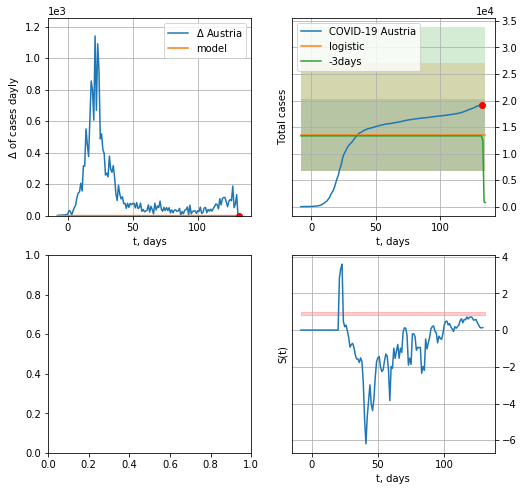

In [225]:
dfAT = read_df(pd.DataFrame(),"AT")
try:
    x = forecast('Austria',dfAT[:],d1,7*16-dT,addpred=True,xcoef=[0.25/4,1.,2.0])
except:
    print ("Exception occurs")
#xx = forecast2('Austria',dfAT[:],d1,7*7-dT,x,addpred=True,xcoef=[0.35*2,1.,1.5],vL=36)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


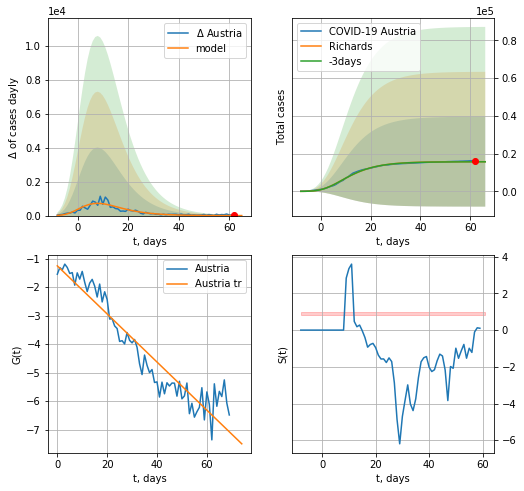

Austria data at: 2020-07-14
+3 day model MAPE: 0.004675
model: Richards
coeffs: [ 1.57373335e+04  1.43837183e+01 -2.95009845e+01  8.70431827e-03]
rational stdev: 1.513265
forecast at the end of period: +4 days
	 deltaDaycases: 1
	 total cases: 15725 ± 23797
	 total death: 586 ± 2660
trend coefficient of determination: 0.902787
 intercept: -1.255749
 slope: -0.084344


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


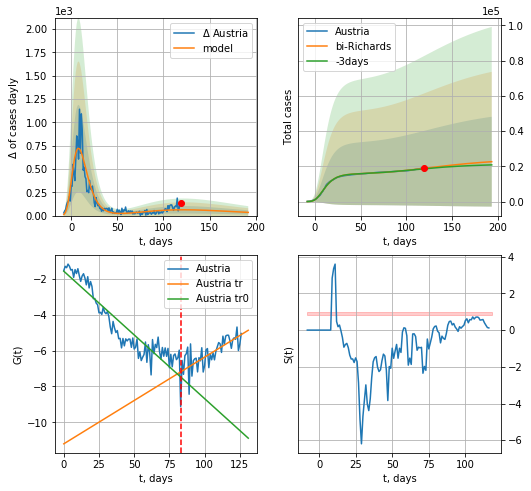

Austria data at: 2020-07-14
+3 day model MAPE: 0.012151
model: bi-Richards
coeffs: [ 8.95521346e+03  2.23232360e+00 -1.28686188e+02  8.51015753e-03]
rational stdev: 1.126830
forecast at the end of period: +74 days
	 deltaDaycases: 34
	 total cases: 22640 ± 25511
	 total death: 843 ± 2849
bi-Richards approximation splitting point: 83
trend coefficient of determination: 0.868012
 intercept: -1.588888
 slope: -0.070890
trend coefficient of determination: 0.502865
 intercept: -11.190360
 slope: 0.048211


In [408]:
vL=83+12
x = forecastRR('Austria',dfAT[12:vL-12],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Austria',dfAT[12:],d1,26*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)
#xx = forecast2R('Austria',dfAT[:],d1,8*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


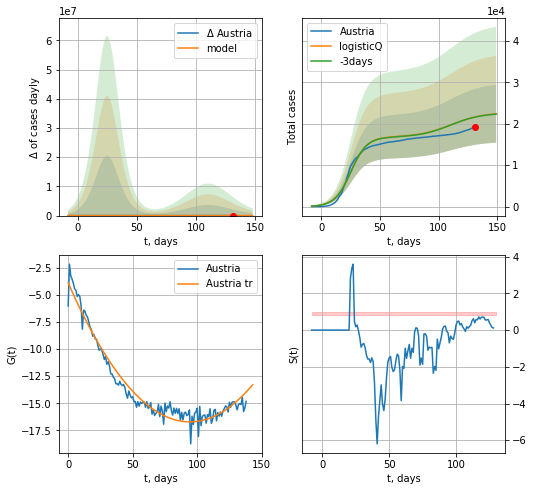

Austria data at: 2020-07-14
+3 day model MAPE: 0.002615
model: logisticQ
coeffs: [ 1.67969709e+04  2.37364537e-07  2.54108883e+01 -6.14629094e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.311698
forecast at the end of period: +18 days
	 deltaDaycases: 24
	 total cases: 22407 ± 6984
	 total death: 835 ± 780
trend coefficient of determination: 0.958778
 intercept_: -3.8605913602705915
 coeffs_: [ 0.         -0.27287781  0.00144689]


In [409]:
vL = 68
x = forecastRRR('Austria',dfAT[:],d1,18*7-dT,addpred=True,xcoef=koreaCoeffs)
#xx = forecast2RRR('Austria',dfAT[:],d1,18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=vL)

BG
           date    cases  active   death
132 2020-07-11  62606.0   35628  9782.0
133 2020-07-12  62707.0   35729  9782.0
134 2020-07-13  62781.0   35771  9787.0
135 2020-07-14  62872.0   35842  9788.0
136 2020-07-15  62872.0   35842  9788.0
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


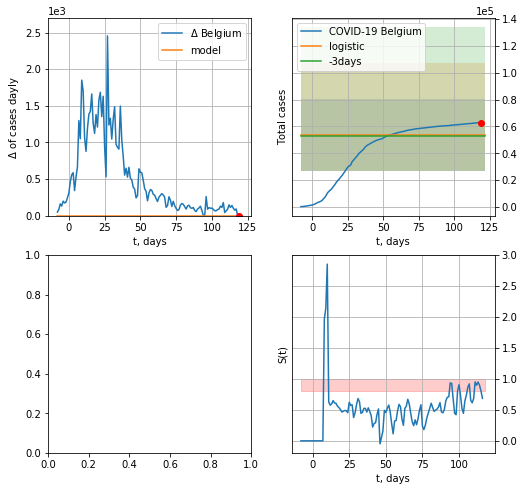

In [226]:
vL=9
try:
    dfBG = read_df(pd.DataFrame(),"BG")
    x = forecast('Belgium',dfBG[vL:],d1,16*7-dT,addpred=True,xcoef=[0.25,1.,3.])
    #xx = forecast2('Belgium',dfBG[vL:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
except:
    print("Exception occurs")

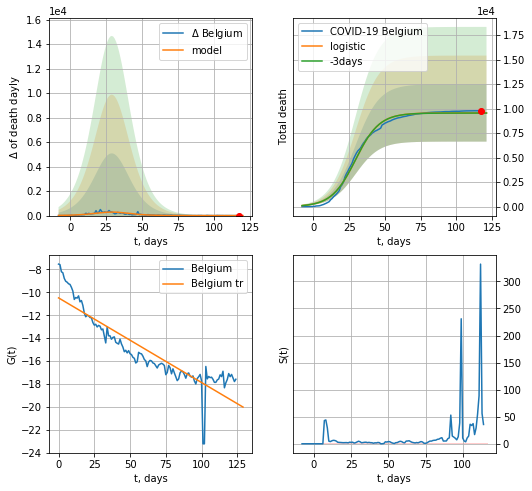

Belgium data at: 2020-07-14
+3 day model MAPE: 0.0013567028320275445
model: logistic
coeffs:  [9.56321483e+03 1.19569027e-01 2.93955781e+01]
rational stdev:  0.3060271515322862
forecast at the end of period: +4 days
	 total death:  9563 ± 2926
trend coefficient of determination: 0.810651
 intercept: -10.483516
 slope: -0.073910


In [426]:
#dfBG = read_df(pd.DataFrame(),"BG")
x = forecast('Belgium',dfBG[10:],d1,16*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


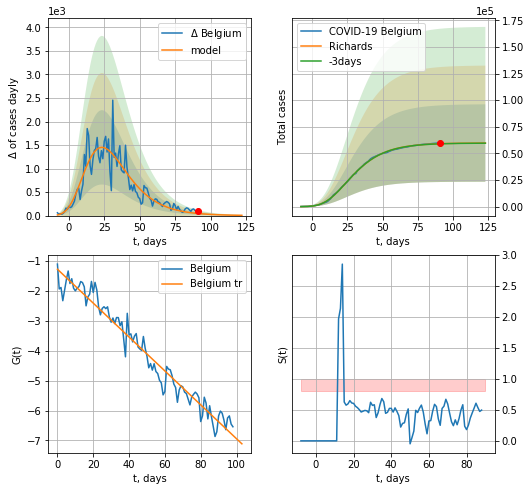

Belgium data at: 2020-07-14
+3 day model MAPE: 0.001911
model: Richards
coeffs: [ 5.97988756e+04  5.30501505e+00 -4.21421635e+01  1.25125163e-02]
rational stdev: 0.608961
forecast at the end of period: +32 days
	 deltaDaycases: 5
	 total cases: 59716 ± 36364
	 total death: 9309 ± 17006
trend coefficient of determination: 0.957612
 intercept: -1.270622
 slope: -0.056728


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


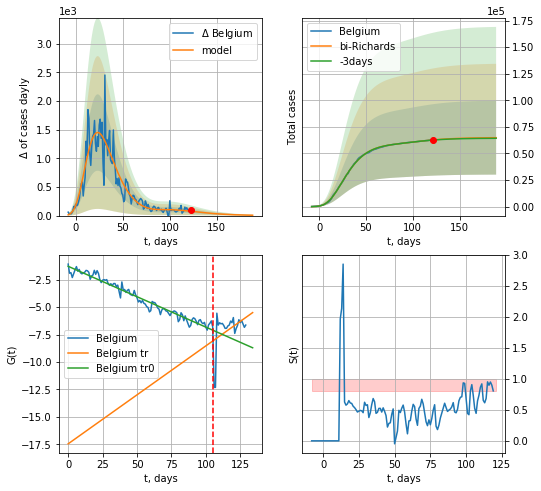

Belgium data at: 2020-07-14
+3 day model MAPE: 0.001934
model: bi-Richards
coeffs: [ 5.18992356e+03  5.13836060e+00 -1.46947810e+00  8.50626514e-03]
rational stdev: 0.535625
forecast at the end of period: +67 days
	 deltaDaycases: 6
	 total cases: 64841 ± 34730
	 total death: 10108 ± 16242
bi-Richards approximation splitting point: 105
trend coefficient of determination: 0.958277
 intercept: -1.279914
 slope: -0.055368
trend coefficient of determination: 0.161232
 intercept: -17.447727
 slope: 0.089191


In [427]:
iL = 5
vL = 105+ iL
x = forecastRR('Belgium',dfBG[iL:vL-iL],d1,20*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Belgium',dfBG[iL:],d1,25*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


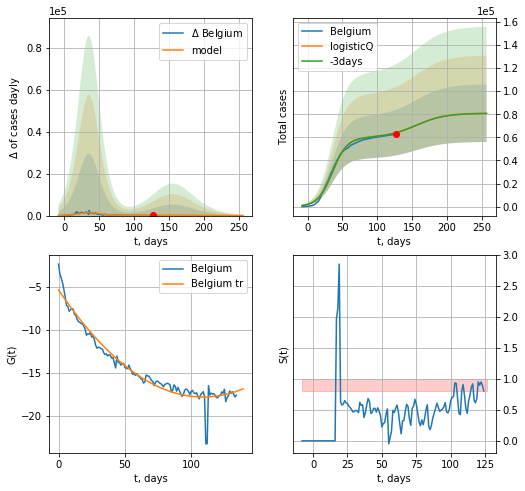

Belgium data at: 2020-07-14
+3 day model MAPE: 0.002446
model: logisticQ
coeffs: [ 5.98744310e+04  2.67296276e-07  3.57444078e+01 -3.55973355e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.308032
forecast at the end of period: +130 days
	 deltaDaycases: 8
	 total cases: 80914 ± 24924
	 total death: 12613 ± 11655
trend coefficient of determination: 0.944916
 intercept_: -5.366551441685894
 coeffs_: [ 0.         -0.22820438  0.00104749]


In [428]:
x = forecastRRR('Belgium',dfBG[:],d1,34*7-dT,addpred=True,xcoef=koreaCoeffs)

In [227]:
dfBZ.tail()

,date,cases,active,death
137,2020-07-11,1840812.0,555808,71492.0
138,2020-07-12,1866176.0,580513,72151.0
139,2020-07-13,1887959.0,601526,72921.0
140,2020-07-14,1931204.0,643430,74262.0
141,2020-07-15,1970909.0,528611,75523.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


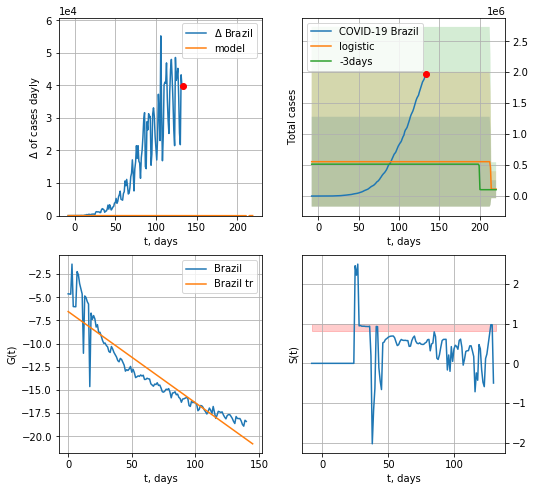

Brazil data at: 2020-07-15
+3 day model MAPE: 0.07782381818973245
model: logistic
coeffs:  [ 4.44145334e+05 -8.53983256e+00  2.13158618e+02]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  1.3066951029040752
forecast at the end of period: +87 days
	 deltaDaycases:  0
	 total cases:  111036 ± 145090
	 total death:  4254 ± 16676
trend coefficient of determination: 0.867256
 intercept: -6.540833
 slope: -0.098473


In [228]:
x = forecast('Brazil',dfBZ[:],d1,28*7-dT,addpred=True,xcoef=[0.25,1.,2.])
#xx = forecast2('Brazil',dfBZ[:],d1,4*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


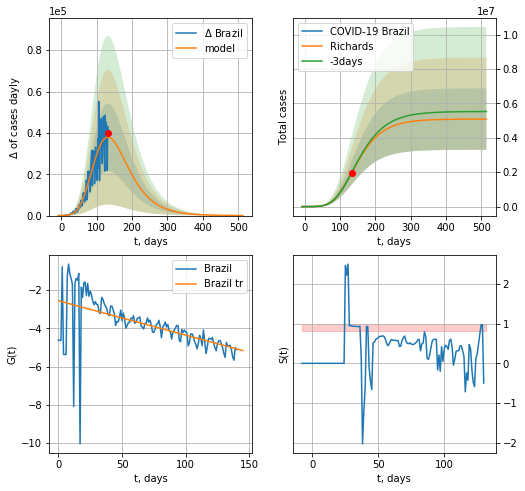

Brazil data at: 2020-07-15
+3 day model MAPE: 0.005413
model: Richards
coeffs: [5.08786839e+06 2.52974041e-01 1.46264474e+01 8.34922046e-02]
rational stdev: 0.351026
forecast at the end of period: +381 days
	 deltaDaycases: 34
	 total cases: 5086268 ± 1785412
	 total death: 194900 ± 205244
trend coefficient of determination: 0.324790
 intercept: -2.559681
 slope: -0.017975


In [229]:
x = forecastRR('Brazil',dfBZ[:],d1,70*7-dT,addpred=False,xcoef=RkoreaCoeffs)
#x = forecastQR('Brazil',dfBZ[10:],d1,50*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


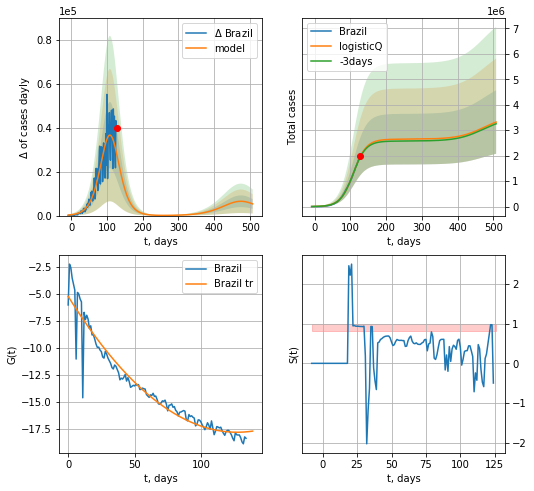

Brazil data at: 2020-07-15
+3 day model MAPE: 0.010195
model: logisticQ
coeffs: [ 2.64747990e+06  9.46144391e-07  1.08885896e+02 -5.84179694e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.375183
forecast at the end of period: +381 days
	 deltaDaycases: 5325
	 total cases: 3319760 ± 1245518
	 total death: 127209 ± 143179
trend coefficient of determination: 0.930265
 intercept_: -5.2261511689443125
 coeffs_: [ 0.         -0.19821433  0.0007787 ]


In [230]:
x = forecastRRR('Brazil',dfBZ[6:],d1,70*7-dT,addpred=True,xcoef=koreaCoeffs)

In [231]:
#x = forecastRRR('Brazil',dfBZ[5:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

AS
           date    cases  active  death
147 2020-07-11   9796.0    1961  108.0
148 2020-07-12   9980.0    2104  108.0
149 2020-07-13  10250.0    2307  108.0
150 2020-07-14  10487.0    2448  111.0
151 2020-07-15  10810.0    2662  113.0


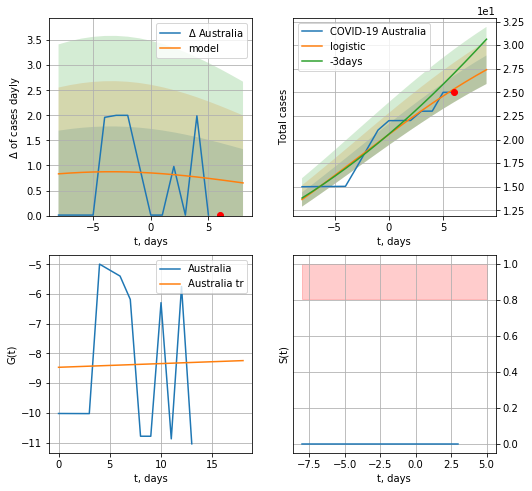

Australia data at: 2020-07-15
model: logistic
coeffs:  [35.98153551  0.09728993 -2.93367767]
rational stdev:  0.0551816162827012
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  27 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.000431
 intercept: -8.467221
 slope: 0.012491


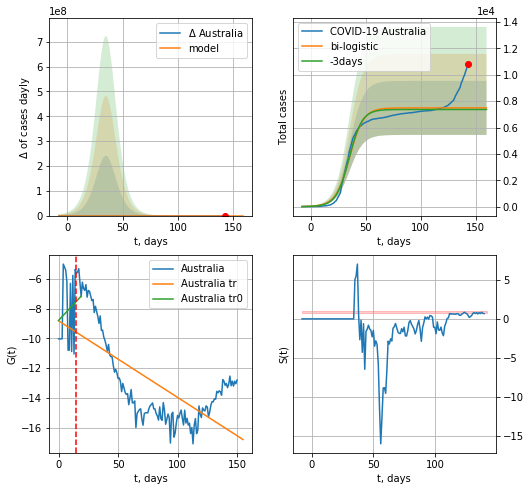

Australia data at: 2020-07-15
+3 day model MAPE: 0.016272205606466743
model: bi-logistic
coeffs:  [7.45072620e+03 1.59299824e-01 3.53254568e+01] [35.98153551  0.09728993 -2.93367767]
rational stdev:  0.27299311569632867
forecast at the end of period: +17 days
	 deltaDaycases:  0
	 total cases:  7486 ± 2043
	 total death:  78 ± 63
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.022779
 intercept: -8.785888
 slope: 0.086030
trend coefficient of determination: 0.462909
 intercept: -8.810613
 slope: -0.051543


In [232]:
dfAS = read_df(pd.DataFrame(),"AS")
try:
    x = forecast('Australia',dfAS[:15],d1,16*7-dT,pMAPE=False)
    xx = forecast2('Australia',dfAS[:],d1,18*7-dT,x,vL=15,addpred=False,xcoef=[0.25/4,1.,1.8])
except:
    print("Exception occurs")

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


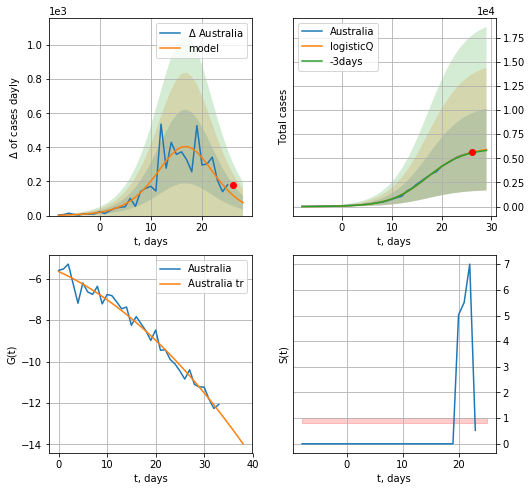

Australia data at: 2020-07-15
+3 day model MAPE: 0.012936
model: logisticQ
coeffs: [ 6.16825959e+03  4.63202537e-05  1.72354346e+01 -5.67168730e+03]
rational stdev: 0.716728
forecast at the end of period: +3 days
	 deltaDaycases: 75
	 total cases: 5904 ± 4231
	 total death: 61 ± 131
trend coefficient of determination: 0.975101
 intercept_: -5.657250296853678
 coeffs_: [ 0.         -0.10702975 -0.00294069]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


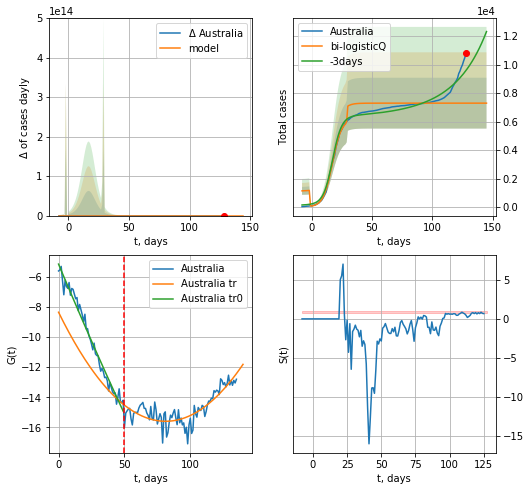

Australia data at: 2020-07-15
+3 day model MAPE: 0.248592
model: bi-logisticQ
coeffs: [ 1.12751553e+03  1.51679295e+00  2.90496179e+01 -1.07728145e+00]
rational stdev: 0.244664
forecast at the end of period: +17 days
	 deltaDaycases: 0
	 total cases: 7295 ± 1785
	 total death: 76 ± 55
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.978786
 intercept_: -5.1508340728883
 coeffs_: [ 0.00000000e+00 -2.09278795e-01  2.06303704e-04]
trend coefficient of determination: 0.691978
 intercept_: -8.34817723785044
 coeffs_: [ 0.         -0.17829331  0.00109691]


In [233]:
#axcoef = [koreaCoeffs[0],koreaCoeffs[1],koreaCoeffs[2],koreaCoeffs[3]]
vL = 50
x = forecastRRR('Australia',dfAS[15:vL],d1,16*7-dT,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Australia',dfAS[15:],d1,18*7-dT,x,addpred=False,xcoef=koreaCoeffs,vL=vL)

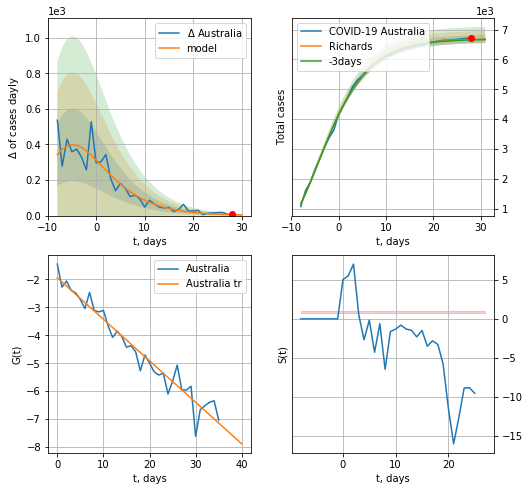

Australia data at: 2020-07-15
+3 day model MAPE: 0.002971
model: Richards
coeffs: [ 6.70454168e+03  3.46280410e+00 -2.27049762e+01  4.78418657e-02]
rational stdev: 0.020213
forecast at the end of period: +3 days
	 deltaDaycases: 3
	 total cases: 6685 ± 135
	 total death: 69 ± 4
trend coefficient of determination: 0.947498
 intercept: -1.939562
 slope: -0.148593


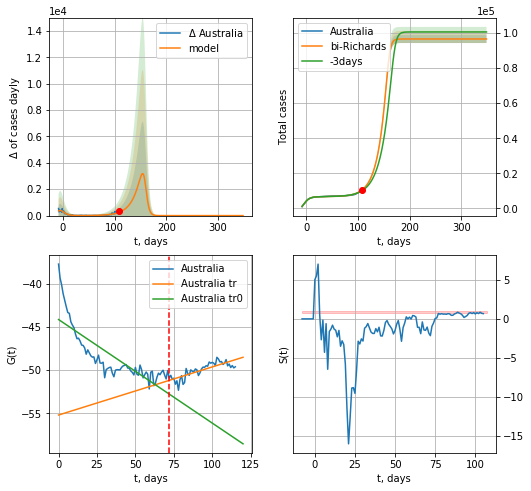

Australia data at: 2020-07-15
+3 day model MAPE: 0.043226
model: bi-Richards
coeffs: [8.98720522e+04 6.09936925e-02 1.60025022e+02 4.96386745e+00]
rational stdev: 0.023761
forecast at the end of period: +241 days
	 deltaDaycases: 0
	 total cases: 96576 ± 2294
	 total death: 1009 ± 71
bi-Richards approximation splitting point: 72
trend coefficient of determination: 0.667241
 intercept: -44.153177
 slope: -0.119735
trend coefficient of determination: 0.648391
 intercept: -55.193960
 slope: 0.055636


In [252]:
iL = 20+15
vL = 72+iL
x = forecastRR('Australia',dfAS[iL:vL-iL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Australia',dfAS[iL:],d1,50*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

ML
           date   cases  active  death
135 2020-07-11  8704.0      67  122.0
136 2020-07-12  8718.0      77  122.0
137 2020-07-13  8725.0      83  122.0
138 2020-07-14  8729.0      83  122.0
139 2020-07-15  8734.0      86  122.0


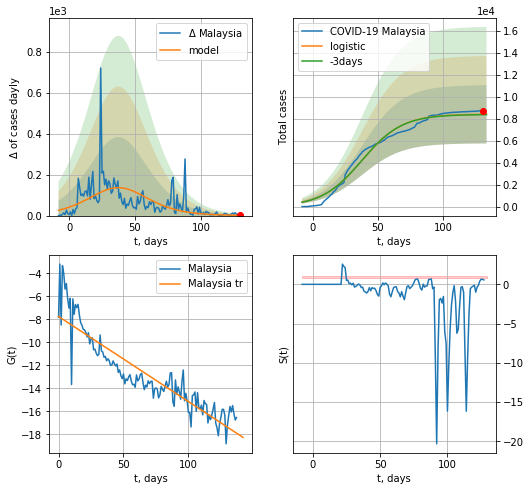

Malaysia data at: 2020-07-15
+3 day model MAPE: 0.0036550209728251322
model: logistic
coeffs:  [8.42921714e+03 6.48956425e-02 3.78424671e+01]
rational stdev:  0.31529002844803533
forecast at the end of period: +3 days
	 deltaDaycases:  1
	 total cases:  8411 ± 2652
	 total death:  117 ± 110
trend coefficient of determination: 0.819023
 intercept: -7.757363
 slope: -0.074018


In [253]:
dfML = read_df(pd.DataFrame(),"ML")
x = forecast('Malaysia',dfML[1:],d1,16*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

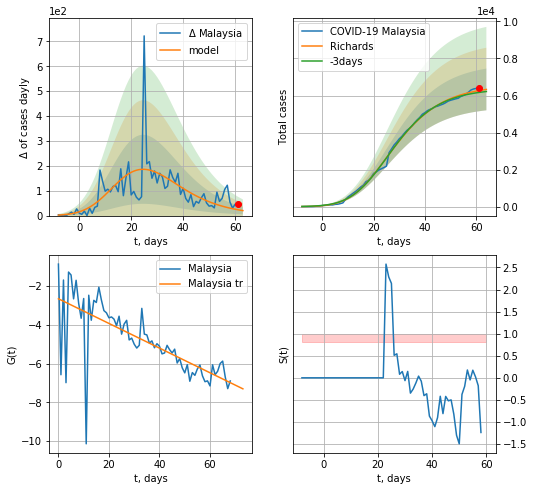

Malaysia data at: 2020-07-15
+3 day model MAPE: 0.016662
model: Richards
coeffs: [6.55738118e+03 3.88579492e-01 7.38231986e+00 2.20014246e-01]
rational stdev: 0.177891
forecast at the end of period: +3 days
	 deltaDaycases: 20
	 total cases: 6326 ± 1125
	 total death: 88 ± 46
trend coefficient of determination: 0.508698
 intercept: -2.652901
 slope: -0.063638


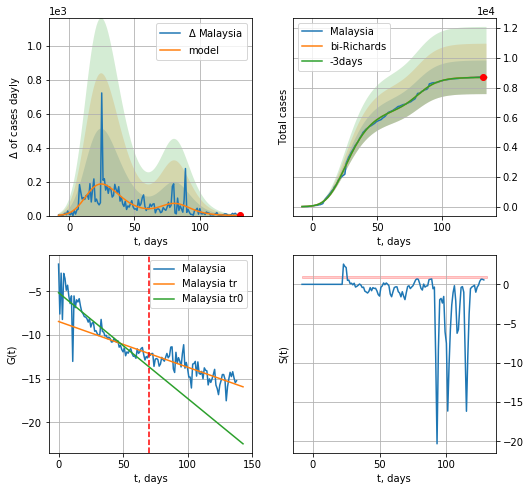

Malaysia data at: 2020-07-15
+3 day model MAPE: 0.001205
model: bi-Richards
coeffs: [2.13205023e+03 1.41931722e-01 8.02519524e+01 8.55096974e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.129896
forecast at the end of period: +3 days
	 deltaDaycases: 0
	 total cases: 8685 ± 1128
	 total death: 121 ± 47
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.784195
 intercept: -5.159661
 slope: -0.120837
trend coefficient of determination: 0.580537
 intercept: -8.450858
 slope: -0.052234


In [254]:
vL = 70
x = forecastRR('Malaysia',dfML[:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Malaysia',dfML[:],d1,16*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


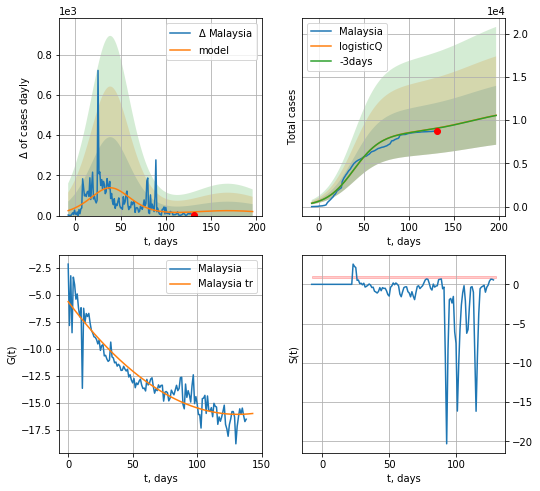

Malaysia data at: 2020-07-15
+3 day model MAPE: 0.002707
model: logisticQ
coeffs: [ 8.42612909e+03  1.10420177e-07  3.88315995e+01 -5.89041419e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.322611
forecast at the end of period: +66 days
	 deltaDaycases: 20
	 total cases: 10552 ± 3404
	 total death: 147 ± 142
trend coefficient of determination: 0.880197
 intercept_: -5.613872802793101
 coeffs_: [ 0.         -0.15943283  0.00060652]


In [255]:
x = forecastRRR('Malaysia',dfML[:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs)

ZL
           date   cases  active  death
134 2020-07-11  1544.0      25   22.0
135 2020-07-12  1544.5      25   22.0
136 2020-07-13  1545.0      25   22.0
137 2020-07-14  1547.0      27   22.0
138 2020-07-15  1548.0      27   22.0


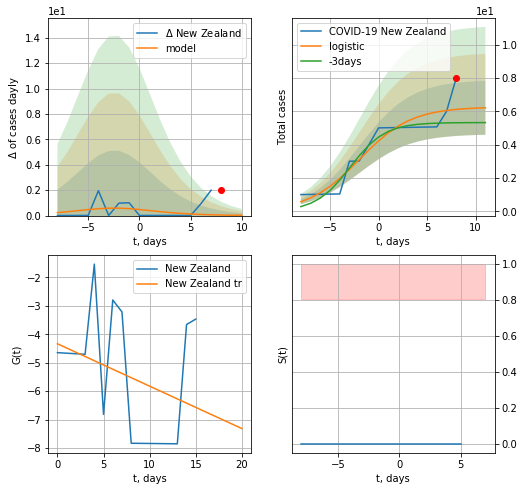

New Zealand data at: 2020-07-15
model: logistic
coeffs:  [ 6.26235961  0.37662733 -1.95315921]
rational stdev:  0.26005250078288755
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  6 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.103357
 intercept: -4.332661
 slope: -0.149156


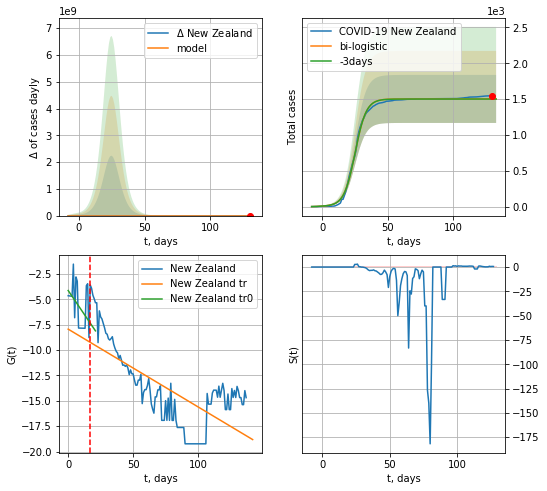

New Zealand data at: 2020-07-15
+3 day model MAPE: 0.001032790783289852
model: bi-logistic
coeffs:  [1.49614274e+03 2.36411628e-01 2.52370506e+01] [ 6.26235961  0.37662733 -1.95315921]
rational stdev:  0.22281080884681242
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  1502 ± 334
	 total death:  21 ± 14
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.175036
 intercept: -4.131936
 slope: -0.189301
trend coefficient of determination: 0.489374
 intercept: -7.938726
 slope: -0.076621


In [256]:
vL=17
dfZL = read_df(pd.DataFrame(),"ZL")
try:
    x = forecast('New Zealand',dfZL[:vL],d1,16*7-dT,pMAPE=False)
    xx = forecast2('New Zealand',dfZL[:],d1,16*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)#
except:
    print ("Exception occurs")

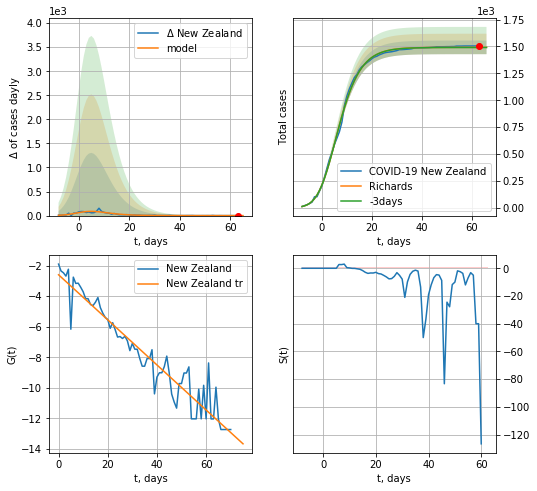

New Zealand data at: 2020-07-15
+3 day model MAPE: 0.000854
model: Richards
coeffs: [ 1.49158630e+03  5.64402224e-01 -5.41494471e-01  3.30453174e-01]
rational stdev: 0.042486
forecast at the end of period: +3 days
	 deltaDaycases: 0
	 total cases: 1491 ± 63
	 total death: 21 ± 2
trend coefficient of determination: 0.916494
 intercept: -2.603090
 slope: -0.147473


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


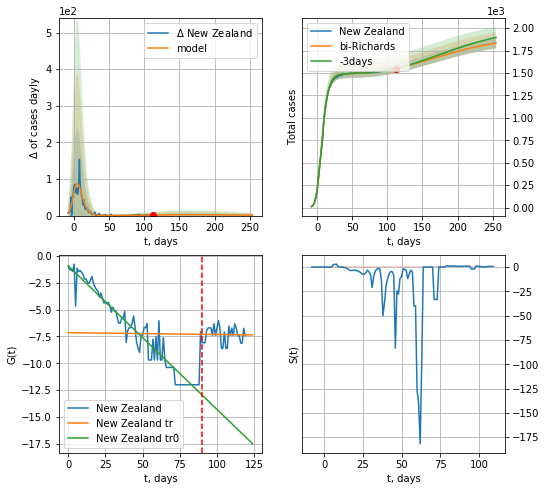

New Zealand data at: 2020-07-15
+3 day model MAPE: 0.000731
model: bi-Richards
coeffs: [ 4.39910564e+02  1.31447933e+00 -1.45621832e+02  1.11523542e-02]
rational stdev: 0.032758
forecast at the end of period: +143 days
	 deltaDaycases: 1
	 total cases: 1833 ± 60
	 total death: 26 ± 2
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.914613
 intercept: -0.922259
 slope: -0.133743
trend coefficient of determination: 0.000397
 intercept: -7.149044
 slope: -0.001744


In [259]:
vL = 90 + 18
x = forecastRR('New Zealand',dfZL[18:vL-18],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('New Zealand',dfZL[18:],d1,36*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-18)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


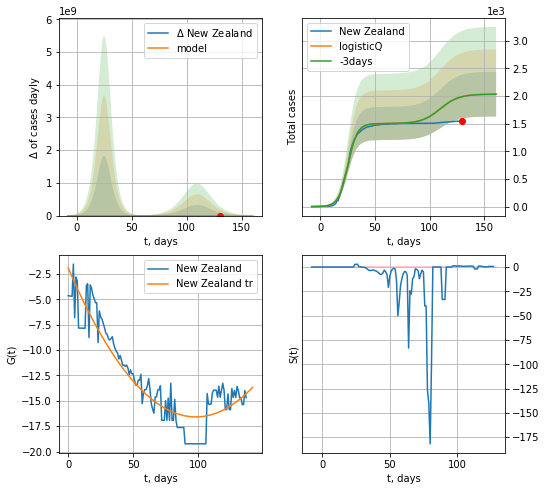

New Zealand data at: 2020-07-15
+3 day model MAPE: 0.000769
model: logisticQ
coeffs: [ 1.50260285e+03  1.81895263e-06  2.51896993e+01 -1.28717395e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.199222
forecast at the end of period: +31 days
	 deltaDaycases: 0
	 total cases: 2033 ± 405
	 total death: 28 ± 16
trend coefficient of determination: 0.853447
 intercept_: -1.906576909279515
 coeffs_: [ 0.         -0.29894289  0.00152167]


In [260]:
x = forecastRRR('New Zealand',dfZL[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

BR
           date    cases  active  death
134 2020-07-11  64767.0    9389  459.0
135 2020-07-12  64932.0    9088  464.0
136 2020-07-13  65114.0    9154  468.0
137 2020-07-14  65269.0    8996  474.0
138 2020-07-15  65443.0    8584  480.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


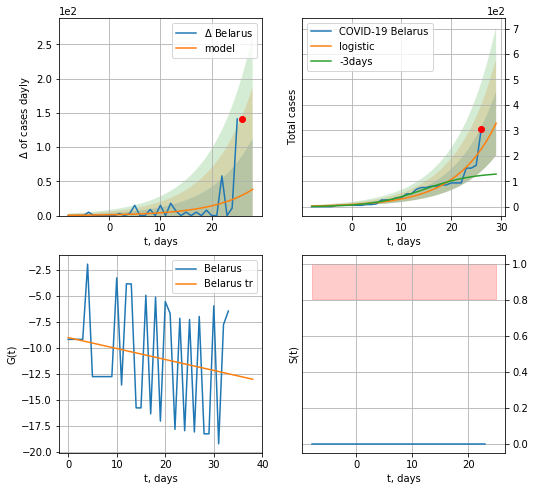

Belarus data at: 2020-07-15
+3 day model MAPE: 1.0426298586333318
model: logistic
coeffs:  [1.42197961e+06 1.24002034e-01 9.65329254e+01]
rational stdev:  0.38452901172178605
forecast at the end of period: +3 days
	 deltaDaycases:  38
	 total cases:  328 ± 126
	 total death:  2 ± 2
trend coefficient of determination: 0.039182
 intercept: -9.040329
 slope: -0.105417


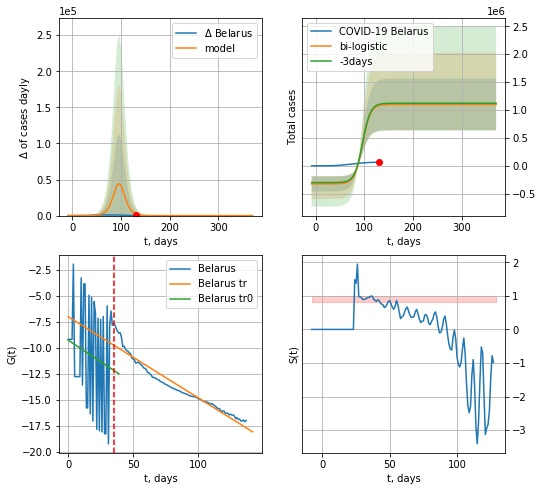

Belarus data at: 2020-07-15
+3 day model MAPE: 0.02019631279057156
model: bi-logistic
coeffs:  [-3.22588968e+05  2.47157460e+01 -5.68061173e+02] [1.42197961e+06 1.24002034e-01 9.65329254e+01]
rational stdev:  0.42115530185051875
forecast at the end of period: +241 days
	 deltaDaycases:  0
	 total cases:  1099390 ± 463014
	 total death:  8063 ± 10187
bi-logistic approximation splitting point: 35
trend0 coefficient of determination: 0.026128
 intercept: -9.289300
 slope: -0.082783
trend coefficient of determination: 0.938518
 intercept: -7.030093
 slope: -0.078008


In [261]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:35],d1,7*16-dT)
xx = forecast2('Belarus',dfBR[:],d1,50*7-dT,x,addpred=False,xcoef=[0.25,1.,1.8],vL=35)

BR
           date    cases  active  death
134 2020-07-11  64767.0    9389  459.0
135 2020-07-12  64932.0    9088  464.0
136 2020-07-13  65114.0    9154  468.0
137 2020-07-14  65269.0    8996  474.0
138 2020-07-15  65443.0    8584  480.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: invalid value encountered in true_divide


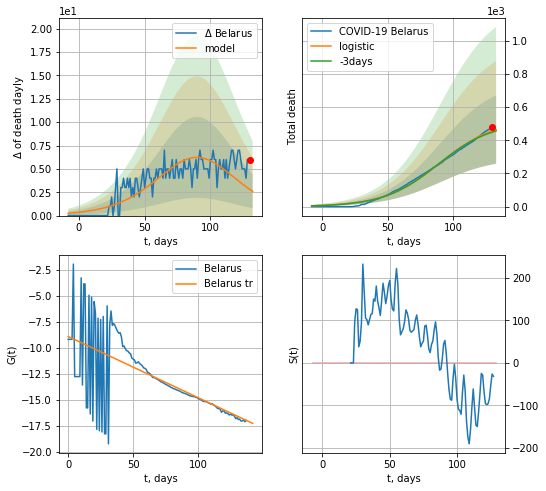

Belarus data at: 2020-07-15
+3 day model MAPE: 0.018190604123221734
model: logistic
coeffs:  [5.25788208e+02 4.73943930e-02 9.00626658e+01]
rational stdev:  0.4437076101446028
forecast at the end of period: +3 days
	 total death:  465 ± 206
trend coefficient of determination: 0.428465
 intercept: -8.937875
 slope: -0.058822


In [262]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:],d1,16*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


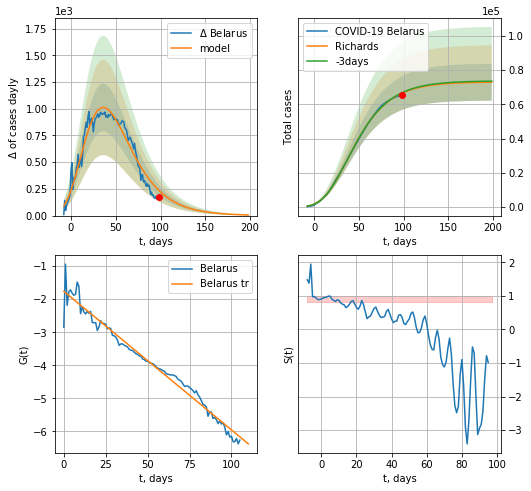

Belarus data at: 2020-07-15
+3 day model MAPE: 0.004201
model: Richards
coeffs: [ 7.31234818e+04  1.27687677e+00 -5.54560676e+01  2.98975408e-02]
rational stdev: 0.147862
forecast at the end of period: +101 days
	 deltaDaycases: 5
	 total cases: 72975 ± 10790
	 total death: 535 ± 237
trend coefficient of determination: 0.972513
 intercept: -1.762626
 slope: -0.041911


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


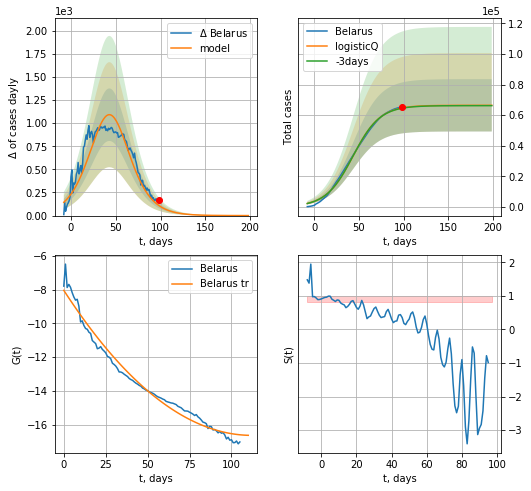

Belarus data at: 2020-07-15
+3 day model MAPE: 0.002675
model: logisticQ
coeffs: [ 6.63956935e+04  4.57419765e-07  4.33454913e+01 -1.43791321e+05]
rational stdev: 0.257412
forecast at the end of period: +101 days
	 deltaDaycases: 0
	 total cases: 66393 ± 17090
	 total death: 486 ± 375
trend coefficient of determination: 0.977329
 intercept_: -8.039876447963488
 coeffs_: [ 0.         -0.15312239  0.00068245]


In [263]:
x = forecastRR('Belarus',dfBR[32:],d1,30*7-dT,addpred=False,xcoef=RkoreaCoeffs)
x = forecastRRR('Belarus',dfBR[32:],d1,30*7-dT,addpred=False,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


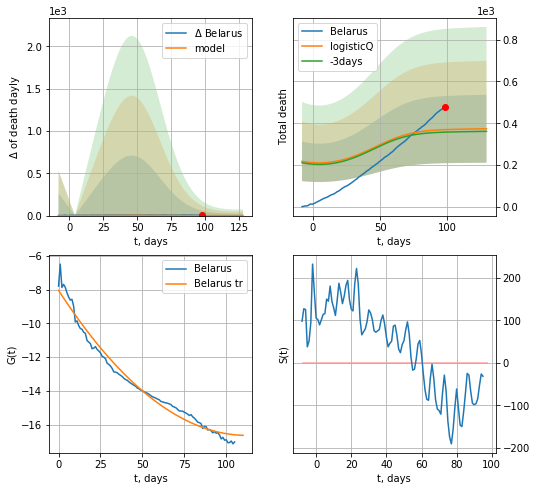

Belarus data at: 2020-07-15
+3 day model MAPE: 0.033601
model: logisticQ
coeffs: [ 3.13009583e+02  6.00299882e-04  9.65416931e+00 -6.27296267e-01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.434885
forecast at the end of period: +31 days
	 total death: 373 ± 162
trend coefficient of determination: 0.977329
 intercept_: -8.039876447963488
 coeffs_: [ 0.         -0.15312239  0.00068245]


In [264]:
x = forecastRRR('Belarus',dfBR[32:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

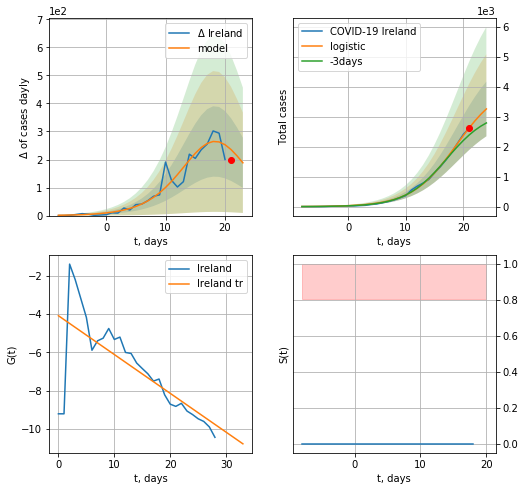

Ireland data at: 2020-07-15
+3 day model MAPE: 0.12282208812559416
model: logistic
coeffs:  [4.12730398e+03 2.56984382e-01 1.88154165e+01]
rational stdev:  0.27980533262906077
forecast at the end of period: +3 days
	 deltaDaycases:  188
	 total cases:  3265 ± 913
	 total death:  222 ± 186
trend coefficient of determination: 0.521820
 intercept: -4.083344
 slope: -0.202899


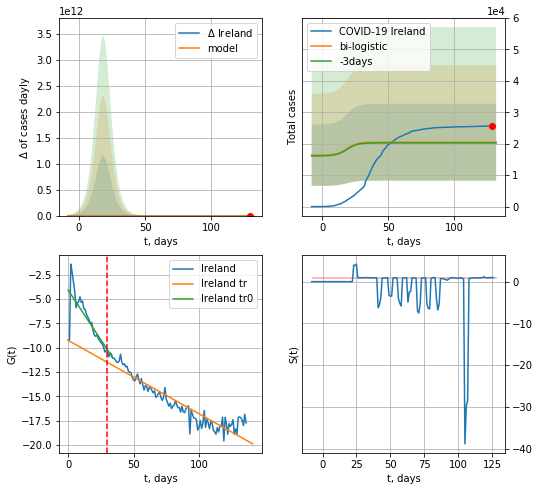

Ireland data at: 2020-07-15
+3 day model MAPE: 0.011593576972221277
model: bi-logistic
coeffs:  [ 1.30850971e+04 -1.07399768e+01  2.70070121e+02] [4.12730398e+03 2.56984382e-01 1.88154165e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.5964493351880616
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  20483 ± 12217
	 total death:  1394 ± 2494
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.551550
 intercept: -4.065434
 slope: -0.204818
trend coefficient of determination: 0.876964
 intercept: -9.239100
 slope: -0.075559


In [265]:
vL=30
x = forecast('Ireland',dfIR[:vL],d1,16*7-dT)
xx = forecast2('Ireland',dfIR[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


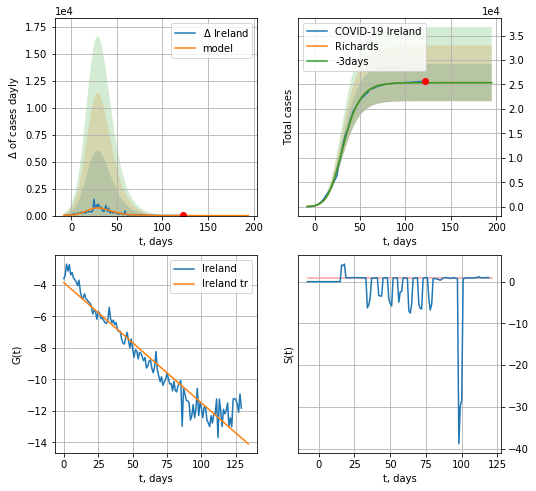

Ireland data at: 2020-07-15
+3 day model MAPE: 0.000802
model: Richards
coeffs: [2.53883603e+04 2.20188779e-01 2.00871565e+01 4.17850505e-01]
rational stdev: 0.149592
forecast at the end of period: +73 days
	 deltaDaycases: 0
	 total cases: 25388 ± 3797
	 total death: 1727 ± 775
trend coefficient of determination: 0.927248
 intercept: -3.869925
 slope: -0.076243


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


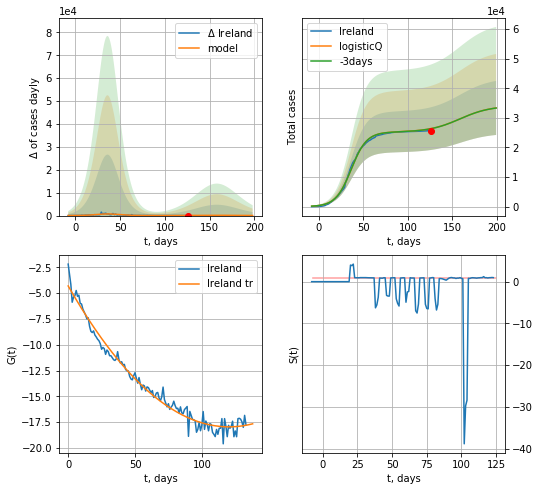

Ireland data at: 2020-07-15
+3 day model MAPE: 0.000936
model: logisticQ
coeffs: [ 2.51985362e+04  6.82431639e-07  3.63477124e+01 -1.69189128e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.273773
forecast at the end of period: +73 days
	 deltaDaycases: 41
	 total cases: 33351 ± 9130
	 total death: 2269 ± 1863
trend coefficient of determination: 0.978547
 intercept_: -4.312230807456867
 coeffs_: [ 0.         -0.22668558  0.00094185]


In [266]:
ivL = 7
vL = 90 + ivL
x = forecastRR('Ireland',dfIR[7:],d1,26*7-dT,addpred=False,xcoef=RkoreaCoeffs)
#xx = forecast2RR('Ireland',dfIR[7:],d1,26*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-ivL)
x = forecastRRR('Ireland',dfIR[3:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

CL
           date   cases  active   death
130 2020-07-11  312029   24034  6881.0
131 2020-07-12  315041   24160  6979.0
132 2020-07-13  317657   24077  7024.0
133 2020-07-14  319493   23204  7069.0
134 2020-07-15  321205   21934  7186.0


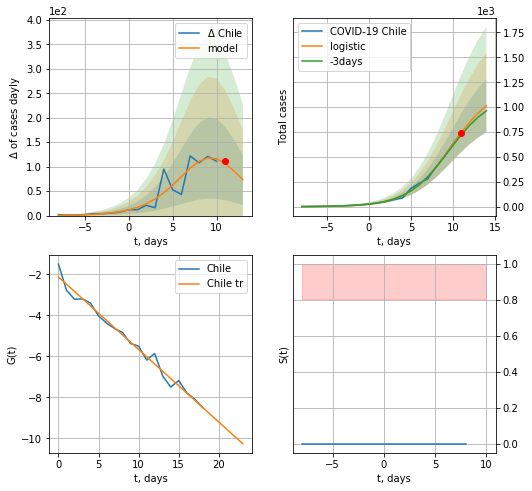

Chile data at: 2020-07-15
+3 day model MAPE: 0.03908987806693812
model: logistic
coeffs:  [1.20759839e+03 3.93191843e-01 9.80781865e+00]
rational stdev:  0.2610672451056305
forecast at the end of period: +3 days
	 deltaDaycases:  73
	 total cases:  1012 ± 264
	 total death:  22 ± 17
trend coefficient of determination: 0.982168
 intercept: -2.127319
 slope: -0.354074


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


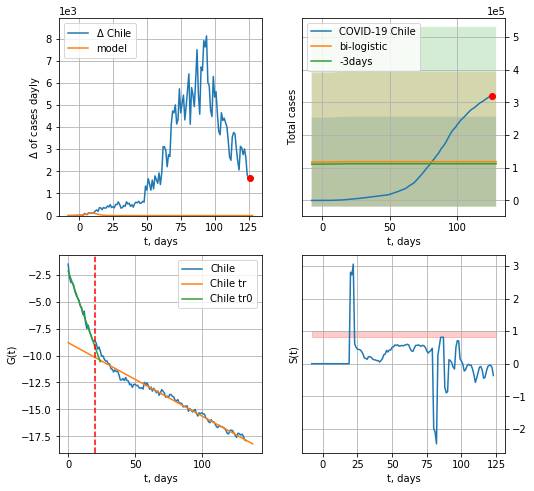

Chile data at: 2020-07-15
+3 day model MAPE: 0.05677533572505528
model: bi-logistic
coeffs:  [ 9.39266957e+04 -2.04297189e+01  4.97940798e+02] [1.20759839e+03 3.93191843e-01 9.80781865e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  1.1596512700833181
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  118615 ± 137553
	 total death:  2653 ± 9229
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.984051
 intercept: -2.144368
 slope: -0.351232
trend coefficient of determination: 0.970129
 intercept: -8.805217
 slope: -0.068103


In [267]:
vL=20
dfCL = read_df(pd.DataFrame(),"CL")
x = forecast('Chile',dfCL[:vL],d1,7*16-dT)
xx = forecast2('Chile',dfCL[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


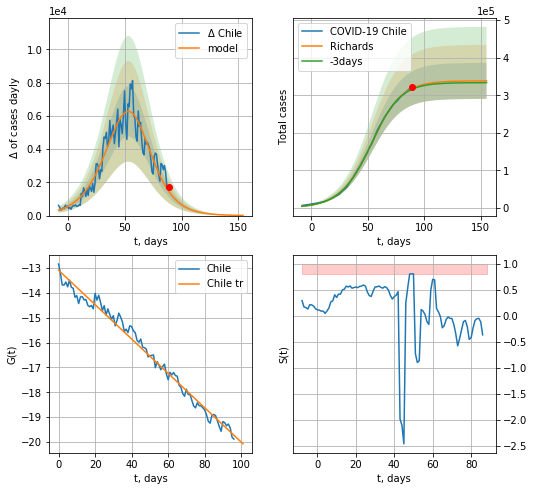

Chile data at: 2020-07-15
+3 day model MAPE: 0.007282
model: Richards
coeffs: [3.38290497e+05 6.71714031e-02 5.56031433e+01 1.15555710e+00]
rational stdev: 0.141426
forecast at the end of period: +66 days
	 deltaDaycases: 10
	 total cases: 338159 ± 47824
	 total death: 7565 ± 3209
trend coefficient of determination: 0.983771
 intercept: -13.081965
 slope: -0.069254


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


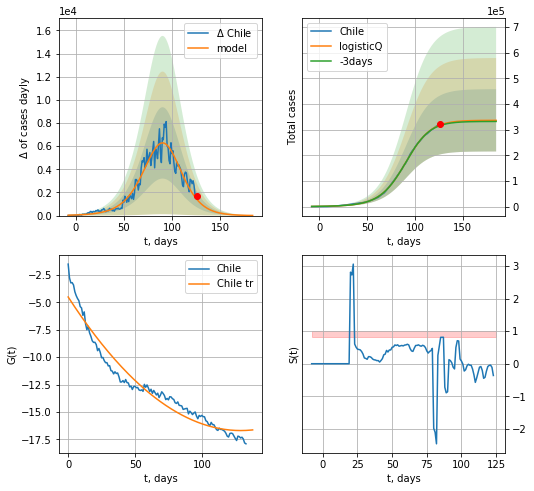

Chile data at: 2020-07-15
+3 day model MAPE: 0.007013
model: logisticQ
coeffs: [ 3.36310020e+05  9.67485541e-05  8.98052757e+01 -6.81487581e+02]
rational stdev: 0.360969
forecast at the end of period: +59 days
	 deltaDaycases: 11
	 total cases: 336194 ± 121356
	 total death: 7521 ± 8144
trend coefficient of determination: 0.947210
 intercept_: -4.5058929471530895
 coeffs_: [ 0.         -0.18901639  0.0007323 ]


In [270]:
vL = 20+10
x = forecastRR('Chile',dfCL[37:],d1,25*7-dT,addpred=False,xcoef=RkoreaCoeffs)
#xx = forecast2RR('Chile',dfCL[10:],d1,40*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL-10)
x = forecastRRR('Chile',dfCL[:],d1,24*7-dT,addpred=False,xcoef=koreaCoeffs)

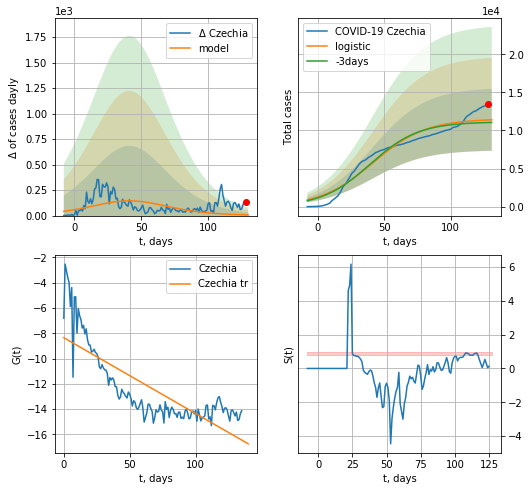

Czechia data at: 2020-07-15
+3 day model MAPE: 0.030686778173434567
model: logistic
coeffs:  [1.15216761e+04 5.02809265e-02 4.14945823e+01]
rational stdev:  0.35672519384467366
forecast at the end of period: +3 days
	 deltaDaycases:  6
	 total cases:  11395 ± 4064
	 total death:  300 ± 321
trend coefficient of determination: 0.631082
 intercept: -8.350727
 slope: -0.059916


In [271]:
x = forecast('Czechia',dfCH[:],d1,16*7-dT,shift=1.,addpred=False,xcoef=[0.25,1.,2.4])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


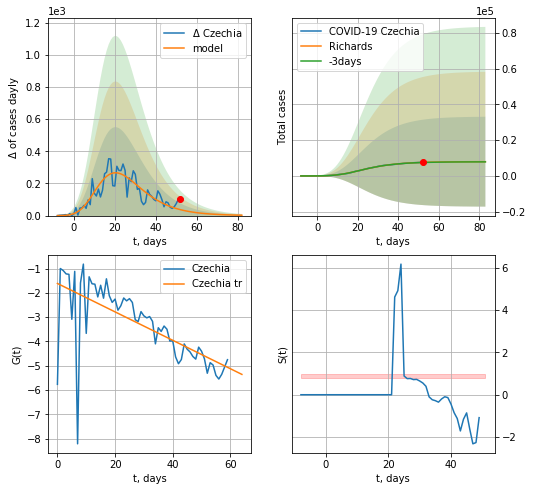

Czechia data at: 2020-07-15
+3 day model MAPE: 0.007833
model: Richards
coeffs: [ 7.98936728e+03  1.90702295e+00 -1.17113715e+01  4.87284384e-02]
rational stdev: 3.153560
forecast at the end of period: +31 days
	 deltaDaycases: 2
	 total cases: 7964 ± 25117
	 total death: 209 ± 1977
trend coefficient of determination: 0.449014
 intercept: -1.614154
 slope: -0.058414


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


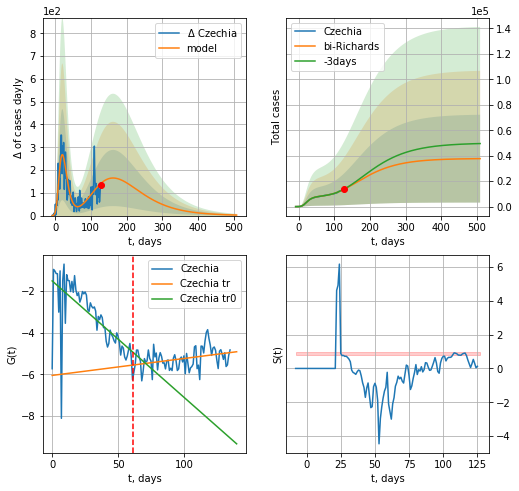

Czechia data at: 2020-07-15
+3 day model MAPE: 0.010661
model: bi-Richards
coeffs: [ 2.98398558e+04  6.57851665e-01 -8.50299176e+01  2.31127839e-02]
rational stdev: 0.915663
forecast at the end of period: +381 days
	 deltaDaycases: 2
	 total cases: 37675 ± 34497
	 total death: 992 ± 2725
bi-Richards approximation splitting point: 61
trend coefficient of determination: 0.435326
 intercept: -1.510702
 slope: -0.055952
trend coefficient of determination: 0.120116
 intercept: -6.055086
 slope: 0.008129


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


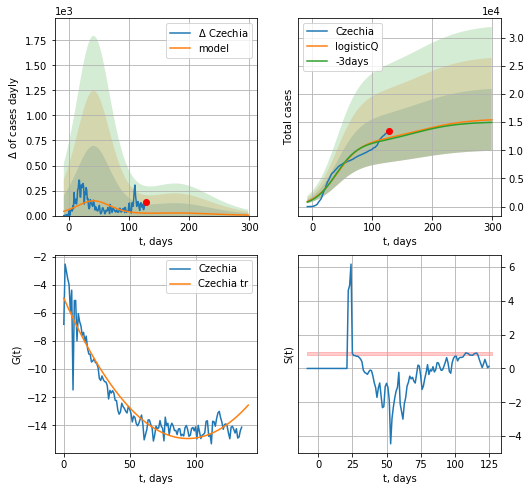

Czechia data at: 2020-07-15
+3 day model MAPE: 0.022163
model: logisticQ
coeffs: [ 1.15215839e+04  6.50342473e-08  4.14949383e+01 -7.72844328e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.356741
forecast at the end of period: +171 days
	 deltaDaycases: 4
	 total cases: 15406 ± 5496
	 total death: 405 ± 433
trend coefficient of determination: 0.906475
 intercept_: -4.952375136795652
 coeffs_: [ 0.         -0.21208343  0.00112717]


In [272]:
vL= 61
x = forecastRR('Czechia',dfCH[:vL],d1,20*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Czechia',dfCH[:],d1,70*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRRR('Czechia',dfCH[:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

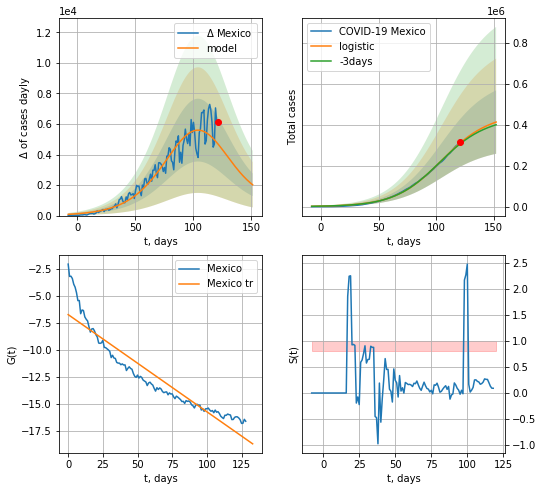

Mexico data at: 2020-07-15
+3 day model MAPE: 0.014627339277042163
model: logistic
coeffs:  [4.43727379e+05 5.01931870e-02 1.04142250e+02]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.37497200997482544
forecast at the end of period: +31 days
	 deltaDaycases:  2019
	 total cases:  413103 ± 154902
	 total death:  47998 ± 53993
trend coefficient of determination: 0.882523
 intercept: -6.749944
 slope: -0.089863


In [273]:
x = forecast('Mexico',dfMX[:],d1,20*7-dT,addpred=True,xcoef=[.25,1.,2.])#

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


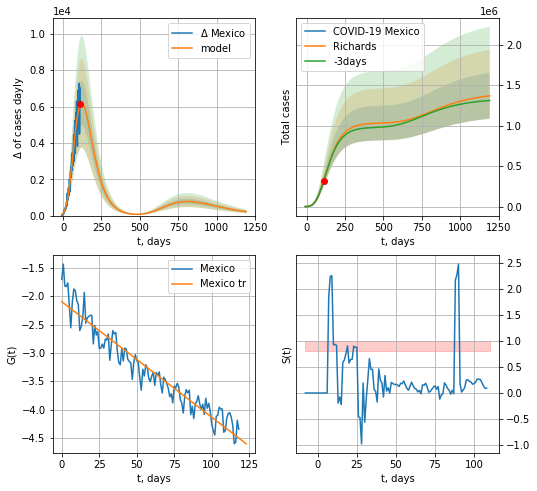

Mexico data at: 2020-07-15
+3 day model MAPE: 0.001811
model: Richards
coeffs: [ 1.03357298e+06  5.20741322e-01 -8.61824203e+01  3.17750556e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.207449
forecast at the end of period: +1081 days
	 deltaDaycases: 216
	 total cases: 1367750 ± 283739
	 total death: 158918 ± 98902
trend coefficient of determination: 0.918697
 intercept: -2.097243
 slope: -0.020392


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


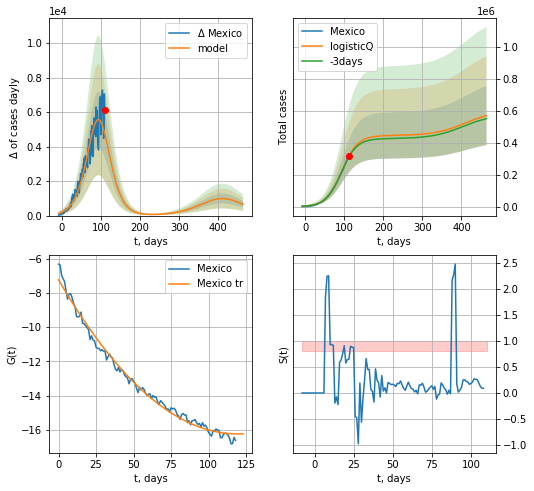

Mexico data at: 2020-07-15
+3 day model MAPE: 0.014765
model: logisticQ
coeffs: [ 4.44215212e+05  9.26025530e-07  9.41935932e+01 -5.40611274e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.324514
forecast at the end of period: +353 days
	 deltaDaycases: 654
	 total cases: 569072 ± 184671
	 total death: 66120 ± 64370
trend coefficient of determination: 0.989095
 intercept_: -7.236533621806103
 coeffs_: [ 0.         -0.15116249  0.00063489]


In [274]:
x = forecastRR('Mexico',dfMX[10:],d1,170*7-dT,addpred=True,xcoef=RkoreaCoeffs)#
x = forecastRRR('Mexico',dfMX[10:],d1,66*7-dT,addpred=True,xcoef=koreaCoeffs)#

LT
           date   cases  active  death     tests
124 2020-07-11  1869.0     207   79.0  461110.0
125 2020-07-12  1874.0     224   79.0  461666.0
126 2020-07-13  1875.0     213   79.0  465396.0
127 2020-07-14  1896.0     209   79.0  469126.0
128 2020-07-15  1882.0     221   79.0       NaN
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: invalid value encountered in log


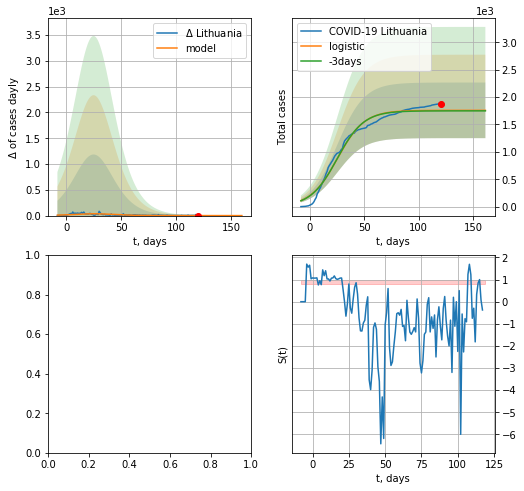

In [275]:
vL = 17
dfLT = read_df(pd.DataFrame(),"LT")
try:
    x = forecast('Lithuania',dfLT[:],d1,6*7-1)
except:
    print("Exception occurs")
#xx = forecast2('Lithuania',dfLT[:],d1,8*7-1,x,shift=1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

In [397]:
#dfLT = read_df(pd.DataFrame(),"LT")
#plt.plot(range(len(dfLT[3:])),dfLT[3:].cases/dfLT[3:].tests)

#plt.grid()#

In [398]:
#np.diff(dfLT["cases"])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: invalid value encountered in true_divide


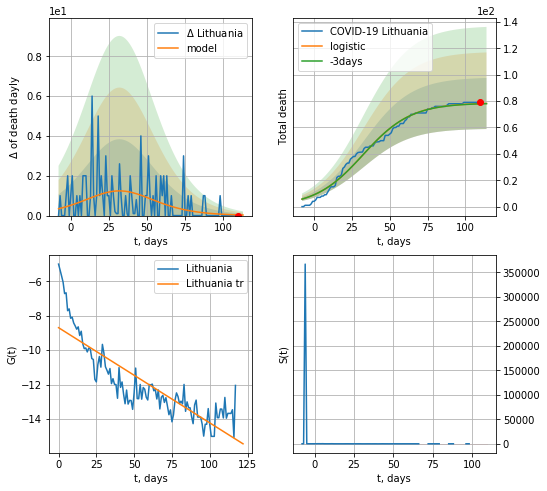

Lithuania data at: 2020-07-14
+3 day model MAPE: 0.0015767726394455641
model: logistic
coeffs:  [7.86445259e+01 6.30470174e-02 3.23718502e+01]
rational stdev:  0.24756377455789857
forecast at the end of period: +4 days
	 total death:  78 ± 19
trend coefficient of determination: 0.733086
 intercept: -8.695624
 slope: -0.055301


In [430]:
x = forecast('Lithuania',dfLT[9:],d1,7*16-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


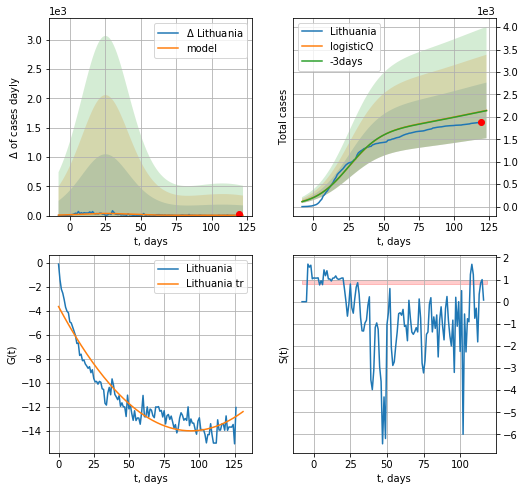

Lithuania data at: 2020-07-14
+3 day model MAPE: 0.002033
model: logisticQ
coeffs: [ 1.75527472e+03  1.32939975e-07  2.53570048e+01 -6.12813723e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.289574
forecast at the end of period: +4 days
	 deltaDaycases: 6
	 total cases: 2143 ± 620
	 total death: 90 ± 78
trend coefficient of determination: 0.906206
 intercept_: -3.6402309661031538
 coeffs_: [ 0.         -0.22018395  0.00117094]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


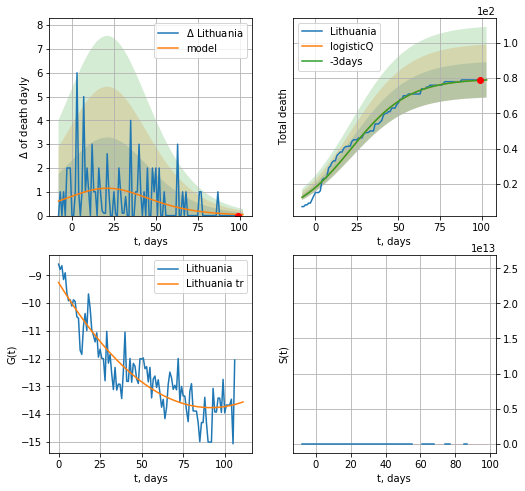

Lithuania data at: 2020-07-14
+3 day model MAPE: 0.000408
model: logisticQ
coeffs: [ 7.97239745e+01  3.26328401e-07  2.15186974e+01 -1.76758685e+05]
rational stdev: 0.127113
forecast at the end of period: +4 days
	 total death: 79 ± 10
trend coefficient of determination: 0.813308
 intercept_: -9.251407376862165
 coeffs_: [ 0.         -0.09864673  0.0005388 ]


In [431]:
#x = forecast('Lithuania',dfLT[10-4:],d1,6*7-1,cases='active')
x = forecastRRR('Lithuania',dfLT[:],d1,16*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Lithuania',dfLT[20:],d1,16*7-dT,addpred=False,xcoef=koreaCoeffs,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


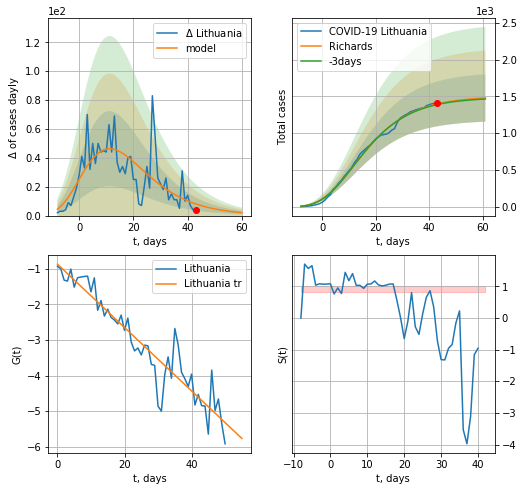

Lithuania data at: 2020-07-14
+3 day model MAPE: 0.007012
model: Richards
coeffs: [ 1.50132611e+03  1.12493927e+01 -4.63966164e+01  7.48936262e-03]
rational stdev: 0.217638
forecast at the end of period: +18 days
	 deltaDaycases: 2
	 total cases: 1477 ± 321
	 total death: 62 ± 40
trend coefficient of determination: 0.886584
 intercept: -0.865642
 slope: -0.089154


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


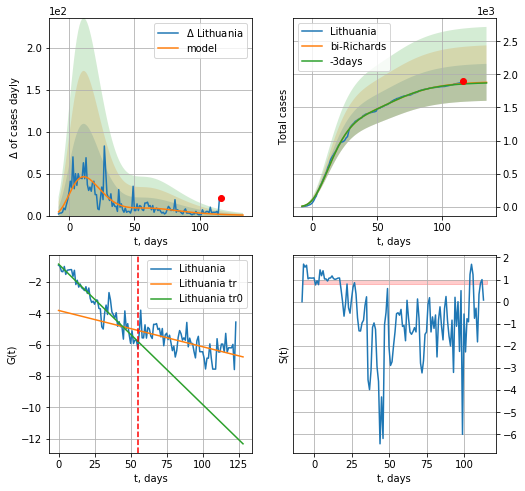

Lithuania data at: 2020-07-14
+3 day model MAPE: 0.003854
model: bi-Richards
coeffs: [ 3.90354011e+02  8.30421721e+00 -3.18510978e+01  6.21624968e-03]
rational stdev: 0.148479
forecast at the end of period: +18 days
	 deltaDaycases: 0
	 total cases: 1879 ± 279
	 total death: 79 ± 35
bi-Richards approximation splitting point: 55
trend coefficient of determination: 0.906199
 intercept: -0.851091
 slope: -0.089592
trend coefficient of determination: 0.325936
 intercept: -3.807797
 slope: -0.023158


In [466]:
iL = 3
vL =55+iL
x = forecastRR('Lithuania',dfLT[iL:vL-iL],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)#
xx = forecast2RR('Lithuania',dfLT[iL:],d1,18*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)#
#xx = forecast2R('Lithuania',dfLT[:],d1,2*7-1,x,shift=1.0,addpred=True,xcoef=[0.25,1.,1.5])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


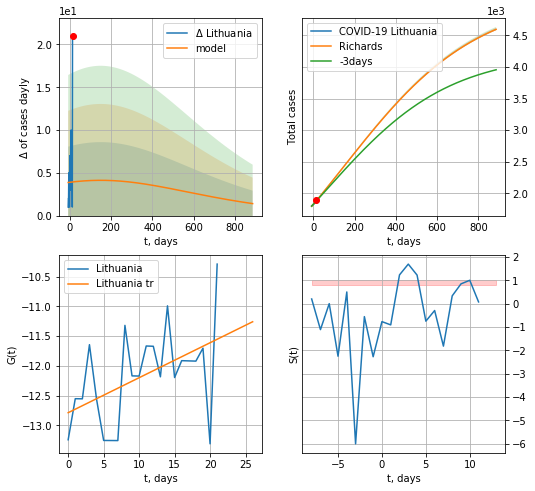

Lithuania data at: 2020-07-14
+3 day model MAPE: 0.002669
model: Richards
coeffs: [5.10826410e+03 3.90796228e-03 6.09692119e+01 7.66347871e-01]
rational stdev: 0.002814
forecast at the end of period: +872 days
	 deltaDaycases: 1
	 total cases: 4595 ± 12
	 total death: 193 ± 1
trend coefficient of determination: 0.230649
 intercept: -12.787909
 slope: 0.058870


In [480]:
x = forecastRR('Lithuania',dfLT[105:],d1,140*7-dT,addpred=False,xcoef=RkoreaCoeffs)#

In [474]:
#x = forecastQR('Lithuania',dfLT[:],d1,16*7-dT,addpred=False,xcoef=[0.35,.52,4.,1.,1.])

LX
           date   cases  active  death
126 2020-07-11  4842.0     646  110.0
127 2020-07-12  4925.0     728  111.0
128 2020-07-13  4956.0     662  111.0
129 2020-07-14  5056.0     750  111.0
130 2020-07-15  5122.0     764  111.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


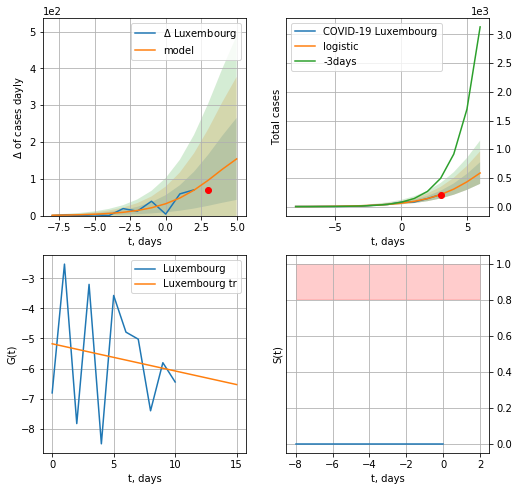

Luxembourg data at: 2020-07-15
model: logistic
coeffs:  [1.56298312e+03 4.51684200e-01 7.13428385e+00]
rational stdev:  0.3215238047871676
forecast at the end of period: +3 days
	 deltaDaycases:  154
	 total cases:  585 ± 188
	 total death:  12 ± 11
trend coefficient of determination: 0.022967
 intercept: -5.176630
 slope: -0.090347


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


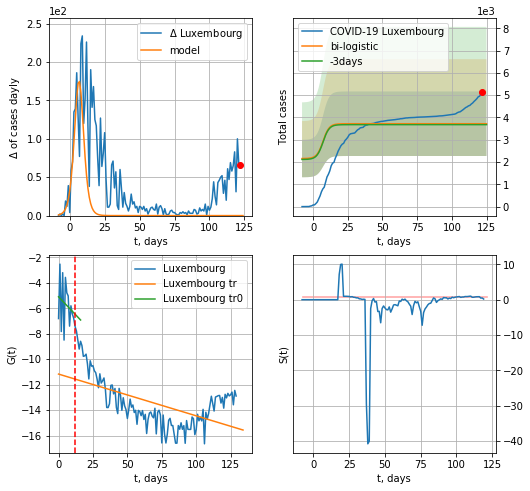

Luxembourg data at: 2020-07-15
+3 day model MAPE: 0.011205601611802465
model: bi-logistic
coeffs:  [1917.97178643   -7.38351008  262.95315942] [1.56298312e+03 4.51684200e-01 7.13428385e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.38906824310037624
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  3720 ± 1447
	 total death:  80 ± 93
bi-logistic approximation splitting point: 12
trend0 coefficient of determination: 0.045986
 intercept: -5.098250
 slope: -0.113861
trend coefficient of determination: 0.322196
 intercept: -11.169149
 slope: -0.032797


In [276]:
dfLX = read_df(pd.DataFrame(),"LX")
x = forecast("Luxembourg",dfLX[:12],d1,16*7-dT,pMAPE=False)
xx = forecast2("Luxembourg",dfLX[:],d1,16*7-dT,x,vL=12,addpred=True,xcoef=[0.25/2,1.,2.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


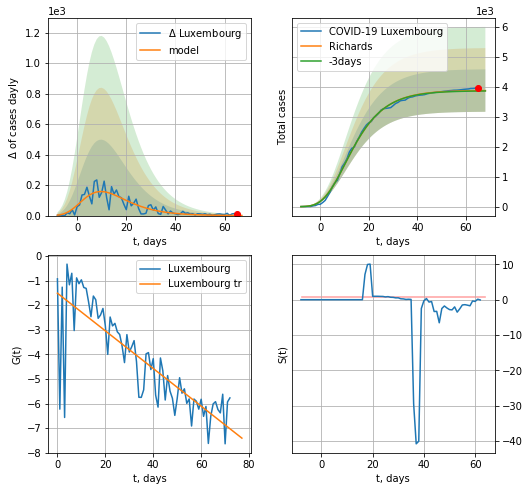

Luxembourg data at: 2020-07-15
+3 day model MAPE: 0.003344
model: Richards
coeffs: [ 3.88160251e+03  1.96402612e+01 -3.64722546e+01  5.64743178e-03]
rational stdev: 0.182832
forecast at the end of period: +3 days
	 deltaDaycases: 0
	 total cases: 3875 ± 708
	 total death: 83 ± 45
trend coefficient of determination: 0.686753
 intercept: -1.514239
 slope: -0.076483


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


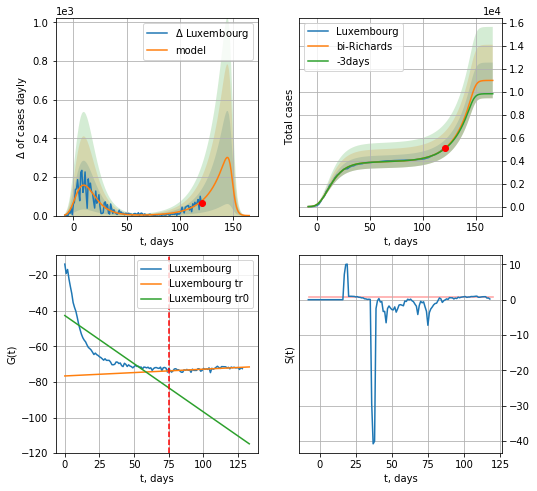

Luxembourg data at: 2020-07-15
+3 day model MAPE: 0.008398
model: bi-Richards
coeffs: [7.10267417e+03 6.30031051e-02 1.49111977e+02 7.98259051e+00]
rational stdev: 0.141396
forecast at the end of period: +45 days
	 deltaDaycases: 0
	 total cases: 10984 ± 1553
	 total death: 238 ± 100
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.620498
 intercept: -42.681829
 slope: -0.542150
trend coefficient of determination: 0.424300
 intercept: -76.643238
 slope: 0.038127


In [277]:
iL=1
vL = 75+iL
x = forecastRR("Luxembourg",dfLX[iL:vL-iL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Luxembourg",dfLX[iL:],d1,22*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


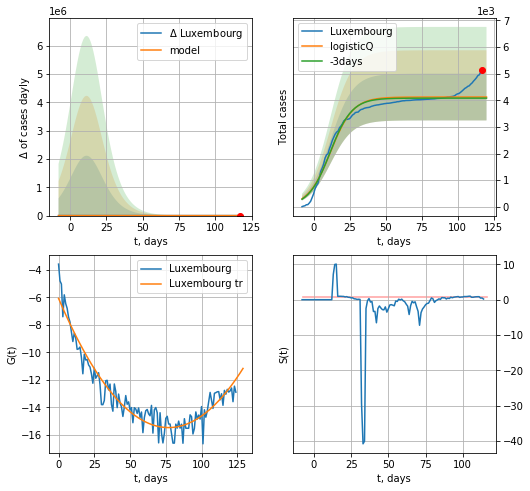

Luxembourg data at: 2020-07-15
+3 day model MAPE: 0.010099
model: logisticQ
coeffs: [ 4.12122987e+03  1.73456792e-07  1.17583813e+01 -7.39452867e+05]
rational stdev: 0.212956
forecast at the end of period: +3 days
	 deltaDaycases: 0
	 total cases: 4121 ± 877
	 total death: 89 ± 56
trend coefficient of determination: 0.913841
 intercept_: -6.066566285341796
 coeffs_: [ 0.         -0.24435829  0.001588  ]


In [278]:
x = forecastRRR("Luxembourg",dfLX[5:],d1,16*7-dT,addpred=False,xcoef=koreaCoeffs)

ED
           date    cases   active   death
133 2020-07-11  67209.0  32071.0  5031.0
134 2020-07-12  67870.0  32540.0  5047.0
135 2020-07-13  68459.0  33027.0  5063.0
136 2020-07-14  69570.0  33956.0  5130.0
137 2020-07-15  70329.0  34530.0  5158.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


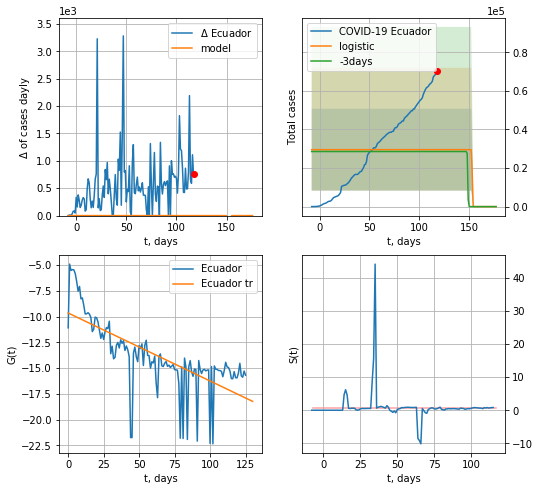

Ecuador data at: 2020-07-15
+3 day model MAPE: 0.03382004328596202
model: logistic
coeffs:  [ 2.95271265e+04 -5.45448338e+00  1.53070216e+02]
rational stdev:  0.7186531002914167
forecast at the end of period: +59 days
	 deltaDaycases:  0
	 total cases:  0 ± 0
	 total death:  0 ± 0
trend coefficient of determination: 0.500189
 intercept: -9.648738
 slope: -0.066043


In [279]:
dfED = read_df(pd.DataFrame(),"ED")
x = forecast("Ecuador",dfED[11:],d1,24*7-dT)
#xx = forecast2(c,adf[:],d1,4*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


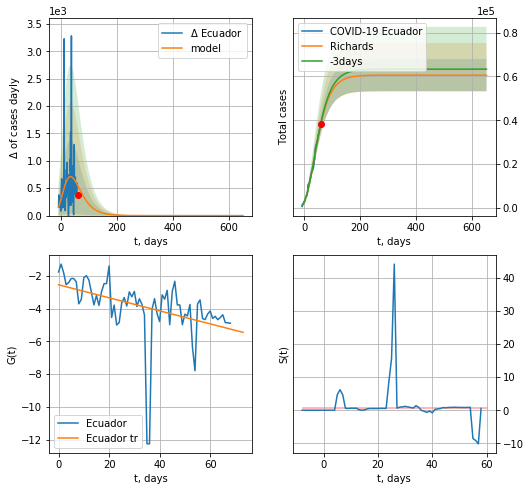

Ecuador data at: 2020-07-15
+3 day model MAPE: 0.010670
model: Richards
coeffs: [ 6.05715248e+04  1.40196991e+00 -8.12231533e+01  2.30635410e-02]
rational stdev: 0.121131
forecast at the end of period: +591 days
	 deltaDaycases: 0
	 total cases: 60571 ± 7337
	 total death: 4442 ± 1614
trend coefficient of determination: 0.186200
 intercept: -2.545202
 slope: -0.039774


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


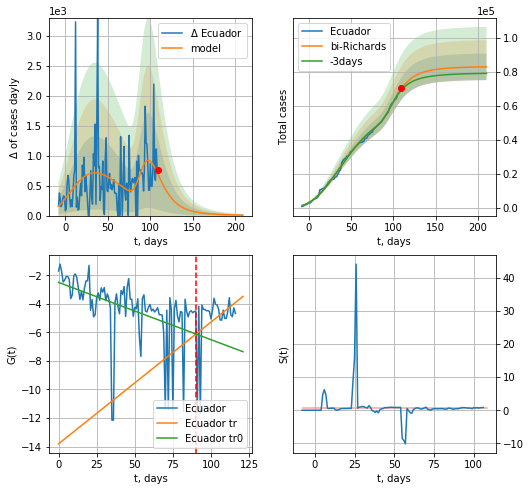

Ecuador data at: 2020-07-15
+3 day model MAPE: 0.013124
model: bi-Richards
coeffs: [2.27469267e+04 6.40005059e+00 4.76548136e+01 1.31373171e-02]
rational stdev: 0.094383
forecast at the end of period: +101 days
	 deltaDaycases: 7
	 total cases: 83103 ± 7843
	 total death: 6094 ± 1725
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.213351
 intercept: -2.496030
 slope: -0.040160
trend coefficient of determination: 0.119803
 intercept: -13.810083
 slope: 0.085367


In [280]:
vL = 90+20
x = forecastRR("Ecuador",dfED[20:vL-20],d1,100*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Ecuador",dfED[20:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


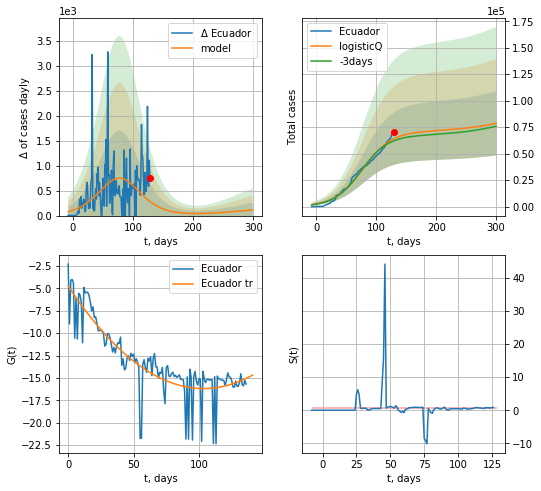

Ecuador data at: 2020-07-15
+3 day model MAPE: 0.032002
model: logisticQ
coeffs: [ 7.08561519e+04  1.43393822e-07  7.74679361e+01 -2.95327024e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.385981
forecast at the end of period: +171 days
	 deltaDaycases: 114
	 total cases: 78618 ± 30345
	 total death: 5765 ± 6675
trend coefficient of determination: 0.732352
 intercept_: -4.744815129688588
 coeffs_: [ 0.         -0.22123666  0.0010692 ]


In [281]:
x = forecastRRR("Ecuador",dfED[:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

FI
           date   cases  active  death
137 2020-07-11  7291.0     162  329.0
138 2020-07-12  7294.0     165  329.0
139 2020-07-13  7295.0     166  329.0
140 2020-07-14  7296.0     172  329.0
141 2020-07-15  7296.5      88  328.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


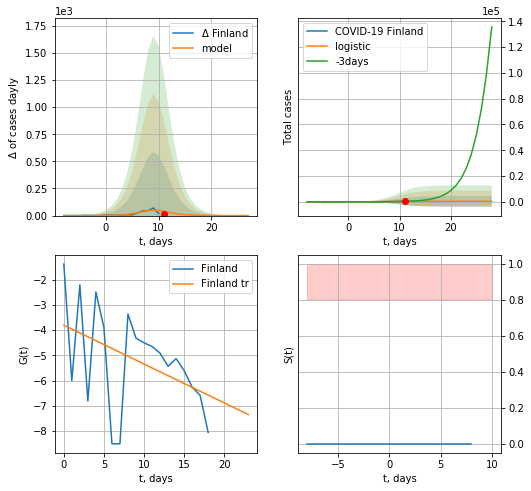

Finland data at: 2020-07-15
+3 day model MAPE: 0.3536794792474036
model: logistic
coeffs:  [373.20900186   0.53490302   9.59276199]
rational stdev:  11.028448708024662
forecast at the end of period: +17 days
	 deltaDaycases:  0
	 total cases:  373 ± 4115
	 total death:  16 ± 529
trend coefficient of determination: 0.182614
 intercept: -3.802910
 slope: -0.153962


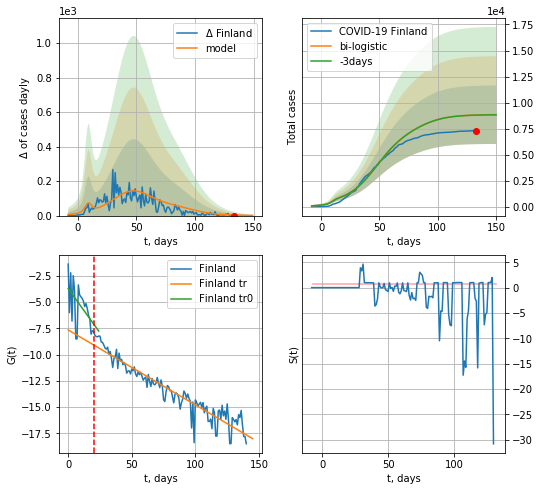

Finland data at: 2020-07-15
+3 day model MAPE: 0.001593514941241475
model: bi-logistic
coeffs:  [6.77729144e+03 8.11607104e-02 4.71642838e+01] [373.20900186   0.53490302   9.59276199]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.3182185431172514
forecast at the end of period: +17 days
	 deltaDaycases:  0
	 total cases:  8834 ± 2811
	 total death:  397 ± 378
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.234981
 intercept: -3.717136
 slope: -0.168257
trend coefficient of determination: 0.898734
 intercept: -7.649478
 slope: -0.071315


In [299]:
dfFI = read_df(pd.DataFrame(),"FI")
vL=20
x = forecast("Finland",dfFI[:vL],d1,7*18-dT)
xx = forecast2("Finland",dfFI[:],d1,18*7-dT,x,vL=vL,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


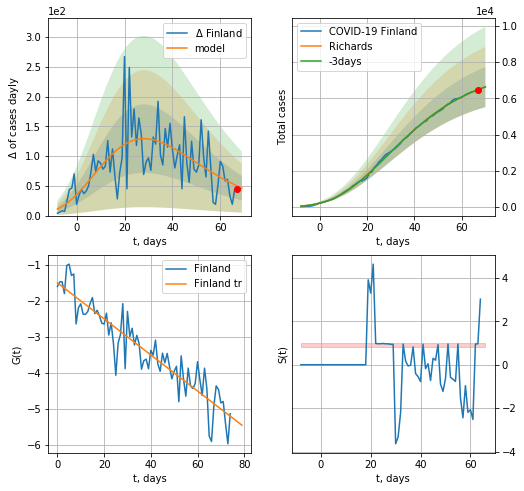

Finland data at: 2020-07-15
+3 day model MAPE: 0.001636
model: Richards
coeffs: [ 7.67975998e+03  2.65386989e+00 -5.92221329e+01  1.73850507e-02]
rational stdev: 0.167365
forecast at the end of period: +3 days
	 deltaDaycases: 46
	 total cases: 6623 ± 1108
	 total death: 297 ± 149
trend coefficient of determination: 0.854396
 intercept: -1.508202
 slope: -0.049971


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


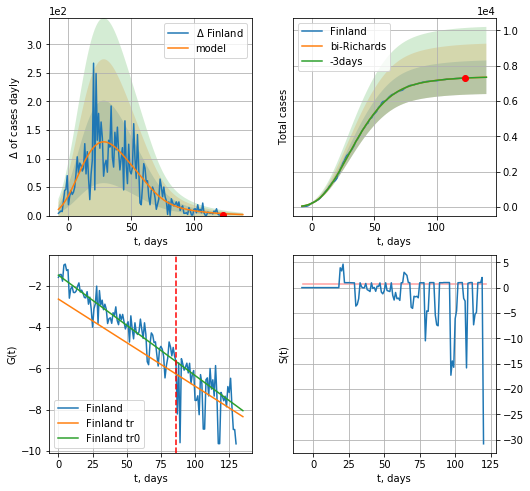

Finland data at: 2020-07-15
+3 day model MAPE: 0.000079
model: bi-Richards
coeffs: [-2.97897350e+02  9.51516143e+00  9.50366872e+00  7.37314808e-03]
rational stdev: 0.129480
forecast at the end of period: +17 days
	 deltaDaycases: 1
	 total cases: 7341 ± 950
	 total death: 330 ± 128
bi-Richards approximation splitting point: 86
trend coefficient of determination: 0.875154
 intercept: -1.476833
 slope: -0.048664
trend coefficient of determination: 0.206489
 intercept: -2.637440
 slope: -0.042220


In [301]:
vL = 86 + 10
x = forecastRR("Finland",dfFI[10:vL-10],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Finland",dfFI[10:],d1,18*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


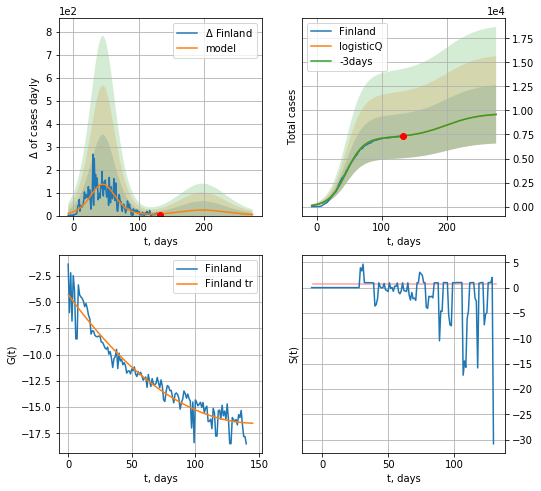

Finland data at: 2020-07-15
+3 day model MAPE: 0.001403
model: logisticQ
coeffs: [ 7.17370853e+03  3.15034930e-07  4.55270704e+01 -2.40726734e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.316008
forecast at the end of period: +143 days
	 deltaDaycases: 4
	 total cases: 9589 ± 3030
	 total death: 431 ± 408
trend coefficient of determination: 0.925473
 intercept_: -4.28627326077407
 coeffs_: [ 0.         -0.16596036  0.00056265]


In [302]:
x = forecastRRR("Finland",dfFI[:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

BL
           date  cases  active  death
123 2020-07-11   7175  3597.0  267.0
124 2020-07-12   7252  3665.0  268.0
125 2020-07-13   7411  3618.0  276.0
126 2020-07-14   7645  3699.0  283.0
127 2020-07-15   7877  3747.0  289.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


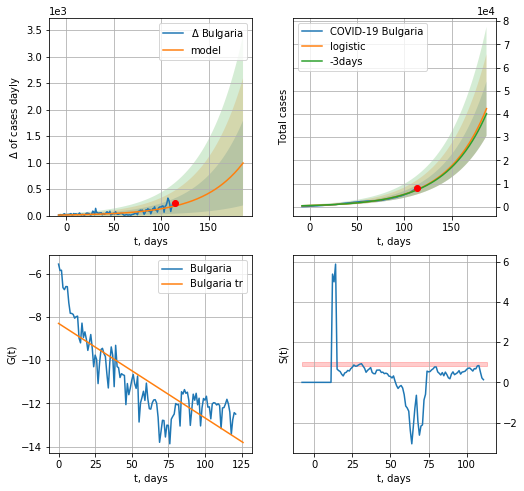

Bulgaria data at: 2020-07-15
+3 day model MAPE: 0.01889752589223738
model: logistic
coeffs:  [8.73285514e+06 2.38404120e-02 4.10396997e+02]
scenario coeffs:  [0.25, 1.0, 3.5]
rational stdev:  0.2778730147030554
forecast at the end of period: +73 days
	 deltaDaycases:  991
	 total cases:  42271 ± 11746
	 total death:  1550 ± 1292
trend coefficient of determination: 0.687104
 intercept: -8.303660
 slope: -0.043688


In [303]:
dfBL = read_df(pd.DataFrame(),"BL").fillna(0)
try:
    x = forecast('Bulgaria',dfBL[5:],d1,26*7-dT,shift=1.0,addpred=True,xcoef=[0.25,1.,3.5])
except:
    print("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


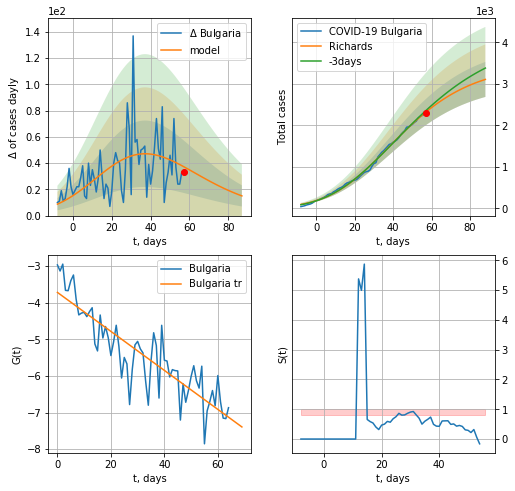

Bulgaria data at: 2020-07-15
+3 day model MAPE: 0.017234
model: Richards
coeffs: [3.47700933e+03 1.26494372e-01 1.24703961e+01 3.39631762e-01]
rational stdev: 0.135837
forecast at the end of period: +31 days
	 deltaDaycases: 15
	 total cases: 3106 ± 422
	 total death: 113 ± 46
trend coefficient of determination: 0.758376
 intercept: -3.716230
 slope: -0.053312


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


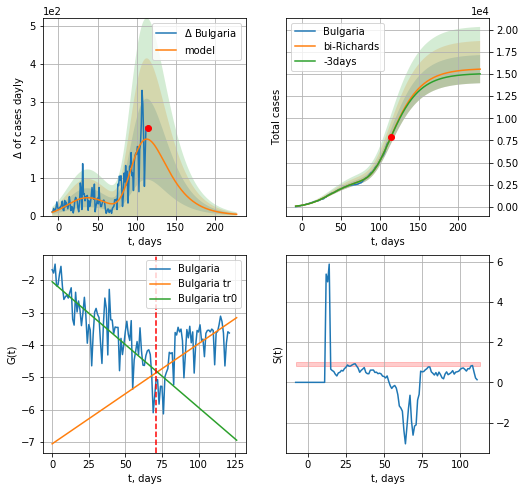

Bulgaria data at: 2020-07-15
+3 day model MAPE: 0.004393
model: bi-Richards
coeffs: [1.21312905e+04 3.66525233e+00 1.41289941e+01 1.20659354e-02]
rational stdev: 0.102180
forecast at the end of period: +115 days
	 deltaDaycases: 3
	 total cases: 15532 ± 1587
	 total death: 569 ± 174
bi-Richards approximation splitting point: 71
trend coefficient of determination: 0.674237
 intercept: -2.048751
 slope: -0.038883
trend coefficient of determination: 0.408150
 intercept: -7.059947
 slope: 0.030955


In [304]:
vL = 71+5
x = forecastRR('Bulgaria',dfBL[5:vL-5],d1,20*7-dT,shift=1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Bulgaria',dfBL[5:],d1,32*7-dT,x,shift=1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


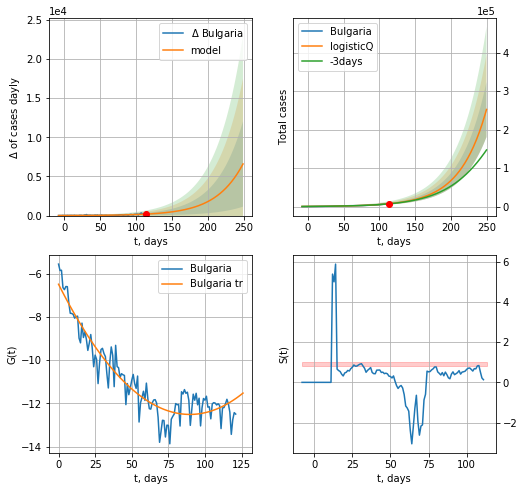

Bulgaria data at: 2020-07-15
+3 day model MAPE: 0.026343
model: logisticQ
coeffs: [ 5.84695609e+06  1.08579883e-05  3.57571141e+02 -2.40293469e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.283147
forecast at the end of period: +136 days
	 deltaDaycases: 6587
	 total cases: 252373 ± 71458
	 total death: 9259 ± 7864
trend coefficient of determination: 0.887147
 intercept_: -6.492769333324565
 coeffs_: [ 0.         -0.13423393  0.00074832]


In [305]:
x = forecastRRR('Bulgaria',dfBL[5:],d1,35*7-dT,shift=1.0,addpred=True,xcoef=koreaCoeffs)

TH
           date   cases  active  death
135 2020-07-11  3217.0    71.0   58.0
136 2020-07-12  3220.0    72.0   58.0
137 2020-07-13  3227.0    78.0   58.0
138 2020-07-14  3232.0    82.0   58.0
139 2020-07-15  3236.0    83.0   58.0


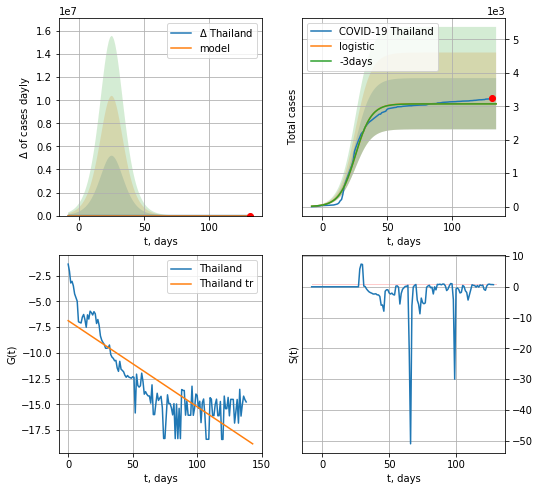

Thailand data at: 2020-07-15
+3 day model MAPE: 0.0019503125394223055
model: logistic
coeffs:  [3.07906035e+03 1.62428249e-01 2.57107913e+01]
rational stdev:  0.24870302833583827
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  3079 ± 765
	 total death:  55 ± 41
trend coefficient of determination: 0.705910
 intercept: -6.880527
 slope: -0.083671


In [306]:
dfTH = read_df(pd.DataFrame(),"TH")
dfTH = dfTH.fillna(0)
try:
    x = forecast("Thailand",dfTH[:],d1,16*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])
except:
    print("Exception occurs")
#xx = forecast2("Thailand",dfTH[:],d1,8*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

In [307]:
#x = forecastRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


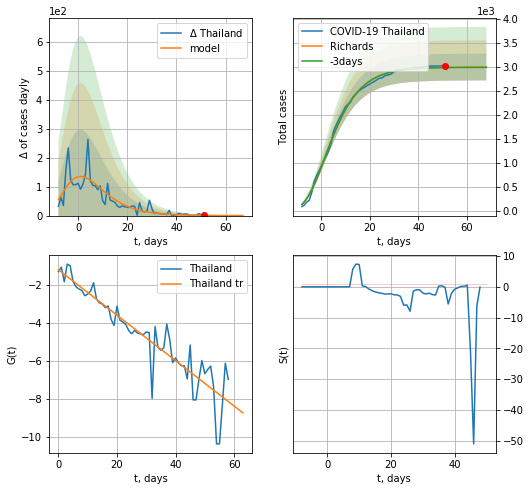

Thailand data at: 2020-07-15
+3 day model MAPE: 0.001961
model: Richards
coeffs: [ 2.99626186e+03  1.57389308e+01 -3.79335147e+01  7.82164356e-03]
rational stdev: 0.093313
forecast at the end of period: +17 days
	 deltaDaycases: 0
	 total cases: 2995 ± 279
	 total death: 53 ± 14
trend coefficient of determination: 0.845848
 intercept: -1.208266
 slope: -0.119672


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


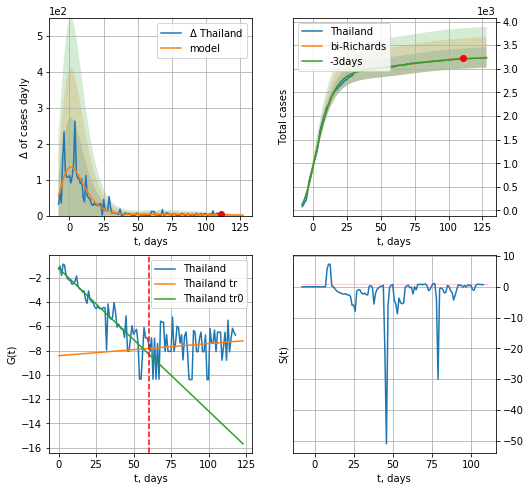

Thailand data at: 2020-07-15
+3 day model MAPE: 0.002143
model: bi-Richards
coeffs: [ 2.74816906e+02  8.53004172e+00 -7.48639190e+01  4.38323951e-03]
rational stdev: 0.066523
forecast at the end of period: +17 days
	 deltaDaycases: 1
	 total cases: 3241 ± 215
	 total death: 58 ± 11
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.843098
 intercept: -1.226228
 slope: -0.117452
trend coefficient of determination: 0.014378
 intercept: -8.425142
 slope: 0.009948


In [308]:
vL = 80
x = forecastRR("Thailand",dfTH[20:vL],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Thailand",dfTH[20:],d1,18*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


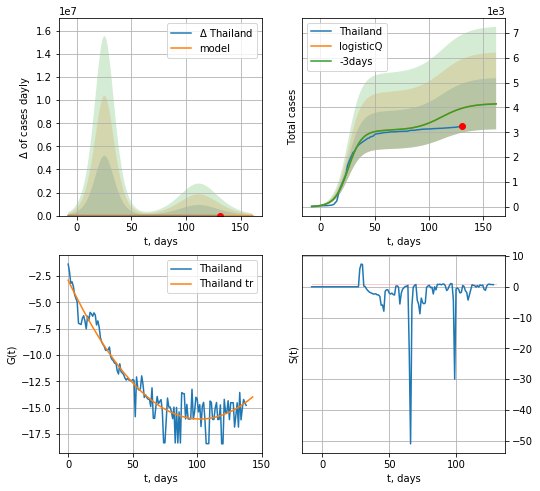

Thailand data at: 2020-07-15
+3 day model MAPE: 0.001024
model: logisticQ
coeffs: [ 3.07905688e+03  5.15898710e-07  2.57110096e+01 -3.14703947e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.248876
forecast at the end of period: +31 days
	 deltaDaycases: 1
	 total cases: 4151 ± 1033
	 total death: 74 ± 55
trend coefficient of determination: 0.911699
 intercept_: -2.914261480615842
 coeffs_: [ 0.         -0.25737799  0.00125876]


In [309]:
x = forecastRRR("Thailand",dfTH[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

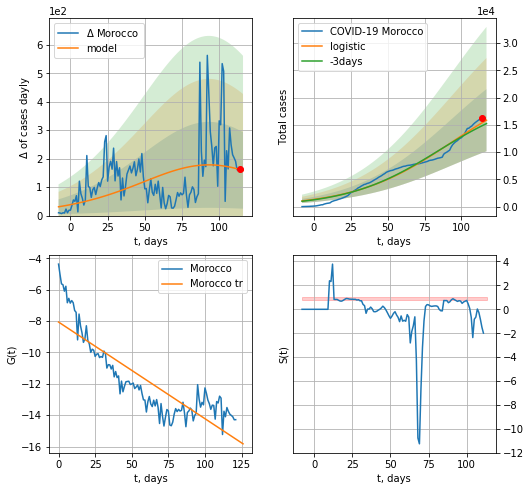

Morocco data at: 2020-07-15
+3 day model MAPE: 0.03793372886075473
model: logistic
coeffs:  [2.36657698e+04 3.01265553e-02 9.35440565e+01]
rational stdev:  0.359444603980071
forecast at the end of period: +3 days
	 deltaDaycases:  158
	 total cases:  15848 ± 5696
	 total death:  252 ± 271
trend coefficient of determination: 0.742550
 intercept: -8.058495
 slope: -0.061661


In [310]:
x = forecast("Morocco",dfMR[5:],d1,16*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


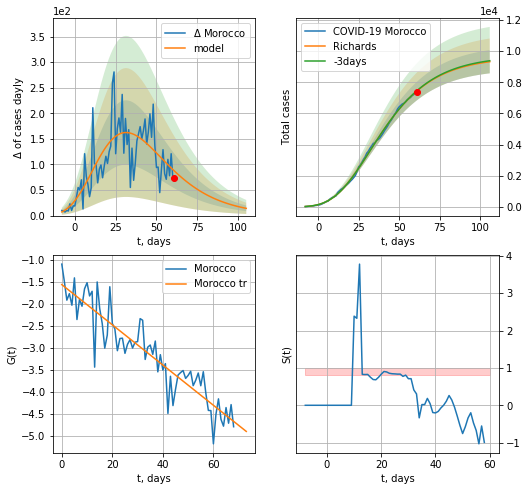

Morocco data at: 2020-07-15
+3 day model MAPE: 0.002855
model: Richards
coeffs: [ 9.62196675e+03  2.25668236e+00 -5.19496574e+01  2.05516980e-02]
rational stdev: 0.079909
forecast at the end of period: +45 days
	 deltaDaycases: 14
	 total cases: 9318 ± 744
	 total death: 148 ± 35
trend coefficient of determination: 0.846109
 intercept: -1.563197
 slope: -0.045646


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


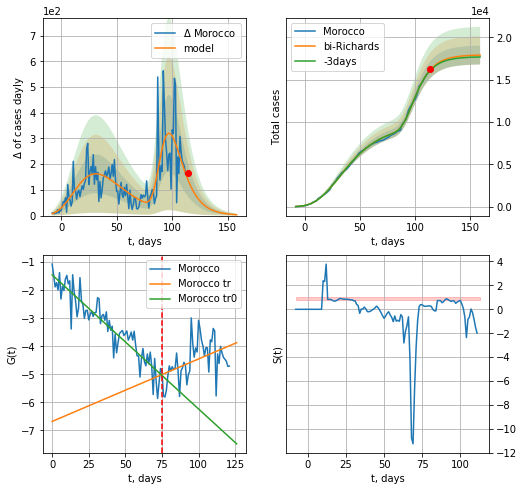

Morocco data at: 2020-07-15
+3 day model MAPE: 0.005479
model: bi-Richards
coeffs: [8.35123193e+03 8.48274642e+00 5.26316079e+01 1.15929657e-02]
rational stdev: 0.061837
forecast at the end of period: +45 days
	 deltaDaycases: 3
	 total cases: 17926 ± 1108
	 total death: 285 ± 52
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.861063
 intercept: -1.453832
 slope: -0.047825
trend coefficient of determination: 0.197411
 intercept: -6.680802
 slope: 0.022291


In [311]:
vL = 75 + 5
x = forecastRR("Morocco",dfMR[5:vL-5],d1,22*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Morocco",dfMR[5:],d1,22*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


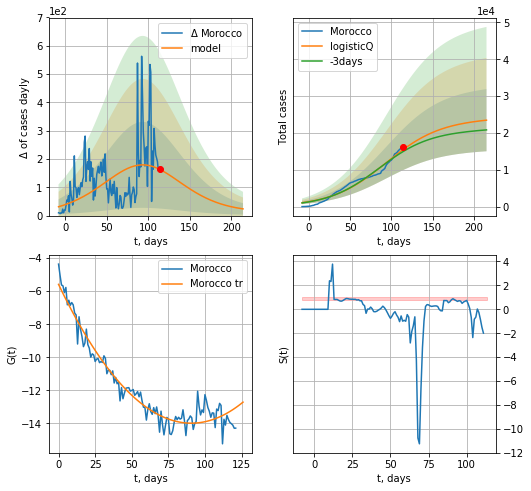

Morocco data at: 2020-07-15
+3 day model MAPE: 0.036321
model: logisticQ
coeffs: [ 2.36413130e+04  1.78142674e-07  9.34733741e+01 -1.69124224e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.359393
forecast at the end of period: +101 days
	 deltaDaycases: 23
	 total cases: 23481 ± 8439
	 total death: 373 ± 402
trend coefficient of determination: 0.944542
 intercept_: -5.587907086856085
 coeffs_: [ 0.         -0.18519321  0.00102093]


In [312]:
x = forecastRRR("Morocco",dfMR[5:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

RM
           date    cases   active   death
136 2020-07-11  32079.0   8794.0  1871.0
137 2020-07-12  32535.0   9106.0  1884.0
138 2020-07-13  32948.0   9355.0  1901.0
139 2020-07-14  33585.0   9851.0  1931.0
140 2020-07-15  34226.0  10225.0  1952.0


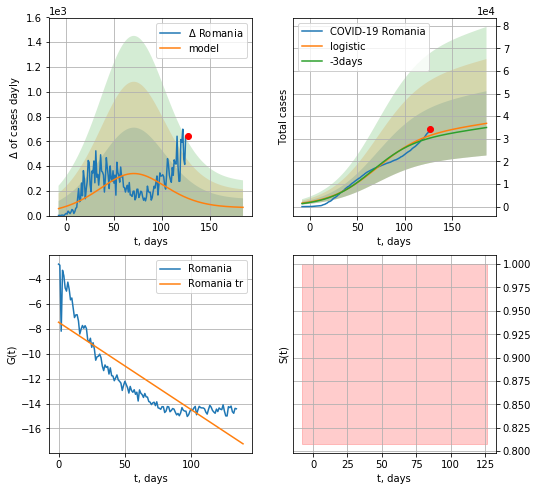

Romania data at: 2020-07-15
+3 day model MAPE: 0.03820096837478228
model: logistic
coeffs:  [3.27996117e+04 3.99168045e-02 7.03677291e+01]
scenario coeffs:  [0.35, 0.5, 3, 1]
rational stdev:  0.3861474193693653
forecast at the end of period: +59 days
	 deltaDaycases:  66
	 total cases:  36809 ± 14213
	 total death:  2099 ± 2431
trend coefficient of determination: 0.747316
 intercept: -7.469297
 slope: -0.070246


In [313]:
dfRM = read_df(pd.DataFrame(),"RM")
x = forecast("Romania",dfRM[5:],d1,24*7-dT,addpred=True,xcoef=[0.35,.5,3,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


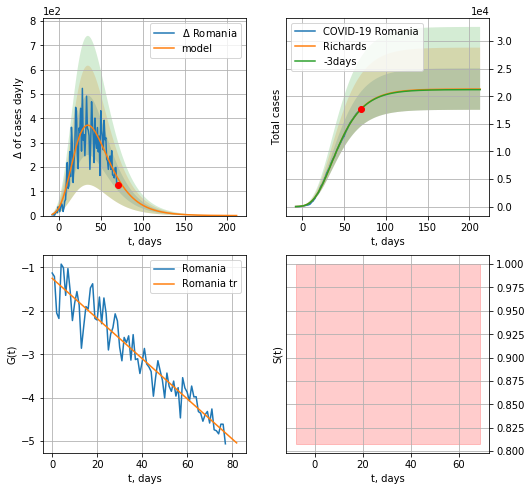

Romania data at: 2020-07-15
+3 day model MAPE: 0.002257
model: Richards
coeffs: [ 2.13025472e+04  3.80217834e+00 -5.67257576e+01  1.25517845e-02]
rational stdev: 0.176275
forecast at the end of period: +143 days
	 deltaDaycases: 0
	 total cases: 21298 ± 3754
	 total death: 1214 ± 641
trend coefficient of determination: 0.908515
 intercept: -1.251895
 slope: -0.046188


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


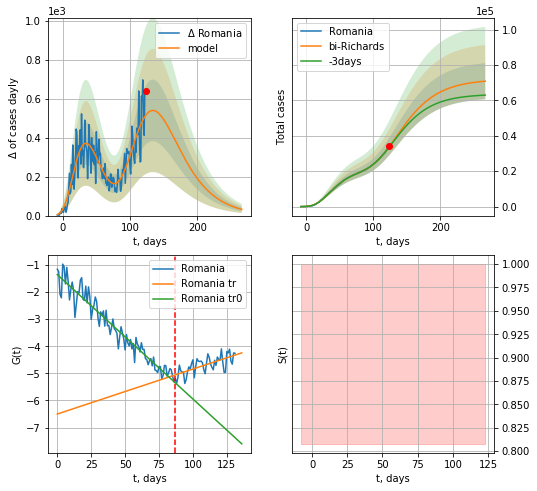

Romania data at: 2020-07-15
+3 day model MAPE: 0.007584
model: bi-Richards
coeffs: [5.06574593e+04 1.07326803e+00 1.04750989e+01 2.69727753e-02]
rational stdev: 0.144293
forecast at the end of period: +143 days
	 deltaDaycases: 32
	 total cases: 70853 ± 10223
	 total death: 4040 ± 1748
bi-Richards approximation splitting point: 87
trend coefficient of determination: 0.927382
 intercept: -1.361076
 slope: -0.045849
trend coefficient of determination: 0.450690
 intercept: -6.498550
 slope: 0.016582


In [314]:
vL = 87+8
x = forecastRR("Romania",dfRM[8:vL-8],d1,36*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Romania",dfRM[8:],d1,36*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL = vL-8)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


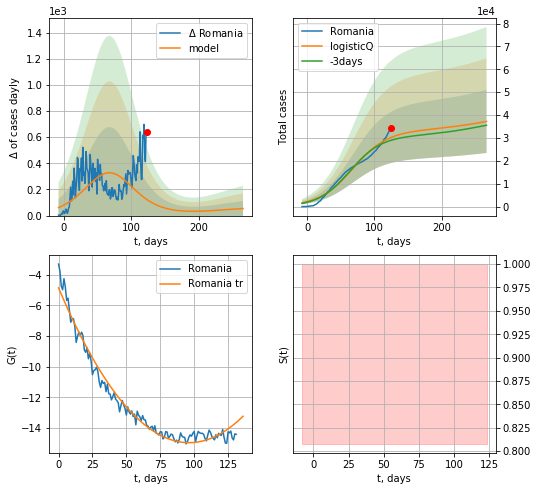

Romania data at: 2020-07-15
+3 day model MAPE: 0.043177
model: logisticQ
coeffs: [ 3.29744220e+04  1.00540376e-07  6.77065543e+01 -3.92888832e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.369979
forecast at the end of period: +143 days
	 deltaDaycases: 54
	 total cases: 37211 ± 13767
	 total death: 2122 ± 2355
trend coefficient of determination: 0.973818
 intercept_: -4.849598014193135
 coeffs_: [ 0.         -0.21021584  0.00109217]


In [315]:
xx = forecastRRR("Romania",dfRM[8:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

In [316]:
#x = forecastRRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.35/4,.5,2.2,1])

EU
           date    cases  active     death
154 2020-07-11  1331032  165409  134397.0
155 2020-07-12  1332684  166013  134430.0
156 2020-07-13  1339538  167595  134521.0
157 2020-07-14  1342807  167839  134617.0
158 2020-07-15  1348030  167965  134801.0


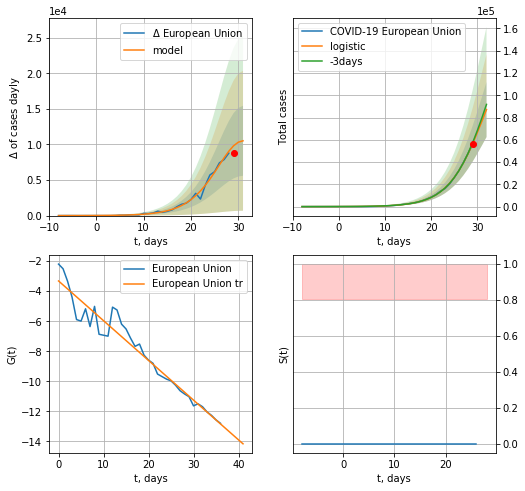

European Union data at: 2020-07-15
+3 day model MAPE: 0.026537291805373914
model: logistic
coeffs:  [1.65818576e+05 2.54045102e-01 3.15946527e+01]
rational stdev:  0.28380142507641165
forecast at the end of period: +3 days
	 deltaDaycases:  10515
	 total cases:  87174 ± 24740
	 total death:  8717 ± 7421
trend coefficient of determination: 0.942451
 intercept: -3.318380
 slope: -0.264437


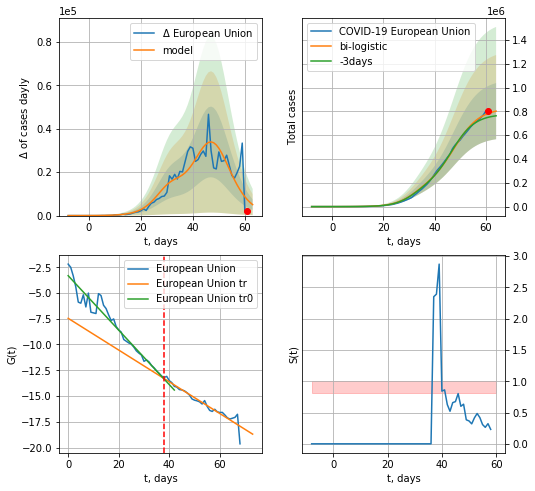

European Union data at: 2020-07-15
+3 day model MAPE: 0.046518861456193536
model: bi-logistic
coeffs:  [6.59401208e+05 2.01830792e-01 4.76685424e+01] [1.65818576e+05 2.54045102e-01 3.15946527e+01]
rational stdev:  0.2940888577461115
forecast at the end of period: +3 days
	 deltaDaycases:  5049
	 total cases:  801633 ± 235751
	 total death:  80162 ± 70724
bi-logistic approximation splitting point: 38
trend0 coefficient of determination: 0.946588
 intercept: -3.319965
 slope: -0.264305
trend coefficient of determination: 0.919570
 intercept: -7.459861
 slope: -0.154008


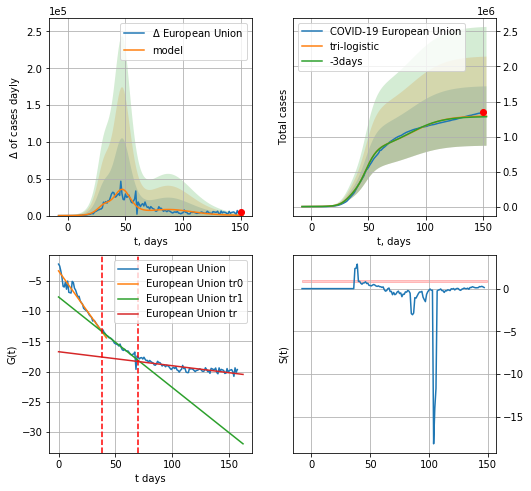

European Union data at: 2020-07-15
+3 day model MAPE: 0.007936058869689783
model: tri-logistic
coeffs:  [4.72449455e+05 6.98890942e-02 8.79131079e+01] [1.65818576e+05 2.54045102e-01 3.15946527e+01 6.59401208e+05
 2.01830792e-01 4.76685424e+01]
forecast rational stdev:  0.3280200822922956
forecast at the end of period: +3 days
	 deltaDaycases:  354
	 total cases:  1292723 ± 424039
	 total death:  129270 ± 127209
tri-logistic approximation splitting points: 38,70
trend0 coefficient of determination: 0.946588
 intercept: -3.319965
 slope: -0.264305
trend1 coefficient of determination: 0.917507
 intercept: -7.641441
 slope: -0.150225
trend coefficient of determination: 0.670180
 intercept: -16.715596
 slope: -0.023221


In [317]:
vL=38
vL1=70
dfEU = read_df(pd.DataFrame(),"EU")
x = forecast("European Union",dfEU[:vL],d1,16*7-dT)
xx = forecast2("European Union",dfEU[:vL1],d1,16*7-dT,x,vL=38,addpred=False,xcoef=[0.25,1.,1.5])
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("European Union",dfEU,d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


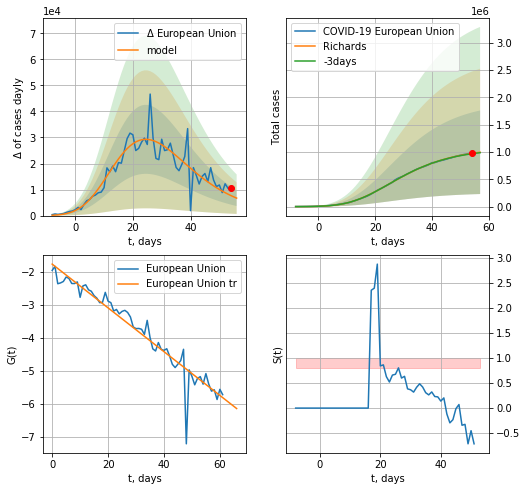

European Union data at: 2020-07-15
+3 day model MAPE: 0.007559
model: Richards
coeffs: [ 1.08235898e+06  8.91256786e-01 -6.99260106e+00  8.61059421e-02]
rational stdev: 0.768581
forecast at the end of period: +3 days
	 deltaDaycases: 6707
	 total cases: 993935 ± 763919
	 total death: 99392 ± 229172
trend coefficient of determination: 0.920526
 intercept: -1.769267
 slope: -0.066303


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


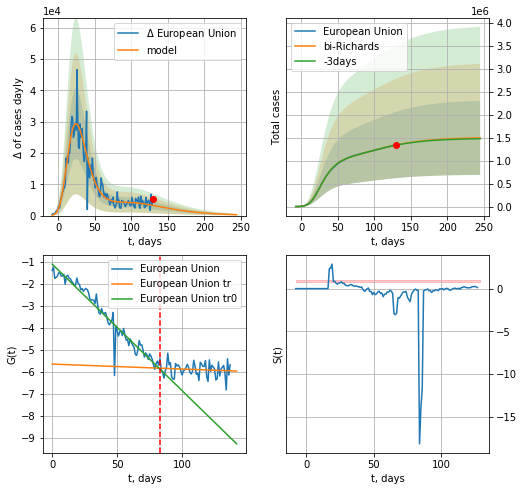

European Union data at: 2020-07-15
+3 day model MAPE: 0.002446
model: bi-Richards
coeffs: [ 4.23983382e+05  2.61978678e+00 -8.04506731e+01  9.68843826e-03]
rational stdev: 0.538210
forecast at the end of period: +115 days
	 deltaDaycases: 283
	 total cases: 1495179 ± 804720
	 total death: 149515 ± 241411
bi-Richards approximation splitting point: 83
trend coefficient of determination: 0.943508
 intercept: -1.117320
 slope: -0.057441
trend coefficient of determination: 0.012791
 intercept: -5.655004
 slope: -0.002242


In [318]:
vL = 83+20
x = forecastRR("European Union",dfEU[20:vL-20],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("European Union",dfEU[20:],d1,32*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


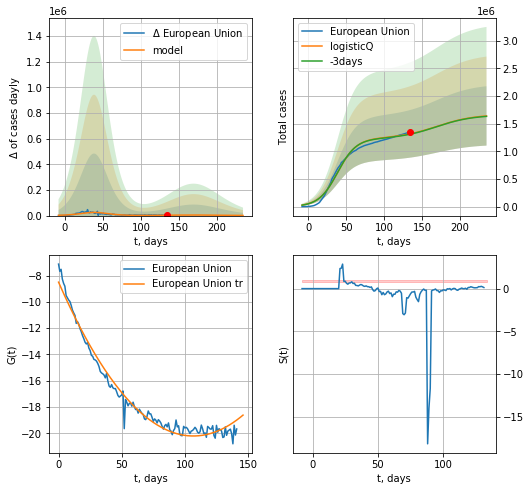

European Union data at: 2020-07-15
+3 day model MAPE: 0.005128
model: logisticQ
coeffs: [ 1.23262667e+06  1.48782843e-07  3.89155290e+01 -5.41556960e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.327144
forecast at the end of period: +101 days
	 deltaDaycases: 1109
	 total cases: 1640394 ± 536644
	 total death: 164037 ± 160990
trend coefficient of determination: 0.977445
 intercept_: -8.498115314887656
 coeffs_: [ 0.         -0.21935657  0.00102797]


In [319]:
x = forecastRRR("European Union",dfEU[16:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

In [320]:
#x = forecastQR("European Union",dfEU[20:],d1,16*7-dT,addpred=True,xcoef=QRkoreaCoeffs)

In [309]:
#x = forecastRR("Romania",dfRM[5:],d1,14*7-dT)

In [310]:
#x = forecastRRR("European Union",dfEU[:],d1,8*7-dT)

In [311]:
#x = forecastRRR("Romania",dfRM[5:],d1,18*7-dT,addpred=True,xcoef=[0.35,.5,3.,1.])

In [312]:
#dfIC[:]

IC
           date   cases  active  death
132 2020-07-11  1888.0      18   10.0
133 2020-07-12  1896.0      21   10.0
134 2020-07-13  1900.0      19   10.0
135 2020-07-14  1905.0      13   10.0
136 2020-07-15  1911.0      16   10.0


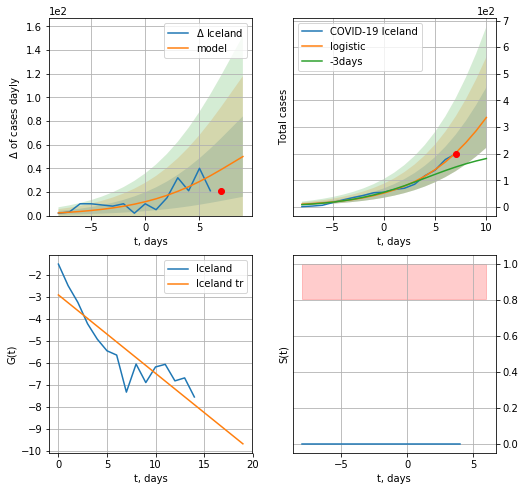

Iceland data at: 2020-07-15
+3 day model MAPE: 0.49229543132944575
model: logistic
coeffs:  [1.27194861e+03 2.12945173e-01 1.48141483e+01]
rational stdev:  0.3377978270267634
forecast at the end of period: +3 days
	 deltaDaycases:  49
	 total cases:  335 ± 113
	 total death:  1 ± 1
trend coefficient of determination: 0.778766
 intercept: -2.904405
 slope: -0.356109


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:189: RuntimeWarning: overflow encountered in exp


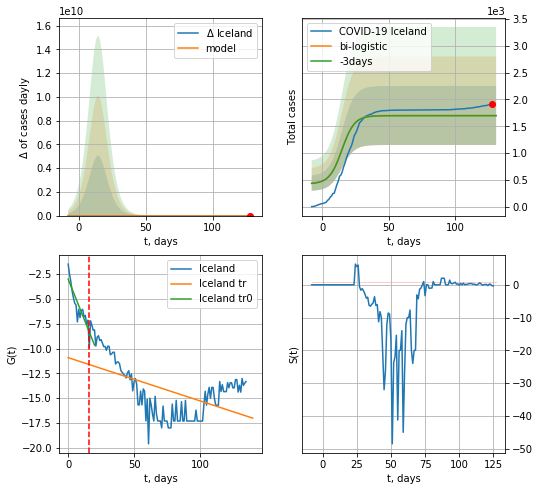

Iceland data at: 2020-07-15
+3 day model MAPE: 0.003216468690796308
model: bi-logistic
coeffs:  [404.07863043  -5.57797962 142.93659158] [1.27194861e+03 2.12945173e-01 1.48141483e+01]
scenario coeffs:  [0.0625, 1.0, 2]
rational stdev:  0.3235094876864713
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  1701 ± 550
	 total death:  8 ± 7
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.772657
 intercept: -3.017482
 slope: -0.331878
trend coefficient of determination: 0.288677
 intercept: -10.919614
 slope: -0.043473


In [321]:
dfIC = read_df(pd.DataFrame(),"IC")
vL=16
try:
    x = forecast("Iceland",dfIC[:vL],d1,16*7-dT,addpred=False,xcoef=[0.25/2,1.,2])
    xx = forecast2("Iceland",dfIC[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25/4,1.,2],vL=vL)
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


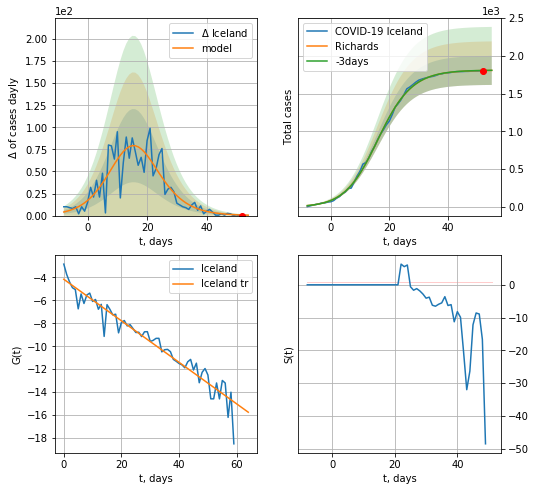

Iceland data at: 2020-07-15
+3 day model MAPE: 0.000799
model: Richards
coeffs: [1.80756044e+03 1.96284036e-01 1.50065256e+01 8.54877474e-01]
rational stdev: 0.106152
forecast at the end of period: +3 days
	 deltaDaycases: 0
	 total cases: 1804 ± 191
	 total death: 9 ± 2
trend coefficient of determination: 0.931057
 intercept: -4.161799
 slope: -0.181092


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


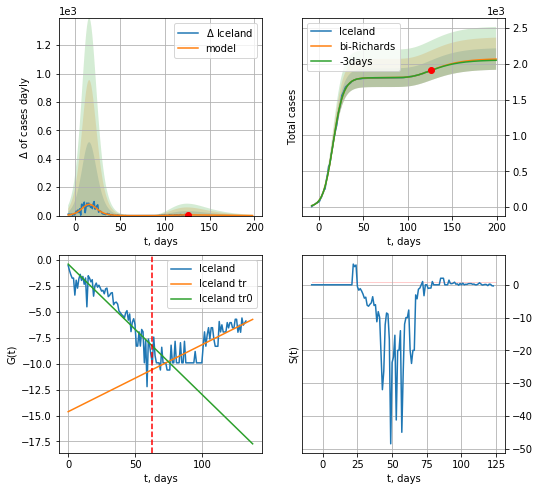

Iceland data at: 2020-07-15
+3 day model MAPE: 0.000681
model: bi-Richards
coeffs: [2.67051980e+02 3.25414909e+00 3.97770975e+01 1.50707099e-02]
rational stdev: 0.072436
forecast at the end of period: +73 days
	 deltaDaycases: 0
	 total cases: 2067 ± 149
	 total death: 10 ± 2
bi-Richards approximation splitting point: 63
trend coefficient of determination: 0.826575
 intercept: -0.381658
 slope: -0.125725
trend coefficient of determination: 0.652229
 intercept: -14.628015
 slope: 0.064556


In [322]:
vL = 63+2
x = forecastRR("Iceland",dfIC[2:vL-2],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Iceland",dfIC[2:],d1,26*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-2)
#x = forecastRRR("Iceland",dfIC[:20],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


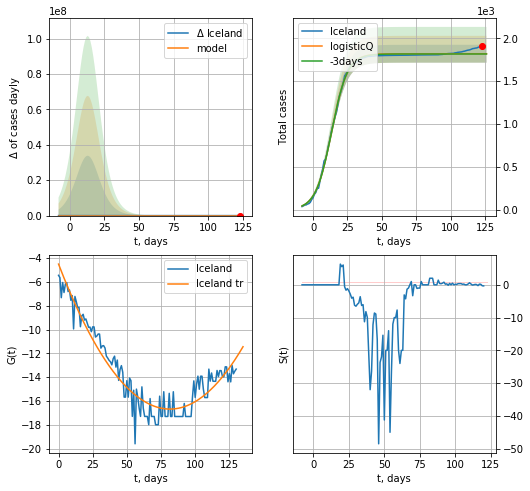

Iceland data at: 2020-07-15
+3 day model MAPE: 0.001644
model: logisticQ
coeffs: [ 1.82013507e+03  2.44970256e-06  1.34908234e+01 -7.06836226e+04]
rational stdev: 0.057361
forecast at the end of period: +3 days
	 deltaDaycases: 0
	 total cases: 1820 ± 104
	 total death: 9 ± 1
trend coefficient of determination: 0.911853
 intercept_: -4.501860301367962
 coeffs_: [ 0.         -0.29866165  0.00183164]


In [323]:
x = forecastRRR("Iceland",dfIC[5:],d1,16*7-dT,addpred=False,xcoef=[0.35/6,.5,4.,1.])

PM
           date  cases   active  death
123 2020-07-11  44332  21269.0  893.0
124 2020-07-12  45633  21685.0  909.0
125 2020-07-13  47173  22322.0  932.0
126 2020-07-14  48096  22469.0  960.0
127 2020-07-15  49243  22844.0  982.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


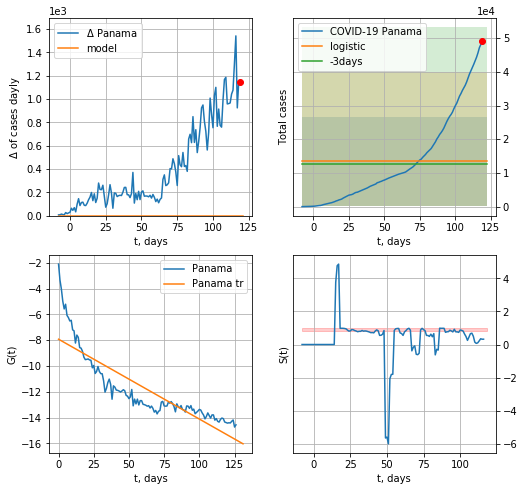

Panama data at: 2020-07-15
+3 day model MAPE: 0.0664674126146548
model: logistic
coeffs:  [ 1.33923906e+04 -1.11917065e+01  2.93468681e+02]
rational stdev:  0.9938460546605559
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  13392 ± 13309
	 total death:  267 ± 796
trend coefficient of determination: 0.744024
 intercept: -7.922899
 slope: -0.061918


In [324]:
dfPM = read_df(pd.DataFrame(),"PM").fillna(0)
x = forecast("Panama",dfPM[:],d1,16*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


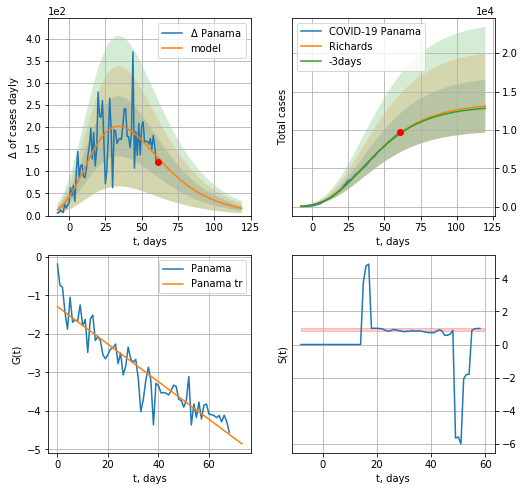

Panama data at: 2020-07-15
+3 day model MAPE: 0.008184
model: Richards
coeffs: [ 1.34885246e+04  2.34173945e+00 -6.38327516e+01  1.75366113e-02]
rational stdev: 0.263123
forecast at the end of period: +59 days
	 deltaDaycases: 16
	 total cases: 13089 ± 3444
	 total death: 261 ± 206
trend coefficient of determination: 0.871686
 intercept: -1.291480
 slope: -0.048815


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


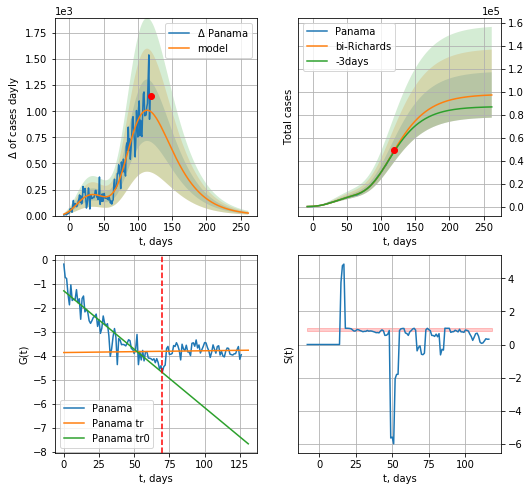

Panama data at: 2020-07-15
+3 day model MAPE: 0.017442
model: bi-Richards
coeffs: [ 8.44351835e+04  1.77770049e+00 -9.95299776e+00  1.80938414e-02]
rational stdev: 0.203323
forecast at the end of period: +143 days
	 deltaDaycases: 24
	 total cases: 97184 ± 19759
	 total death: 1938 ± 1182
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.874475
 intercept: -1.300998
 slope: -0.048557
trend coefficient of determination: 0.002226
 intercept: -3.866113
 slope: 0.000732


In [325]:
vL = 70
x = forecastRR("Panama",dfPM[:vL],d1,24*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Panama",dfPM[:],d1,36*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


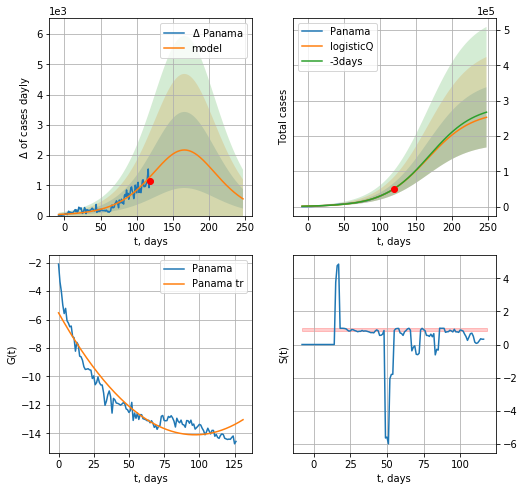

Panama data at: 2020-07-15
+3 day model MAPE: 0.002676
model: logisticQ
coeffs: [ 2.70869195e+05  3.42214626e-06  1.65988559e+02 -9.18992559e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.337504
forecast at the end of period: +129 days
	 deltaDaycases: 552
	 total cases: 253026 ± 85397
	 total death: 5045 ± 5108
trend coefficient of determination: 0.918057
 intercept_: -5.525731628141747
 coeffs_: [ 0.         -0.17698462  0.00091323]


In [326]:
x = forecastRRR("Panama",dfPM[:],d1,34*7-dT,addpred=True,xcoef=koreaCoeffs)

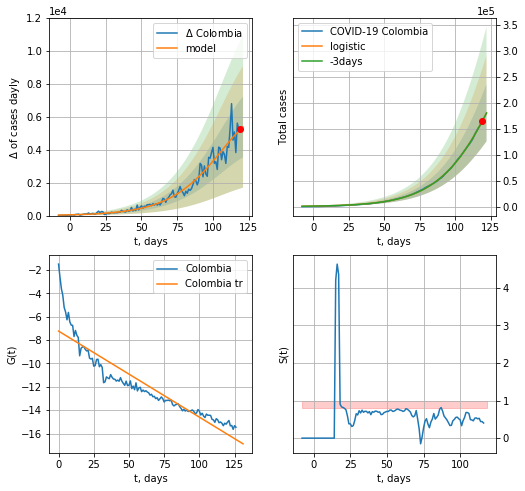

Colombia data at: 2020-07-15
+3 day model MAPE: 0.003316869834797985
model: logistic
coeffs:  [5.10392056e+05 4.64839014e-02 1.34970581e+02]
rational stdev:  0.30472978867942146
forecast at the end of period: +3 days
	 deltaDaycases:  5385
	 total cases:  180513 ± 55007
	 total death:  6354 ± 5808
trend coefficient of determination: 0.847838
 intercept: -7.235023
 slope: -0.073634


In [327]:
dfCB = dfCB.fillna(0)
x = forecast("Colombia",dfCB[:],d1,16*7-dT)

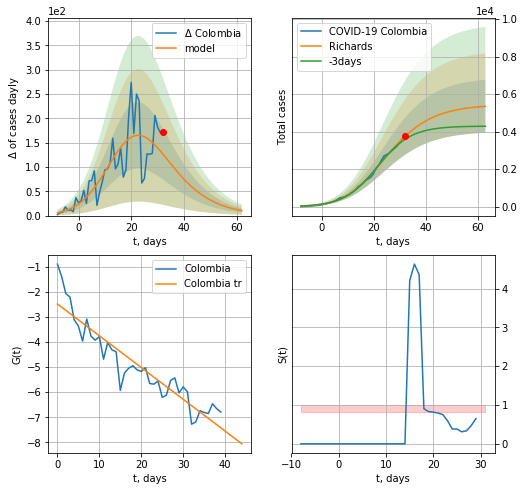

Colombia data at: 2020-07-15
+3 day model MAPE: 0.053959
model: Richards
coeffs: [5.45323700e+03 2.23852153e-01 1.50939189e+01 4.47628300e-01]
rational stdev: 0.263661
forecast at the end of period: +31 days
	 deltaDaycases: 10
	 total cases: 5354 ± 1411
	 total death: 188 ± 148
trend coefficient of determination: 0.864435
 intercept: -2.485434
 slope: -0.126591


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


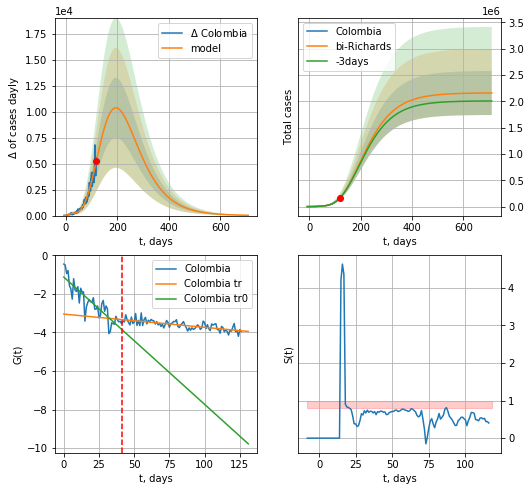

Colombia data at: 2020-07-15
+3 day model MAPE: 0.003916
model: bi-Richards
coeffs: [ 2.15565413e+06  3.15786250e-01 -4.19866722e+01  4.22809209e-02]
rational stdev: 0.193791
forecast at the end of period: +591 days
	 deltaDaycases: 29
	 total cases: 2158885 ± 418372
	 total death: 75993 ± 44180
bi-Richards approximation splitting point: 41
trend coefficient of determination: 0.765179
 intercept: -1.124498
 slope: -0.066056
trend coefficient of determination: 0.522417
 intercept: -3.046358
 slope: -0.006857


In [328]:
vL = 41
x = forecastRR("Colombia",dfCB[:vL],d1,20*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Colombia",dfCB[:],d1,100*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


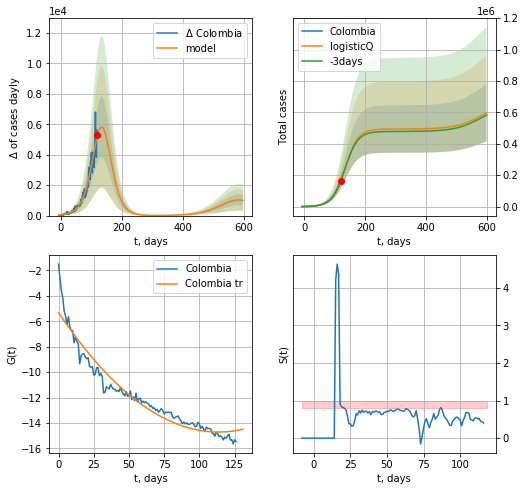

Colombia data at: 2020-07-15
+3 day model MAPE: 0.003754
model: logisticQ
coeffs: [ 4.93770865e+05  5.24478628e-06  1.33722783e+02 -8.86374477e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.305822
forecast at the end of period: +479 days
	 deltaDaycases: 996
	 total cases: 596601 ± 182453
	 total death: 21000 ± 19266
trend coefficient of determination: 0.936992
 intercept_: -5.323674401741769
 coeffs_: [ 0.         -0.16538115  0.00072816]


In [329]:
x = forecastRRR("Colombia",dfCB[:],d1,84*7-dT,addpred=True,xcoef=koreaCoeffs)

AR
           date    cases  active   death
129 2020-07-11  18712.0  4584.0  1004.0
130 2020-07-12  19195.0  4441.0  1011.0
131 2020-07-13  19689.0  4652.0  1018.0
132 2020-07-14  20216.0  4893.0  1028.0
133 2020-07-15  20770.0  4938.0  1040.0


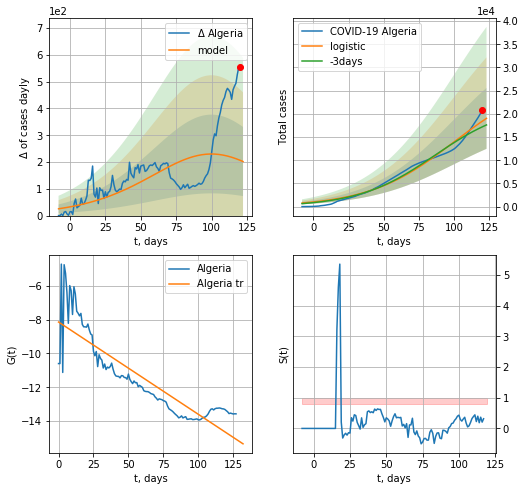

Algeria data at: 2020-07-15
+3 day model MAPE: 0.07397019241017018
model: logistic
coeffs:  [2.80524522e+04 3.27909001e-02 1.00235211e+02]
rational stdev:  0.34503426169133317
forecast at the end of period: +3 days
	 deltaDaycases:  201
	 total cases:  19031 ± 6566
	 total death:  952 ± 985
trend coefficient of determination: 0.762756
 intercept: -8.145478
 slope: -0.054457


In [330]:
dfAR = read_df(pd.DataFrame(),"AR")
dfAR = dfAR.fillna(0)
x = forecast("Algeria",dfAR[5:],d1,16*7-dT)
#dfAG

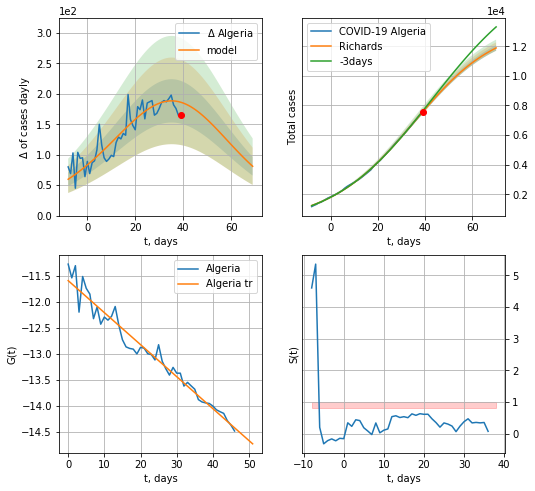

Algeria data at: 2020-07-15
+3 day model MAPE: 0.009853
model: Richards
coeffs: [1.34014708e+04 4.98947126e-02 3.86388178e+01 1.19488243e+00]
rational stdev: 0.015787
forecast at the end of period: +31 days
	 deltaDaycases: 81
	 total cases: 11886 ± 187
	 total death: 595 ± 28
trend coefficient of determination: 0.959635
 intercept: -11.589812
 slope: -0.061720


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


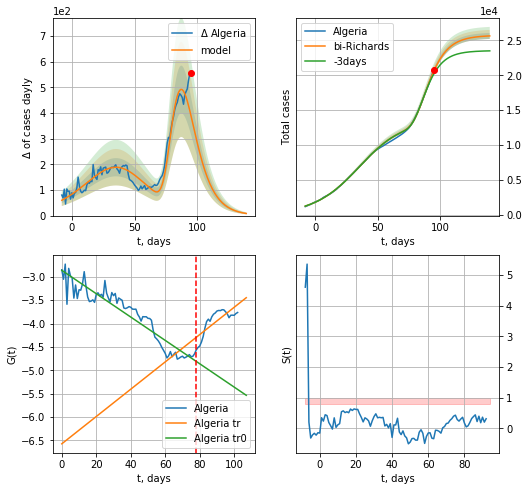

Algeria data at: 2020-07-15
+3 day model MAPE: 0.024407
model: bi-Richards
coeffs: [1.23384729e+04 7.29587307e+00 4.62371751e+01 1.39880972e-02]
rational stdev: 0.016791
forecast at the end of period: +45 days
	 deltaDaycases: 8
	 total cases: 25651 ± 430
	 total death: 1284 ± 64
bi-Richards approximation splitting point: 78
trend coefficient of determination: 0.888832
 intercept: -2.860894
 slope: -0.024998
trend coefficient of determination: 0.609657
 intercept: -6.574790
 slope: 0.029235


In [333]:
iL = 30
vL = 78+iL
x = forecastRR("Algeria",dfAR[iL:vL-iL],d1,20*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Algeria",dfAR[iL:],d1,22*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


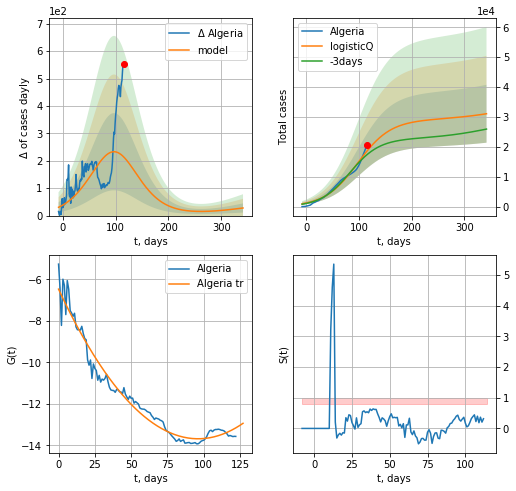

Algeria data at: 2020-07-15
+3 day model MAPE: 0.071979
model: logisticQ
coeffs: [ 2.89328397e+04  2.58123855e-07  9.72292625e+01 -1.24286583e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.311278
forecast at the end of period: +227 days
	 deltaDaycases: 27
	 total cases: 31081 ± 9675
	 total death: 1556 ± 1453
trend coefficient of determination: 0.963963
 intercept_: -6.476241819544526
 coeffs_: [ 0.         -0.14991482  0.00078001]


In [334]:
x = forecastRRR("Algeria",dfAR[10:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

IE
           date  cases   active   death
124 2020-07-11  75699  36455.0  3606.0
125 2020-07-12  76981  36636.0  3656.0
126 2020-07-13  78572  37226.0  3710.0
127 2020-07-14  80094  37247.0  3797.0
128 2020-07-15  80094  37247.0  3797.0
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


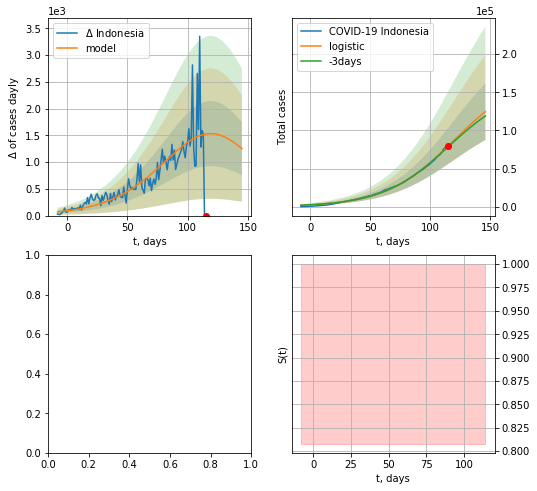

In [335]:
dfIE = read_df(pd.DataFrame(),"IE")
try:
    x = forecast("Indonesia",dfIE[5:],d1,20*7-dT)
    vL = 75+6
    x = forecastRR("Indonesia",dfIE[6:vL-6],d1,44*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RR("Indonesia",dfIE[6:],d1,44*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-6)
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:571: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

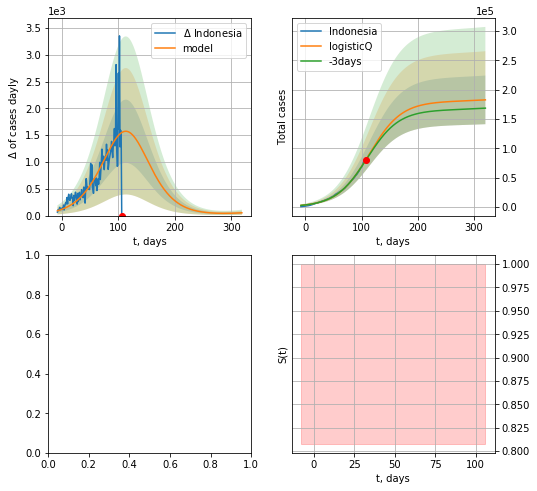

In [336]:
x = forecastRRR("Indonesia",dfIE[13:],d1,46*7-dT,addpred=True,xcoef=koreaCoeffs)

PH
           date  cases   active   death
126 2020-07-11  54222  38813.0  1372.0
127 2020-07-12  56259  38679.0  1534.0
128 2020-07-13  57006  35036.0  1599.0
129 2020-07-14  57545  35483.0  1603.0
130 2020-07-15  58850  36260.0  1614.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


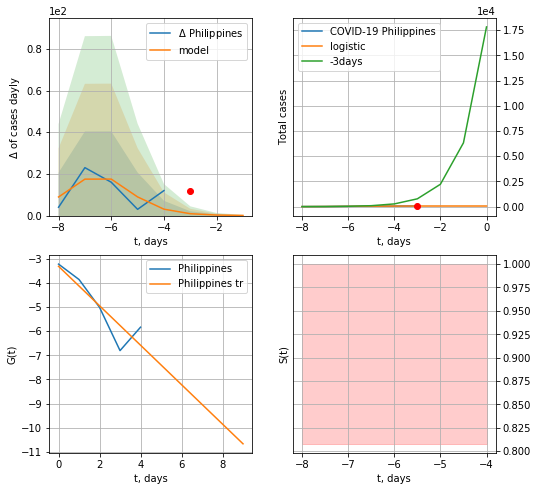

Philippines data at: 2020-07-15
+3 day model MAPE: 0.9724006736169737
model: logistic
coeffs:  [61.51692029  1.2919553  -5.99802409]
rational stdev:  0.19348550855350297
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  61 ± 11
	 total death:  1 ± 0
trend coefficient of determination: 0.794507
 intercept: -3.309972
 slope: -0.817432


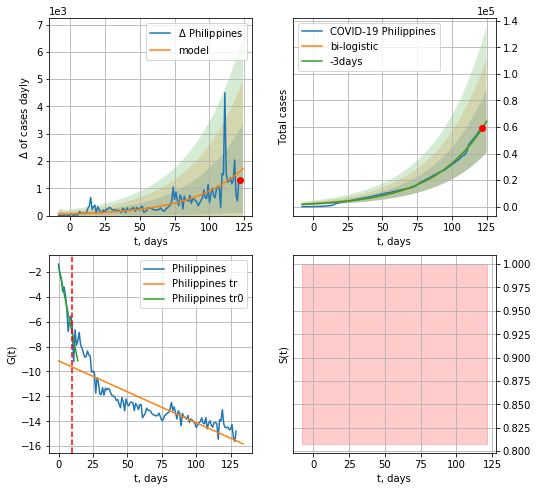

Philippines data at: 2020-07-15
+3 day model MAPE: 0.0016302903608670558
model: bi-logistic
coeffs:  [5.06255942e+06 2.75282159e-02 2.83188428e+02] [61.51692029  1.2919553  -5.99802409]
rational stdev:  0.36863108066608347
forecast at the end of period: +3 days
	 deltaDaycases:  1722
	 total cases:  64275 ± 23693
	 total death:  1762 ± 1948
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend coefficient of determination: 0.748127
 intercept: -9.151432
 slope: -0.049704


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:305: RuntimeWarning: overflow encountered in exp


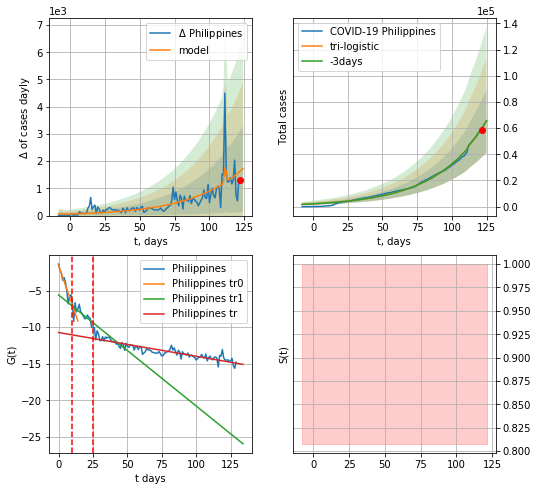

Philippines data at: 2020-07-15
+3 day model MAPE: 0.0057406432230453245
model: tri-logistic
coeffs:  [1028.04647926    2.90526244  111.85912341] [ 6.15169203e+01  1.29195530e+00 -5.99802409e+00  5.06255942e+06
  2.75282159e-02  2.83188428e+02]
forecast rational stdev:  0.3679515976385083
forecast at the end of period: +3 days
	 deltaDaycases:  1722
	 total cases:  65303 ± 24028
	 total death:  1790 ± 1975
tri-logistic approximation splitting points: 10,25
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend1 coefficient of determination: 0.474240
 intercept: -5.600607
 slope: -0.151865
trend coefficient of determination: 0.804997
 intercept: -10.736723
 slope: -0.032481


In [337]:
vL=10
vL1=25
dfPH = read_df(pd.DataFrame(),"PH")
x = forecast("Philippines",dfPH[4:vL],d1,16*7-dT,addpred=False,xcoef=[0.25,1.,2.3])
xx = forecast2("Philippines",dfPH[:],d1,16*7-dT,x,vL=vL,addpred=False,xcoef=[0.25,1.,1.8])
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Philippines",dfPH,d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


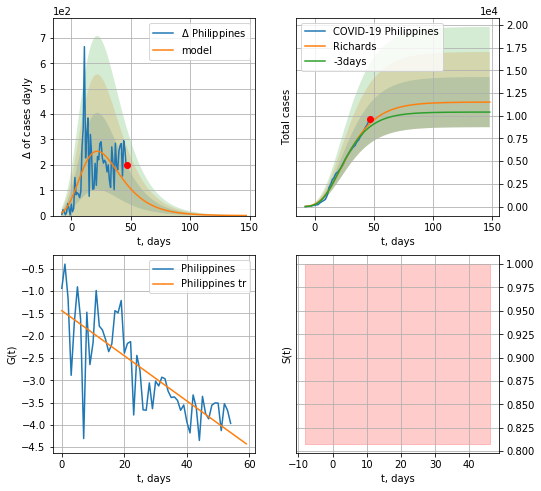

Philippines data at: 2020-07-15
+3 day model MAPE: 0.044209
model: Richards
coeffs: [ 1.15018278e+04  6.61454462e+00 -5.57256966e+01  9.11064046e-03]
rational stdev: 0.239775
forecast at the end of period: +101 days
	 deltaDaycases: 0
	 total cases: 11495 ± 2756
	 total death: 315 ± 226
trend coefficient of determination: 0.622666
 intercept: -1.437831
 slope: -0.050660


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


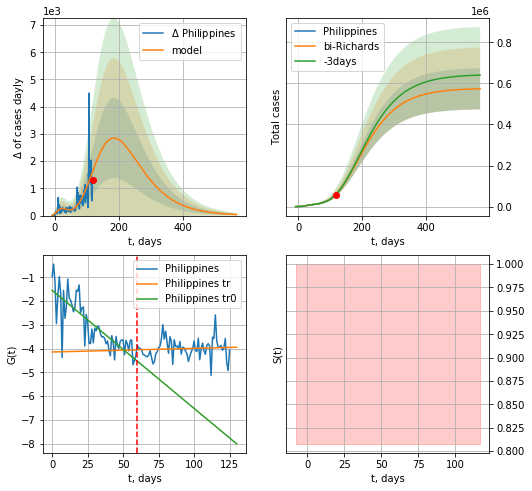

Philippines data at: 2020-07-15
+3 day model MAPE: 0.004513
model: bi-Richards
coeffs: [ 5.65234925e+05  5.93814474e-01 -8.58930068e+01  2.33442675e-02]
rational stdev: 0.174915
forecast at the end of period: +451 days
	 deltaDaycases: 38
	 total cases: 573980 ± 100398
	 total death: 15741 ± 8260
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.661762
 intercept: -1.548169
 slope: -0.049730
trend coefficient of determination: 0.005230
 intercept: -4.145730
 slope: 0.001543


In [338]:
vL = 60 + 4
x = forecastRR("Philippines",dfPH[4:vL-4],d1,30*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Philippines",dfPH[4:],d1,80*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-4)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


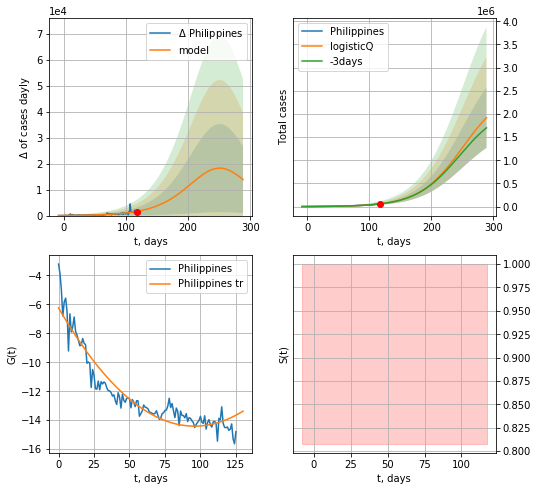

Philippines data at: 2020-07-15
+3 day model MAPE: 0.001464
model: logisticQ
coeffs: [ 2.55121776e+06  3.51468492e-06  2.50471249e+02 -7.91377242e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.340152
forecast at the end of period: +171 days
	 deltaDaycases: 13870
	 total cases: 1919232 ± 652830
	 total death: 52636 ± 53712
trend coefficient of determination: 0.895669
 intercept_: -6.241465135976064
 coeffs_: [ 0.         -0.17047795  0.00088931]


In [339]:
x = forecastRRR("Philippines",dfPH[4:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

GC
           date   cases  active  death
133 2020-07-11  3772.0    2205  193.0
134 2020-07-12  3803.0    2236  193.0
135 2020-07-13  3826.0    2259  193.0
136 2020-07-14  3883.0    2316  193.0
137 2020-07-15  3910.0    2343  193.0


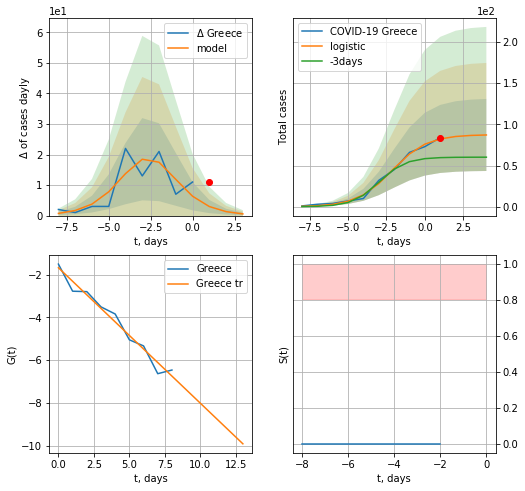

Greece data at: 2020-07-15
+3 day model MAPE: 0.42128754754463943
model: logistic
coeffs:  [87.54984336  0.87627722 -2.15069813]
rational stdev:  0.5018417290456435
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  87 ± 43
	 total death:  4 ± 6
trend coefficient of determination: 0.966991
 intercept: -1.674249
 slope: -0.634181


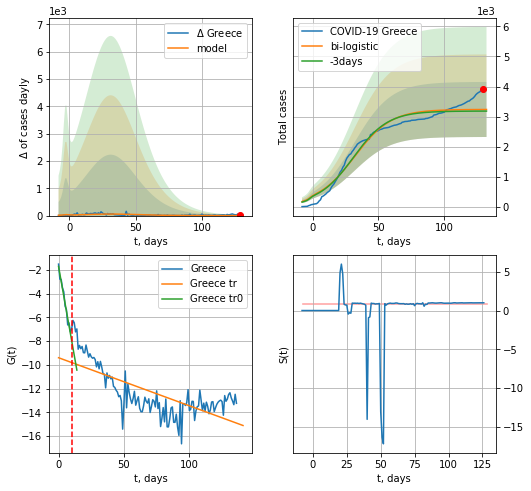

Greece data at: 2020-07-15
+3 day model MAPE: 0.01688860667098022
model: bi-logistic
coeffs:  [3.15027342e+03 7.22071379e-02 3.17634270e+01] [87.54984336  0.87627722 -2.15069813]
rational stdev:  0.28327365195955717
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  3235 ± 916
	 total death:  159 ± 135
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.974467
 intercept: -1.699561
 slope: -0.624689
trend coefficient of determination: 0.510028
 intercept: -9.401232
 slope: -0.040545


In [340]:
dfGC = read_df(pd.DataFrame(),"GC")
x = forecast("Greece",dfGC[:10],d1,16*7-dT)
xx = forecast2("Greece",dfGC[:],d1,16*7-dT,x,addpred=False,xcoef=[.25/2,1.,2.3],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


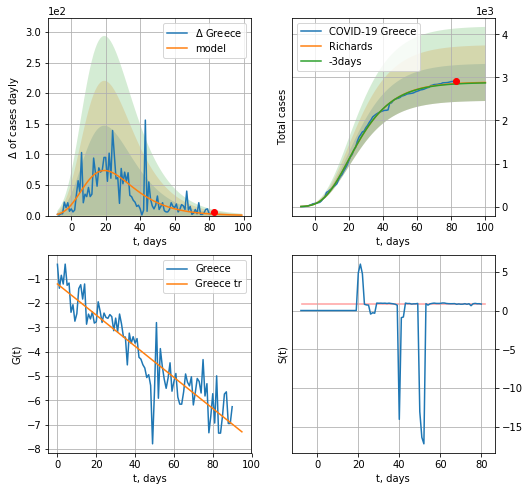

Greece data at: 2020-07-15
+3 day model MAPE: 0.003283
model: Richards
coeffs: [ 2.89327821e+03  7.32575617e+00 -4.72776749e+01  9.49188322e-03]
rational stdev: 0.149150
forecast at the end of period: +17 days
	 deltaDaycases: 0
	 total cases: 2882 ± 429
	 total death: 142 ± 63
trend coefficient of determination: 0.838381
 intercept: -1.223029
 slope: -0.063896


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


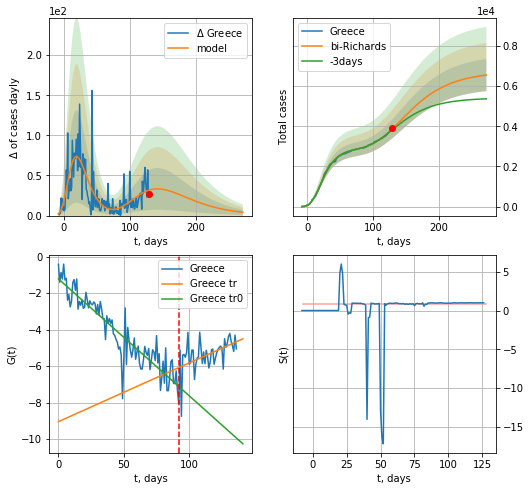

Greece data at: 2020-07-15
+3 day model MAPE: 0.013459
model: bi-Richards
coeffs: [ 3.83755877e+03  2.36163442e+00 -5.20998493e+01  1.00180128e-02]
rational stdev: 0.121948
forecast at the end of period: +143 days
	 deltaDaycases: 4
	 total cases: 6555 ± 799
	 total death: 323 ± 118
bi-Richards approximation splitting point: 92
trend coefficient of determination: 0.843516
 intercept: -1.218748
 slope: -0.064148
trend coefficient of determination: 0.235679
 intercept: -9.047500
 slope: 0.032210


In [341]:
vL = 92
x = forecastRR("Greece",dfGC[:vL],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Greece",dfGC[:],d1,36*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


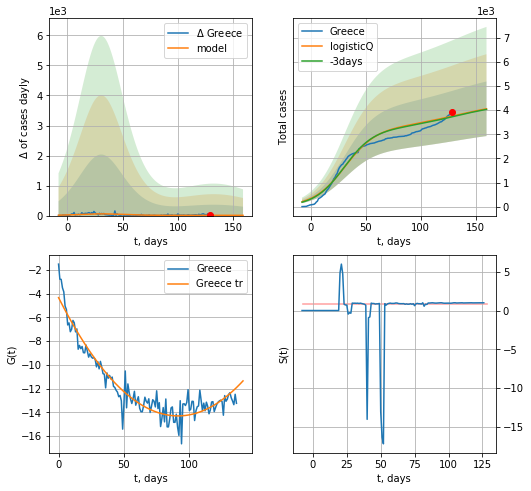

Greece data at: 2020-07-15
+3 day model MAPE: 0.007062
model: logisticQ
coeffs: [ 3.24217902e+03  8.24232864e-08  3.09313110e+01 -8.53618200e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.278911
forecast at the end of period: +31 days
	 deltaDaycases: 8
	 total cases: 4056 ± 1131
	 total death: 200 ± 167
trend coefficient of determination: 0.910613
 intercept_: -4.331009853338927
 coeffs_: [ 0.         -0.21857557  0.00119685]


In [342]:
x = forecastRRR("Greece",dfGC[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

HG
           date   cases  active  death
127 2020-07-11  4234.0     603  595.0
128 2020-07-12  4247.0     579  595.0
129 2020-07-13  4258.0     557  595.0
130 2020-07-14  4263.0     542  595.0
131 2020-07-15  4263.0     542  595.0
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


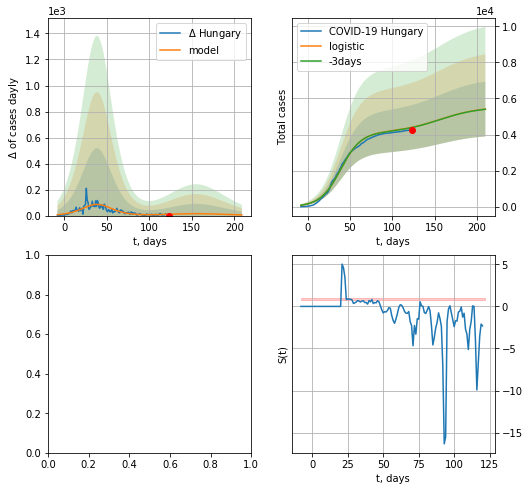

In [343]:
dfHG = read_df(pd.DataFrame(),"HG")
try:
    x = forecast("Hungary",dfHG[:],d1,28*7-dT,addpred=True,xcoef=[.35,.5,4,1])
except:
    print("Exception occurs")
#xx = forecast2("Hungary",dfHG[:],d1,4*7-dT,x,vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


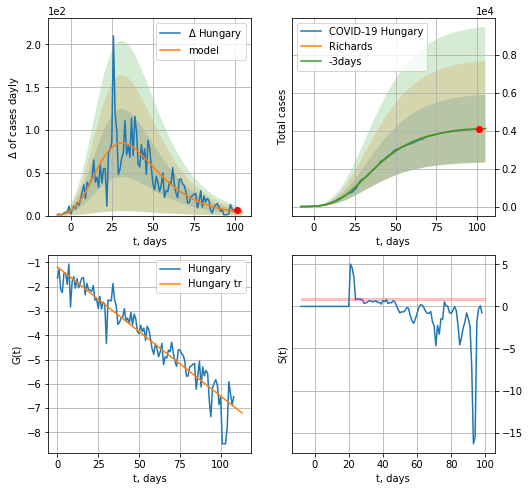

Hungary data at: 2020-07-14
+3 day model MAPE: 0.000500
model: Richards
coeffs: [ 4.19103302e+03  2.98310310e+00 -4.02179285e+01  1.85994227e-02]
rational stdev: 0.434500
forecast at the end of period: +4 days
	 deltaDaycases: 4
	 total cases: 4120 ± 1790
	 total death: 575 ± 749
trend coefficient of determination: 0.907644
 intercept: -1.183095
 slope: -0.053207


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


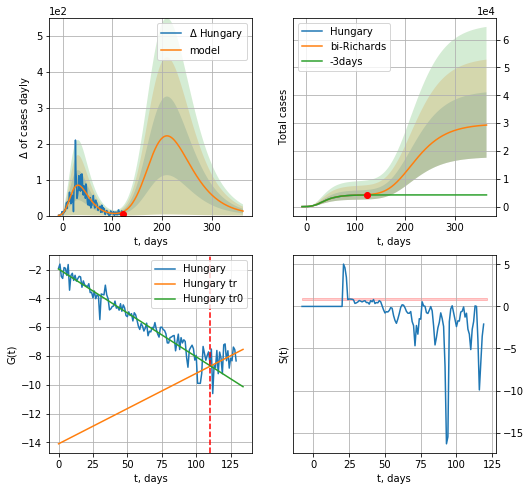

Hungary data at: 2020-07-14
+3 day model MAPE: 0.025198
model: bi-Richards
coeffs: [2.55981131e+04 1.35118660e-01 1.46183797e+02 1.90641583e-01]
rational stdev: 0.401063
forecast at the end of period: +242 days
	 deltaDaycases: 12
	 total cases: 29303 ± 11752
	 total death: 4089 ± 4919
bi-Richards approximation splitting point: 110
trend coefficient of determination: 0.933095
 intercept: -1.966236
 slope: -0.060928
trend coefficient of determination: 0.117659
 intercept: -14.095789
 slope: 0.048910


In [327]:
vL = 110
x = forecastRR("Hungary",dfHG[:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Hungary",dfHG[:],d1,50*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


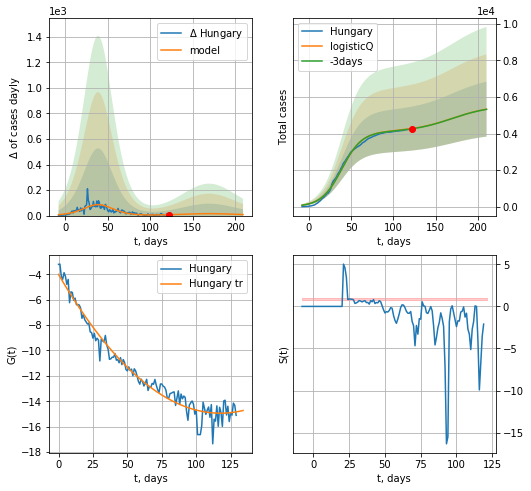

Hungary data at: 2020-07-14
+3 day model MAPE: 0.002883
model: logisticQ
coeffs: [ 4.10337001e+03  2.74757635e-07  3.88799413e+01 -3.04241125e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.281209
forecast at the end of period: +88 days
	 deltaDaycases: 8
	 total cases: 5333 ± 1499
	 total death: 744 ± 627
trend coefficient of determination: 0.963693
 intercept_: -4.014939098441918
 coeffs_: [ 0.         -0.18578043  0.0007899 ]


In [328]:
x = forecastRRR("Hungary",dfHG[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='cases')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


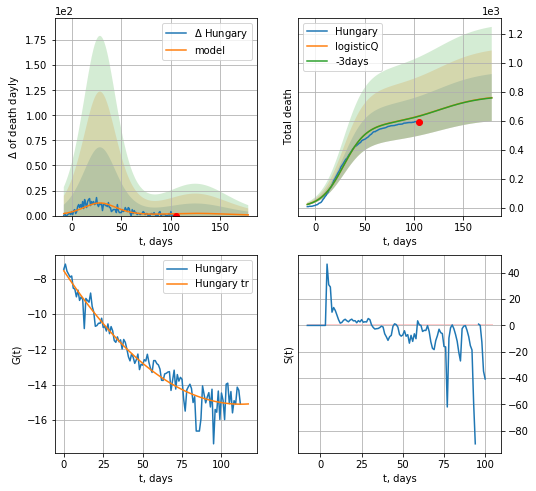

Hungary data at: 2020-07-14
+3 day model MAPE: 0.002286
model: logisticQ
coeffs: [ 5.75292835e+02  2.91799097e-07  2.87951412e+01 -2.97150729e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.214073
forecast at the end of period: +74 days
	 total death: 761 ± 162
trend coefficient of determination: 0.930675
 intercept_: -7.555547592090108
 coeffs_: [ 0.         -0.1346245   0.00060007]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: divide by zero encountered in true_divide


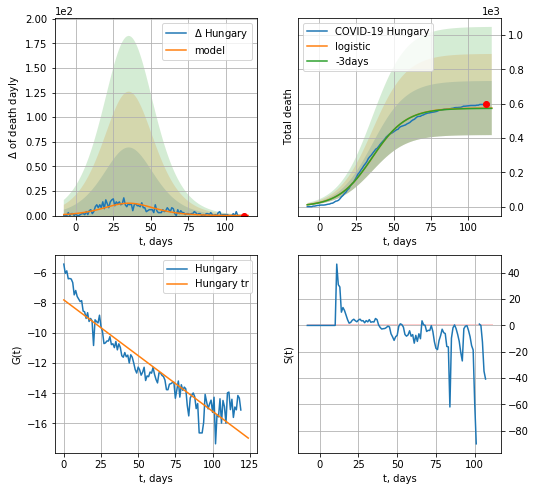

Hungary data at: 2020-07-14
+3 day model MAPE: 0.0035033419769500726
model: logistic
coeffs:  [5.74748831e+02 8.75140839e-02 3.57789542e+01]
rational stdev:  0.2739726584600369
forecast at the end of period: +4 days
	 total death:  574 ± 157
trend coefficient of determination: 0.875947
 intercept: -7.802483
 slope: -0.073919


In [329]:
x = forecastRRR("Hungary",dfHG[17:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')
x = forecast("Hungary",dfHG[10:],d1,16*7-dT,cases='death')

MT
           date  cases  active  death
125 2020-07-11  674.0       7    9.0
126 2020-07-12  674.0       5    9.0
127 2020-07-13  674.0       5    9.0
128 2020-07-14  674.0       5    9.0
129 2020-07-15  674.0       4    9.0


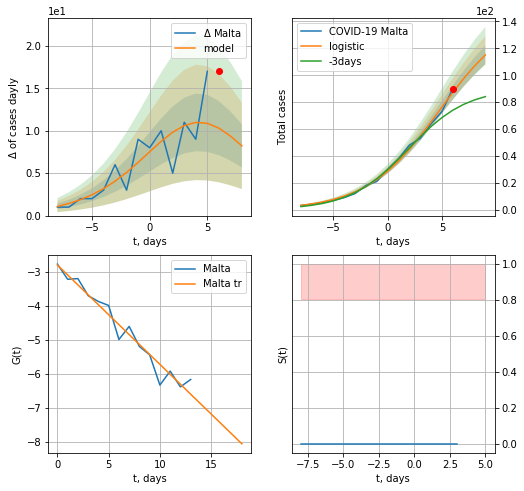

Malta data at: 2020-07-15
model: logistic
coeffs:  [147.79636191   0.29837112   4.7799048 ]
rational stdev:  0.06036954020755974
forecast at the end of period: +3 days
	 deltaDaycases:  8
	 total cases:  115 ± 6
	 total death:  1 ± 0
trend coefficient of determination: 0.952854
 intercept: -2.800130
 slope: -0.292111
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:245: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


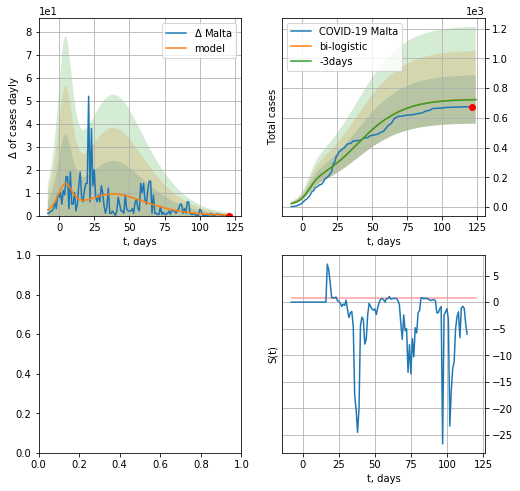

In [344]:
try:
    dfMT = read_df(pd.DataFrame(),"MT")
    x = forecast("Malta",dfMT[:15],d1,7*16-dT,pMAPE=False)
    xx = forecast2("Malta",dfMT[:],d1,7*16-dT,x,vL=15,addpred=True,xcoef=[0.25/2,1.,1.8])
except:
    print("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


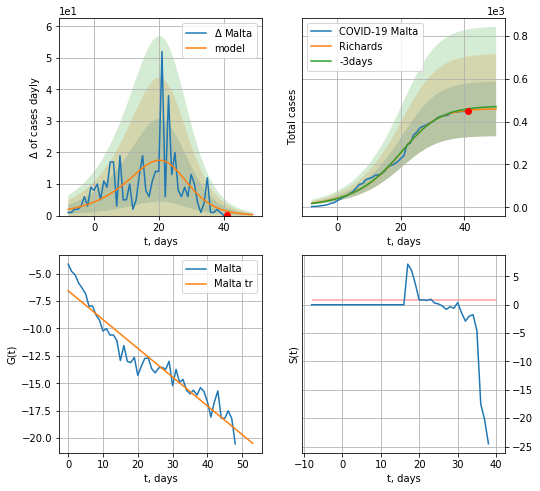

Malta data at: 2020-07-09
+3 day model MAPE: 0.016229
model: Richards
coeffs: [4.60753453e+02 9.94315746e-02 2.41437164e+01 1.98427317e+00]
rational stdev: 0.277865
forecast at the end of period: +9 days
	 deltaDaycases: 0
	 total cases: 459 ± 127
	 total death: 6 ± 5
trend coefficient of determination: 0.914701
 intercept: -6.567936
 slope: -0.262394


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


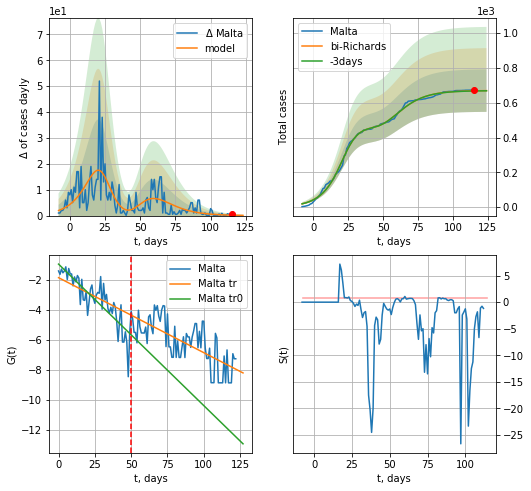

Malta data at: 2020-07-09
+3 day model MAPE: 0.001489
model: bi-Richards
coeffs: [2.09978534e+02 1.22034068e+01 1.97827481e+00 6.99535067e-03]
rational stdev: 0.182311
forecast at the end of period: +9 days
	 deltaDaycases: 0
	 total cases: 669 ± 122
	 total death: 8 ± 4
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.728733
 intercept: -0.938204
 slope: -0.094384
trend coefficient of determination: 0.478961
 intercept: -1.842578
 slope: -0.050028


In [291]:
vL = 50
x = forecastRR("Malta",dfMT[:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Malta",dfMT[:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


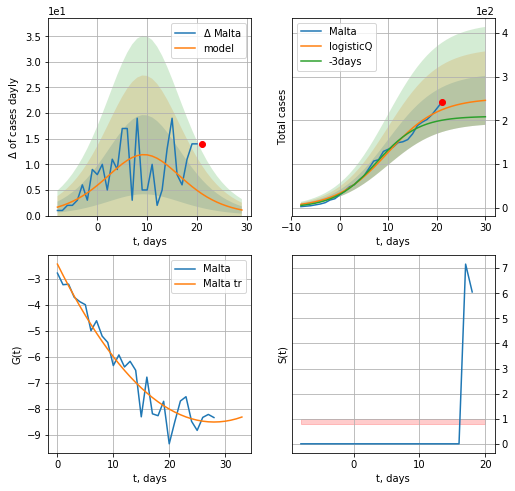

Malta data at: 2020-07-09
+3 day model MAPE: 0.130140
model: logisticQ
coeffs: [ 2.50920068e+02  3.54275509e-06  9.84690922e+00 -5.35768463e+04]
rational stdev: 0.227624
forecast at the end of period: +9 days
	 deltaDaycases: 1
	 total cases: 245 ± 55
	 total death: 3 ± 2
trend coefficient of determination: 0.935484
 intercept_: -2.4264251666881744
 coeffs_: [ 0.         -0.43368994  0.00773877]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


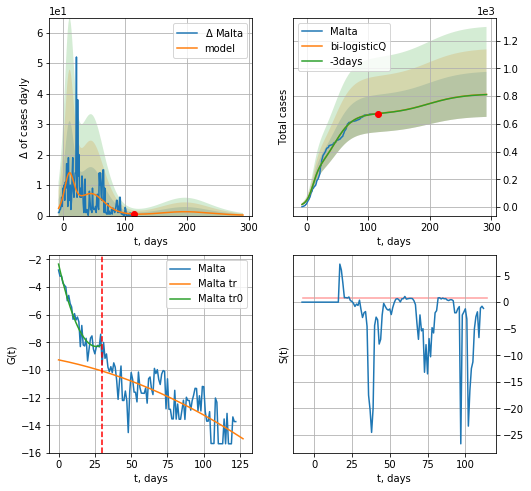

Malta data at: 2020-07-09
+3 day model MAPE: 0.001617
model: bi-logisticQ
coeffs: [ 4.18383247e+02  1.66170438e-07  4.52627771e+01 -4.10984527e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.199748
forecast at the end of period: +177 days
	 deltaDaycases: 0
	 total cases: 811 ± 162
	 total death: 10 ± 5
bi-logisticQ approximation splitting point: 30
trend coefficient of determination: 0.928360
 intercept_: -2.3445378489560733
 coeffs_: [ 0.         -0.45826686  0.00882824]
trend coefficient of determination: 0.576252
 intercept_: -9.260792380469315
 coeffs_: [ 0.         -0.02134082 -0.00018518]


In [292]:
x = forecastRRR("Malta",dfMT[:30],d1,16*7-dT,addpred=False,xcoef=[0.35/4,.5,3,1.])
xx = forecast2RRR("Malta",dfMT[:],d1,40*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=30)

SL
           date   cases  active  death
123 2020-07-11  1901.0   380.0   28.0
124 2020-07-12  1902.0   381.0   28.0
125 2020-07-13  1908.0   387.0   28.0
126 2020-07-14  1927.0   392.0   28.0
127 2020-07-15  1927.0   392.0   28.0


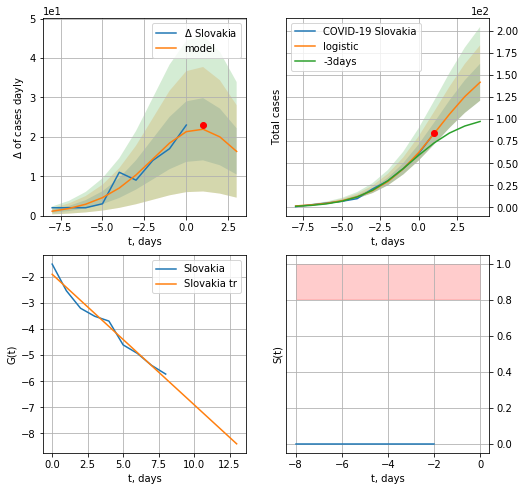

Slovakia data at: 2020-07-15
model: logistic
coeffs:  [177.28786794   0.4996723    1.23158092]
rational stdev:  0.14723856172050678
forecast at the end of period: +3 days
	 deltaDaycases:  16
	 total cases:  141 ± 20
	 total death:  2 ± 0
trend coefficient of determination: 0.974721
 intercept: -1.894823
 slope: -0.500610
Exception ocurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


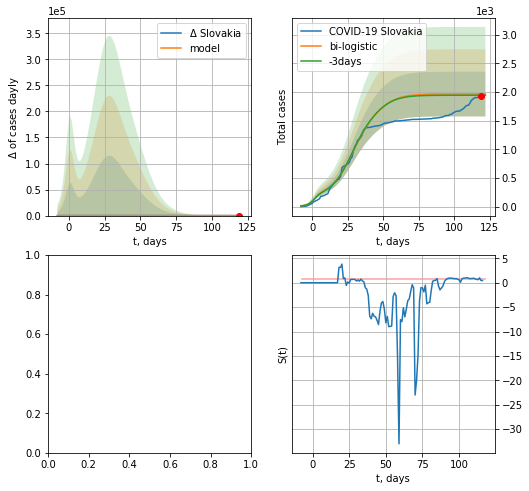

In [345]:
dfSL = read_df(pd.DataFrame(),"SL")
dfSL = dfSL.fillna(0)
try:
    x = forecast("Slovakia",dfSL[:10],d1,16*7-dT,pMAPE=False)
    xx = forecast2("Slovakia",dfSL[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=10)
except:
    print("Exception ocurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


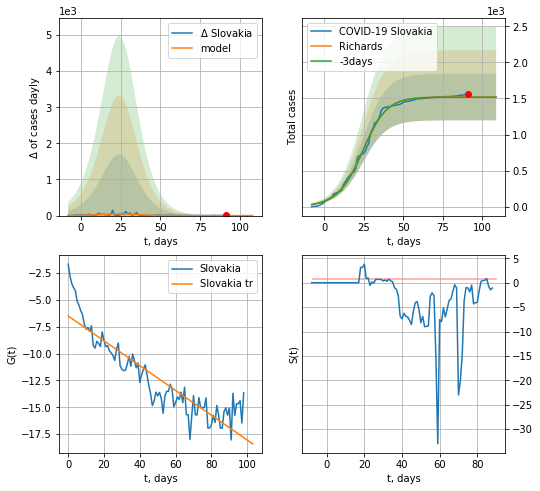

Slovakia data at: 2020-07-14
+3 day model MAPE: 0.002372
model: Richards
coeffs: [1.52109569e+03 1.16938737e-01 2.55808257e+01 1.14750283e+00]
rational stdev: 0.212800
forecast at the end of period: +18 days
	 deltaDaycases: 0
	 total cases: 1521 ± 323
	 total death: 22 ± 14
trend coefficient of determination: 0.817560
 intercept: -6.499033
 slope: -0.115624


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


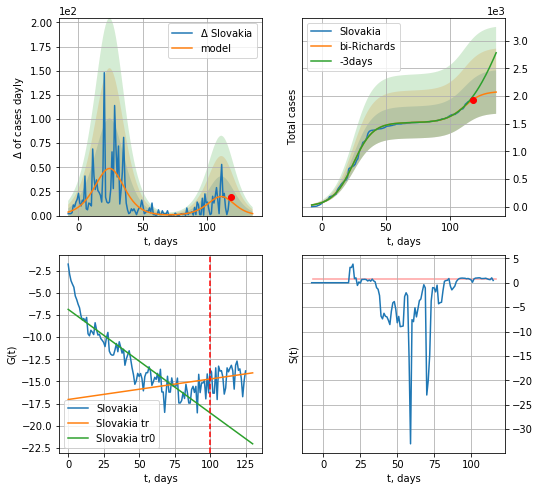

Slovakia data at: 2020-07-14
+3 day model MAPE: 0.037746
model: bi-Richards
coeffs: [5.62327989e+02 1.23076877e-01 1.12475529e+02 1.21566355e+00]
rational stdev: 0.189618
forecast at the end of period: +18 days
	 deltaDaycases: 2
	 total cases: 2070 ± 392
	 total death: 30 ± 17
bi-Richards approximation splitting point: 100
trend coefficient of determination: 0.814078
 intercept: -6.856803
 slope: -0.116897
trend coefficient of determination: 0.018883
 intercept: -17.044395
 slope: 0.023155


In [394]:
vL = 100
x = forecastRR("Slovakia",dfSL[:vL],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Slovakia",dfSL[:],d1,18*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


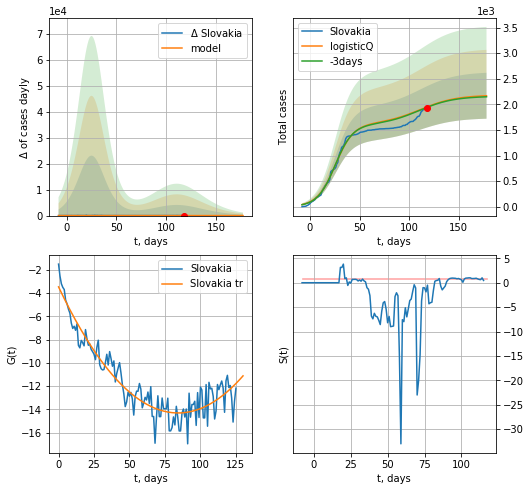

Slovakia data at: 2020-07-14
+3 day model MAPE: 0.004484
model: logisticQ
coeffs: [ 1.61115200e+03  2.82233089e-07  2.54819570e+01 -3.88817593e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.206935
forecast at the end of period: +60 days
	 deltaDaycases: 0
	 total cases: 2167 ± 448
	 total death: 31 ± 19
trend coefficient of determination: 0.886807
 intercept_: -3.46366167410204
 coeffs_: [ 0.         -0.25756972  0.00152803]


In [395]:
x = forecastRRR("Slovakia",dfSL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

SV
           date   cases  active  death
128 2020-07-11  1841.0   301.0  111.0
129 2020-07-12  1849.0   265.0  111.0
130 2020-07-13  1859.0   260.0  111.0
131 2020-07-14  1878.0   266.0  111.0
132 2020-07-15  1878.0   266.0  111.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


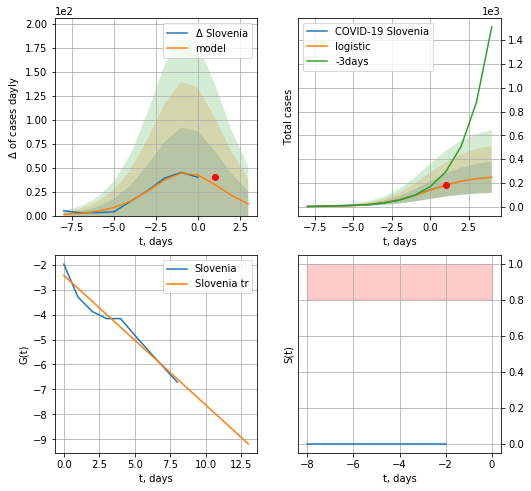

Slovenia data at: 2020-07-15
model: logistic
coeffs:  [ 2.61098711e+02  6.91755378e-01 -2.00021247e-01]
rational stdev:  0.5312441686508605
forecast at the end of period: +3 days
	 deltaDaycases:  12
	 total cases:  247 ± 131
	 total death:  14 ± 22
trend coefficient of determination: 0.958485
 intercept: -2.427236
 slope: -0.519636
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


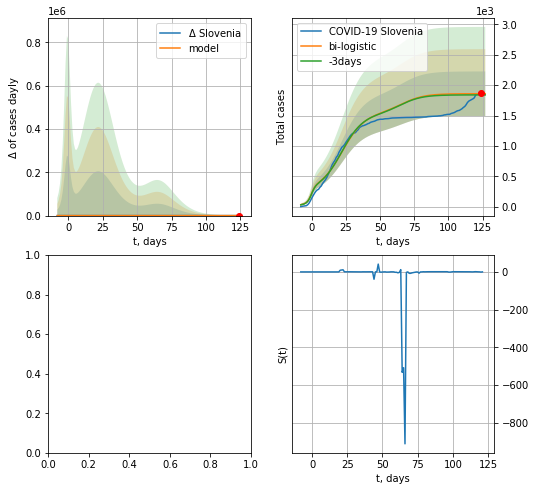

In [346]:
dfSV = read_df(pd.DataFrame(),"SV").fillna(0)
try:
    x = forecast("Slovenia",dfSV[:10],d1,7*16-dT,pMAPE=False)
    xx = forecast2("Slovenia",dfSV[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,3.],vL=10)
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


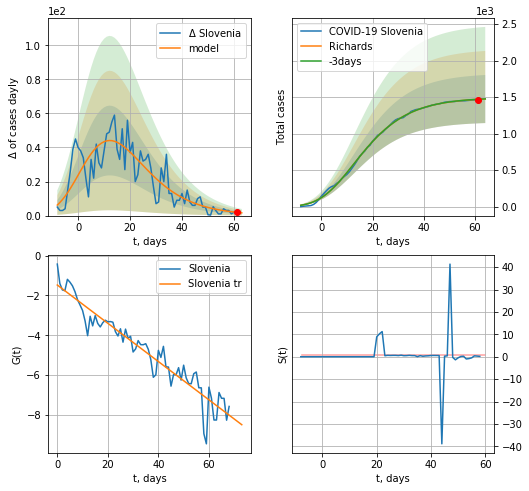

Slovenia data at: 2020-07-15
+3 day model MAPE: 0.001256
model: Richards
coeffs: [ 1.49237917e+03  6.34019353e-01 -1.06604036e+01  1.35186535e-01]
rational stdev: 0.223296
forecast at the end of period: +3 days
	 deltaDaycases: 1
	 total cases: 1474 ± 329
	 total death: 87 ± 58
trend coefficient of determination: 0.908976
 intercept: -1.475230
 slope: -0.096206


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:647: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

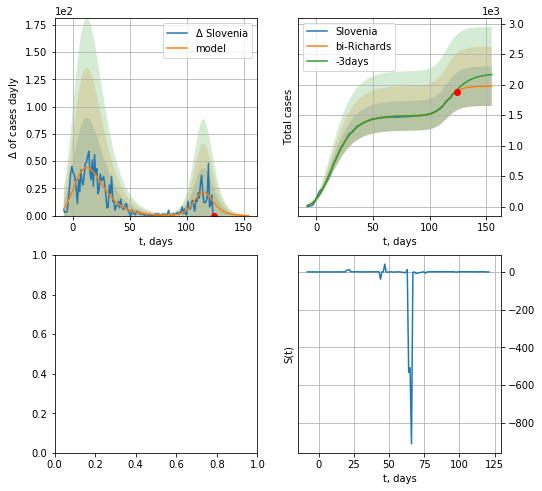

In [347]:
vL = 70
x = forecastRR("Slovenia",dfSV[:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Slovenia",dfSV[:],d1,20*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

[0.35416971, 0.02606324, 4.35859408, 19.30413219]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


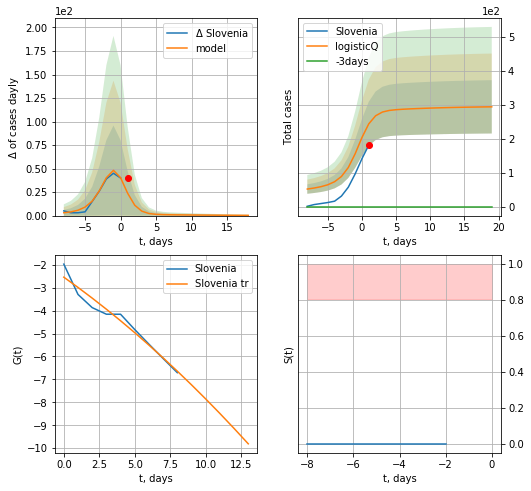

Slovenia data at: 2020-07-14
+3 day model MAPE: inf
model: logisticQ
coeffs: [ 2.17965799e+02  4.01733228e-02 -2.21208435e+01 -7.00287194e-01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.266979
forecast at the end of period: +18 days
	 deltaDaycases: 0
	 total cases: 293 ± 78
	 total death: 17 ± 13
trend coefficient of determination: 0.956027
 intercept_: -2.543480478113449
 coeffs_: [ 0.         -0.43771568 -0.00932819]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:234: RuntimeWarning: divide by zero encountered in double_scalars
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


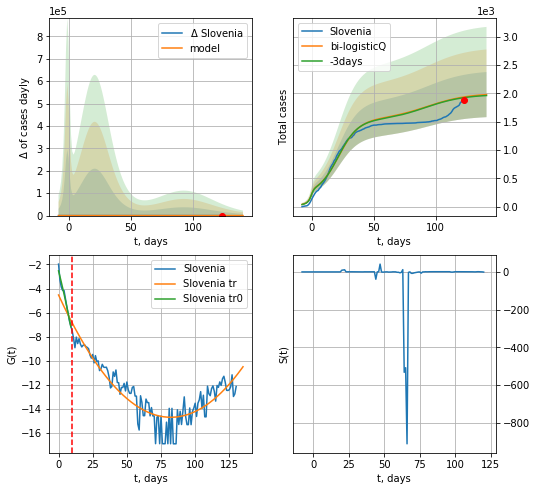

Slovenia data at: 2020-07-14
+3 day model MAPE: 0.006167
model: bi-logisticQ
coeffs: [ 1.31733504e+03  2.26700177e-07  2.13761406e+01 -5.34905022e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.201349
forecast at the end of period: +18 days
	 deltaDaycases: 1
	 total cases: 1977 ± 398
	 total death: 118 ± 71
bi-logisticQ approximation splitting point: 10
trend coefficient of determination: 0.968209
 intercept_: -2.53431844604435
 coeffs_: [ 0.         -0.45029183 -0.00732028]
trend coefficient of determination: 0.818091
 intercept_: -4.538010044274195
 coeffs_: [ 0.         -0.24709738  0.00150351]


In [406]:
print(koreaCoeffs)
x = forecastRRR("Slovenia",dfSV[:10],d1,18*7-dT,addpred=True,xcoef=koreaCoeffs)
xx = forecast2RRR("Slovenia",dfSV[:],d1,18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=10)

SB
           date  cases  active  death
123 2020-07-11  18073  3911.0  382.0
124 2020-07-12  18360  4091.0  393.0
125 2020-07-13  18639  4294.0  405.0
126 2020-07-14  18983  4574.0  418.0
127 2020-07-15  19334  4858.0  429.0


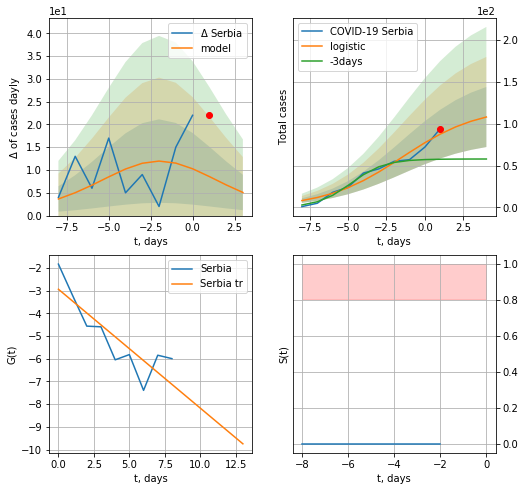

Serbia data at: 2020-07-15
model: logistic
coeffs:  [119.86809018   0.40041874  -1.48148467]
rational stdev:  0.3321032925412913
forecast at the end of period: +3 days
	 deltaDaycases:  5
	 total cases:  107 ± 35
	 total death:  2 ± 1
trend coefficient of determination: 0.723021
 intercept: -2.939233
 slope: -0.523684


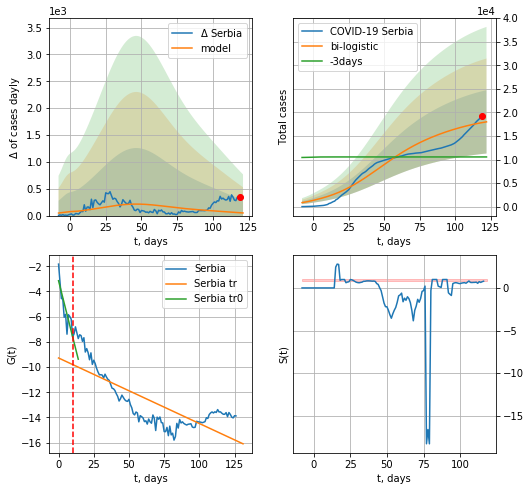

Serbia data at: 2020-07-15
+3 day model MAPE: 0.6969564135144317
model: bi-logistic
coeffs:  [1.51751337e+04 5.37276742e-02 4.50335054e+01] [119.86809018   0.40041874  -1.48148467]
scenario coeffs:  [0.25, 1.0, 2.2]
rational stdev:  0.37336869540545176
forecast at the end of period: +3 days
	 deltaDaycases:  49
	 total cases:  17992 ± 6717
	 total death:  399 ± 446
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.680312
 intercept: -3.149496
 slope: -0.444835
trend coefficient of determination: 0.610651
 intercept: -9.280976
 slope: -0.051991


In [348]:
dfSB = read_df(pd.DataFrame(),"SB")
dfSB = dfSB.fillna(0)
x = forecast("Serbia",dfSB[:10],d1,16*7-dT,pMAPE=False)
xx = forecast2("Serbia",dfSB[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,2.2],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


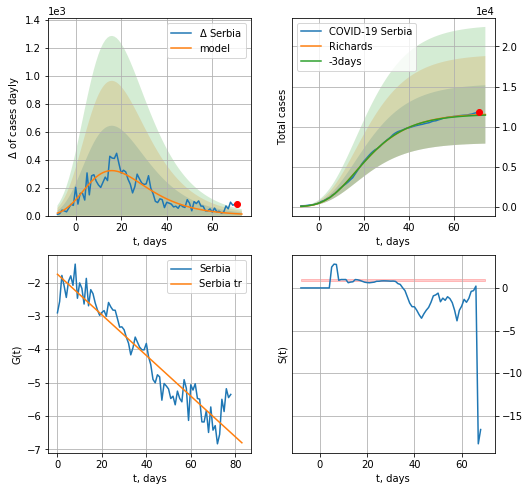

Serbia data at: 2020-07-15
+3 day model MAPE: 0.006988
model: Richards
coeffs: [ 1.16624273e+04  1.86505724e+00 -2.54597551e+01  4.09737397e-02]
rational stdev: 0.315837
forecast at the end of period: +3 days
	 deltaDaycases: 11
	 total cases: 11520 ± 3638
	 total death: 255 ± 241
trend coefficient of determination: 0.902510
 intercept: -1.751803
 slope: -0.060888


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


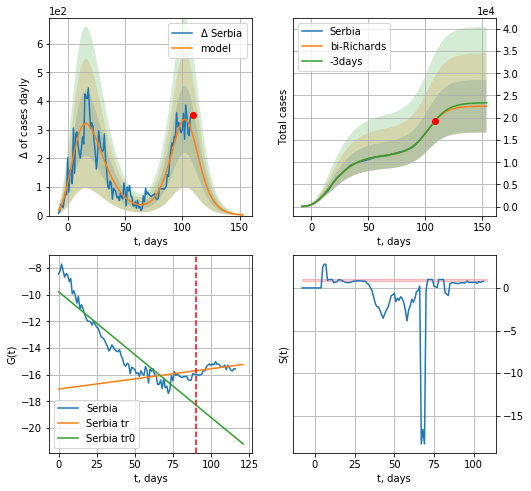

Serbia data at: 2020-07-15
+3 day model MAPE: 0.004735
model: bi-Richards
coeffs: [1.09601374e+04 1.09806947e-01 1.03974405e+02 1.17069538e+00]
rational stdev: 0.262449
forecast at the end of period: +45 days
	 deltaDaycases: 2
	 total cases: 22607 ± 5933
	 total death: 501 ± 394
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.842625
 intercept: -9.772770
 slope: -0.094220
trend coefficient of determination: 0.166825
 intercept: -17.068100
 slope: 0.015229


In [349]:
iL=10
vL=90+iL
x = forecastRR("Serbia",dfSB[iL:vL-iL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Serbia",dfSB[iL:],d1,22*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


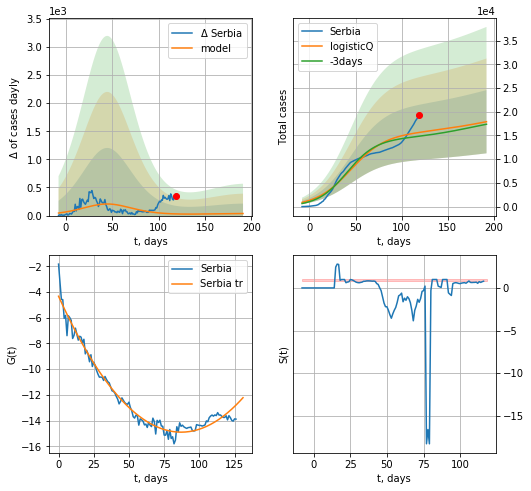

Serbia data at: 2020-07-15
+3 day model MAPE: 0.053784
model: logisticQ
coeffs: [ 1.53024811e+04  7.18945962e-08  4.47066582e+01 -7.41936851e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.372227
forecast at the end of period: +73 days
	 deltaDaycases: 36
	 total cases: 17902 ± 6663
	 total death: 397 ± 443
trend coefficient of determination: 0.972945
 intercept_: -4.330440061606352
 coeffs_: [ 0.         -0.24247201  0.00139157]


In [350]:
x = forecastRRR("Serbia",dfSB[:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

CT
           date   cases  active  death
133 2020-07-11  3672.0  1088.0  118.0
134 2020-07-12  3722.0  1117.0  119.0
135 2020-07-13  3775.0  1142.0  119.0
136 2020-07-14  3827.0  1149.0  120.0
137 2020-07-15  3953.0  1204.0  120.0


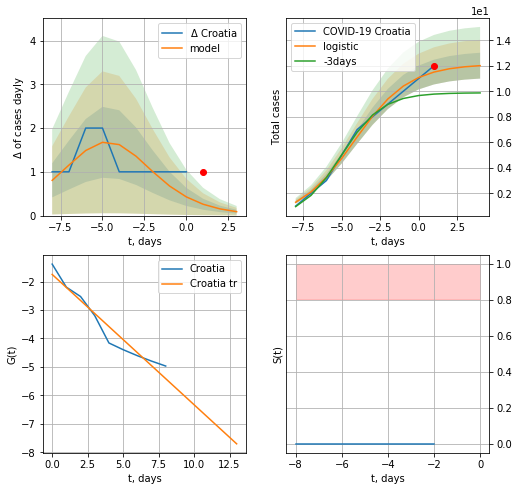

Croatia data at: 2020-07-15
model: logistic
coeffs:  [12.13023855  0.55939634 -4.20963748]
rational stdev:  0.08430442468045289
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  12 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.936719
 intercept: -1.749041
 slope: -0.458074


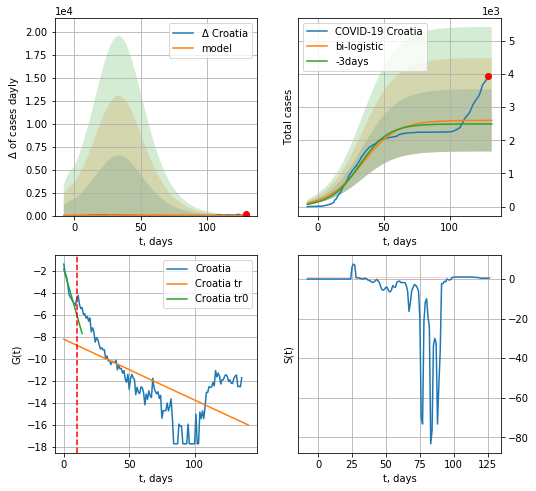

Croatia data at: 2020-07-15
+3 day model MAPE: 0.043700902675210124
model: bi-logistic
coeffs:  [2.59186345e+03 7.66103074e-02 3.37748616e+01] [12.13023855  0.55939634 -4.20963748]
rational stdev:  0.3609591400978178
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  2602 ± 939
	 total death:  79 ± 85
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.922384
 intercept: -1.856940
 slope: -0.417612
trend coefficient of determination: 0.387809
 intercept: -8.223017
 slope: -0.055340


In [351]:
try:
    dfCT = read_df(pd.DataFrame(),"CT")
    dfCT = dfCT.fillna(0)
    x = forecast("Croatia",dfCT[:10],d1,16*7-dT,pMAPE=False)
    xx = forecast2("Croatia",dfCT[:],d1,16*7-dT,x,addpred=False,xcoef=[0.25/2,1.,2.],vL=10)
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


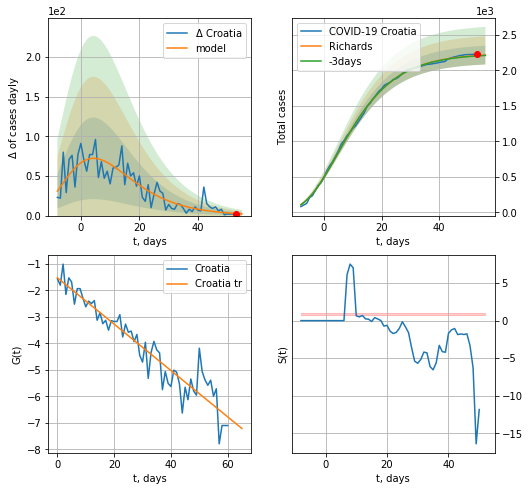

Croatia data at: 2020-07-15
+3 day model MAPE: 0.002310
model: Richards
coeffs: [ 2.23963101e+03  7.95190714e+00 -4.62548924e+01  1.10914885e-02]
rational stdev: 0.059686
forecast at the end of period: +3 days
	 deltaDaycases: 2
	 total cases: 2215 ± 132
	 total death: 67 ± 11
trend coefficient of determination: 0.897394
 intercept: -1.522031
 slope: -0.087533


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


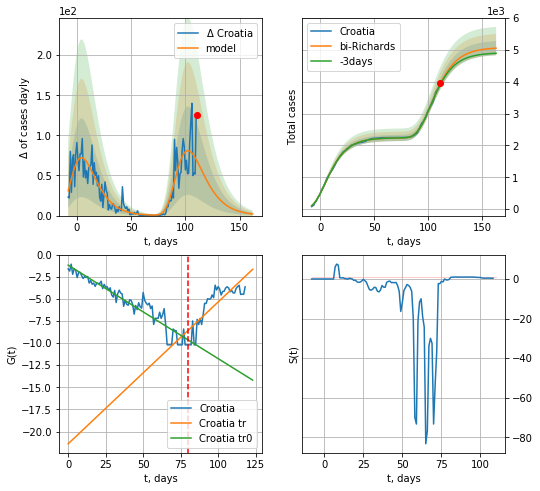

Croatia data at: 2020-07-15
+3 day model MAPE: 0.007066
model: bi-Richards
coeffs: [2.83452999e+03 3.31319549e+00 5.52691662e+01 2.37272392e-02]
rational stdev: 0.043967
forecast at the end of period: +52 days
	 deltaDaycases: 2
	 total cases: 5049 ± 221
	 total death: 153 ± 20
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.903490
 intercept: -1.188830
 slope: -0.105692
trend coefficient of determination: 0.682123
 intercept: -21.391477
 slope: 0.160383


In [352]:
iL = 18
vL = 80+iL
x = forecastRR("Croatia",dfCT[iL:vL-iL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Croatia",dfCT[iL:],d1,23*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


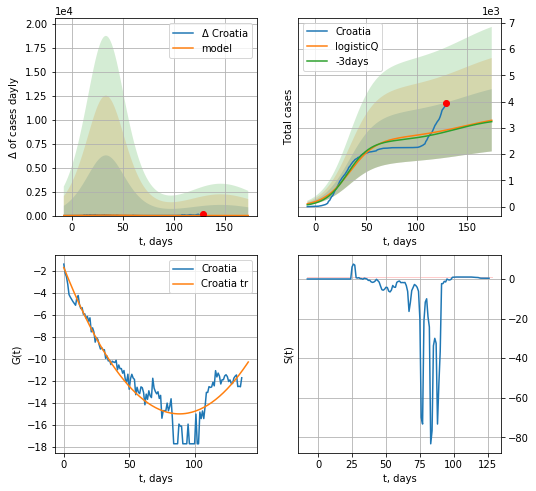

Croatia data at: 2020-07-15
+3 day model MAPE: 0.021561
model: logisticQ
coeffs: [ 2.60592238e+03  4.79321580e-08  3.36733515e+01 -1.58453499e+06]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.360486
forecast at the end of period: +45 days
	 deltaDaycases: 6
	 total cases: 3287 ± 1185
	 total death: 99 ± 107
trend coefficient of determination: 0.890728
 intercept_: -1.6959803383049348
 coeffs_: [ 0.         -0.30140579  0.00170509]


In [353]:
x = forecastRRR("Croatia",dfCT[:],d1,22*7-dT,addpred=True,xcoef=koreaCoeffs)

EG
           date  cases  active   death
127 2020-07-11  81158   53513  3769.0
128 2020-07-12  82070   53793  3858.0
129 2020-07-13  83001   54091  3935.0
130 2020-07-14  83930   54378  4008.0
131 2020-07-15  84843   54641  4067.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


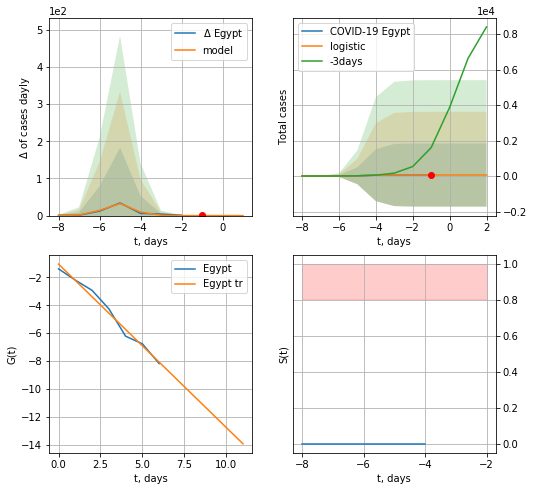

Egypt data at: 2020-07-15
+3 day model MAPE: 0.9848657964650105
model: logistic
coeffs:  [58.57021122  2.53530653 -4.60228222]
rational stdev:  30.428321363178444
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  58 ± 1782
	 total death:  2 ± 182
trend coefficient of determination: 0.982412
 intercept: -1.045837
 slope: -1.172929


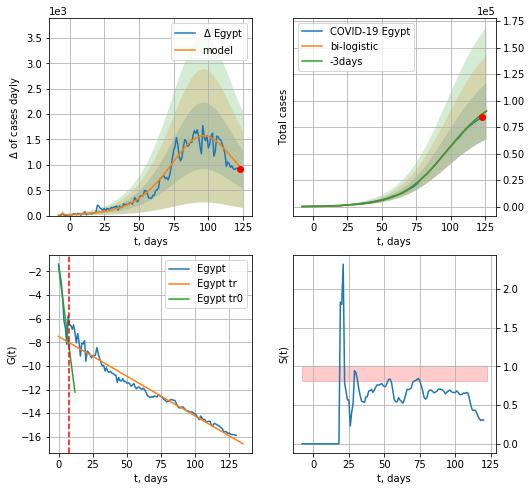

Egypt data at: 2020-07-15
+3 day model MAPE: 0.002775626093974688
model: bi-logistic
coeffs:  [1.02381780e+05 6.04749571e-02 9.65676660e+01] [58.57021122  2.53530653 -4.60228222]
scenario coeffs:  [0.25, 1.0, 1.7]
rational stdev:  0.2943211944485231
forecast at the end of period: +3 days
	 deltaDaycases:  905
	 total cases:  89980 ± 26483
	 total death:  4313 ± 3808
bi-logistic approximation splitting point: 8
trend0 coefficient of determination: 0.807637
 intercept: -1.627174
 slope: -0.882261
trend coefficient of determination: 0.960595
 intercept: -7.508327
 slope: -0.067305


In [354]:
dfEG = read_df(pd.DataFrame(),"EG")
x = forecast("Egypt",dfEG[:8],d1,7*16-dT)
xx = forecast2("Egypt",dfEG[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=8)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


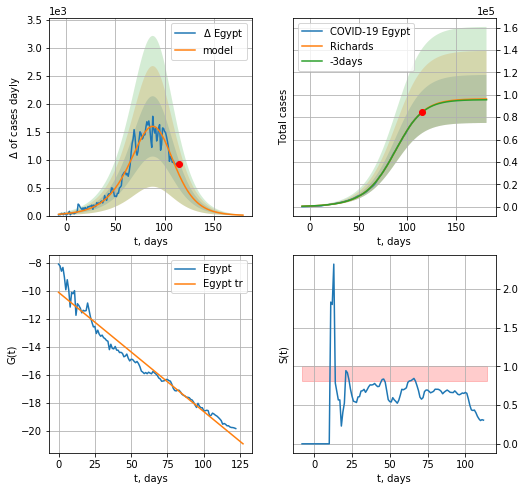

Egypt data at: 2020-07-15
+3 day model MAPE: 0.002687
model: Richards
coeffs: [9.63354606e+04 5.42179602e-02 9.25647555e+01 1.35062596e+00]
rational stdev: 0.222827
forecast at the end of period: +66 days
	 deltaDaycases: 8
	 total cases: 96225 ± 21441
	 total death: 4612 ± 3083
trend coefficient of determination: 0.962139
 intercept: -10.110112
 slope: -0.085361


In [355]:
x = forecastRR("Egypt",dfEG[8:],d1,25*7-dT,addpred=False,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


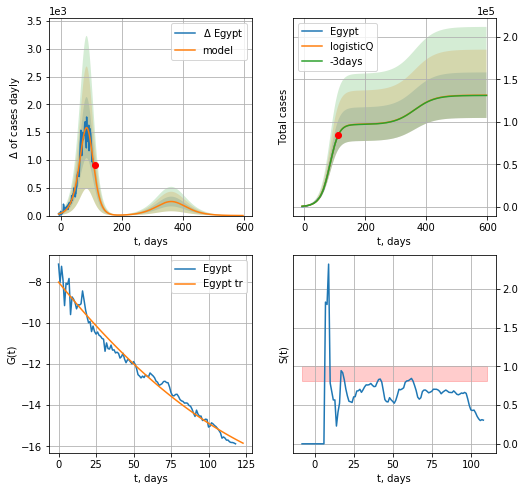

Egypt data at: 2020-07-15
+3 day model MAPE: 0.000930
model: logisticQ
coeffs: [ 9.70924485e+04  1.02027058e-04  8.27889536e+01 -5.55067638e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.204019
forecast at the end of period: +486 days
	 deltaDaycases: 0
	 total cases: 131451 ± 26818
	 total death: 6301 ± 3856
trend coefficient of determination: 0.980115
 intercept_: -8.030290884241413
 coeffs_: [ 0.         -0.08997943  0.00021475]


In [356]:
x = forecastRRR("Egypt",dfEG[12:],d1,85*7-dT,addpred=True,xcoef=koreaCoeffs)

IQ
           date  cases   active   death
130 2020-07-11  75194  29060.0  3055.0
131 2020-07-12  77506  29632.0  3150.0
132 2020-07-13  79735  29487.0  3250.0
133 2020-07-14  81757  27630.0  3345.0
134 2020-07-15  83867  27814.0  3432.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


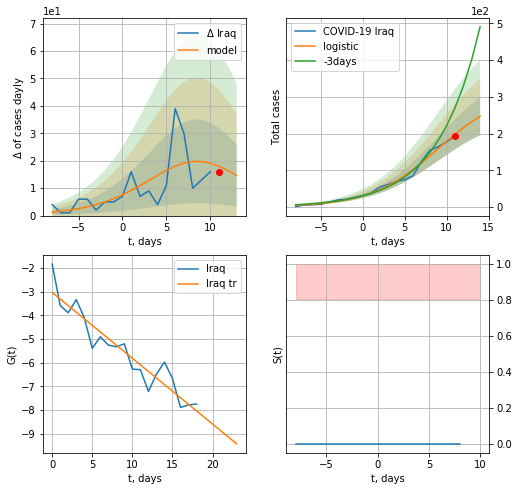

Iraq data at: 2020-07-15
+3 day model MAPE: 0.3447403684117319
model: logistic
coeffs:  [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.20777406895257303
forecast at the end of period: +3 days
	 deltaDaycases:  14
	 total cases:  246 ± 51
	 total death:  10 ± 6
trend coefficient of determination: 0.889033
 intercept: -3.031672
 slope: -0.278416


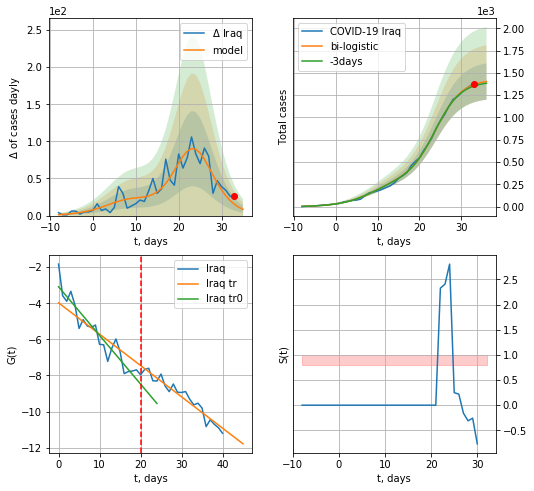

Iraq data at: 2020-07-15
+3 day model MAPE: 0.012548655608678476
model: bi-logistic
coeffs:  [1.10877596e+03 3.20225975e-01 2.39035989e+01] [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.14537179336300032
forecast at the end of period: +3 days
	 deltaDaycases:  8
	 total cases:  1402 ± 203
	 total death:  57 ± 24
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend coefficient of determination: 0.928562
 intercept: -3.976586
 slope: -0.173518


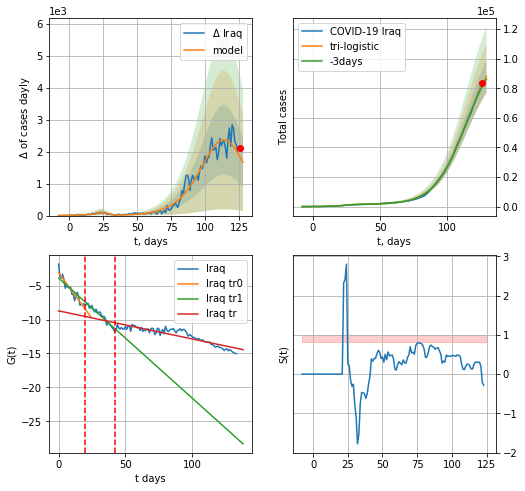

Iraq data at: 2020-07-15
+3 day model MAPE: 0.01787661371304463
model: tri-logistic
coeffs:  [1.11283800e+05 8.51858085e-02 1.14220913e+02] [3.17081296e+02 2.50431387e-01 8.98163530e+00 1.10877596e+03
 3.20225975e-01 2.39035989e+01]
forecast rational stdev:  0.12645526316954386
forecast at the end of period: +3 days
	 deltaDaycases:  1671
	 total cases:  88099 ± 11140
	 total death:  3605 ± 1367
tri-logistic approximation splitting points: 20,42
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend1 coefficient of determination: 0.937217
 intercept: -3.879636
 slope: -0.177153
trend coefficient of determination: 0.806348
 intercept: -8.724805
 slope: -0.041425


In [357]:
vL=20
vL1=42
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIQ = dfIQ.fillna(0)
x = forecast("Iraq",dfIQ[:vL],d1,16*7-dT)
xx = forecast2("Iraq",dfIQ[:vL1],d1,16*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Iraq",dfIQ[:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


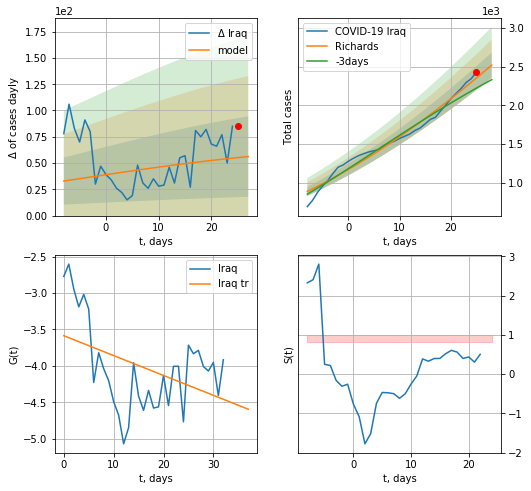

Iraq data at: 2020-07-15
+3 day model MAPE: 0.065658
model: Richards
coeffs: [ 1.13542997e+04  2.17318712e-01 -1.10114340e+02  7.21488559e-02]
rational stdev: 0.065219
forecast at the end of period: +3 days
	 deltaDaycases: 56
	 total cases: 2521 ± 164
	 total death: 103 ± 20
trend coefficient of determination: 0.185113
 intercept: -3.586012
 slope: -0.027278


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


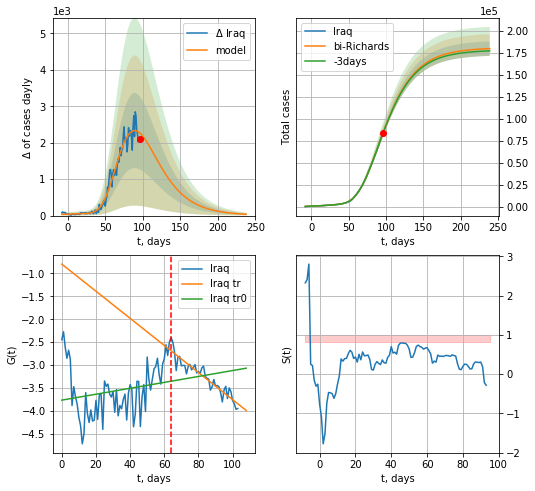

Iraq data at: 2020-07-15
+3 day model MAPE: 0.002764
model: bi-Richards
coeffs: [ 1.69771984e+05  1.58251655e+00 -1.21356155e+01  2.33098178e-02]
rational stdev: 0.045606
forecast at the end of period: +143 days
	 deltaDaycases: 35
	 total cases: 179797 ± 8199
	 total death: 7357 ± 1006
bi-Richards approximation splitting point: 64
trend coefficient of determination: 0.044688
 intercept: -3.763449
 slope: 0.006448
trend coefficient of determination: 0.869667
 intercept: -0.797863
 slope: -0.029547


In [358]:
vL=60+34#25+10
x = forecastRR("Iraq",dfIQ[30:vL-30],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Iraq",dfIQ[30:],d1,36*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-30)

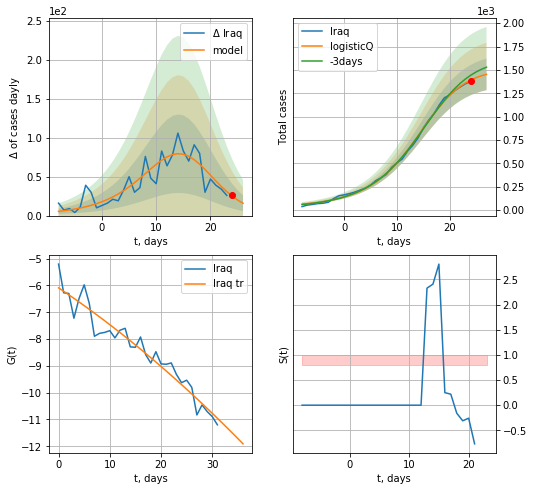

Iraq data at: 2020-07-15
+3 day model MAPE: 0.041008
model: logisticQ
coeffs: [ 1.50291916e+03  2.94853860e-03  1.34415511e+01 -5.72228334e+01]
rational stdev: 0.116469
forecast at the end of period: +3 days
	 deltaDaycases: 15
	 total cases: 1452 ± 169
	 total death: 59 ± 20
trend coefficient of determination: 0.930646
 intercept_: -6.090644942877015
 coeffs_: [ 0.         -0.12791486 -0.00093535]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


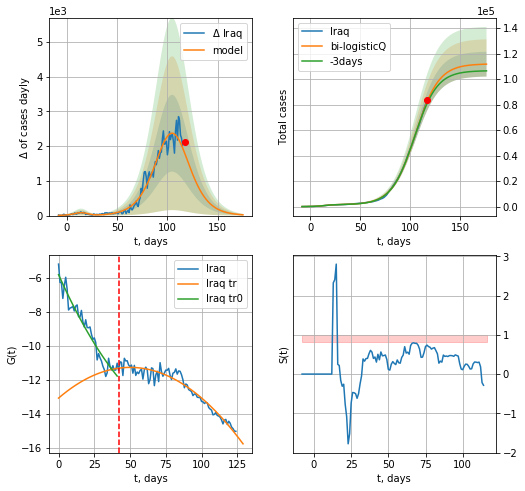

Iraq data at: 2020-07-15
+3 day model MAPE: 0.018718
model: bi-logisticQ
coeffs: [ 1.10507092e+05  3.58500312e-06  1.05077484e+02 -2.38296433e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.087105
forecast at the end of period: +59 days
	 deltaDaycases: 22
	 total cases: 111763 ± 9735
	 total death: 4573 ± 1194
bi-logisticQ approximation splitting point: 42
trend coefficient of determination: 0.941003
 intercept_: -5.824005146615983
 coeffs_: [ 0.         -0.18682641  0.00101526]
trend coefficient of determination: 0.937156
 intercept_: -13.071625130868874
 coeffs_: [ 0.          0.072081   -0.00071999]


In [359]:
x = forecastRRR("Iraq",dfIQ[9:42],d1,16*7-dT,addpred=False,xcoef=[0.35,.5,4.,1])
xx = forecast2RRR("Iraq",dfIQ[9:],d1,24*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=42)

In [360]:
#len(dfAR)

AR
           date    cases  active   death
129 2020-07-11  18712.0  4584.0  1004.0
130 2020-07-12  19195.0  4441.0  1011.0
131 2020-07-13  19689.0  4652.0  1018.0
132 2020-07-14  20216.0  4893.0  1028.0
133 2020-07-15  20770.0  4938.0  1040.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


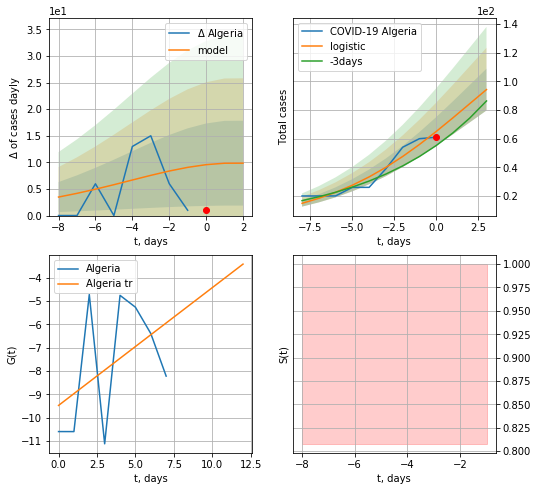

Algeria data at: 2020-07-15
+3 day model MAPE: 0.16392556519478307
model: logistic
coeffs:  [169.67177645   0.23328983   2.04237406]
rational stdev:  0.15467845008978148
forecast at the end of period: +3 days
	 deltaDaycases:  9
	 total cases:  94 ± 14
	 total death:  4 ± 1
trend coefficient of determination: 0.198482
 intercept: -9.477734
 slope: 0.504434


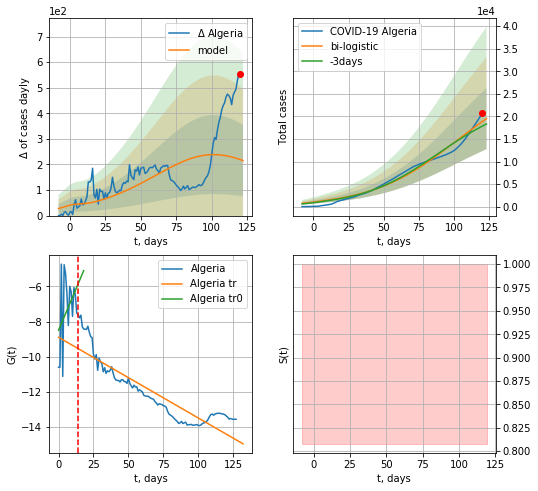

Algeria data at: 2020-07-15
+3 day model MAPE: 0.0598574996742394
model: bi-logistic
coeffs:  [2.75294184e+04 3.35194369e-02 9.98293309e+01] [169.67177645   0.23328983   2.04237406]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.34688625848312904
forecast at the end of period: +3 days
	 deltaDaycases:  215
	 total cases:  19515 ± 6769
	 total death:  977 ± 1016
bi-logistic approximation splitting point: 14
trend0 coefficient of determination: 0.134003
 intercept: -8.492024
 slope: 0.188486
trend coefficient of determination: 0.806073
 intercept: -8.895972
 slope: -0.045959


In [361]:
dfAR = read_df(pd.DataFrame(),"AR")
x = forecast("Algeria",dfAR[5:14],d1,7*16-dT)
xx = forecast2("Algeria",dfAR[5:],d1,7*16-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=14)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


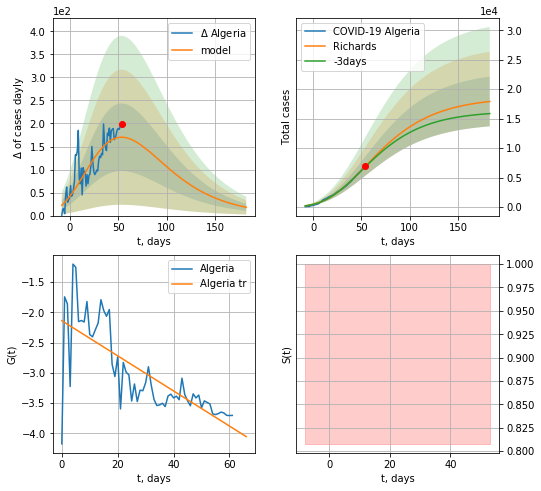

Algeria data at: 2020-07-15
+3 day model MAPE: 0.017387
model: Richards
coeffs: [ 1.86365134e+04  1.61723513e+00 -1.12618015e+02  1.54659567e-02]
rational stdev: 0.235585
forecast at the end of period: +129 days
	 deltaDaycases: 18
	 total cases: 17910 ± 4219
	 total death: 896 ± 633
trend coefficient of determination: 0.563028
 intercept: -2.139589
 slope: -0.029029


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


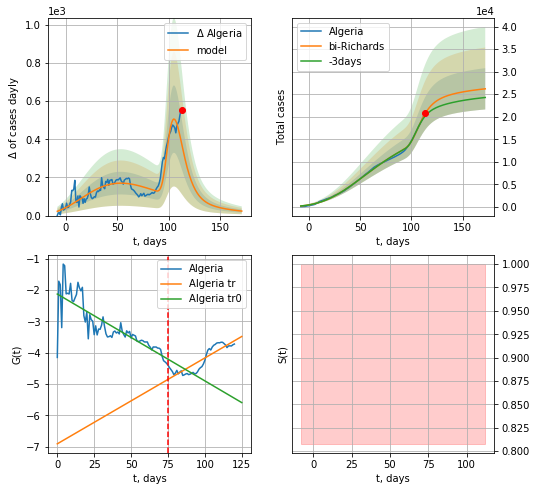

Algeria data at: 2020-07-15
+3 day model MAPE: 0.030312
model: bi-Richards
coeffs: [8.49547066e+03 1.27647809e+01 7.12699323e+01 1.03316542e-02]
rational stdev: 0.174821
forecast at the end of period: +59 days
	 deltaDaycases: 23
	 total cases: 26180 ± 4576
	 total death: 1310 ± 687
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.670695
 intercept: -2.132755
 slope: -0.027684
trend coefficient of determination: 0.767183
 intercept: -6.906931
 slope: 0.027372


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power


In [362]:
vL = 75+12
x = forecastRR("Algeria",dfAR[12:vL-12],d1,34*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Algeria",dfAR[12:],d1,24*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


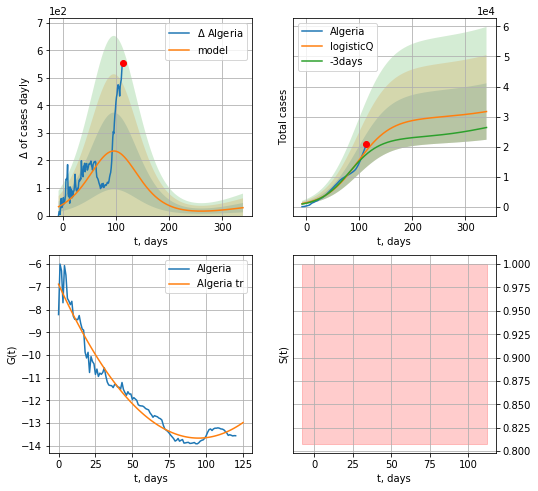

Algeria data at: 2020-07-15
+3 day model MAPE: 0.071516
model: logisticQ
coeffs: [ 2.94088019e+04  2.50597285e-07  9.62872956e+01 -1.26692461e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.296191
forecast at the end of period: +227 days
	 deltaDaycases: 28
	 total cases: 31674 ± 9381
	 total death: 1586 ± 1409
trend coefficient of determination: 0.962194
 intercept_: -6.882585517892345
 coeffs_: [ 0.         -0.14308202  0.00075408]


In [363]:
x = forecastRRR("Algeria",dfAR[12:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

CP
           date   cases  active  death
121 2020-07-11  1014.0   156.0   19.0
122 2020-07-12  1021.0   163.0   19.0
123 2020-07-13  1022.0   164.0   19.0
124 2020-07-14  1023.0   165.0   19.0
125 2020-07-15  1025.0   167.0   19.0


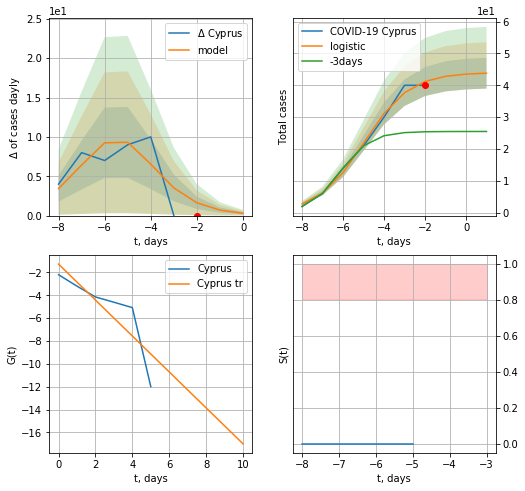

Cyprus data at: 2020-07-15
+3 day model MAPE: 0.6804910041763989
model: logistic
coeffs:  [44.00930084  0.89972657 -4.98223467]
rational stdev:  0.11057143078785021
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  43 ± 4
	 total death:  0 ± 0
trend coefficient of determination: 0.714597
 intercept: -1.270285
 slope: -1.572073


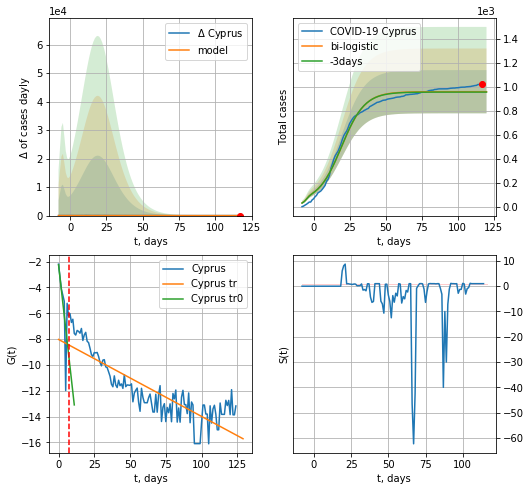

Cyprus data at: 2020-07-15
+3 day model MAPE: 0.0032402273500950303
model: bi-logistic
coeffs:  [9.17364549e+02 1.23688732e-01 1.94283880e+01] [44.00930084  0.89972657 -4.98223467]
rational stdev:  0.18759001486357693
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  961 ± 180
	 total death:  17 ± 9
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.449603
 intercept: -2.247366
 slope: -0.985825
trend coefficient of determination: 0.723276
 intercept: -8.025131
 slope: -0.059562


In [364]:
try:
    dfCP = read_df(pd.DataFrame(),"CP")
    dfCP = dfCP.fillna(0)
    x = forecast("Cyprus",dfCP[:7],d1,7*16-dT)
    xx = forecast2("Cyprus",dfCP[:],d1,16*7-dT,x,addpred=False,xcoef=[0.25,1.,2.3],vL=7)
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


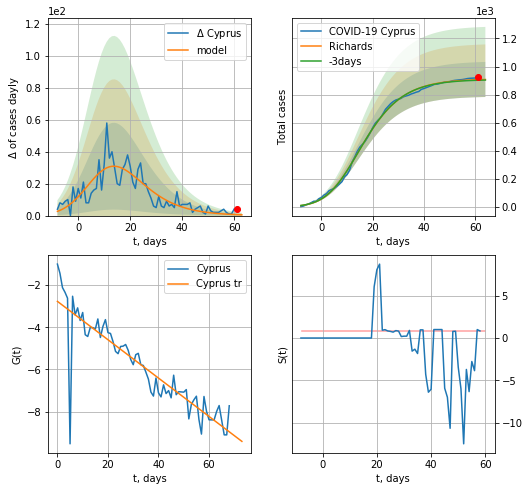

Cyprus data at: 2020-07-15
+3 day model MAPE: 0.004368
model: Richards
coeffs: [9.11933822e+02 3.20830854e-01 3.99756256e+00 3.34642778e-01]
rational stdev: 0.137523
forecast at the end of period: +3 days
	 deltaDaycases: 0
	 total cases: 907 ± 124
	 total death: 16 ± 6
trend coefficient of determination: 0.787995
 intercept: -2.772129
 slope: -0.090979


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


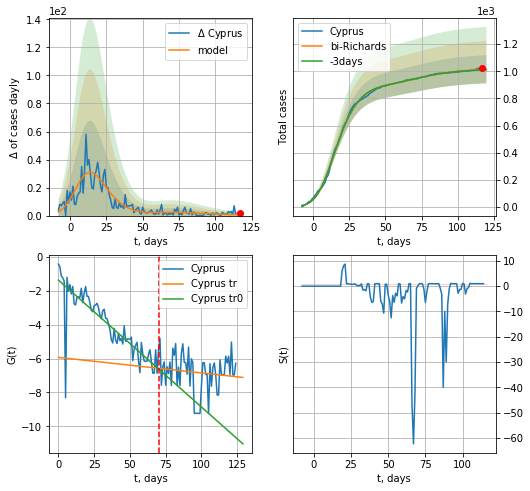

Cyprus data at: 2020-07-15
+3 day model MAPE: 0.003876
model: bi-Richards
coeffs: [ 1.12320080e+02  9.93083928e+00 -2.44610089e+01  5.36576493e-03]
rational stdev: 0.102496
forecast at the end of period: +3 days
	 deltaDaycases: 0
	 total cases: 1015 ± 104
	 total death: 18 ± 5
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.727867
 intercept: -1.357333
 slope: -0.075002
trend coefficient of determination: 0.016105
 intercept: -5.927853
 slope: -0.009170


In [365]:
vL=70
x = forecastRR("Cyprus",dfCP[:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
x = forecast2RR("Cyprus",dfCP[:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


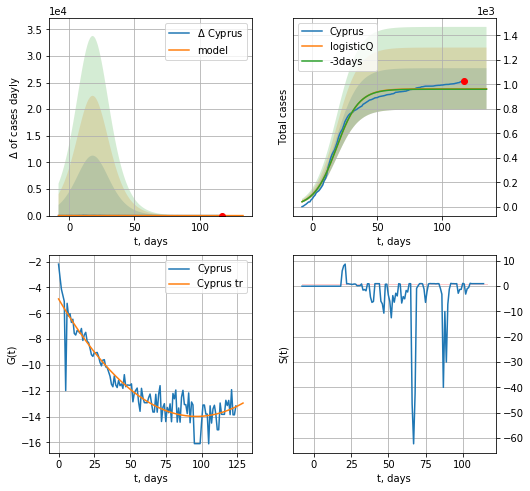

Cyprus data at: 2020-07-15
+3 day model MAPE: 0.003165
model: logisticQ
coeffs: [ 9.63340683e+02  2.70293889e-07  1.85234498e+01 -4.28748218e+05]
rational stdev: 0.174896
forecast at the end of period: +17 days
	 deltaDaycases: 0
	 total cases: 963 ± 168
	 total death: 17 ± 8
trend coefficient of determination: 0.872875
 intercept_: -4.892539682976649
 coeffs_: [ 0.         -0.18845289  0.00097679]


In [366]:
vL=33
x = forecastRRR("Cyprus",dfCP[:],d1,18*7-dT,addpred=False,xcoef=koreaCoeffs)
#xx = forecast2RRR("Cyprus",dfCP[:],d1,20*7-dT,x,addpred=True,xcoef=[0.35,.5,4,1],vL=vL)

PU
           date   cases   active    death
126 2020-07-11  322710  96876.0  11682.0
127 2020-07-12  326326  97345.0  11870.0
128 2020-07-13  330123  97061.0  12054.0
129 2020-07-14  333867  98377.0  12229.0
130 2020-07-15  337724  98907.0  12417.0


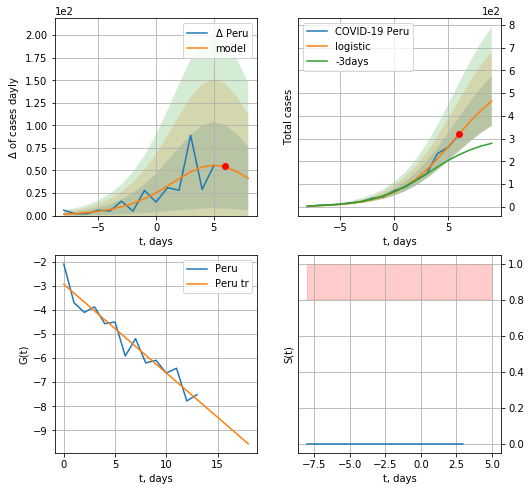

Peru data at: 2020-07-15
+3 day model MAPE: 0.4976759510371563
model: logistic
coeffs:  [5.88914141e+02 3.80777382e-01 5.52424877e+00]
rational stdev:  0.23355774891059702
forecast at the end of period: +3 days
	 deltaDaycases:  41
	 total cases:  465 ± 108
	 total death:  17 ± 11
trend coefficient of determination: 0.924015
 intercept: -2.937528
 slope: -0.367722


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


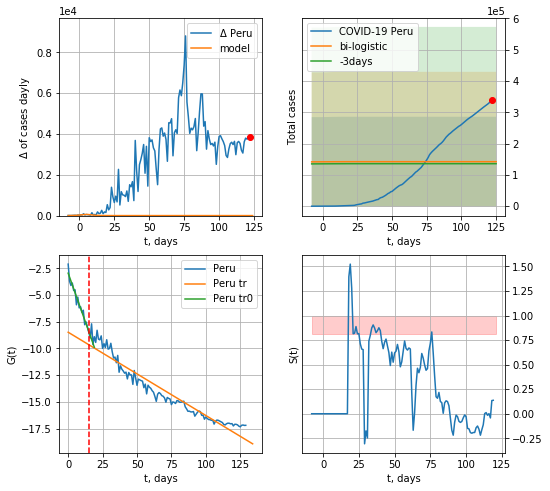

Peru data at: 2020-07-15
+3 day model MAPE: 0.047503132919111804
model: bi-logistic
coeffs:  [ 1.13259608e+05 -1.43619481e+01  3.53472180e+02] [5.88914141e+02 3.80777382e-01 5.52424877e+00]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  1.0088513586619137
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  142163 ± 143421
	 total death:  5226 ± 15816
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.936345
 intercept: -2.948740
 slope: -0.365135
trend coefficient of determination: 0.927731
 intercept: -8.481900
 slope: -0.078001


In [367]:
dfPU = read_df(pd.DataFrame(),"PU")
dfPU = dfPU.fillna(0)
x = forecast("Peru",dfPU[:15],d1,7*16-dT)
xx = forecast2("Peru",dfPU[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=15)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


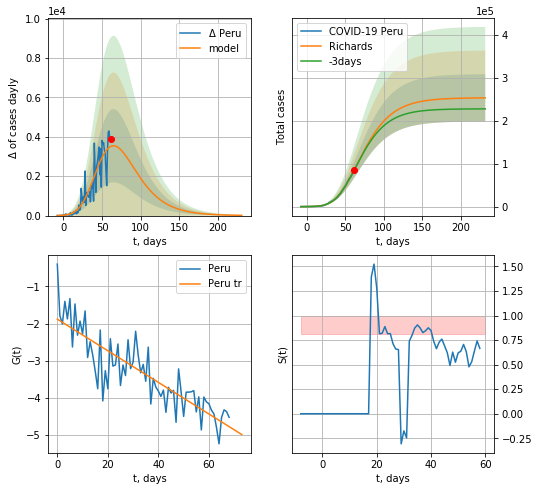

Peru data at: 2020-07-15
+3 day model MAPE: 0.004153
model: Richards
coeffs: [2.53867581e+05 3.16869248e-01 1.42807064e+01 1.27501600e-01]
rational stdev: 0.217547
forecast at the end of period: +171 days
	 deltaDaycases: 12
	 total cases: 253566 ± 55162
	 total death: 9322 ± 6083
trend coefficient of determination: 0.729622
 intercept: -1.882679
 slope: -0.042523


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


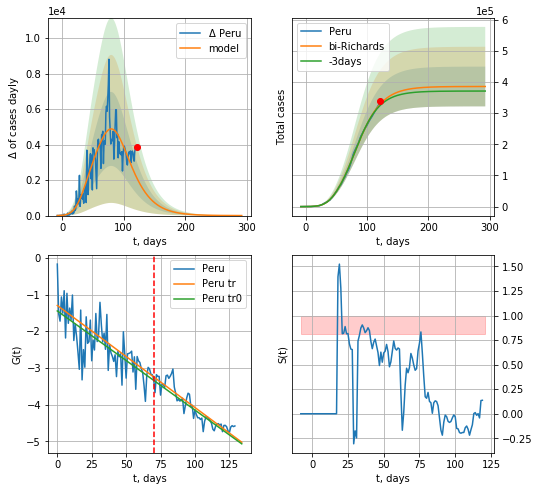

Peru data at: 2020-07-15
+3 day model MAPE: 0.013863
model: bi-Richards
coeffs: [ 1.31505795e+05  5.06358368e+00 -1.70066835e+01  8.60827981e-03]
rational stdev: 0.165381
forecast at the end of period: +171 days
	 deltaDaycases: 1
	 total cases: 385327 ± 63725
	 total death: 14167 ± 7028
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.546996
 intercept: -1.446803
 slope: -0.027031
trend coefficient of determination: 0.837455
 intercept: -1.297446
 slope: -0.027827


In [368]:
vL = 70
x = forecastRR("Peru",dfPU[:vL],d1,40*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Peru",dfPU[:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR("Peru",dfPU[:],d1,36*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


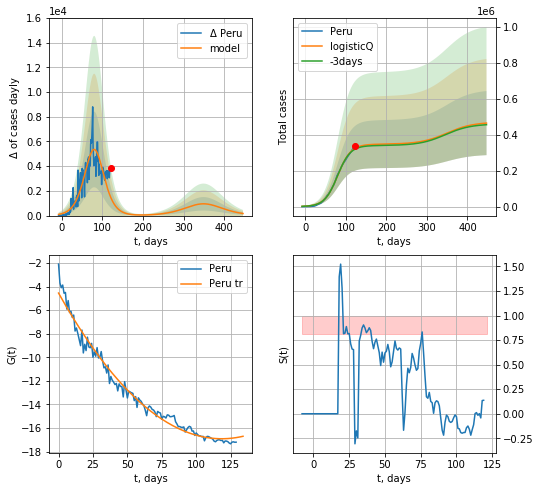

Peru data at: 2020-07-15
+3 day model MAPE: 0.014394
model: logisticQ
coeffs: [ 3.46758253e+05  5.94228705e-07  8.01052693e+01 -1.03931720e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.383933
forecast at the end of period: +325 days
	 deltaDaycases: 168
	 total cases: 463969 ± 178133
	 total death: 17058 ± 19647
trend coefficient of determination: 0.979610
 intercept_: -4.556438511734889
 coeffs_: [ 0.         -0.20847828  0.00087938]


In [369]:
x = forecastRRR("Peru",dfPU[:].fillna(0),d1,62*7-dT,addpred=True,xcoef=koreaCoeffs)

ID
           date   cases    active    death
133 2020-07-11  851261  292021.0  22696.0
134 2020-07-12  879888  301800.0  23200.0
135 2020-07-13  907645  311806.0  23727.0
136 2020-07-14  937844  320339.0  24327.0
137 2020-07-15  970169  331505.0  24929.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


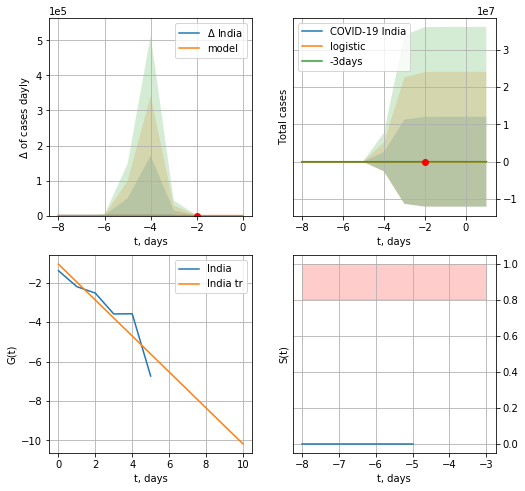

India data at: 2020-07-15
+3 day model MAPE: 0.19485949734745373
model: logistic
coeffs:  [29.40035511  4.01433678 -3.67575724]
rational stdev:  409363.3184161478
forecast at the end of period: +3 days
	 deltaDaycases:  0
	 total cases:  29 ± 12035426
	 total death:  0 ± 0
trend coefficient of determination: 0.835838
 intercept: -1.052904
 slope: -0.912220


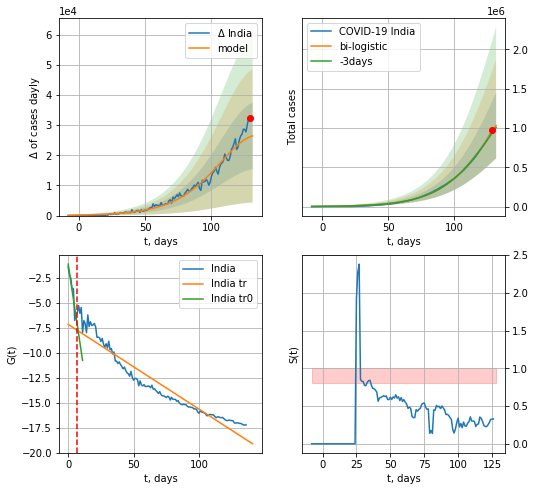

India data at: 2020-07-15
+3 day model MAPE: 0.02086957328264316
model: bi-logistic
coeffs:  [2.24424917e+06 4.73179806e-02 1.35502673e+02] [29.40035511  4.01433678 -3.67575724]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.4051430149392566
forecast at the end of period: +3 days
	 deltaDaycases:  26439
	 total cases:  1032176 ± 418179
	 total death:  26522 ± 32235
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.879788
 intercept: -1.115653
 slope: -0.874570
trend coefficient of determination: 0.919943
 intercept: -7.143981
 slope: -0.084625


In [370]:
dfID = read_df(pd.DataFrame(),"ID")
dfID = dfID.fillna(0)
x = forecast("India",dfID[:7],d1,7*16-dT)
xx = forecast2("India",dfID[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=7)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


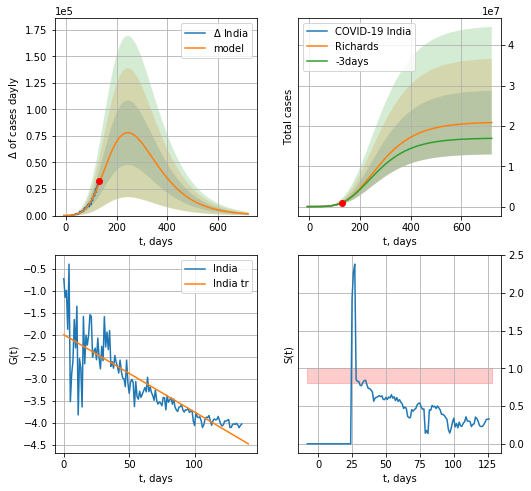

India data at: 2020-07-15
+3 day model MAPE: 0.009908
model: Richards
coeffs: [ 2.09744776e+07  2.28288239e-01 -5.40800764e+01  4.53463346e-02]
rational stdev: 0.379317
forecast at the end of period: +591 days
	 deltaDaycases: 1581
	 total cases: 20821946 ± 7898108
	 total death: 535030 ± 608837
trend coefficient of determination: 0.736376
 intercept: -1.996636
 slope: -0.017587


In [371]:
x = forecastRR("India",dfID[:],d1,100*7-dT,addpred=False,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


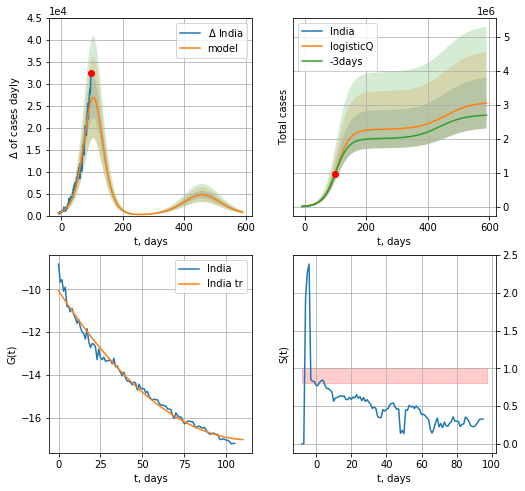

India data at: 2020-07-15
+3 day model MAPE: 0.020449
model: logisticQ
coeffs: [ 2.27546496e+06  2.60279174e-06  1.04983158e+02 -1.80422783e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.245403
forecast at the end of period: +493 days
	 deltaDaycases: 754
	 total cases: 3048493 ± 748110
	 total death: 78332 ± 57668
trend coefficient of determination: 0.985771
 intercept_: -10.061271772881483
 coeffs_: [ 0.         -0.12083113  0.00052418]


In [372]:
x = forecastRRR("India",dfID[31:].fillna(0),d1,86*7-dT,addpred=True,xcoef=koreaCoeffs)

AG
           date     cases   active   death
129 2020-07-11   97509.0  54291.0  1810.0
130 2020-07-12  100166.0  55627.0  1845.0
131 2020-07-13  103265.0  57189.0  1903.0
132 2020-07-14  106910.0  59475.0  1968.0
133 2020-07-15  111146.0  61798.0  2050.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


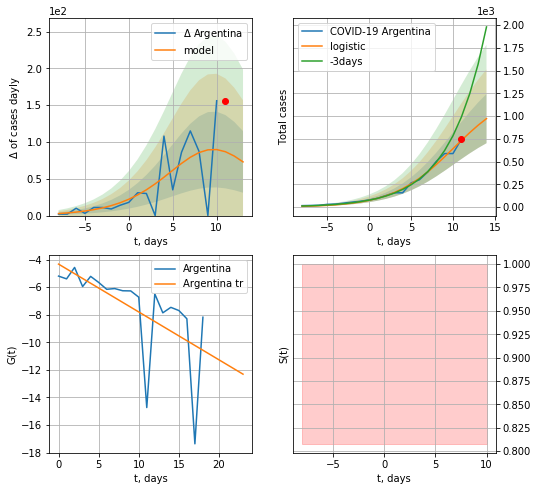

Argentina data at: 2020-07-15
+3 day model MAPE: 0.3427791439688051
model: logistic
coeffs:  [1.30607344e+03 2.75914265e-01 1.01155997e+01]
rational stdev:  0.2777261346981541
forecast at the end of period: +3 days
	 deltaDaycases:  72
	 total cases:  972 ± 270
	 total death:  17 ± 14
trend coefficient of determination: 0.364190
 intercept: -4.325611
 slope: -0.347113


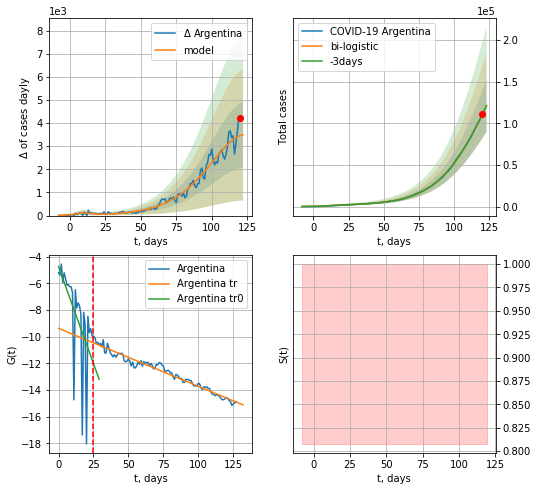

Argentina data at: 2020-07-15
+3 day model MAPE: 0.0001001822701605425
model: bi-logistic
coeffs:  [2.54383771e+05 5.52749208e-02 1.25133238e+02] [1.30607344e+03 2.75914265e-01 1.01155997e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.26007159106577166
forecast at the end of period: +3 days
	 deltaDaycases:  3499
	 total cases:  121063 ± 31485
	 total death:  2232 ± 1741
bi-logistic approximation splitting point: 25
trend0 coefficient of determination: 0.360462
 intercept: -4.766843
 slope: -0.290012
trend coefficient of determination: 0.963453
 intercept: -9.378086
 slope: -0.043399


In [373]:
vL = 25
#vL1 = 40
dfAG = read_df(pd.DataFrame(),"AG")
x = forecast('Argentina',dfAG[5:vL],d1,7*16-dT,1.0)
xx = forecast2('Argentina',dfAG[5:],d1,16*7-dT,x,1.0,vL=vL,addpred=True,xcoef=[.25,1.,2.0])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Argentina",dfAG[5:],d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

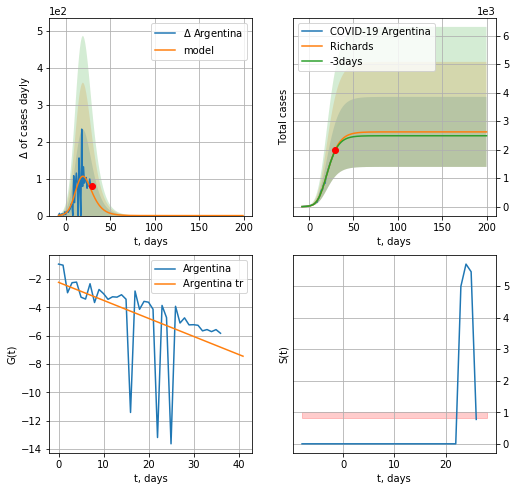

Argentina data at: 2020-07-15
+3 day model MAPE: 0.013138
model: Richards
coeffs: [2.62031748e+03 3.73236918e-01 1.15845148e+01 3.46306259e-01]
rational stdev: 0.468281
forecast at the end of period: +171 days
	 deltaDaycases: 0
	 total cases: 2620 ± 1227
	 total death: 48 ± 67
trend coefficient of determination: 0.244505
 intercept: -2.222432
 slope: -0.127357


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


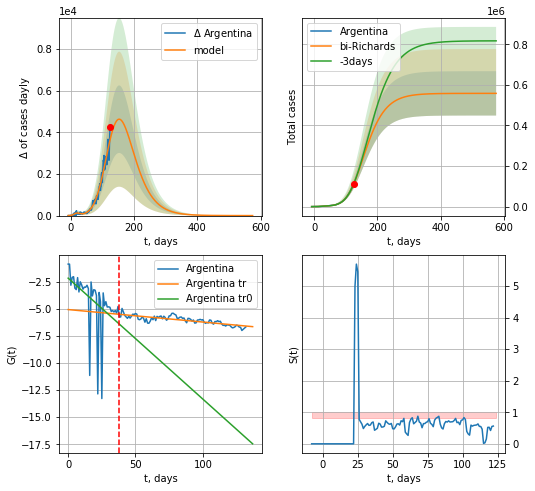

Argentina data at: 2020-07-15
+3 day model MAPE: 0.007610
model: bi-Richards
coeffs: [5.55561415e+05 8.81306760e-02 1.06320178e+02 2.93870435e-01]
rational stdev: 0.195632
forecast at the end of period: +451 days
	 deltaDaycases: 0
	 total cases: 558171 ± 109196
	 total death: 10295 ± 6042
bi-Richards approximation splitting point: 38
trend coefficient of determination: 0.210148
 intercept: -2.190446
 slope: -0.111448
trend coefficient of determination: 0.642779
 intercept: -5.085973
 slope: -0.011492


In [374]:
vL = 38
x = forecastRR('Argentina',dfAG[:vL].fillna(0),d1,40*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Argentina',dfAG[:].fillna(0),d1,80*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


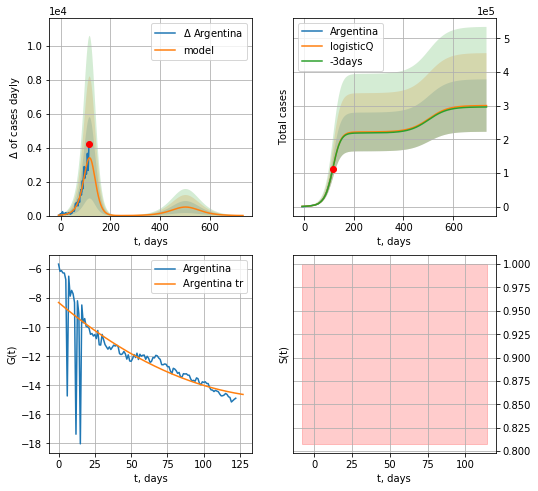

Argentina data at: 2020-07-15
+3 day model MAPE: 0.001348
model: logisticQ
coeffs: [ 2.21993274e+05  1.13917077e-04  1.15148712e+02 -4.21299417e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.259580
forecast at the end of period: +619 days
	 deltaDaycases: 4
	 total cases: 300442 ± 77988
	 total death: 5541 ± 4314
trend coefficient of determination: 0.640175
 intercept_: -8.295150016000992
 coeffs_: [ 0.         -0.08392034  0.00026836]


In [375]:
x = forecastRRR('Argentina',dfAG[10:],d1,104*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


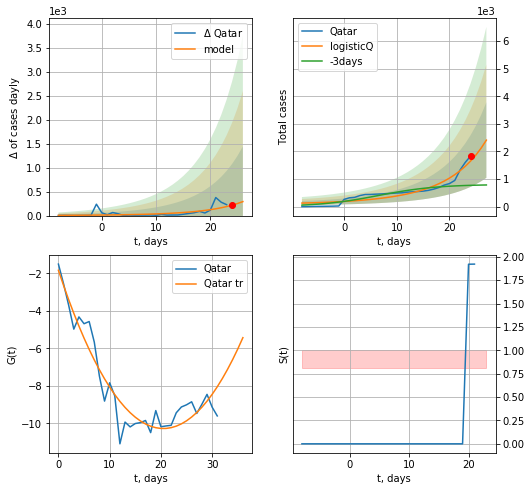

Qatar data at: 2020-07-15
+3 day model MAPE: 1.403655
model: logisticQ
coeffs: [ 4.67633524e+06  1.32940266e-03  6.79779167e+01 -1.11960120e+02]
rational stdev: 0.567221
forecast at the end of period: +3 days
	 deltaDaycases: 291
	 total cases: 2410 ± 1367
	 total death: 3 ± 5
trend coefficient of determination: 0.904406
 intercept_: -1.8341916285683908
 coeffs_: [ 0.         -0.82373816  0.02011068]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:294: RuntimeWarning: overflow encountered in exp


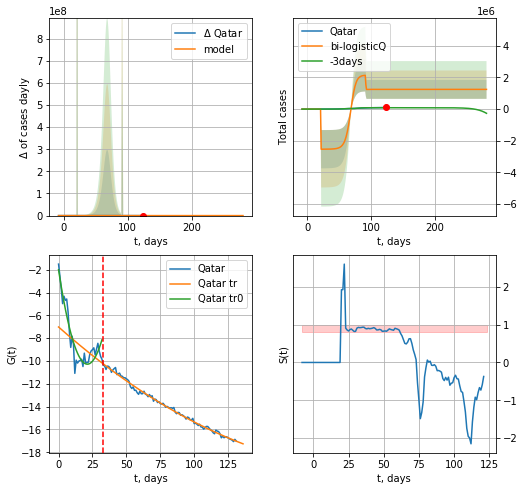

Qatar data at: 2020-07-15
+3 day model MAPE: 13.083646
model: bi-logisticQ
coeffs: [-2.53195644e+06  1.74874283e+00  2.11029952e+01 -3.12008894e+01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.477447
forecast at the end of period: +157 days
	 deltaDaycases: 0
	 total cases: 1247636 ± 595679
	 total death: 1794 ± 2569
bi-logisticQ approximation splitting point: 33
trend coefficient of determination: 0.887233
 intercept_: -1.9921673153050232
 coeffs_: [ 0.         -0.78114612  0.01840466]
trend coefficient of determination: 0.993401
 intercept_: -7.016951999514552
 coeffs_: [ 0.         -0.10547946  0.00022169]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


In [376]:
vL=33
x = forecastRRR('Qatar',dfQR[:vL].fillna(0),d1,7*16-dT,1.0,addpred=False,xcoef=[.35,.5,4.0,1])
xx = forecast2RRR('Qatar',dfQR[:].fillna(0),d1,38*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


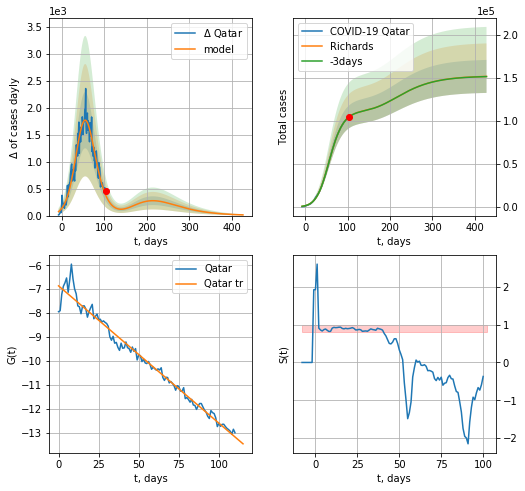

Qatar data at: 2020-07-15
+3 day model MAPE: 0.000638
model: Richards
coeffs: [1.11987161e+05 8.63455528e-02 4.77413575e+01 6.52668235e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.126302
forecast at the end of period: +325 days
	 deltaDaycases: 12
	 total cases: 151903 ± 19185
	 total death: 218 ± 82
trend coefficient of determination: 0.976946
 intercept: -6.860036
 slope: -0.057397


In [377]:
iL = 21
vL = 99 + iL
x = forecastRR('Qatar',dfQR[iL:].fillna(0),d1,62*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
#xx = forecast2RR('Qatar',dfQR[iL:].fillna(0),d1,60*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL-iL)

In [378]:
#x = forecast('Qatar',dfQR[:],d1,18*7-dT,1.0,addpred=True,xcoef=[.35,.5,4.0,1])

UAE
           date    cases  active  death
147 2020-07-11  54453.0    9474  331.0
148 2020-07-12  54854.0    9381  333.0
149 2020-07-13  55198.0    9351  334.0
150 2020-07-14  55573.0    9213  335.0
151 2020-07-15  55848.0    9095  335.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


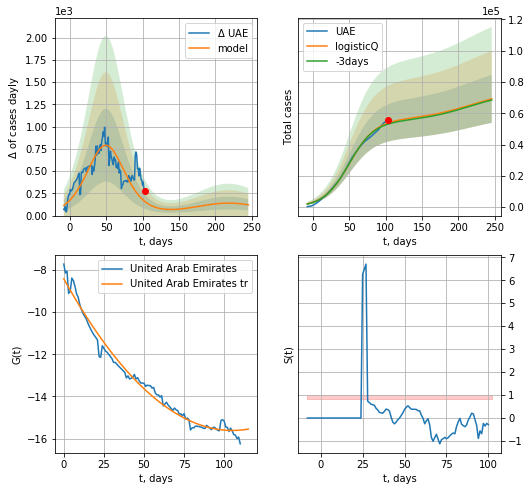

UAE data at: 2020-07-15
+3 day model MAPE: 0.013254
model: logisticQ
coeffs: [ 5.56774752e+04  3.91410879e-07  5.00926866e+01 -1.44302178e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.221302
forecast at the end of period: +143 days
	 deltaDaycases: 121
	 total cases: 69224 ± 15319
	 total death: 415 ± 275
trend coefficient of determination: 0.981370
 intercept_: -8.430554271477385
 coeffs_: [ 0.         -0.13648531  0.00064859]


In [379]:
dfUAE = read_df(pd.DataFrame(),"UAE")
x = forecastRRR('UAE',dfUAE[40:],d1,36*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


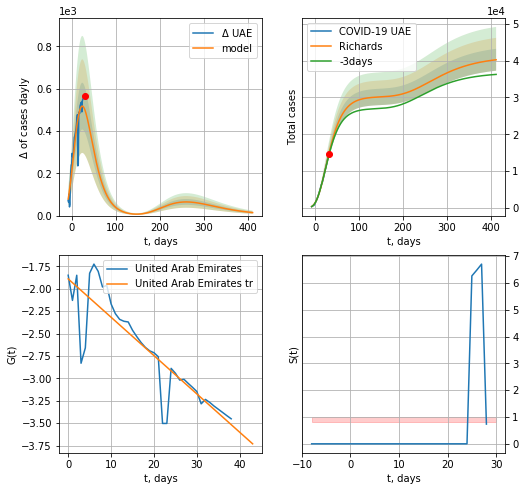

UAE data at: 2020-07-15
+3 day model MAPE: 0.022807
model: Richards
coeffs: [ 3.02157033e+04  2.32375449e+00 -5.83978580e+01  2.02401008e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.073933
forecast at the end of period: +381 days
	 deltaDaycases: 14
	 total cases: 40247 ± 2975
	 total death: 241 ± 53
trend coefficient of determination: 0.778768
 intercept: -1.889613
 slope: -0.042819


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


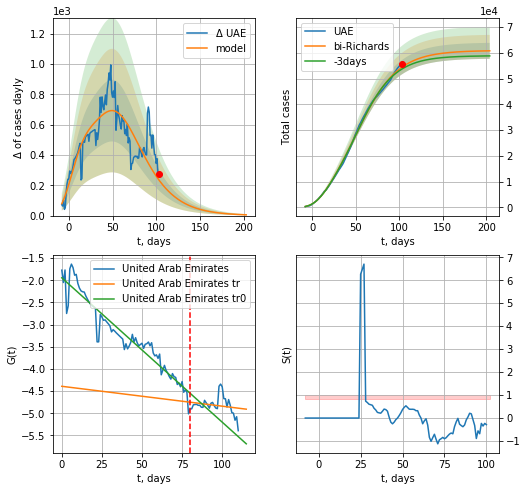

UAE data at: 2020-07-15
+3 day model MAPE: 0.013356
model: bi-Richards
coeffs: [ 3.06963610e+04  5.51169928e+00 -6.15475800e+01  7.17351683e-03]
rational stdev: 0.050880
forecast at the end of period: +101 days
	 deltaDaycases: 5
	 total cases: 60787 ± 3092
	 total death: 364 ± 55
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.913801
 intercept: -1.943247
 slope: -0.032567
trend coefficient of determination: 0.039255
 intercept: -4.390775
 slope: -0.004486


In [380]:
iL = 40
vL = 80 + iL
x = forecastRR('UAE',dfUAE[iL:vL-iL],d1,70*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
xx = forecast2RR('UAE',dfUAE[iL:],d1,30*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#x = forecastQR('UAE',dfUAE[40:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

In [381]:
#plt.plot(range(len(dfUAE[45:])-1),np.log(np.log(np.log(np.diff(dfUAE[45:].cases)))))

SA
           date     cases  active   death
130 2020-07-11  229480.0   61903  2181.0
131 2020-07-12  232259.0   62898  2223.0
132 2020-07-13  235111.0   63026  2243.0
133 2020-07-14  237803.0   57960  2283.0
134 2020-07-15  240474.0   55101  2325.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


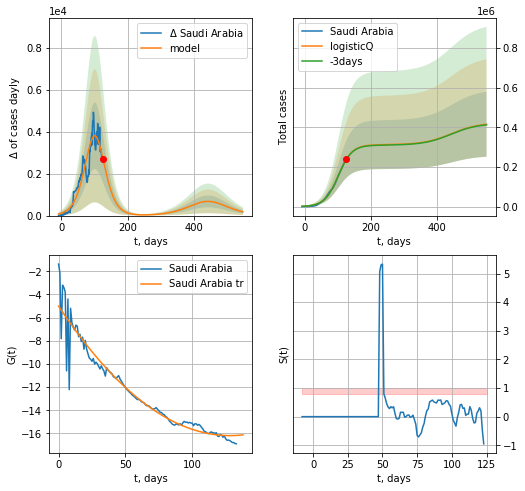

Saudi Arabia data at: 2020-07-15
+3 day model MAPE: 0.003171
model: logisticQ
coeffs: [ 3.12326122e+05  5.83106020e-07  1.01598723e+02 -8.33647683e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.394273
forecast at the end of period: +423 days
	 deltaDaycases: 176
	 total cases: 415277 ± 163732
	 total death: 4015 ± 4749
trend coefficient of determination: 0.927943
 intercept_: -5.006796381299616
 coeffs_: [ 0.         -0.17431888  0.00067976]


In [382]:
dfSA = read_df(pd.DataFrame(),"SA")
x = forecastRRR('Saudi Arabia',dfSA[:],d1,76*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


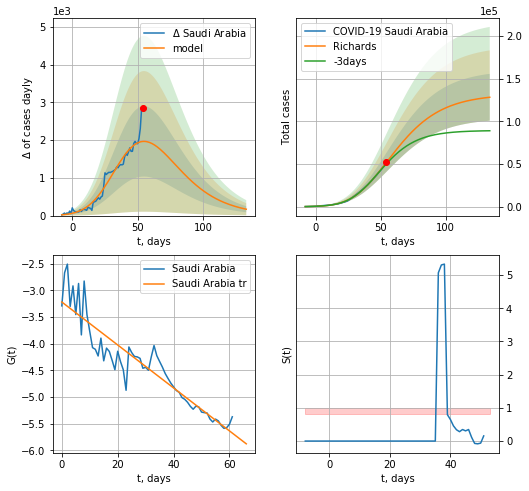

Saudi Arabia data at: 2020-07-15
+3 day model MAPE: 0.035873
model: Richards
coeffs: [1.31816759e+05 1.98591474e-01 2.23762356e+01 2.26895132e-01]
rational stdev: 0.214319
forecast at the end of period: +80 days
	 deltaDaycases: 168
	 total cases: 128083 ± 27450
	 total death: 1238 ± 795
trend coefficient of determination: 0.862734
 intercept: -3.219420
 slope: -0.040287


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


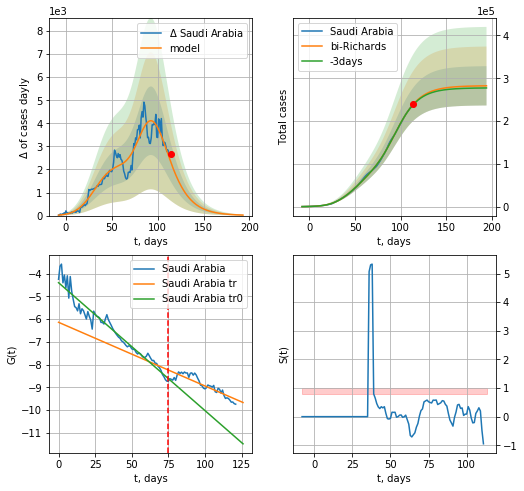

Saudi Arabia data at: 2020-07-15
+3 day model MAPE: 0.004474
model: bi-Richards
coeffs: [1.50883940e+05 1.68541747e-01 8.35213636e+01 4.22787185e-01]
rational stdev: 0.162544
forecast at the end of period: +80 days
	 deltaDaycases: 21
	 total cases: 282310 ± 45887
	 total death: 2729 ± 1330
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.946002
 intercept: -4.397233
 slope: -0.056212
trend coefficient of determination: 0.777365
 intercept: -6.138661
 slope: -0.027977


In [383]:
x = forecastRR('Saudi Arabia',dfSA[12:75],d1,27*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Saudi Arabia',dfSA[12:],d1,27*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=75)
#x = forecastQR('Saudi Arabia',dfSA[12:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

Sri
           date   cases  active  death
123 2020-07-11  2511.0     520   11.0
124 2020-07-12  2617.0     625   11.0
125 2020-07-13  2646.0     654   11.0
126 2020-07-14  2665.0     666   11.0
127 2020-07-15  2671.0     659   11.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


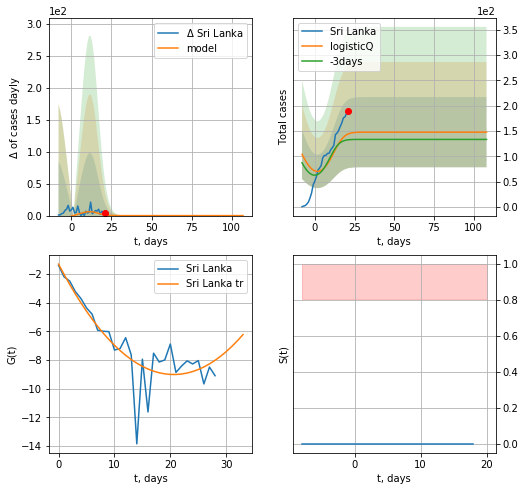

Sri Lanka data at: 2020-07-15
+3 day model MAPE: 0.092819
model: logisticQ
coeffs: [ 1.47873470e+02  1.02179685e-02  4.75701897e+00 -1.32324113e+00]
rational stdev: 0.468203
forecast at the end of period: +87 days
	 deltaDaycases: 0
	 total cases: 147 ± 69
	 total death: 0 ± 0
trend coefficient of determination: 0.737116
 intercept_: -1.300425972375204
 coeffs_: [ 0.         -0.74879164  0.01816974]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:294: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:333: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


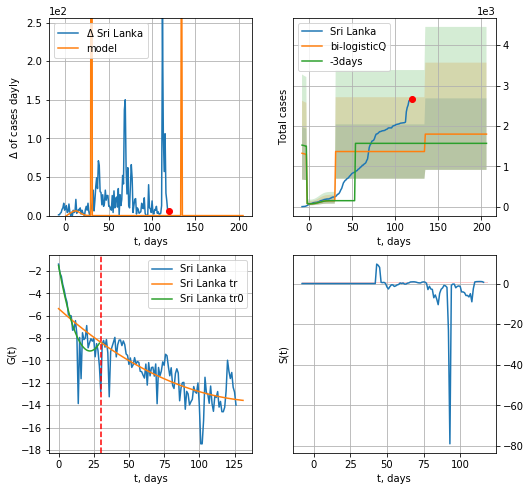

Sri Lanka data at: 2020-07-15
+3 day model MAPE: 0.129176
model: bi-logisticQ
coeffs: [1217.20753578    8.13053391   30.84782073   -2.42574877]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.492693
forecast at the end of period: +87 days
	 deltaDaycases: 0
	 total cases: 1796 ± 884
	 total death: 7 ± 10
bi-logisticQ approximation splitting point: 30
trend coefficient of determination: 0.725855
 intercept_: -1.5084890363019623
 coeffs_: [ 0.         -0.68634546  0.01540158]
trend coefficient of determination: 0.543656
 intercept_: -5.366044347574097
 coeffs_: [ 0.         -0.11176755  0.00037515]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


In [384]:
dfSri = read_df(pd.DataFrame(),"Sri")
vL= 30
x = forecastRRR('Sri Lanka',dfSri[:vL],d1,28*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Sri Lanka',dfSri[:],d1,28*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


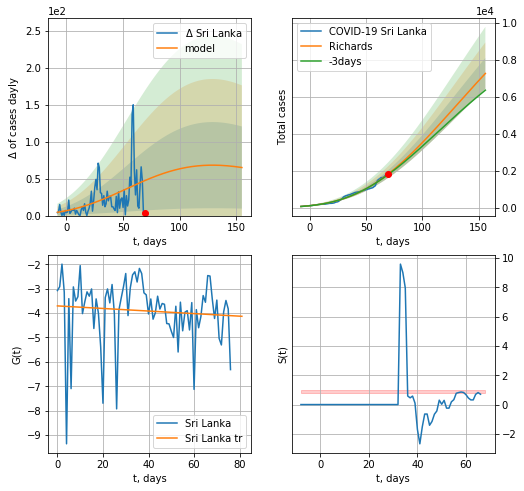

Sri Lanka data at: 2020-07-15
+3 day model MAPE: 0.017294
model: Richards
coeffs: [ 1.47451133e+04  4.63966189e-01 -1.52015772e+02  2.75073239e-02]
rational stdev: 0.115527
forecast at the end of period: +87 days
	 deltaDaycases: 65
	 total cases: 7274 ± 840
	 total death: 29 ± 10
trend coefficient of determination: 0.007586
 intercept: -3.705075
 slope: -0.005260


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


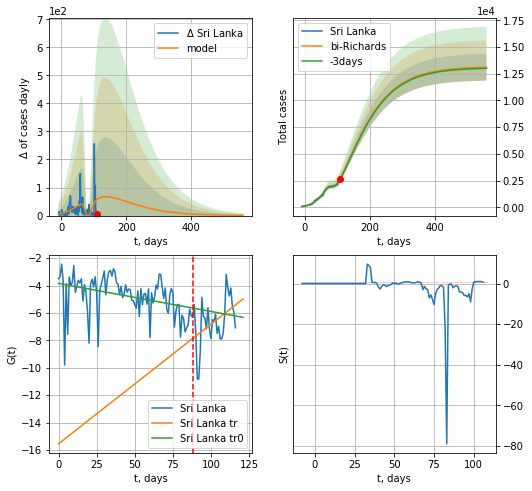

Sri Lanka data at: 2020-07-15
+3 day model MAPE: 0.020206
model: bi-Richards
coeffs: [-1.56303903e+03  8.49152296e-01  6.38529377e+01  1.24620192e-01]
rational stdev: 0.095788
forecast at the end of period: +451 days
	 deltaDaycases: 0
	 total cases: 13121 ± 1256
	 total death: 54 ± 15
bi-Richards approximation splitting point: 88
trend coefficient of determination: 0.131311
 intercept: -3.843928
 slope: -0.020470
trend coefficient of determination: 0.185597
 intercept: -15.551400
 slope: 0.087355


In [385]:
vL=88+10
x = forecastRR('Sri Lanka',dfSri[10:vL-10],d1,28*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Sri Lanka',dfSri[10:],d1,80*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-10)
#x = forecastQR('Sri Lanka',dfSri[10:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

PS
           date     cases  active   death
135 2020-07-11  248872.0   86975  5197.0
136 2020-07-12  251625.0   84442  5266.0
137 2020-07-13  253604.0   77628  5320.0
138 2020-07-14  255769.0   77573  5386.0
139 2020-07-15  257914.0   73751  5426.0


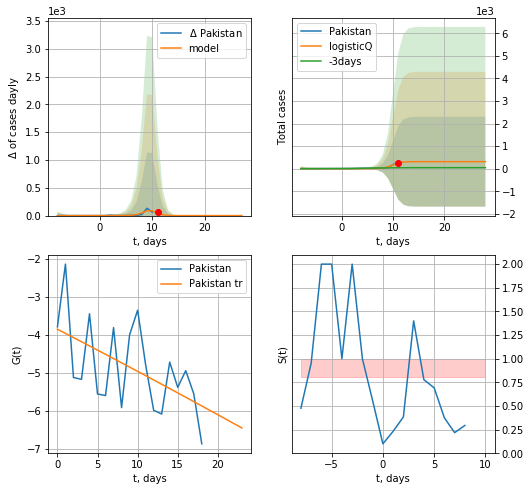

Pakistan data at: 2020-07-15
+3 day model MAPE: 5.954391
model: logisticQ
coeffs: [ 3.10300107e+02  5.80299152e-02  9.88962591e+00 -1.18245381e+01]
rational stdev: 6.420495
forecast at the end of period: +17 days
	 deltaDaycases: 0
	 total cases: 310 ± 1992
	 total death: 6 ± 115
trend coefficient of determination: 0.293073
 intercept_: -3.8498114630651457
 coeffs_: [ 0.         -0.10964083 -0.00016191]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


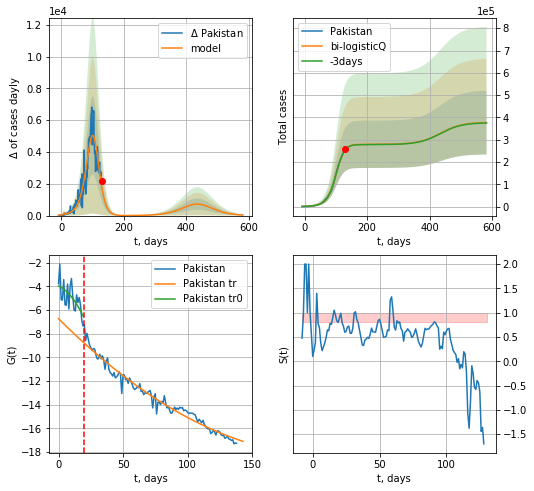

Pakistan data at: 2020-07-15
+3 day model MAPE: 0.002519
model: bi-logisticQ
coeffs: [ 2.78920849e+05  1.78027404e-04  9.96666463e+01 -3.04951436e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.379456
forecast at the end of period: +451 days
	 deltaDaycases: 35
	 total cases: 376853 ± 142999
	 total death: 7928 ± 9024
bi-logisticQ approximation splitting point: 20
trend coefficient of determination: 0.391568
 intercept_: -3.9808806978581046
 coeffs_: [ 0.         -0.04620278 -0.00453428]
trend coefficient of determination: 0.970325
 intercept_: -6.735352116660316
 coeffs_: [ 0.         -0.10892973  0.00025533]


In [386]:
dfPS = read_df(pd.DataFrame(),"PS")
vL= 20
x = forecastRRR('Pakistan',dfPS[:vL],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Pakistan',dfPS[:],d1,80*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


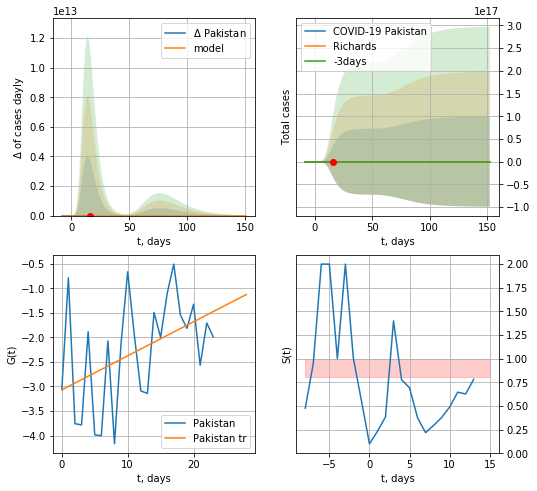

Pakistan data at: 2020-07-15
+3 day model MAPE: 0.118161
model: Richards
coeffs: [ 1.63793589e+03  6.01089634e+00 -3.06352612e+00  3.22292207e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 44401640452651.890625
forecast at the end of period: +136 days
	 deltaDaycases: 0
	 total cases: 2227 ± 98904080194584016
	 total death: 46 ± 6127426382465961
trend coefficient of determination: 0.194246
 intercept: -3.069579
 slope: 0.069356


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


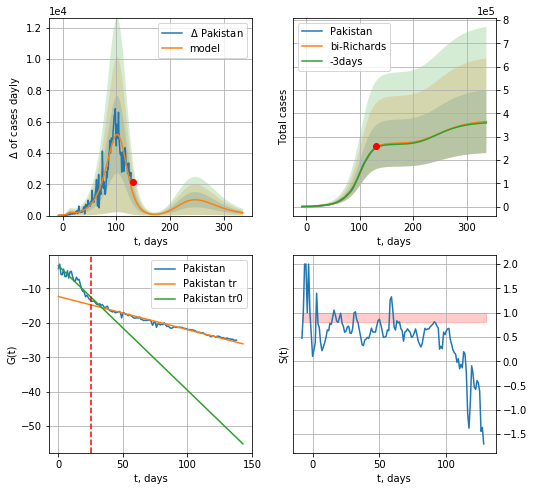

Pakistan data at: 2020-07-15
+3 day model MAPE: 0.010051
model: bi-Richards
coeffs: [2.70906925e+05 5.59434088e-02 1.07314007e+02 1.62667981e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.370611
forecast at the end of period: +206 days
	 deltaDaycases: 178
	 total cases: 364843 ± 135214
	 total death: 7675 ± 8533
bi-Richards approximation splitting point: 25
trend coefficient of determination: 0.841905
 intercept: -3.469881
 slope: -0.361110
trend coefficient of determination: 0.974851
 intercept: -12.405341
 slope: -0.095841


In [387]:
vL = 25
x = forecastRR('Pakistan',dfPS[:vL],d1,35*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
xx = forecast2RR('Pakistan',dfPS[:],d1,45*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR('Pakistan',dfPS[:],d1,48*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

BN
           date     cases  active   death
125 2020-07-11  183795.0   87829  2352.0
126 2020-07-12  186894.0   86186  2391.0
127 2020-07-13  190057.0   84406  2424.0
128 2020-07-14  193590.0   85610  2457.0
129 2020-07-15  193590.0   85610  2457.0


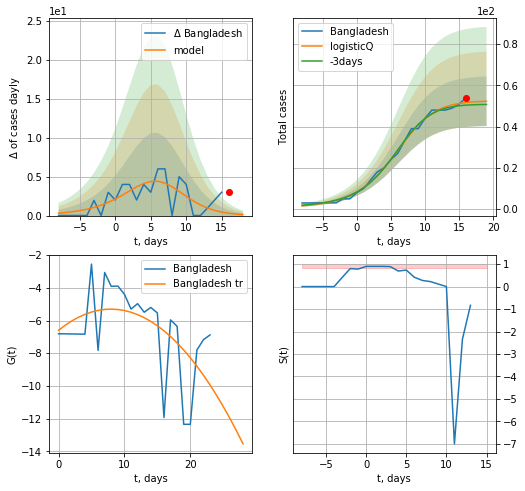

Bangladesh data at: 2020-07-15
+3 day model MAPE: 0.027574
model: logisticQ
coeffs: [ 5.24923176e+01  5.83632898e-03  5.49442770e+00 -5.18799455e+01]
rational stdev: 0.229670
forecast at the end of period: +3 days
	 deltaDaycases: 0
	 total cases: 52 ± 12
	 total death: 0 ± 0
trend coefficient of determination: 0.276192
 intercept_: -6.599187027141191
 coeffs_: [ 0.          0.32583568 -0.02049035]
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:571: RuntimeWarning: divide by zero encountered in log


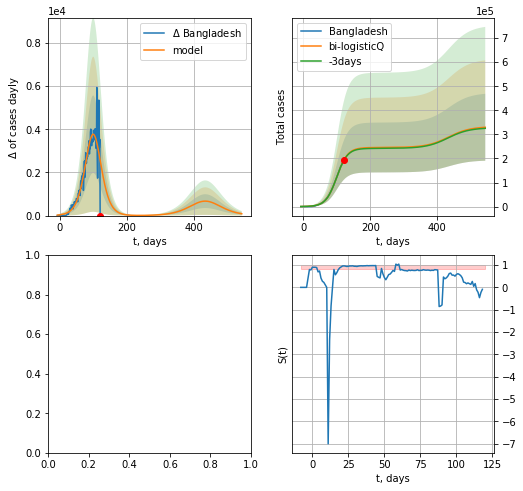

In [388]:
dfBN = read_df(pd.DataFrame(),"BN")
vL= 25
try:
    x = forecastRRR('Bangladesh',dfBN[:vL],d1,16*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
    xx = forecast2RRR('Bangladesh',dfBN[:],d1,76*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


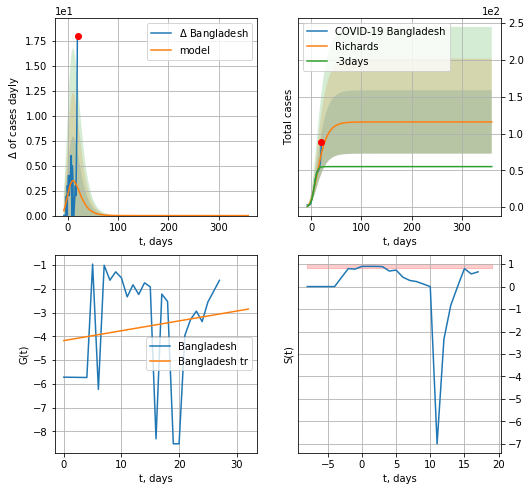

Bangladesh data at: 2020-07-14
+3 day model MAPE: 0.373626
model: Richards
coeffs: [ 1.15736925e+02  6.45824667e+00 -4.20178539e+01  1.27654554e-02]
rational stdev: 0.371727
forecast at the end of period: +340 days
	 deltaDaycases: 0
	 total cases: 115 ± 43
	 total death: 1 ± 1
trend coefficient of determination: 0.020746
 intercept: -4.180817
 slope: 0.041430


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


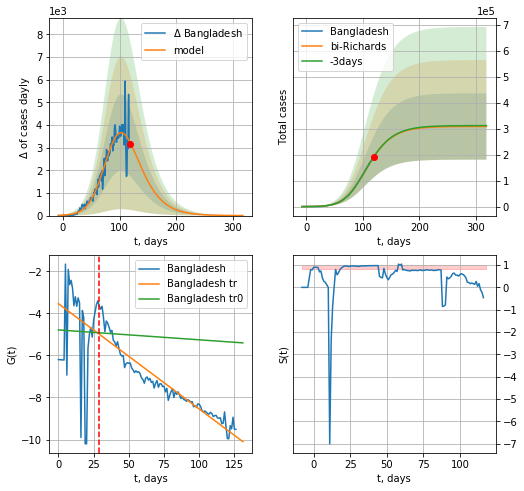

Bangladesh data at: 2020-07-14
+3 day model MAPE: 0.001226
model: bi-Richards
coeffs: [3.08291320e+05 8.80670007e-02 8.26384671e+01 4.45588180e-01]
rational stdev: 0.413846
forecast at the end of period: +200 days
	 deltaDaycases: 2
	 total cases: 308342 ± 127606
	 total death: 3932 ± 4881
bi-Richards approximation splitting point: 29
trend coefficient of determination: 0.000305
 intercept: -4.787517
 slope: -0.004699
trend coefficient of determination: 0.914952
 intercept: -3.540206
 slope: -0.050074


In [416]:
vL=29
x = forecastRR('Bangladesh',dfBN[:vL],d1,64*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Bangladesh',dfBN[:-1],d1,44*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR('Bangladesh',dfBN[:],d1,16*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

KW
           date    cases  active  death
138 2020-07-11  54058.0    9711  386.0
139 2020-07-12  54894.0    9894  390.0
140 2020-07-13  55508.0    9759  393.0
141 2020-07-14  56174.0    9617  396.0
142 2020-07-15  56877.0    9581  399.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


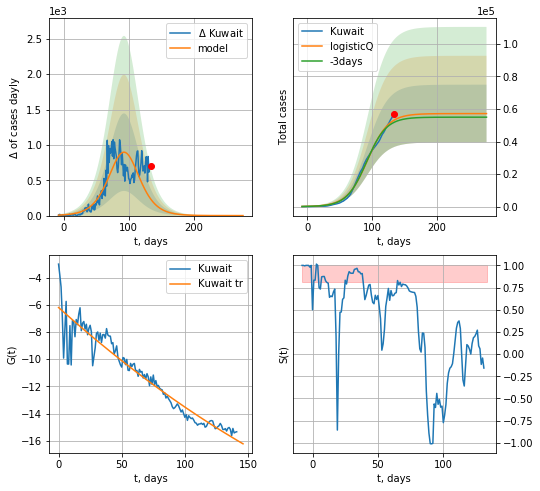

Kuwait data at: 2020-07-15
+3 day model MAPE: 0.026001
model: logisticQ
coeffs: [ 5.71727841e+04  3.50809219e-07  9.32055771e+01 -1.78844205e+05]
rational stdev: 0.310590
forecast at the end of period: +143 days
	 deltaDaycases: 0
	 total cases: 57172 ± 17757
	 total death: 401 ± 373
trend coefficient of determination: 0.914180
 intercept_: -6.198070008376092
 coeffs_: [ 0.00000000e+00 -8.32317707e-02  9.95209706e-05]


In [389]:
dfKW = read_df(pd.DataFrame(),"KW")
x = forecastRRR('Kuwait',dfKW[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


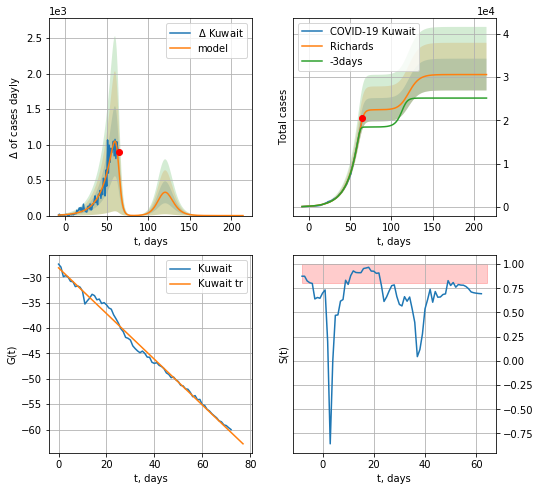

Kuwait data at: 2020-07-15
+3 day model MAPE: 0.136559
model: Richards
coeffs: [2.24365721e+04 7.66634185e-02 6.43548410e+01 5.72971743e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.119998
forecast at the end of period: +150 days
	 deltaDaycases: 0
	 total cases: 30568 ± 3668
	 total death: 214 ± 77
trend coefficient of determination: 0.993036
 intercept: -28.143718
 slope: -0.450232


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


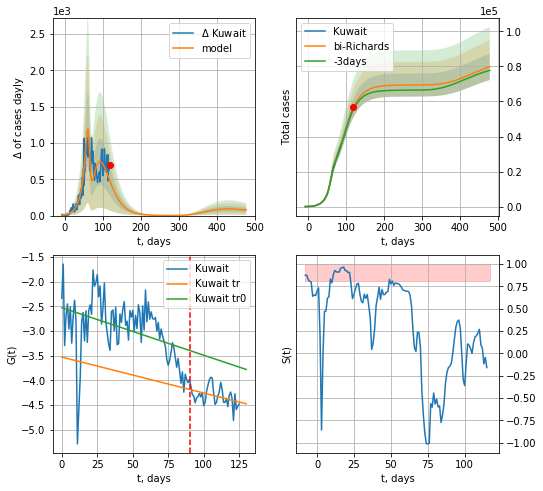

Kuwait data at: 2020-07-15
+3 day model MAPE: 0.013140
model: bi-Richards
coeffs: [ 4.69479635e+04  5.56443990e+00 -1.92220733e+01  7.77212797e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.094758
forecast at the end of period: +360 days
	 deltaDaycases: 75
	 total cases: 79794 ± 7561
	 total death: 559 ± 158
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.164163
 intercept: -2.526275
 slope: -0.009627
trend coefficient of determination: 0.156110
 intercept: -3.526873
 slope: -0.007272


In [390]:
iL= 16
vL = 90 + iL
x = forecastRR('Kuwait',dfKW[iL:vL-iL],d1,37*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
xx = forecast2RR('Kuwait',dfKW[iL:],d1,67*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL-iL)

DM
           date    cases  active  death
132 2020-07-11  43114.0   21238  880.0
133 2020-07-12  44532.0   22176  897.0
134 2020-07-13  45506.0   22162  903.0
135 2020-07-14  46305.0   22261  910.0
136 2020-07-15  47671.0   23283  929.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


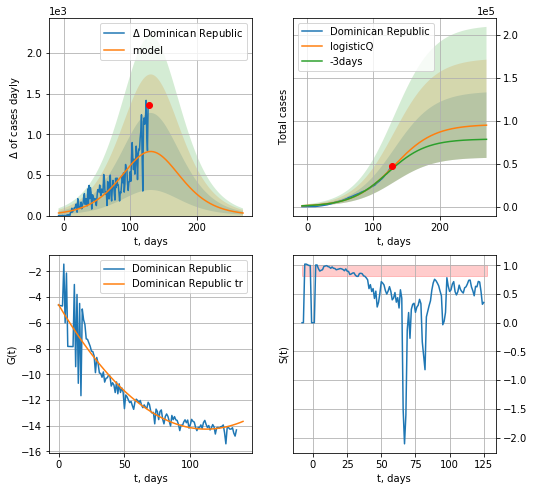

Dominican Republic data at: 2020-07-15
+3 day model MAPE: 0.036975
model: logisticQ
coeffs: [ 9.58868204e+04  4.96953291e-07  1.31354834e+02 -6.61147597e+04]
rational stdev: 0.402224
forecast at the end of period: +143 days
	 deltaDaycases: 31
	 total cases: 94939 ± 38186
	 total death: 1850 ± 2232
trend coefficient of determination: 0.886353
 intercept_: -4.583786209855647
 coeffs_: [ 0.         -0.17269781  0.00077055]


In [391]:
dfDM = read_df(pd.DataFrame(),"DM")
x = forecastRRR('Dominican Republic',dfDM[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


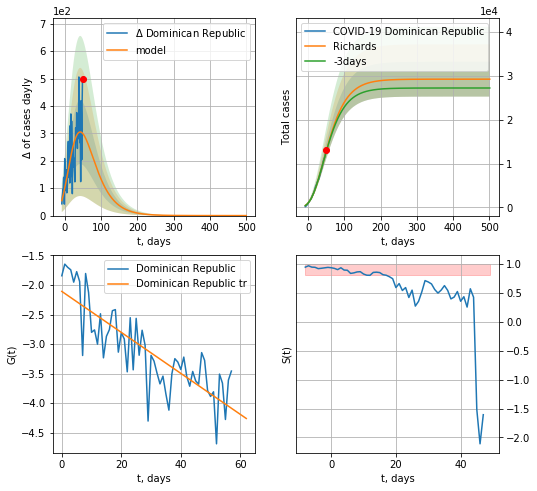

Dominican Republic data at: 2020-07-15
+3 day model MAPE: 0.011985
model: Richards
coeffs: [ 2.92637494e+04  1.52418321e+00 -9.56908405e+01  1.87788232e-02]
rational stdev: 0.135750
forecast at the end of period: +451 days
	 deltaDaycases: 0
	 total cases: 29263 ± 3972
	 total death: 570 ± 232
trend coefficient of determination: 0.671300
 intercept: -2.108308
 slope: -0.034707


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


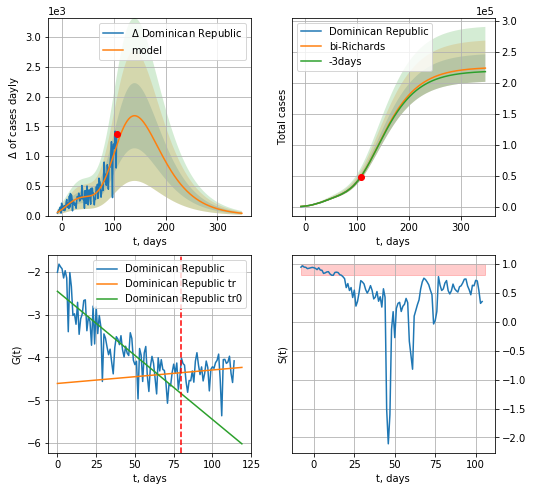

Dominican Republic data at: 2020-07-15
+3 day model MAPE: 0.001519
model: bi-Richards
coeffs: [1.95933346e+05 4.73154377e-01 1.23119042e+01 4.89910137e-02]
rational stdev: 0.099087
forecast at the end of period: +241 days
	 deltaDaycases: 38
	 total cases: 223530 ± 22149
	 total death: 4356 ± 1294
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.745661
 intercept: -2.455214
 slope: -0.029942
trend coefficient of determination: 0.011462
 intercept: -4.607922
 slope: 0.003150


In [392]:
vL = 80+21
x = forecastRR('Dominican Republic',dfDM[21:vL-21],d1,80*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Dominican Republic',dfDM[21:],d1,50*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-21)

MD
           date    cases  active  death
126 2020-07-11  19208.0    5900  641.0
127 2020-07-12  19382.0    6073  642.0
128 2020-07-13  19439.0    5997  649.0
129 2020-07-14  19708.0    6020  655.0
130 2020-07-15  20040.0    6083  659.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


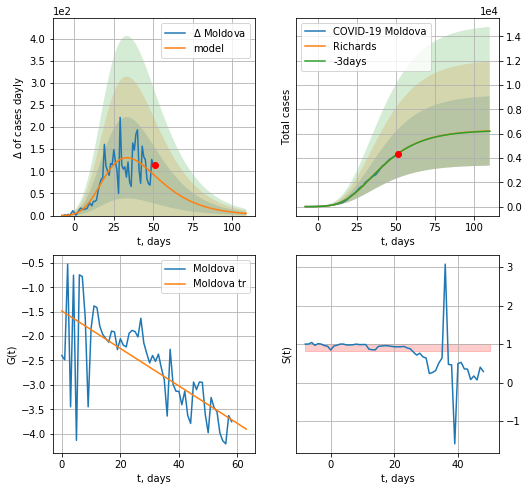

Moldova data at: 2020-07-15
+3 day model MAPE: 0.000788
model: Richards
coeffs: [ 6.30547574e+03  3.98849226e+00 -4.11476415e+01  1.42380272e-02]
rational stdev: 0.458349
forecast at the end of period: +59 days
	 deltaDaycases: 4
	 total cases: 6223 ± 2852
	 total death: 204 ± 280
trend coefficient of determination: 0.512179
 intercept: -1.485671
 slope: -0.038427


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


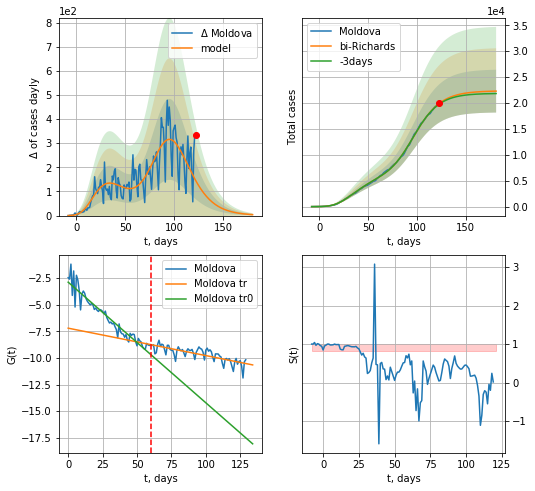

Moldova data at: 2020-07-15
+3 day model MAPE: 0.006321
model: bi-Richards
coeffs: [1.60436247e+04 1.09382692e-01 8.90183347e+01 6.13086273e-01]
rational stdev: 0.185361
forecast at the end of period: +59 days
	 deltaDaycases: 3
	 total cases: 22292 ± 4132
	 total death: 733 ± 407
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.909620
 intercept: -2.881263
 slope: -0.113362
trend coefficient of determination: 0.590919
 intercept: -7.204061
 slope: -0.025759


In [393]:
dfMD = read_df(pd.DataFrame(),"MD")
dfMD = dfMD.fillna(0)
try:
    vL = 60
    x = forecastRR("Moldova",dfMD[:vL],d1,24*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RR("Moldova",dfMD[:],d1,24*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
except:
    print("Exception occurs")

In [385]:
#np.diff(dfAF["cases"])

AF
           date     cases  active   death
128 2020-07-11  264184.0  132498  3971.0
129 2020-07-12  276242.0  137289  4079.0
130 2020-07-13  287796.0  145383  4172.0
131 2020-07-14  298292.0  147667  4346.0
132 2020-07-15  311049.0  145903  4453.0


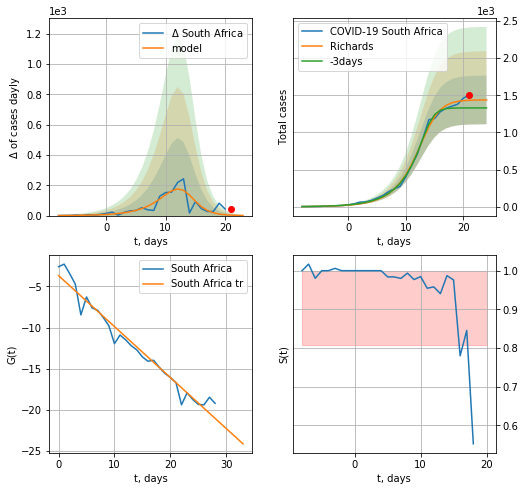

South Africa data at: 2020-07-15
+3 day model MAPE: 0.079443
model: Richards
coeffs: [1.43832007e+03 3.09188728e-01 1.37785508e+01 2.13840807e+00]
rational stdev: 0.227967
forecast at the end of period: +3 days
	 deltaDaycases: 0
	 total cases: 1437 ± 327
	 total death: 20 ± 13
trend coefficient of determination: 0.961533
 intercept: -3.675972
 slope: -0.619731


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


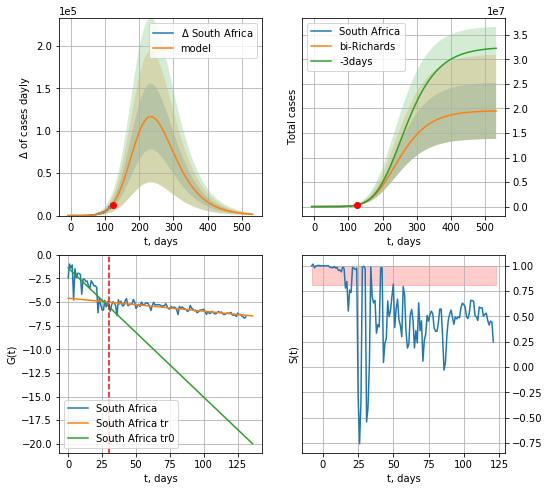

South Africa data at: 2020-07-15
+3 day model MAPE: 0.006865
model: bi-Richards
coeffs: [1.95849511e+07 6.87056822e-02 1.62271891e+02 2.66848883e-01]
rational stdev: 0.292613
forecast at the end of period: +409 days
	 deltaDaycases: 1509
	 total cases: 19504612 ± 5707311
	 total death: 279229 ± 245118
bi-Richards approximation splitting point: 30
trend coefficient of determination: 0.645877
 intercept: -1.382198
 slope: -0.136913
trend coefficient of determination: 0.703865
 intercept: -4.590188
 slope: -0.013798


In [394]:
dfAF = read_df(pd.DataFrame(),"AF").fillna(0)
#dfAF = dfAF.fillna(0)
try:
    vL = 30
    x = forecastRR("South Africa",dfAF[:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RR("South Africa",dfAF[:],d1,74*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
except:
    print("Exception occurs")

UB
           date  cases  active  death
117 2020-07-10  12027       0      0
118 2020-07-11  12513       0      0
119 2020-07-12  12997       0      0
120 2020-07-13  13591       0      0
121 2020-07-14  14085       0      0


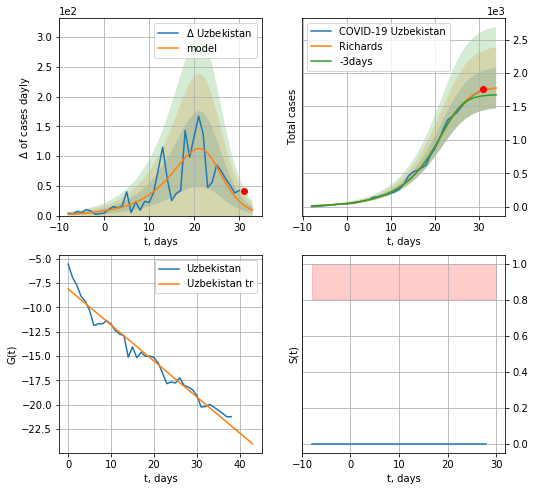

Uzbekistan data at: 2020-07-15
+3 day model MAPE: 0.052919
model: Richards
coeffs: [1.79903079e+03 1.50177262e-01 2.40151288e+01 2.34125894e+00]
rational stdev: 0.171151
forecast at the end of period: +3 days
	 deltaDaycases: 9
	 total cases: 1776 ± 304
	 total death: 8 ± 4
trend coefficient of determination: 0.964542
 intercept: -8.119482
 slope: -0.369654


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


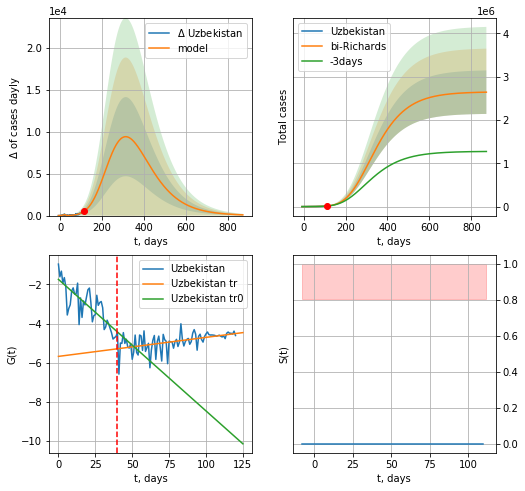

Uzbekistan data at: 2020-07-15
+3 day model MAPE: 0.022479
model: bi-Richards
coeffs: [2.64770615e+06 7.80305075e-02 1.16851254e+02 1.32182601e-01]
rational stdev: 0.190091
forecast at the end of period: +759 days
	 deltaDaycases: 85
	 total cases: 2641220 ± 502072
	 total death: 12860 ± 7333
bi-Richards approximation splitting point: 40
trend coefficient of determination: 0.635852
 intercept: -1.746397
 slope: -0.067152
trend coefficient of determination: 0.245507
 intercept: -5.678367
 slope: 0.009709


In [395]:
dfUB = read_df(pd.DataFrame(),"UB").fillna(0)
#dfAF = dfAF.fillna(0)
try:
    vL = 40
    x = forecastRR("Uzbekistan",dfUB[:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RR("Uzbekistan",dfUB[:],d1,124*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
except:
    print("Exception occurs")

In [350]:
cD = {
    "Romania": ["RM",5,4*7],
    #"Finland":"FI",
    "India":["ID",5,6*7],
    "Ecuador":["ED",5,4*7],
    "Philippines":["PH",5,4*7],
    #"Pakistan":"PK",
#    "Luxembourg":"LX",
#    "Saudi Arabia":["SA",5,4*7],
    "Thailand":["TH",5,4*7],
    "Indonesia":["IE",5,16*7],
    "Mexico":["MX",5,8*7],
    "Panama":["PM",12,12*7],
    "Peru":["PU",5,4*7],
    "Serbia":["SB",5,4*7],
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":["UAE",5,8*7],
    "Argentina":["AG",5,8*7],
    "Iceland":["IC",5,4*7],
    "Colombia":["CB",10,16*7],
    "Qatar":["QR",5,6*7],
    "Algeria":["AR",5,16*7],
    "Croatia":["CT",0,12*7],
    "Egypt":["EG",5,4*7],
    "Slovenia":["SV",12,6*7],
    "Morocco":["MR",5,4*7],
    "Iraq":["IQ",2,8*7]
#    "Hong Kong":"HK"
}

dfArray = [dfRM,dfID,dfED,dfPH,dfTH,dfIE,dfMX,dfPM,dfPU,dfSB,dfAG,dfIC,dfCB,dfQR,dfAG,dfCT,dfEG,dfSV,dfMR,dfIQ]
for c,adf in zip(cD,dfArray):
    if c in ["Qatar","Peru","Argentina","Iraq","India","Philippines","Indonesia","Finland","Luxembourg","Ecuador","Thailand","Morocco","Romania","Iceland","Panama","Colombia","Mexico","Algeria", "Croatia","Slovenia","Egypt","Serbia"]:
        continue
    print (c)
    idS = cD[c][1]
    ipd = cD[c][2]
    x = forecast(c,adf[idS:],d1,ipd-dT)
    #xx = forecast2(c,adf[:],d1,ipd-dT,x)

In [12]:
import requests
import lxml.html as lh
#url='https://www.worldometers.info/coronavirus/#countries'#Create a handle, page, to handle the contents of the website
url='https://www.worldometers.info/coronavirus/#nav-today'
page = requests.get(url)#Store the contents of the website under doc
doc = lh.fromstring(page.content)#Parse data that are stored between <tr>..</tr> of HTML
tr_elements = doc.xpath('//tr')
#Check the length of the first 12 rows
print ([len(T) for T in tr_elements[:12]])
tr_elements = doc.xpath('//tr')#Create empty list
col=[]
i=0#For each row, store each first element (header) and an empty list
for t in tr_elements[0]:
    i+=1
    name=t.text_content()
    print ('%d:"%s"'%(i,name))
    col.append((name,[]))
    
#Since out first row is the header, data is stored on the second row onwards
for j in range(1,len(tr_elements)):
    #T is our j'th row
    T=tr_elements[j]
    #print (len(T))
    #If row is not of size 10, the //tr data is not from our table 
    if len(T)!=19:
        break
    
    #i is the index of our column
    i=0
    
    #Iterate through each element of the row
    for t in T.iterchildren():
        data=t.text_content() 
        #Check if row is empty
        if i>0:
        #Convert any numerical value to integers
            try:
                data=int(data)
            except:
                pass
        #Append the data to the empty list of the i'th column
        col[i][1].append(data)
        #Increment i for the next column
        i+=1
    
print ([len(C) for (title,C) in col])
Dict={title:column for (title,column) in col}
df=pd.DataFrame(Dict)

[19, 19, 19, 19, 19, 19, 19, 19, 19, 19, 19, 19]
1:"#"
2:"Country,Other"
3:"TotalCases"
4:"NewCases"
5:"TotalDeaths"
6:"NewDeaths"
7:"TotalRecovered"
8:"NewRecovered"
9:"ActiveCases"
10:"Serious,Critical"
11:"Tot Cases/1M pop"
12:"Deaths/1M pop"
13:"TotalTests"
14:"Tests/
1M pop
"
15:"Population"
16:"Continent"
17:"1 Caseevery X ppl"
18:"1 Deathevery X ppl"
19:"1 Testevery X ppl"
[695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695]


In [13]:
df.head(10)
#df.columns[18]

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,"Country,Other",Deaths/1M pop,NewCases,NewDeaths,NewRecovered,Population,"Serious,Critical",Tests/ 1M pop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,Tot Cases/1M pop
0,,\n,,,"2,052,994",North America,\nNorth America\n,,"+7,151",599,"+5,450",,"19,924",,"4,236,876","190,705","1,993,177",,
1,,\n,,,"879,413",South America,\nSouth America\n,,"+1,351",44,"+111,749",,"13,791",,"3,050,797","110,315","2,061,069",,
2,,\n,,,"852,358",Asia,\nAsia\n,,"+4,613",50,"+7,139",,"19,608",,"3,135,579","73,937","2,209,284",,
3,,\n,,,"869,889",Europe,\nEurope\n,,,,1,,"5,287",,"2,613,810","197,754","1,546,167",,
4,,\n,,,"297,144",Africa,\nAfrica\n,,,,,,990,,"646,973","14,029","335,800",,
5,,\n,,,"2,703",Australia/Oceania,\nOceania\n,,324,2,108,,30,,"12,479",135,"9,641",,
6,,\n,,,55,,\n\n,,,,,,4,,721,15,651,,
7,,\n,,,"4,954,556",All,World,75.3,"+13,439",695,"+124,447",,"59,634",,"13,697,235","586,890","8,155,789",,"1,757"
8,1,92,"2,363",7,"1,830,645",North America,USA,423,,,,"331,081,677","16,459","135,450","3,616,747","140,140","1,645,962","44,844,982","10,924"
9,2,108,"2,815",43,"528,611",South America,Brazil,355,,,"+111,211","212,620,008","8,318","23,098","1,970,909","75,523","1,366,775","4,911,063","9,270"


In [14]:
#df.rename(columns={"Country,Other":"Country",df.columns[9]:"TotDeathsper1Mpop"})
df=df.rename(columns={"Country,Other":"Country",'Deaths/1M pop':"Deathsper1Mpop","Serious,Critical":"Serious_Critical",'Tests/\n1M pop\n':"Testsper1Mpop",'Tot\xa0Cases/1M pop':"TotCasesper1Mpop"})
df.head()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,\n,,,"2,052,994",North America,\nNorth America\n,,"+7,151",599,"+5,450",,"19,924",,"4,236,876","190,705","1,993,177",,
1,,\n,,,"879,413",South America,\nSouth America\n,,"+1,351",44,"+111,749",,"13,791",,"3,050,797","110,315","2,061,069",,
2,,\n,,,"852,358",Asia,\nAsia\n,,"+4,613",50,"+7,139",,"19,608",,"3,135,579","73,937","2,209,284",,
3,,\n,,,"869,889",Europe,\nEurope\n,,,,1,,"5,287",,"2,613,810","197,754","1,546,167",,
4,,\n,,,"297,144",Africa,\nAfrica\n,,,,,,990,,"646,973","14,029","335,800",,


In [15]:
df[df["Country"]=="Lithuania"]

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
124,117,"1,445","34,435",6,221,Europe,Lithuania,29,,,,"2,720,387",15,"171,077","1,882",79,"1,582","465,396",692
357,118,"1,445","34,435",6,221,Europe,Lithuania,29,21,,11,"2,720,387",15,"171,077","1,882",79,"1,582","465,396",692
589,118,"1,462","34,435",6,211,Europe,Lithuania,29,,,,"2,720,387",15,"171,077","1,861",79,"1,571","465,396",684


In [16]:
totIdx = np.where(df['ActiveCases']=='ActiveCases')[0][0]
print(totIdx)

231


In [17]:
df.head(45)

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,\n,,,"2,052,994",North America,\nNorth America\n,,"+7,151",599,"+5,450",,"19,924",,"4,236,876","190,705","1,993,177",,
1,,\n,,,"879,413",South America,\nSouth America\n,,"+1,351",44,"+111,749",,"13,791",,"3,050,797","110,315","2,061,069",,
2,,\n,,,"852,358",Asia,\nAsia\n,,"+4,613",50,"+7,139",,"19,608",,"3,135,579","73,937","2,209,284",,
3,,\n,,,"869,889",Europe,\nEurope\n,,,,1,,"5,287",,"2,613,810","197,754","1,546,167",,
4,,\n,,,"297,144",Africa,\nAfrica\n,,,,,,990,,"646,973","14,029","335,800",,
5,,\n,,,"2,703",Australia/Oceania,\nOceania\n,,324,2,108,,30,,"12,479",135,"9,641",,
6,,\n,,,55,,\n\n,,,,,,4,,721,15,651,,
7,,\n,,,"4,954,556",All,World,75.3,"+13,439",695,"+124,447",,"59,634",,"13,697,235","586,890","8,155,789",,"1,757"
8,1,92,"2,363",7,"1,830,645",North America,USA,423,,,,"331,081,677","16,459","135,450","3,616,747","140,140","1,645,962","44,844,982","10,924"
9,2,108,"2,815",43,"528,611",South America,Brazil,355,,,"+111,211","212,620,008","8,318","23,098","1,970,909","75,523","1,366,775","4,911,063","9,270"


In [18]:
df.at[17, 'TotalRecovered'] = 0
df.at[16, 'TotalRecovered'] = 0
df.at[33, 'TotalRecovered'] = 0
df.at[44, 'TotalRecovered'] = 0
df.at[17,"ActiveCases"] = 0
df.at[16,"ActiveCases"] = 0
df.at[33,"ActiveCases"] = 0
df.at[44,"ActiveCases"] = 0
#df.at[12, 'TotalRecovered'] = 0
df = df.fillna(0)

In [19]:
import lxml
def sanitize(data):
    #print (type(data))
    if type(data) == lxml.etree._ElementUnicodeResult:
        data=str(data).strip()
    if str(data).find(',') != -1:
        data = data.replace(',','')
    #print(str(data).find(',') != -1)
    return data
df=df[df.index<totIdx-1]
df["ActiveCases"] = pd.to_numeric(df["ActiveCases"].apply(sanitize))
df["Deathsper1Mpop"] = pd.to_numeric(df["Deathsper1Mpop"].apply(sanitize))
df["NewCases"] = pd.to_numeric(df["NewCases"].apply(sanitize))
df["NewDeaths"] = pd.to_numeric(df["NewDeaths"].apply(sanitize))
df["Serious_Critical"] = pd.to_numeric(df["Serious_Critical"].apply(sanitize))
df["TotalCases"] = pd.to_numeric(df["TotalCases"].apply(sanitize))
df["TotalDeaths"] = pd.to_numeric(df["TotalDeaths"].apply(sanitize))
df["TotalRecovered"] = pd.to_numeric(df["TotalRecovered"].apply(sanitize))
df["TotCasesper1Mpop"] = pd.to_numeric(df["TotCasesper1Mpop"].apply(sanitize))
df["TotalTests"] = pd.to_numeric(df["TotalTests"].apply(sanitize))
df["Testsper1Mpop"] = pd.to_numeric(df["Testsper1Mpop"].apply(sanitize))
df.head(15)

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,\n,,,2052994,North America,\nNorth America\n,NaN,7151.0,599.0,"+5,450",,19924.0,NaN,4236876,190705.0,1993177.0,NaN,NaN
1,,\n,,,879413,South America,\nSouth America\n,NaN,1351.0,44.0,"+111,749",,13791.0,NaN,3050797,110315.0,2061069.0,NaN,NaN
2,,\n,,,852358,Asia,\nAsia\n,NaN,4613.0,50.0,"+7,139",,19608.0,NaN,3135579,73937.0,2209284.0,NaN,NaN
3,,\n,,,869889,Europe,\nEurope\n,NaN,NaN,NaN,1,,5287.0,NaN,2613810,197754.0,1546167.0,NaN,NaN
4,,\n,,,297144,Africa,\nAfrica\n,NaN,NaN,NaN,,,990.0,NaN,646973,14029.0,335800.0,NaN,NaN
5,,\n,,,2703,Australia/Oceania,\nOceania\n,NaN,324.0,2.0,108,,30.0,NaN,12479,135.0,9641.0,NaN,NaN
6,,\n,,,55,,\n\n,NaN,NaN,NaN,,,4.0,NaN,721,15.0,651.0,NaN,NaN
7,,\n,,,4954556,All,World,75.3,13439.0,695.0,"+124,447",,59634.0,NaN,13697235,586890.0,8155789.0,NaN,1757.0
8,1,92,"2,363",7,1830645,North America,USA,423.0,NaN,NaN,,"331,081,677",16459.0,135450.0,3616747,140140.0,1645962.0,44844982.0,10924.0
9,2,108,"2,815",43,528611,South America,Brazil,355.0,NaN,NaN,"+111,211","212,620,008",8318.0,23098.0,1970909,75523.0,1366775.0,4911063.0,9270.0


In [20]:
cLst = countriesEU
ActiveCasesEU = sum([ w for w in df[df['Country'].isin(cLst)].ActiveCases if w>0])
CountryEU = "European Union" 
Deathsper1MpopEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])/445.250514
NewCasesEU = sum([w for w in df[df['Country'].isin(cLst)].NewCases if w>0 ])
NewDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].NewDeaths if w>0])
Serious_CriticalEU = sum([w for w in df[df['Country'].isin(cLst)].Serious_Critical if w>0])
Testsper1MpopEU = sum([ w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])/445.250514
TotalCasesEu = sum([w for w in df[df['Country'].isin(cLst)].TotalCases if w>0])
TotalDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])
TotalRecoveredEU = sum([w for w in df[df['Country'].isin(cLst)].TotalRecovered if w>0] )
TotalTestsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])
TotCasesper1MpopEU = TotalCasesEu/445.250514

rowEU = {"ActiveCases":ActiveCasesEU,"Continent":"Europe","Country": CountryEU,"Deathsper1Mpop": Deathsper1MpopEU,"NewCases": NewCasesEU,"NewDeaths": NewDeathsEU,"Serious_Critical": Serious_CriticalEU,"Testsper1Mpop": Testsper1MpopEU,"TotalCases": TotalCasesEu,"TotalDeaths": TotalDeathsEU,"TotalRecovered": TotalRecoveredEU,"TotalTests": TotalTestsEU,"TotCasesper1Mpop": TotCasesper1MpopEU }
df = df.append(rowEU, ignore_index=True)
df.tail()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
226,,,,,869889,Europe,Total:,NaN,NaN,NaN,,,5287.0,NaN,2613810,197754.0,1546167.0,NaN,NaN
227,,,,,297144,Africa,Total:,NaN,NaN,NaN,,,990.0,NaN,646973,14029.0,335800.0,NaN,NaN
228,,,,,2703,Australia/Oceania,Total:,NaN,324.0,2.0,108,,30.0,NaN,12479,135.0,9641.0,NaN,NaN
229,,,,,55,,Total:,NaN,NaN,NaN,,,4.0,NaN,721,15.0,651.0,NaN,NaN
230,NaN,NaN,NaN,NaN,167965,Europe,European Union,302.75316,0.0,0.0,NaN,NaN,2040.0,76490.274417,1348030,134801.0,653067.0,34057334.0,3027.576516


In [21]:
#df['Reported1st case'] = df['Reported1st case'].map(lambda x: x.lstrip('\n'))
df["Country"] = df["Country"].str.strip('\n')
df.head()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,\n,,,2052994,North America,North America,NaN,7151.0,599.0,"+5,450",,19924.0,NaN,4236876,190705.0,1993177.0,NaN,NaN
1,,\n,,,879413,South America,South America,NaN,1351.0,44.0,"+111,749",,13791.0,NaN,3050797,110315.0,2061069.0,NaN,NaN
2,,\n,,,852358,Asia,Asia,NaN,4613.0,50.0,"+7,139",,19608.0,NaN,3135579,73937.0,2209284.0,NaN,NaN
3,,\n,,,869889,Europe,Europe,NaN,NaN,NaN,1,,5287.0,NaN,2613810,197754.0,1546167.0,NaN,NaN
4,,\n,,,297144,Africa,Africa,NaN,NaN,NaN,,,990.0,NaN,646973,14029.0,335800.0,NaN,NaN


In [22]:
#totIdx0 = np.where(df['Country']=='Total:')[0][0]
#df.at[totIdx0,'Country'] = 'World'

In [23]:
#df

In [24]:
#df[df['Country'].isnull()]
#df['Country']=df['Country'].dropna()
##for idx in df['Country'].isnull():
##    #print(idx)
##    if idx == True:
##        ind = df[df['Country'].isnull()].index[0]
##        df = df.drop(df.index[ind])
df = df.drop(df.index[6])
df.head(10)

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,\n,,,2052994,North America,North America,NaN,7151.0,599.0,"+5,450",,19924.0,NaN,4236876,190705.0,1993177.0,NaN,NaN
1,,\n,,,879413,South America,South America,NaN,1351.0,44.0,"+111,749",,13791.0,NaN,3050797,110315.0,2061069.0,NaN,NaN
2,,\n,,,852358,Asia,Asia,NaN,4613.0,50.0,"+7,139",,19608.0,NaN,3135579,73937.0,2209284.0,NaN,NaN
3,,\n,,,869889,Europe,Europe,NaN,NaN,NaN,1,,5287.0,NaN,2613810,197754.0,1546167.0,NaN,NaN
4,,\n,,,297144,Africa,Africa,NaN,NaN,NaN,,,990.0,NaN,646973,14029.0,335800.0,NaN,NaN
5,,\n,,,2703,Australia/Oceania,Oceania,NaN,324.0,2.0,108,,30.0,NaN,12479,135.0,9641.0,NaN,NaN
7,,\n,,,4954556,All,World,75.3,13439.0,695.0,"+124,447",,59634.0,NaN,13697235,586890.0,8155789.0,NaN,1757.0
8,1,92,"2,363",7,1830645,North America,USA,423.0,NaN,NaN,,"331,081,677",16459.0,135450.0,3616747,140140.0,1645962.0,44844982.0,10924.0
9,2,108,"2,815",43,528611,South America,Brazil,355.0,NaN,NaN,"+111,211","212,620,008",8318.0,23098.0,1970909,75523.0,1366775.0,4911063.0,9270.0
10,3,"1,423","55,378",108,331505,Asia,India,18.0,NaN,NaN,,"1,380,530,110",8944.0,9228.0,970169,24929.0,613735.0,12739490.0,703.0


In [25]:
df.to_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)), index=False)

In [26]:
countryDic = {
  "USA": "US",
"Italy":"IT",
"Spain":"SP",
"Germany":"GR",
"France":"FR",
"Iran":"IN",
"UK":"GB",
"Switzerland":"SZ",
"S. Korea":"KR",
"Norway":"NG",
"Sweden":"SW",
"Israel":"IS",
"Denmark":"DK",
"Poland":"PL",
"Estonia":"ES",
"Ukraine":"Ukr",
"Latvia":"LV",
    "Lithuania":"LT",
    "China":"CN",
    "USA":"US",
    "Russia":"RS",
    "Japan":"JP",
    "Netherlands":"NL",
    "Belgium":"BG",
    "Singapore":"SG",
    "Austria":"AT",
    "Turkey":"TR",
    "Canada":"CA",
    "Portugal":"PT",
    "World":"World",
    "Australia":"AS",
    "Brazil":"BZ",
    "Malaysia":"ML",
    "New Zealand":"ZL",
    "Belarus":"BR",
    "Ireland":"IR",
    "Chile":"CL",
    "Czechia":"CH",
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
#    "Pakistan":"PK",
    "Luxembourg":"LX",
    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
    "South Africa":"AF",
    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "European Union":"EU",
    "Bulgaria":"BL",
    "Hungary":"HG",
    "Malta":"MT",
    "Slovakia":"SL",
    "Cyprus":"CP",
    "Greece":"GC",
    "Dominican Republic":"DM",
    "Kuwait":"KW",
    "Bangladesh":"BN",
    "Sri Lanka":"Sri",
    "Pakistan":"PS",
    "Moldova":"MD"
#    "Hong Kong":"HK"
}
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)

for c in countryDic:
    print (c,countryDic[c])

Peru PU
Turkey TR
Latvia LV
Sweden SW
Colombia CB
Netherlands NL
Bulgaria BL
Italy IT
S. Korea KR
Morocco MR
Panama PM
Qatar QR
UAE UAE
Mexico MX
Moldova MD
Australia AS
Chile CL
Austria AT
Lithuania LT
South Africa AF
Iceland IC
Indonesia IE
Ecuador ED
China CN
Belgium BG
Pakistan PS
Thailand TH
India ID
UK GB
Estonia ES
Romania RM
Dominican Republic DM
Cyprus CP
France FR
Argentina AG
Malta MT
Finland FI
Kuwait KW
Norway NG
Canada CA
Philippines PH
Saudi Arabia SA
Russia RS
Sri Lanka Sri
Brazil BZ
Algeria AR
Slovakia SL
Singapore SG
Hungary HG
Malaysia ML
Bangladesh BN
Serbia SB
Denmark DK
Iran IN
European Union EU
Poland PL
Luxembourg LX
Portugal PT
Belarus BR
USA US
Spain SP
Greece GC
Slovenia SV
Ukraine Ukr
Ireland IR
World World
Germany GR
Egypt EG
New Zealand ZL
Croatia CT
Japan JP
Iraq IQ
Switzerland SZ
Israel IS
Czechia CH


In [27]:
len(countryDic)

75

In [28]:
df = pd.read_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)),',')
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)
from datetime import date, timedelta
for c in df.Country: 
    #if c!='European Union':
    #    continue
    f = open("data/tmp/corona%sOneRaw.csv"%(c),'w')
    #print ("corona%sOneRaw.csv"%(c),date.today()- timedelta(days=1),c,df[df.Country == c].TotalCases.values[0])
    print(c)
    if c!='World':
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    else:
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    f.close()

North America
North America 2020-07-15,4236876,2052994,190705.0
South America
South America 2020-07-15,3050797,879413,110315.0
Asia
Asia 2020-07-15,3135579,852358,73937.0
Europe
Europe 2020-07-15,2613810,869889,197754.0
Africa
Africa 2020-07-15,646973,297144,14029.0
Oceania
Oceania 2020-07-15,12479,2703,135.0
World
World 2020-07-15,13697235,4954556,586890.0
USA
USA 2020-07-15,3616747,1830645,140140.0
Brazil
Brazil 2020-07-15,1970909,528611,75523.0
India
India 2020-07-15,970169,331505,24929.0
Russia
Russia 2020-07-15,746369,211350,11770.0
Peru
Peru 2020-07-15,337724,98907,12417.0
Chile
Chile 2020-07-15,321205,21934,7186.0
Mexico
Mexico 2020-07-15,317635,81600,36906.0
South Africa
South Africa 2020-07-15,311049,145903,4453.0
Spain
Spain 2020-07-15,304574,0,28413.0
UK
UK 2020-07-15,291911,0,45053.0
Iran
Iran 2020-07-15,264561,23590,13410.0
Pakistan
Pakistan 2020-07-15,257914,73751,5426.0
Italy
Italy 2020-07-15,243506,12493,34997.0
Saudi Arabia
Saudi Arabia 2020-07-15,240474,55101,2325.0
T

Timor-Leste 2020-07-15,24,0,nan
Grenada
Grenada 2020-07-15,23,0,nan
New Caledonia
New Caledonia 2020-07-15,22,1,nan
Saint Lucia
Saint Lucia 2020-07-15,22,3,nan
Laos
Laos 2020-07-15,19,0,nan
Dominica
Dominica 2020-07-15,18,0,nan
Saint Kitts and Nevis
Saint Kitts and Nevis 2020-07-15,17,2,nan
Falkland Islands
Falkland Islands 2020-07-15,13,0,nan
Greenland
Greenland 2020-07-15,13,0,nan
Montserrat
Montserrat 2020-07-15,12,1,1.0
Vatican City
Vatican City 2020-07-15,12,0,nan
Papua New Guinea
Papua New Guinea 2020-07-15,11,3,nan
Western Sahara
Western Sahara 2020-07-15,10,1,1.0
MS Zaandam
MS Zaandam 2020-07-15,9,7,2.0
Caribbean Netherlands
Caribbean Netherlands 2020-07-15,9,2,nan
British Virgin Islands
British Virgin Islands 2020-07-15,8,0,1.0
St. Barth
St. Barth 2020-07-15,6,0,nan
Anguilla
Anguilla 2020-07-15,3,0,nan
Saint Pierre Miquelon
Saint Pierre Miquelon 2020-07-15,2,1,nan
China
China 2020-07-15,83612,259,4634.0
Total:
Total: 2020-07-15,4236876,2052994,190705.0
Total:
Total: 2020-07-15

In [29]:
#c='World'
#print(c,"%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0]))

In [30]:
for c in countryDic: 
    #if c not in ['European Union']:
    #    continue
    ff = open("data/tmp/corona%sOneRaw.csv"%(c),'r')
    fff = open("data/corona%s.csv"%(countryDic[c]),'a')
    for l in ff:
        #print(c,l)
        print("append data/corona%s.csv"%(countryDic[c]),"%s"%(l))
        fff.write(l)
    ff.close()
    fff.close()

append data/coronaPU.csv 2020-07-15,337724,98907,12417.0

append data/coronaTR.csv 2020-07-15,215940,12788,5419.0

append data/coronaLV.csv 2020-07-15,1178,125,31.0

append data/coronaSW.csv 2020-07-15,76492,0,5572.0

append data/coronaCB.csv 2020-07-15,165169,87619,5814.0

append data/coronaNL.csv 2020-07-15,51252,0,6136.0

append data/coronaBL.csv 2020-07-15,7877,3747,289.0

append data/coronaIT.csv 2020-07-15,243506,12493,34997.0

append data/coronaKR.csv 2020-07-15,13612,925,291.0

append data/coronaMR.csv 2020-07-15,16262,2182,259.0

append data/coronaPM.csv 2020-07-15,49243,22844,982.0

append data/coronaQR.csv 2020-07-15,104983,3195,151.0

append data/coronaUAE.csv 2020-07-15,55848,9095,335.0

append data/coronaMX.csv 2020-07-15,317635,81600,36906.0

append data/coronaMD.csv 2020-07-15,20040,6083,659.0

append data/coronaAS.csv 2020-07-15,10810,2662,113.0

append data/coronaCL.csv 2020-07-15,321205,21934,7186.0

append data/coronaAT.csv 2020-07-15,19154,1269,710.0

append data/c

In [21]:
import pandas as pd
import io
import requests
url="https://opendata.ecdc.europa.eu/covid19/casedistribution/csv"
s=requests.get(url).content
#print (s)
dfc=pd.read_csv(io.StringIO(s.decode(encoding='windows-1252')))
dfc.to_csv("data/europa_corona.csv", index=False)

In [ ]:
countryDic1 = {
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
    "Pakistan":"PK",
    "Luxembourg":"LX",
#    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "Bulgaria":"BL"
#    "Hong Kong":"HK"
}
countryDic2 = {
    "Austria":"AT",
    "Italy":"IT",
    "Belgium":"BG",
    "Latvia":"LV",
    "Bulgaria":"BL",
    "Lithuania":"LT",
    "Croatia":"CT",
    "Luxembourg":"LX",
    "Cyprus":"CP",
    "Malta":"MT",
    "Czechia":"CH",
    "Netherlands":"NL",
    "Denmark":"DK",
    "Poland":"PL",
    "Estonia":"ES",
    "Portugal":"PT",
    "Finland":"FI",
    "Romania":"RM",
    "France":"FR",
    "Slovakia":"SL",
    "Germany":"GR",
    "Slovenia":"SV",
    "Greece":"GC",
    "Spain":"SP",
    "Hungary":"HG",
    "Sweden":"SW",
    "Ireland":"IR"      
}
cD3 = {"Malta":"MT","Slovakia":"SL","Greece":"GC","Hungary":"HG","Cyprus":"CP","South Africa":"SAF"}
    
for  c in cD3:#countryDic1:
    if c != "South Africa":
        continue
    dfc = pd.read_csv("europa_corona.csv",",")
    dfc = dfc[dfc['countriesAndTerritories']==c].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
    print(c,sum(dfc["cases"].values))
    dfc=dfc.rename(columns={"dateRep":"date"})
    dfc = dfc[dfc["cases"]>0]
    dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
    #dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
    dfc["cases"]=np.cumsum(dfc["cases"].values)
    dfc[['date', 'cases']].to_csv('data/corona%s.csv'%(cD3[c]), index=False)#countryDic1

In [ ]:
#dfRM = read_df(pd.DataFrame(),"RM")

In [ ]:
dfc.head()#[['date', 'cases']]

In [ ]:
date(2012, 3, 16)

In [ ]:
len(countriesEU)

In [ ]:
dfc = pd.read_csv("europa_corona.csv",",")
cLst = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania","Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands","Denmark","Poland","Estonia","Portugal","Finland","Romania","France","Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
dfc = dfc[dfc['countriesAndTerritories'].isin(cLst)].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
print(c,sum(dfc["cases"].values))
dfc=dfc.rename(columns={"dateRep":"date"})
dfc = dfc[dfc["cases"]>0]
dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
#dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
dfc["cases"]=np.cumsum(dfc["cases"].values)
dfc[['date', 'cases']].to_csv('/home/algiz/Desktop/corona%s.csv'%("EU"), index=False)

In [ ]:
#subsetDataFrame = dfObj[dfObj['Product'].isin(['Mangos', 'Grapes']) ]

#dfD = dfAll[dfAll['Country'].isin(cLst)].TotalTests


In [ ]:
#dfD

In [ ]:
#dfAll[dfAll['Country'].isin(cLst)]

In [122]:
TT = sum(dfAll[dfAll.TotalTests>0].TotalTests) - dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]
print(TT,TT/7.7776e3)

87759686.0 11283.646111911128


In [123]:
TT/7.7776e3

11283.646111911128

In [124]:
dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]/(popEU/1e6)

46659.02305954441

In [367]:
sum(dfp.Population)/1e6

16014.157998

In [ ]:
dfAll[dfAll.TotalTests>0]

In [ ]:
cDicEU = {
    "Austria":["AT",dfAT],
    "Italy":["IT",dfIT],
    "Belgium":["BG",dfBG],
    "Latvia":["LV",dfLV],
    "Bulgaria":["BL",dfBL],
    "Lithuania":["LT",dfLT],
    "Croatia":["CT",dfCT],
    "Luxembourg":["LX",dfLX],
    "Cyprus":["CP",dfCP],
    "Malta":["MT",dfMT],
    "Czechia":["CH",dfCH],
    "Netherlands":["NL",dfNL],
    "Denmark":["DK",dfDK],
    "Poland":["PL",dfPL],
    "Estonia":["ES",dfES],
    "Portugal":["PT",dfPT],
    "Finland":["FI",dfFI],
    "Romania":["RM",dfRM],
    "France":["FR",dfFR],
    "Slovakia":["SL",dfSL],
    "Germany":["GR",dfGR],
    "Slovenia":["SV",dfSV],
    "Greece":["GC",dfGC],
    "Spain":["SP",dfSP],
    "Hungary":["HG",dfHG],
    "Sweden":["SW",dfSW],
    "Ireland":["IR",dfIR],
}

In [ ]:
def addDataFrames(f_arg, *argv):
    dfTotal = f_arg
    for arg in argv:
        dfTotal = dfTotal.set_index('date').add(arg.set_index('date'), fill_value = 0)
        dfTotal['date'] = dfTotal.index
    return dfTotal
dfTot = cDicEU["Austria"][1]
for cD in cDicEU:
    if cD == "Austria":
        continue
    dfTot = addDataFrames(dfTot, cDicEU[cD][1])
    
dfTot.to_csv("~/Documents/coronaEU1.csv")

In [ ]:
#cDicEU["Ireland"][1]

In [397]:
dfAll[df["Country"]=="European Union"].TotalTests.values[0]/445.250514

53138.63826331259

In [398]:
dfAll[df["Country"]=="Total:"].TotalTests.values[0]/445

0.0

In [399]:
#dfAll

In [400]:
(sum(dfAll.TotalTests)-dfAll[df["Country"]=="European Union"].TotalTests.values[0])/(7.777e3-445.250514)

14872.243140359802

In [467]:
CList = ["USA",
"Spain", "Italy", "UK", "France", "Germany", "Turkey", "Russia", "Iran", "Brazil", "Canada", "Belgium",
"Peru", "Netherlands", "India", "Switzerland", "Ecuador", "Portugal", "Saudi Arabia", "Sweden", "Ireland",
"Mexico", "Pakistan", "Singapore", "Chile", "Israel", "Austria", "Belarus", "Japan", "Qatar", "Poland",
"UAE", "Romania", "Ukraine", "South_Korea", "Indonesia", "Denmark", "Serbia", "Philippines", "Norway", "Czechia",
"Colombia", "Australia", "Malaysia", "Egypt", "Finland", "Morocco", "Argentina", "Algeria", "Moldova", 
"Luxembourg", "Thailand", "Hungary", "Greece", "Iraq", "Croatia", "Iceland", "Estonia", "Bulgaria",
"New_Zealand", "Slovenia", "Slovakia", "Lithuania", "Latvia", "Cyprus", "Malta","Bangladesh","Kuwait",
"Dominican Republic","Moldova","South Africa","China"         
]

In [468]:
len(CList)

72

In [469]:
popModelled = sum(dfp[dfp["Country (or dependency)"].isin(CList) ].Population)
popModelled

5577035987

In [ ]:
for CItem in CList:
    a = """
    %s
    <br />
    <img src="pictures/covidcases%s35_Q.png" alt="hi" class="inline"/><br /> 

      {%% include_relative _includes/covidcases%s35_Q.txt %%}
          <br /> 
    """%(CItem,CItem,CItem)
    print (a)

In [ ]:
R = (dfLT[:].cases.values/0.9240855762594893).astype(int)+1 -dfLT[:].active.values+dfLT[:].death.values
I = dfLT[:].active.values
S = 1700-R[:]-I
plt.plot(range(len(dfLT)),R,label="R")
plt.plot(range(len(dfLT)),I,label="I")
plt.plot(range(len(dfLT)),S,label="S")
plt.legend()
plt.grid()

In [ ]:
plt.plot(np.multiply(I,S)[1:]/1700,-np.diff(S[:]))
plt.grid()

In [ ]:
plt.plot(np.diff(R[:]),I[1:]/950)
plt.grid()

In [ ]:
plt.plot(np.diff(R[:])+np.diff(I)+np.diff(S))
plt.grid()

In [ ]:
def fS(x0,u):
    return x0*u
def fI(gamma,beta,x0,C1,u):
    return gamma*np.log(u)/beta-x0*u-C1/beta
def fR(gamma,beta,u):
    return -gamma*np.log(u)/beta
def fT(C1,gamma,x0,beta,u,u0):
    from scipy.integrate import quad
    def integrand(x, C1,gamma,x0,beta):
        return 1/(beta*x*(C1/beta-gamma*np.log(x)/beta+x0*x)) 
    return quad(integrand, u0, u, args=(C1,gamma,x0,beta),epsrel=1e-12)
vfS = np.vectorize(fS)
vfI = np.vectorize(fI)
vfR = np.vectorize(fR)
vfT = np.vectorize(fT)

In [ ]:
import scipy.optimize as optimize

T = np.linspace(.00001, 55., num=len(dfLT))
#U = np.linspace(1.0, 10*len(dfLT), num=len(dfLT))

def f(params):
    # print(params)  # <-- you'll see that params is a NumPy array
    gamma, norm = params # <-- for readability you may wish to assign names to the component variables
    C1 = -N*beta
    minT = np.min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
    sumT = np.sum((T[:]-(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm)**2)
    sumS = np.sum((S[:]-vfS(x0,U[:]))**2)
    sumI = np.sum((I[:]-vfI(gamma,beta,x0,C1,U[:]))**2)
    sumR = np.sum((R[:]-vfR(gamma,beta,U[:]))**2)
    return sumR+sumI+sumS+sumT
N = 1700
x0 = N*0.98
gamma = 4.18201705e+01
beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
norma = 55*2
initial_guess = [gamma, norma]
result = optimize.minimize(f, initial_guess)
if result.success:
    fitted_params = result.x
    print(fitted_params)
else:
    fitted_params = result.x
    print(fitted_params)
    raise ValueError(result.message)

In [ ]:
55*19

In [ ]:
N = 1700
#x0 = N*0.995
gamma =  fitted_params[0]
#beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02*0.13
norm = fitted_params[1]
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
minT = min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
plt.plot(U[:-1],(np.diff(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT))*norm)
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfS(x0,U[:]))
plt.plot(range(len(dfLT)),S,label="S")
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfI(gamma,beta,x0,C1,U[:]))
plt.plot(range(len(dfLT)),I,label="I")
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfR(gamma,beta,U[:]))
plt.plot(range(len(dfLT)),R,label="R")
plt.grid()

In [ ]:
#T = np.linspace(1.0, len(dfLT), num=len(dfLT))

In [ ]:
#u0 = [1,0.01]
#vfS(x0,u0),vfI(gamma,beta,x0,C1,u0),vfR(gamma,beta,u0)

In [ ]:
gamma/(beta*x0)*55*4

In [ ]:
np.logspace(0.1,0.9,num=9-2+1,dtype='float64')/10

In [ ]:
10**0.1

In [ ]:
np.multiply(I,S)[1:].shape

In [ ]:
np.diff(S).shape

In [ ]:
50./400